In [99]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import datetime 
from datetime import date
import math
import pandas_datareader as web
import yfinance as yf
import time  # Import the time module
import os  # Import the os module

In [100]:
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM
from keras.layers import Dropout

In [101]:
def lstm_mse_rsme(lstm_training): 
    fig, ax = plt.subplots(figsize=(12, 4))

    # transforme MSE en RMSE
    loss_history = pd.DataFrame(lstm_training.history).pow(.5)
    loss_history.index += 1

#calcule la valeur minimale de la colonne val_loss dans le DataFrame loss_history, 
#ce qui correspond au meilleur RMSE de validation atteint par le modèle.
    best_rmse = loss_history.val_loss.min()
    best_epoch = loss_history.val_loss.idxmin()

    title = f'5-Epoch Rolling RMSE (Best Validation RMSE: {best_rmse:.4%})'
    loss_history.columns=['Training RMSE', 'Validation RMSE']
    loss_history.rolling(5).mean().plot(logy=True, lw=2, title=title, ax=ax)

#une ligne verticale pointillée (ls='--') sur le graphique pour marquer
#l'époque avec le meilleur RMSE de validation (best_epoch).
    ax.axvline(best_epoch, ls='--', lw=1, c='k')

    sns.despine()
    fig.tight_layout()
    return best_rmse

In [102]:
# reshape 2D dataset (samples + features) en 3D (samples/time step + features + séquence) 
# en ajoutant la dimension fenêtre/séquence (longueur est window_size) N, pour prédire N+1. 
# y_pos est la position de colonnes du target. Normalament la prémière colonne
# dataset.shape[0] est le nombre des échantillons
def rnn_3D_data(dataset, window_size, y_pos=0): 
    X = []
    y = []
#    window_size = int(window_size)
    for i in range(window_size, dataset.shape[0]):
        X.append(dataset[i-window_size: i])
        y.append(dataset[i, y_pos])
    X, y = np.array(X), np.array(y)
    return X, y

In [103]:
def data_retrieve(stock, start_date, end_date): 

# Define the list of tickers for the stocks you want to fetch data for
    tickers = [stock]

    # Define the list of stock indices and other features
    indices = ['^GSPC', '^DJI', '^IXIC', 'DX-Y.NYB', '^GDAXI', '^FTSE', '^N225', '^VIX']
    commodities = ['GC=F', 'BZ=F']
    forex = ['EURUSD=X', 'JPY=X']

    symbols = indices + commodities + forex
    # Fetch the historical data using yfinance for tickers (OHLC and Volume)
    ticker_data = yf.download(tickers, start=start_date, end=end_date)

    # Fetch the historical data using yfinance for indices and commodities (Close Price)
    close_data = yf.download(symbols, start=start_date, end=end_date)['Adj Close']

# Concatenate the close_data with the ticker_data to include Close Price for all symbols
    all_data = pd.concat([ticker_data, close_data], axis=1)

# Print the data
    return all_data

# 1. Raw data collection

In [104]:
start_date = datetime.datetime(2010, 1, 2)
end_date = datetime.datetime.today()

In [105]:
raw_data = yf.download('^GSPC', start=start_date, end=end_date)
raw_data.to_parquet('sp500_data.parquet')

[*********************100%***********************]  1 of 1 completed


In [106]:
raw_data.to_parquet('sp500_data.parquet')

In [107]:
data = pd.read_parquet('sp500_data.parquet')

In [108]:
data.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2010-01-04,1116.560059,1133.869995,1116.560059,1132.989990,1132.989990,3991400000
2010-01-05,1132.660034,1136.630005,1129.660034,1136.520020,1136.520020,2491020000
2010-01-06,1135.709961,1139.189941,1133.949951,1137.140015,1137.140015,4972660000
2010-01-07,1136.270020,1142.459961,1131.319946,1141.689941,1141.689941,5270680000
2010-01-08,1140.520020,1145.390015,1136.219971,1144.979980,1144.979980,4389590000


In [109]:
print('There are {} number of days in the dataset.'.format(data.shape[0]))

There are 3429 number of days in the dataset.


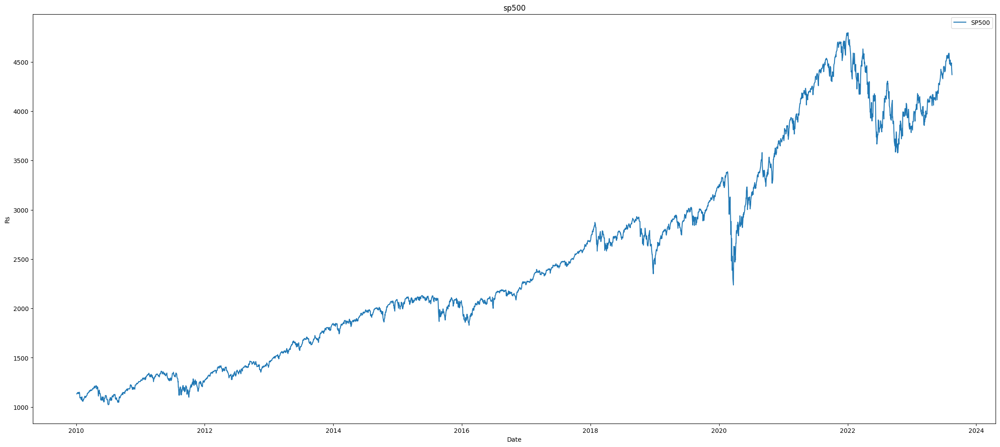

In [110]:
plt.figure(figsize=(28, 12))#, dpi=100)
plt.plot(data.index, data['Adj Close'], label='SP500')
plt.xlabel('Date')
plt.ylabel('Rs')
plt.title('sp500')
plt.legend()
plt.show()

In [111]:
df = data.copy()
df = df.dropna()
df.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2010-01-04,1116.560059,1133.869995,1116.560059,1132.989990,1132.989990,3991400000
2010-01-05,1132.660034,1136.630005,1129.660034,1136.520020,1136.520020,2491020000
2010-01-06,1135.709961,1139.189941,1133.949951,1137.140015,1137.140015,4972660000
2010-01-07,1136.270020,1142.459961,1131.319946,1141.689941,1141.689941,5270680000
2010-01-08,1140.520020,1145.390015,1136.219971,1144.979980,1144.979980,4389590000


In [112]:
print('Total dataset has {} samples, and {} features.'.format(df.shape[0], \
                                                              df.shape[1]))

Total dataset has 3429 samples, and 6 features.


# 2. Feature engineering

In [113]:
FE_df = df

In [114]:
len(FE_df)

3429

# 3. Data preparation 

## 3.1. Data split

In [115]:
data_training = FE_df[FE_df.index < '2020-12-31'].copy()
data_training.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2010-01-04,1116.560059,1133.869995,1116.560059,1132.989990,1132.989990,3991400000
2010-01-05,1132.660034,1136.630005,1129.660034,1136.520020,1136.520020,2491020000
2010-01-06,1135.709961,1139.189941,1133.949951,1137.140015,1137.140015,4972660000
2010-01-07,1136.270020,1142.459961,1131.319946,1141.689941,1141.689941,5270680000
2010-01-08,1140.520020,1145.390015,1136.219971,1144.979980,1144.979980,4389590000


In [116]:
data_testing = FE_df[FE_df.index >= '2020-12-31'].copy()
data_testing.head()

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2020-12-31,3733.270020,3760.199951,3726.879883,3756.070068,3756.070068,3179040000
2021-01-04,3764.610107,3769.989990,3662.709961,3700.649902,3700.649902,5015000000
2021-01-05,3698.020020,3737.830078,3695.070068,3726.860107,3726.860107,4591020000
2021-01-06,3712.199951,3783.040039,3705.340088,3748.139893,3748.139893,6064110000
2021-01-07,3764.709961,3811.550049,3764.709961,3803.790039,3803.790039,5099160000


In [117]:
data_training.shape, data_testing.shape

((2768, 6), (661, 6))

## 3.2 Data transformation

In [124]:
from hyperopt import fmin, tpe, hp

def objective(params):
    
    win_size = int(params['win_size'])
    num_epoch = int(params['num_epoch'])
    num_cell = int(params['num_cell'])
    batch_size = int(params['batch_size'])
    dropout = params['dropout']

    scalar = MinMaxScaler()

    data_training_scaled = scalar.fit_transform(data_training)
    X_train, y_train = rnn_3D_data(data_training_scaled, window_size=win_size, y_pos=4)
    # add the winodw before test data
    data_test = pd.concat([data_training.tail(win_size), data_testing], ignore_index=True)
    data_test_scaled = scalar.fit_transform(data_test)
    X_test, y_test = rnn_3D_data(data_test_scaled, window_size=win_size, y_pos=4)

    model = Sequential()
    model.add(LSTM(units = num_cell, activation = 'relu', input_shape = (X_train.shape[1], X_train.shape[2])))
    model.add(Dropout(dropout))
    model.add(Dense(units = 1))

    # Compiling the RNN
    model.compile(optimizer = 'adam', loss = 'mean_squared_error')
    lstm_training = model.fit(X_train, y_train, epochs=num_epoch, batch_size = batch_size,\
                        shuffle=False, validation_data=(X_test, y_test),verbose=1)     
   
    # evaluer le modèle
    # transforme MSE en RMSE
    loss_history = pd.DataFrame(lstm_training.history).pow(.5)
    loss_history.index += 1
#calcule la valeur minimale de la colonne val_loss dans le DataFrame loss_history, 
#ce qui correspond au meilleur RMSE de validation atteint par le modèle.
    best_rmse = loss_history.val_loss.min()
    
    return best_rmse


#def hyperopt_objective(params):
#    return objective(params, data_training, data_testing)

In [121]:
space = {
    'win_size': hp.quniform('win_size', 60, 70, 10),
    'num_cell': hp.quniform('num_cell', 50, 60, 10),
    'batch_size': hp.quniform('batch_size', 16, 32, 16),
    'num_epoch': hp.quniform('num_epoch', 50, 60, 10),
    'dropout': hp.quniform('dropout', 0.2, 0.6, 0.2)
}

best = fmin(fn=objective, space=space, algo=tpe.suggest, max_evals=100)

In [125]:
# long duration, 6 hours to run
best = fmin(fn=objective, space=space, algo=tpe.suggest, max_evals=100)
print("Best hyperparameters:", best)

Epoch 1/50                                                                                                             

169/169 [==============================] - 11s 40ms/step - loss: 0.0042 - val_loss: 0.0033                             

Epoch 2/50                                                                                                             

 39/169 [=====>........................] - ETA: 2s - loss: 0.0032                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0036 - val_loss: 0.0088                              

Epoch 3/50                                                                                                             

 93/169 [===============>..............] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0033 - val_loss: 0.0031                              

Epoch 4/50                                                                                                             

146/169 [========================>.....] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0021                              

Epoch 5/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0030                              

Epoch 6/50                                                                                                             

 15/169 [=>............................] - ETA: 2s - loss: 9.4619e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0022 - val_loss: 0.0041                              

Epoch 7/50                                                                                                             

 50/169 [=======>......................] - ETA: 2s - loss: 7.1439e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0021                              

Epoch 8/50                                                                                                             

 94/169 [===============>..............] - ETA: 1s - loss: 8.8344e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0018                              

Epoch 9/50                                                                                                             

140/169 [=======================>......] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0019                              

Epoch 10/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0042                              

Epoch 11/50                                                                                                            

 20/169 [==>...........................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0017                              

Epoch 12/50                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 4.5766e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0028                              

Epoch 13/50                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0024                              

Epoch 14/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0018                              

Epoch 15/50                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 16/50                                                                                                            

 50/169 [=======>......................] - ETA: 2s - loss: 8.0807e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0041                              

Epoch 17/50                                                                                                            

 87/169 [==============>...............] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0018                              

Epoch 18/50                                                                                                            

136/169 [=======================>......] - ETA: 0s - loss: 9.8059e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0019                              

Epoch 19/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0016 - val_loss: 0.0024                              

Epoch 20/50                                                                                                            

 16/169 [=>............................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0042                              

Epoch 21/50                                                                                                            

 78/169 [============>.................] - ETA: 1s - loss: 8.7190e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0034                              

Epoch 22/50                                                                                                            

129/169 [=====================>........] - ETA: 0s - loss: 8.1222e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0034                              

Epoch 23/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0016                              

Epoch 24/50                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0027                              

Epoch 25/50                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 26/50                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 8.6192e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0025                              

Epoch 27/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0031                              

Epoch 28/50                                                                                                            

  7/169 [>.............................] - ETA: 3s - loss: 0.0017                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 29/50                                                                                                            

 25/169 [===>..........................] - ETA: 3s - loss: 0.0021                                                      


169/169 [==============================] - 5s 28ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 30/50                                                                                                            

 60/169 [=========>....................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 31/50                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 7.4779e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0031                              

Epoch 32/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0021                              

Epoch 33/50                                                                                                            

  1/169 [..............................] - ETA: 3s - loss: 0.0019                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 34/50                                                                                                            

 74/169 [============>.................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 35/50                                                                                                            

148/169 [=========================>....] - ETA: 0s - loss: 9.5052e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 36/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 37/50                                                                                                            

 34/169 [=====>........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 38/50                                                                                                            

106/169 [=================>............] - ETA: 0s - loss: 8.3044e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 39/50                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 40/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 41/50                                                                                                            

 29/169 [====>.........................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 42/50                                                                                                            

 77/169 [============>.................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 43/50                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 9.0469e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 44/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 45/50                                                                                                            

  1/169 [..............................] - ETA: 3s - loss: 0.0015                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 46/50                                                                                                            

 45/169 [======>.......................] - ETA: 1s - loss: 0.0017                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 47/50                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 9.7866e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 48/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 49/50                                                                                                            

  1/169 [..............................] - ETA: 3s - loss: 0.0028                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 50/50                                                                                                            

 48/169 [=======>......................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 1/60                                                                                                             

104/169 [=================>............] - ETA: 1s - loss: 0.0052                                                      


169/169 [==============================] - 11s 38ms/step - loss: 0.0139 - val_loss: 0.0071                             

Epoch 2/60                                                                                                             

167/169 [============================>.] - ETA: 0s - loss: 0.0107                                                      


169/169 [==============================] - 5s 32ms/step - loss: 0.0109 - val_loss: 0.0035                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0081 - val_loss: 0.0050                              

Epoch 4/60                                                                                                             

 42/169 [======>.......................] - ETA: 2s - loss: 0.0041                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0076 - val_loss: 0.0034                              

Epoch 5/60                                                                                                             

 95/169 [===============>..............] - ETA: 1s - loss: 0.0037                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0076 - val_loss: 0.0044                              

Epoch 6/60                                                                                                             

147/169 [=========================>....] - ETA: 0s - loss: 0.0053                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0072 - val_loss: 0.0028                              

Epoch 7/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0067 - val_loss: 0.0031                              

Epoch 8/60                                                                                                             

 31/169 [====>.........................] - ETA: 2s - loss: 0.0074                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0074 - val_loss: 0.0023                              

Epoch 9/60                                                                                                             

 93/169 [===============>..............] - ETA: 1s - loss: 0.0041                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0067 - val_loss: 0.0056                              

Epoch 10/60                                                                                                            

151/169 [=========================>....] - ETA: 0s - loss: 0.0048                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0062 - val_loss: 0.0049                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0068 - val_loss: 0.0022                              

Epoch 12/60                                                                                                            

 28/169 [===>..........................] - ETA: 3s - loss: 0.0108                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0063 - val_loss: 0.0027                              

Epoch 13/60                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 0.0046                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0060 - val_loss: 0.0027                              

Epoch 14/60                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 0.0044                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0060 - val_loss: 0.0023                              

Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0060 - val_loss: 0.0026                              

Epoch 16/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0145                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0060 - val_loss: 0.0049                              

Epoch 17/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 0.0068                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0070 - val_loss: 0.0024                              

Epoch 18/60                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 0.0043                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0060 - val_loss: 0.0037                              

Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0067 - val_loss: 0.0023                              

Epoch 20/60                                                                                                            

  7/169 [>.............................] - ETA: 3s - loss: 0.0142                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0064 - val_loss: 0.0023                              

Epoch 21/60                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 0.0067                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0062 - val_loss: 0.0031                              

Epoch 22/60                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 0.0043                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0061 - val_loss: 0.0064                              

Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0067 - val_loss: 0.0025                              

Epoch 24/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0060 - val_loss: 0.0019                              

Epoch 25/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 0.0051                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0057 - val_loss: 0.0024                              

Epoch 26/60                                                                                                            

146/169 [========================>.....] - ETA: 0s - loss: 0.0045                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0061 - val_loss: 0.0034                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0058 - val_loss: 0.0022                              

Epoch 28/60                                                                                                            

 44/169 [======>.......................] - ETA: 2s - loss: 0.0088                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0058 - val_loss: 0.0023                              

Epoch 29/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 0.0043                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0060 - val_loss: 0.0019                              

Epoch 30/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0057 - val_loss: 0.0022                              

Epoch 31/60                                                                                                            



169/169 [==============================] - 4s 23ms/step - loss: 0.0059 - val_loss: 0.0027                              

Epoch 32/60                                                                                                            

 75/169 [============>.................] - ETA: 1s - loss: 0.0057                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0056 - val_loss: 0.0038                              

Epoch 33/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 0.0043                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0055 - val_loss: 0.0021                              

Epoch 34/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0058 - val_loss: 0.0024                              

Epoch 35/60                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 0.0106                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0062 - val_loss: 0.0028                              

Epoch 36/60                                                                                                            

110/169 [==================>...........] - ETA: 0s - loss: 0.0039                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0057 - val_loss: 0.0042                              

Epoch 37/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0059 - val_loss: 0.0020                              

Epoch 38/60                                                                                                            

  9/169 [>.............................] - ETA: 2s - loss: 0.0166                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0056 - val_loss: 0.0022                              

Epoch 39/60                                                                                                            

 87/169 [==============>...............] - ETA: 1s - loss: 0.0049                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0058 - val_loss: 0.0022                              

Epoch 40/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 0.0052                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0063 - val_loss: 0.0037                              

Epoch 41/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0060 - val_loss: 0.0026                              

Epoch 42/60                                                                                                            

 51/169 [========>.....................] - ETA: 1s - loss: 0.0079                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0059 - val_loss: 0.0026                              

Epoch 43/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 0.0042                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0059 - val_loss: 0.0020                              

Epoch 44/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0059 - val_loss: 0.0022                              

Epoch 45/60                                                                                                            

 24/169 [===>..........................] - ETA: 2s - loss: 0.0110                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0056 - val_loss: 0.0017                              

Epoch 46/60                                                                                                            

108/169 [==================>...........] - ETA: 0s - loss: 0.0039                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0060 - val_loss: 0.0032                              

Epoch 47/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0058 - val_loss: 0.0030                              

Epoch 48/60                                                                                                            



169/169 [==============================] - 4s 23ms/step - loss: 0.0062 - val_loss: 0.0026                              

Epoch 49/60                                                                                                            

 77/169 [============>.................] - ETA: 1s - loss: 0.0056                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0058 - val_loss: 0.0025                              

Epoch 50/60                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 0.0049                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0057 - val_loss: 0.0045                              

Epoch 51/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0062 - val_loss: 0.0023                              

Epoch 52/60                                                                                                            

 51/169 [========>.....................] - ETA: 1s - loss: 0.0080                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0060 - val_loss: 0.0041                              

Epoch 53/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 0.0044                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0058 - val_loss: 0.0019                              

Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0058 - val_loss: 0.0030                              

Epoch 55/60                                                                                                            

 27/169 [===>..........................] - ETA: 2s - loss: 0.0123                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0062 - val_loss: 0.0018                              

Epoch 56/60                                                                                                            

107/169 [=================>............] - ETA: 1s - loss: 0.0045                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0060 - val_loss: 0.0020                              

Epoch 57/60                                                                                                            

168/169 [============================>.] - ETA: 0s - loss: 0.0063                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0064 - val_loss: 0.0027                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0055 - val_loss: 0.0025                              

Epoch 59/60                                                                                                            

 33/169 [====>.........................] - ETA: 2s - loss: 0.0112                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0058 - val_loss: 0.0025                              

Epoch 60/60                                                                                                            

 83/169 [=============>................] - ETA: 1s - loss: 0.0046                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0054 - val_loss: 0.0029                              

Epoch 1/60                                                                                                             

159/170 [===========================>..] - ETA: 0s - loss: 0.0078                                                      


170/170 [==============================] - 10s 35ms/step - loss: 0.0089 - val_loss: 0.0038                             

Epoch 2/60                                                                                                             

170/170 [==============================] - 5s 31ms/step - loss: 0.0069 - val_loss: 0.0043                              

Epoch 3/60                                                                                                             

 68/170 [===========>..................] - ETA: 1s - loss: 0.0027                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0062 - val_loss: 0.0073                              

Epoch 4/60                                                                                                             

154/170 [==========================>...] - ETA: 0s - loss: 0.0044                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0052 - val_loss: 0.0076                              

Epoch 5/60                                                                                                             

170/170 [==============================] - 4s 22ms/step - loss: 0.0049 - val_loss: 0.0058                              

Epoch 6/60                                                                                                             

 64/170 [==========>...................] - ETA: 1s - loss: 0.0021                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0050 - val_loss: 0.0023                              

Epoch 7/60                                                                                                             

152/170 [=========================>....] - ETA: 0s - loss: 0.0030                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0040 - val_loss: 0.0034                              

Epoch 8/60                                                                                                             

170/170 [==============================] - 4s 22ms/step - loss: 0.0034 - val_loss: 0.0044                              

Epoch 9/60                                                                                                             

 55/170 [========>.....................] - ETA: 1s - loss: 0.0019                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0036 - val_loss: 0.0049                              

Epoch 10/60                                                                                                            

138/170 [=======================>......] - ETA: 0s - loss: 0.0021                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0033 - val_loss: 0.0079                              

Epoch 11/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0037 - val_loss: 0.0033                              

Epoch 12/60                                                                                                            

 34/170 [=====>........................] - ETA: 2s - loss: 0.0027                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0028 - val_loss: 0.0040                              

Epoch 13/60                                                                                                            

149/170 [=========================>....] - ETA: 0s - loss: 0.0024                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0031 - val_loss: 0.0023                              

Epoch 14/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0028 - val_loss: 0.0057                              

Epoch 15/60                                                                                                            

 75/170 [============>.................] - ETA: 1s - loss: 0.0026                                                      


170/170 [==============================] - 3s 21ms/step - loss: 0.0032 - val_loss: 0.0033                              

Epoch 16/60                                                                                                            

170/170 [==============================] - 3s 21ms/step - loss: 0.0029 - val_loss: 0.0025                              

Epoch 17/60                                                                                                            

  1/170 [..............................] - ETA: 0s - loss: 0.0044                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0028 - val_loss: 0.0045                              

Epoch 18/60                                                                                                            

 86/170 [==============>...............] - ETA: 1s - loss: 0.0021                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0028 - val_loss: 0.0049                              

Epoch 19/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0029 - val_loss: 0.0019                              

Epoch 20/60                                                                                                            

 13/170 [=>............................] - ETA: 2s - loss: 0.0038                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0026 - val_loss: 0.0024                              

Epoch 21/60                                                                                                            

120/170 [====================>.........] - ETA: 0s - loss: 0.0016                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0027 - val_loss: 0.0023                              

Epoch 22/60                                                                                                            

170/170 [==============================] - 3s 21ms/step - loss: 0.0025 - val_loss: 0.0021                              

Epoch 23/60                                                                                                            

 38/170 [=====>........................] - ETA: 1s - loss: 0.0036                                                      


170/170 [==============================] - 3s 21ms/step - loss: 0.0027 - val_loss: 0.0020                              

Epoch 24/60                                                                                                            

141/170 [=======================>......] - ETA: 0s - loss: 0.0018                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0026 - val_loss: 0.0022                              

Epoch 25/60                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0026 - val_loss: 0.0044                              

Epoch 26/60                                                                                                            

 70/170 [===========>..................] - ETA: 1s - loss: 0.0026                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0028 - val_loss: 0.0019                              

Epoch 27/60                                                                                                            

164/170 [===========================>..] - ETA: 0s - loss: 0.0023                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0025 - val_loss: 0.0067                              

Epoch 28/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0028 - val_loss: 0.0028                              

Epoch 29/60                                                                                                            

 90/170 [==============>...............] - ETA: 1s - loss: 0.0025                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0027 - val_loss: 0.0045                              

Epoch 30/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0028 - val_loss: 0.0022                              

Epoch 31/60                                                                                                            

 18/170 [==>...........................] - ETA: 2s - loss: 0.0049                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0028 - val_loss: 0.0021                              

Epoch 32/60                                                                                                            

117/170 [===================>..........] - ETA: 0s - loss: 0.0017                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0025 - val_loss: 0.0027                              

Epoch 33/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0027 - val_loss: 0.0049                              

Epoch 34/60                                                                                                            

 40/170 [======>.......................] - ETA: 1s - loss: 0.0038                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0024 - val_loss: 0.0040                              

Epoch 35/60                                                                                                            

127/170 [=====================>........] - ETA: 0s - loss: 0.0021                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0028 - val_loss: 0.0021                              

Epoch 36/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0026 - val_loss: 0.0019                              

Epoch 37/60                                                                                                            

 51/170 [========>.....................] - ETA: 1s - loss: 0.0036                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0025 - val_loss: 0.0018                              

Epoch 38/60                                                                                                            

159/170 [===========================>..] - ETA: 0s - loss: 0.0021                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0026 - val_loss: 0.0043                              

Epoch 39/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0026 - val_loss: 0.0022                              

Epoch 40/60                                                                                                            

 79/170 [============>.................] - ETA: 1s - loss: 0.0024                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0024 - val_loss: 0.0028                              

Epoch 41/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0027 - val_loss: 0.0019                              

Epoch 42/60                                                                                                            



170/170 [==============================] - 4s 21ms/step - loss: 0.0027 - val_loss: 0.0019                              

Epoch 43/60                                                                                                            

 97/170 [================>.............] - ETA: 1s - loss: 0.0023                                                      


170/170 [==============================] - 3s 21ms/step - loss: 0.0028 - val_loss: 0.0018                              

Epoch 44/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0027 - val_loss: 0.0021                              

Epoch 45/60                                                                                                            

 21/170 [==>...........................] - ETA: 2s - loss: 0.0046                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0025 - val_loss: 0.0026                              

Epoch 46/60                                                                                                            

127/170 [=====================>........] - ETA: 0s - loss: 0.0018                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0028 - val_loss: 0.0023                              

Epoch 47/60                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0025 - val_loss: 0.0027                              

Epoch 48/60                                                                                                            

 54/170 [========>.....................] - ETA: 1s - loss: 0.0032                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0024 - val_loss: 0.0033                              

Epoch 49/60                                                                                                            

161/170 [===========================>..] - ETA: 0s - loss: 0.0025                                                      


170/170 [==============================] - 3s 21ms/step - loss: 0.0028 - val_loss: 0.0017                              

Epoch 50/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0027 - val_loss: 0.0020                              

Epoch 51/60                                                                                                            

 79/170 [============>.................] - ETA: 1s - loss: 0.0026                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0024 - val_loss: 0.0034                              

Epoch 52/60                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0024 - val_loss: 0.0033                              

Epoch 53/60                                                                                                            

  9/170 [>.............................] - ETA: 2s - loss: 0.0059                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0026 - val_loss: 0.0019                              

Epoch 54/60                                                                                                            

119/170 [====================>.........] - ETA: 0s - loss: 0.0017                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0025 - val_loss: 0.0023                              

Epoch 55/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0025 - val_loss: 0.0017                              

Epoch 56/60                                                                                                            

 45/170 [======>.......................] - ETA: 1s - loss: 0.0036                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0025 - val_loss: 0.0020                              

Epoch 57/60                                                                                                            

148/170 [=========================>....] - ETA: 0s - loss: 0.0019                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0024 - val_loss: 0.0033                              

Epoch 58/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0026 - val_loss: 0.0038                              

Epoch 59/60                                                                                                            

 66/170 [==========>...................] - ETA: 1s - loss: 0.0028                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0024 - val_loss: 0.0027                              

Epoch 60/60                                                                                                            

167/170 [============================>.] - ETA: 0s - loss: 0.0024                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0026 - val_loss: 0.0018                              

Epoch 1/50                                                                                                             

85/85 [==============================] - 9s 59ms/step - loss: 0.0198 - val_loss: 0.0051                                

Epoch 2/50                                                                                                             

85/85 [==============================] - 4s 49ms/step - loss: 0.0167 - val_loss: 0.0045                                

Epoch 3/50                                                                                                             

30/85 [=========>....................] - ETA: 1s - loss: 0.0031                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0134 - val_loss: 0.0067                                

Epoch 4/50                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0113 - val_loss: 0.0049                                

Epoch 5/50                                                                                                             

71/85 [========================>.....] - ETA: 0s - loss: 0.0064                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0099 - val_loss: 0.0060                                

Epoch 6/50                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0097 - val_loss: 0.0032                                

Epoch 7/50                                                                                                             

85/85 [==============================] - 3s 32ms/step - loss: 0.0082 - val_loss: 0.0027                                

Epoch 8/50                                                                                                             

13/85 [===>..........................] - ETA: 1s - loss: 0.0045                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0084 - val_loss: 0.0034                                

Epoch 9/50                                                                                                             

85/85 [==============================] - 3s 32ms/step - loss: 0.0077 - val_loss: 0.0025                                

Epoch 10/50                                                                                                            

55/85 [==================>...........] - ETA: 0s - loss: 0.0030                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0073 - val_loss: 0.0039                                

Epoch 11/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0074 - val_loss: 0.0026                                

Epoch 12/50                                                                                                            

85/85 [==============================] - ETA: 0s - loss: 0.0066                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0066 - val_loss: 0.0038                                

Epoch 13/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0063 - val_loss: 0.0031                                

Epoch 14/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0063 - val_loss: 0.0036                                

Epoch 15/50                                                                                                            

19/85 [=====>........................] - ETA: 1s - loss: 0.0065                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0065 - val_loss: 0.0025                                

Epoch 16/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0065 - val_loss: 0.0025                                

Epoch 17/50                                                                                                            

55/85 [==================>...........] - ETA: 0s - loss: 0.0035                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0059 - val_loss: 0.0022                                

Epoch 18/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0062 - val_loss: 0.0023                                

Epoch 19/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0062 - val_loss: 0.0025                                



Epoch 20/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0058 - val_loss: 0.0023                                

Epoch 21/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0054 - val_loss: 0.0023                                

Epoch 22/50                                                                                                            

42/85 [=============>................] - ETA: 0s - loss: 0.0039                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0057 - val_loss: 0.0022                                

Epoch 23/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0060 - val_loss: 0.0023                                

Epoch 24/50                                                                                                            

75/85 [=========================>....] - ETA: 0s - loss: 0.0043                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0055 - val_loss: 0.0025                                

Epoch 25/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0060 - val_loss: 0.0023                                

Epoch 26/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0058 - val_loss: 0.0041                                

Epoch 27/50                                                                                                            

18/85 [=====>........................] - ETA: 1s - loss: 0.0083                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0055 - val_loss: 0.0024                                

Epoch 28/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0056 - val_loss: 0.0027                                

Epoch 29/50                                                                                                            

54/85 [==================>...........] - ETA: 0s - loss: 0.0038                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0052 - val_loss: 0.0024                                

Epoch 30/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0054 - val_loss: 0.0027                                

Epoch 31/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0059 - val_loss: 0.0024                                

Epoch 32/50                                                                                                            

 1/85 [..............................] - ETA: 2s - loss: 0.0077                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0066 - val_loss: 0.0027                                

Epoch 33/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0057 - val_loss: 0.0028                                

Epoch 34/50                                                                                                            

36/85 [===========>..................] - ETA: 0s - loss: 0.0070                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0063 - val_loss: 0.0035                                

Epoch 35/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0060 - val_loss: 0.0063                                

Epoch 36/50                                                                                                            

70/85 [=======================>......] - ETA: 0s - loss: 0.0050                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0066 - val_loss: 0.0025                                

Epoch 37/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0052 - val_loss: 0.0032                                

Epoch 38/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0052 - val_loss: 0.0046                                

Epoch 39/50                                                                                                            

29/85 [=========>....................] - ETA: 0s - loss: 0.0082                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0062 - val_loss: 0.0030                                

Epoch 40/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0052 - val_loss: 0.0023                                

Epoch 41/50                                                                                                            

63/85 [=====================>........] - ETA: 0s - loss: 0.0039                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0056 - val_loss: 0.0023                                

Epoch 42/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0051 - val_loss: 0.0022                                

Epoch 43/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0049 - val_loss: 0.0022                                



Epoch 44/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0051 - val_loss: 0.0023                                

Epoch 45/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0055 - val_loss: 0.0045                                

Epoch 46/50                                                                                                            

16/85 [====>.........................] - ETA: 1s - loss: 0.0083                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0049 - val_loss: 0.0027                                

Epoch 47/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0049 - val_loss: 0.0022                                

Epoch 48/50                                                                                                            

42/85 [=============>................] - ETA: 0s - loss: 0.0050                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0052 - val_loss: 0.0039                                

Epoch 49/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0053 - val_loss: 0.0021                                

Epoch 50/50                                                                                                            

65/85 [=====================>........] - ETA: 0s - loss: 0.0041                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0055 - val_loss: 0.0028                                

Epoch 1/60                                                                                                             

170/170 [==============================] - 11s 37ms/step - loss: 0.0067 - val_loss: 0.0084                             

Epoch 2/60                                                                                                             

 39/170 [=====>........................] - ETA: 2s - loss: 0.0041                                                      


170/170 [==============================] - 6s 32ms/step - loss: 0.0056 - val_loss: 0.0039                              

Epoch 3/60                                                                                                             

115/170 [===================>..........] - ETA: 0s - loss: 0.0018                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0041 - val_loss: 0.0105                              

Epoch 4/60                                                                                                             

170/170 [==============================] - 4s 23ms/step - loss: 0.0038 - val_loss: 0.0042                              

Epoch 5/60                                                                                                             

  8/170 [>.............................] - ETA: 2s - loss: 0.0053                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0039 - val_loss: 0.0084                              

Epoch 6/60                                                                                                             

 85/170 [==============>...............] - ETA: 1s - loss: 0.0014                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0034 - val_loss: 0.0057                              

Epoch 7/60                                                                                                             

170/170 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0042                              



Epoch 8/60                                                                                                             

170/170 [==============================] - 4s 22ms/step - loss: 0.0029 - val_loss: 0.0022                              

Epoch 9/60                                                                                                             

 83/170 [=============>................] - ETA: 1s - loss: 0.0013                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0031 - val_loss: 0.0023                              

Epoch 10/60                                                                                                            

168/170 [============================>.] - ETA: 0s - loss: 0.0026                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0027 - val_loss: 0.0084                              

Epoch 11/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0031 - val_loss: 0.0027                              

Epoch 12/60                                                                                                            

 80/170 [=============>................] - ETA: 1s - loss: 0.0015                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0029 - val_loss: 0.0025                              

Epoch 13/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0025 - val_loss: 0.0019                              



Epoch 14/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0024 - val_loss: 0.0030                              

Epoch 15/60                                                                                                            

 89/170 [==============>...............] - ETA: 1s - loss: 0.0015                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0024 - val_loss: 0.0036                              

Epoch 16/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0026 - val_loss: 0.0041                              

Epoch 17/60                                                                                                            

  1/170 [..............................] - ETA: 2s - loss: 0.0044                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0025 - val_loss: 0.0022                              

Epoch 18/60                                                                                                            

 90/170 [==============>...............] - ETA: 1s - loss: 0.0015                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0023 - val_loss: 0.0036                              

Epoch 19/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0025 - val_loss: 0.0023                              

Epoch 20/60                                                                                                            

  1/170 [..............................] - ETA: 1s - loss: 0.0040                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0024 - val_loss: 0.0033                              

Epoch 21/60                                                                                                            

 91/170 [===============>..............] - ETA: 1s - loss: 0.0015                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0024 - val_loss: 0.0022                              

Epoch 22/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0026 - val_loss: 0.0026                              

Epoch 23/60                                                                                                            

  1/170 [..............................] - ETA: 4s - loss: 0.0051                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0030 - val_loss: 0.0144                              

Epoch 24/60                                                                                                            

 96/170 [===============>..............] - ETA: 1s - loss: 0.0024                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0030 - val_loss: 0.0026                              

Epoch 25/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0027 - val_loss: 0.0038                              

Epoch 26/60                                                                                                            



170/170 [==============================] - 4s 22ms/step - loss: 0.0024 - val_loss: 0.0053                              

Epoch 27/60                                                                                                            

 93/170 [===============>..............] - ETA: 1s - loss: 0.0022                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0028 - val_loss: 0.0021                              

Epoch 28/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0025 - val_loss: 0.0020                              

Epoch 29/60                                                                                                            

  1/170 [..............................] - ETA: 2s - loss: 0.0042                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0025 - val_loss: 0.0064                              

Epoch 30/60                                                                                                            

 71/170 [===========>..................] - ETA: 1s - loss: 0.0024                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0027 - val_loss: 0.0019                              

Epoch 31/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0022 - val_loss: 0.0018                              



Epoch 32/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0022 - val_loss: 0.0046                              

Epoch 33/60                                                                                                            

 85/170 [==============>...............] - ETA: 1s - loss: 0.0021                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0025 - val_loss: 0.0057                              

Epoch 34/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0025 - val_loss: 0.0034                              



Epoch 35/60                                                                                                            

170/170 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0030                              

Epoch 36/60                                                                                                            

 70/170 [===========>..................] - ETA: 1s - loss: 0.0021                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0026 - val_loss: 0.0019                              

Epoch 37/60                                                                                                            

163/170 [===========================>..] - ETA: 0s - loss: 0.0022                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0024 - val_loss: 0.0019                              

Epoch 38/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0023 - val_loss: 0.0052                              

Epoch 39/60                                                                                                            

 77/170 [============>.................] - ETA: 1s - loss: 0.0025                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0027 - val_loss: 0.0025                              

Epoch 40/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0026 - val_loss: 0.0023                              



Epoch 41/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0023 - val_loss: 0.0037                              

Epoch 42/60                                                                                                            

 83/170 [=============>................] - ETA: 1s - loss: 0.0019                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0023 - val_loss: 0.0047                              

Epoch 43/60                                                                                                            

167/170 [============================>.] - ETA: 0s - loss: 0.0023                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0024 - val_loss: 0.0024                              

Epoch 44/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0024 - val_loss: 0.0024                              

Epoch 45/60                                                                                                            

 77/170 [============>.................] - ETA: 1s - loss: 0.0021                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0026 - val_loss: 0.0017                              

Epoch 46/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0028 - val_loss: 0.0016                              



Epoch 47/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0023 - val_loss: 0.0017                              

Epoch 48/60                                                                                                            

 86/170 [==============>...............] - ETA: 1s - loss: 0.0018                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0023 - val_loss: 0.0018                              

Epoch 49/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0025 - val_loss: 0.0031                              

Epoch 50/60                                                                                                            



170/170 [==============================] - 4s 22ms/step - loss: 0.0024 - val_loss: 0.0036                              

Epoch 51/60                                                                                                            

 86/170 [==============>...............] - ETA: 1s - loss: 0.0024                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0029 - val_loss: 0.0022                              

Epoch 52/60                                                                                                            

170/170 [==============================] - 6s 35ms/step - loss: 0.0025 - val_loss: 0.0022                              



Epoch 53/60                                                                                                            

170/170 [==============================] - 7s 38ms/step - loss: 0.0023 - val_loss: 0.0058                              

Epoch 54/60                                                                                                            

 40/170 [======>.......................] - ETA: 2s - loss: 0.0040                                                      


170/170 [==============================] - 7s 39ms/step - loss: 0.0026 - val_loss: 0.0020                              

Epoch 55/60                                                                                                            

 94/170 [===============>..............] - ETA: 1s - loss: 0.0016                                                      


170/170 [==============================] - 7s 40ms/step - loss: 0.0022 - val_loss: 0.0033                              

Epoch 56/60                                                                                                            

146/170 [========================>.....] - ETA: 0s - loss: 0.0020                                                      


170/170 [==============================] - 6s 37ms/step - loss: 0.0025 - val_loss: 0.0021                              

Epoch 57/60                                                                                                            

170/170 [==============================] - 6s 35ms/step - loss: 0.0024 - val_loss: 0.0019                              

Epoch 58/60                                                                                                            

 42/170 [======>.......................] - ETA: 2s - loss: 0.0032                                                      


170/170 [==============================] - 6s 36ms/step - loss: 0.0027 - val_loss: 0.0023                              

Epoch 59/60                                                                                                            

104/170 [=================>............] - ETA: 1s - loss: 0.0016                                                      


170/170 [==============================] - 7s 41ms/step - loss: 0.0026 - val_loss: 0.0021                              

Epoch 60/60                                                                                                            

170/170 [==============================] - 6s 36ms/step - loss: 0.0025 - val_loss: 0.0027                              



Epoch 1/60                                                                                                             

169/169 [==============================] - 28s 88ms/step - loss: 0.0040 - val_loss: 0.0074                             

Epoch 2/60                                                                                                             

 42/169 [======>.......................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0031 - val_loss: 0.0048                              

Epoch 3/60                                                                                                             

120/169 [====================>.........] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0026 - val_loss: 0.0033                              

Epoch 4/60                                                                                                             

169/169 [==============================] - 4s 22ms/step - loss: 0.0027 - val_loss: 0.0021                              

Epoch 5/60                                                                                                             

 31/169 [====>.........................] - ETA: 2s - loss: 6.4508e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0027 - val_loss: 0.0022                              

Epoch 6/60                                                                                                             

122/169 [====================>.........] - ETA: 0s - loss: 8.8003e-04                                                  


169/169 [==============================] - 4s 22ms/step - loss: 0.0021 - val_loss: 0.0024                              

Epoch 7/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0021 - val_loss: 0.0035                              

Epoch 8/60                                                                                                             

  5/169 [..............................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0022 - val_loss: 0.0024                              

Epoch 9/60                                                                                                             

 85/169 [==============>...............] - ETA: 1s - loss: 7.7976e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0038                              

Epoch 10/60                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0018 - val_loss: 0.0026                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0021                              

Epoch 12/60                                                                                                            

 58/169 [=========>....................] - ETA: 1s - loss: 4.6695e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0045                              

Epoch 13/60                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 9.3230e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0017 - val_loss: 0.0031                              

Epoch 14/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0032                              

Epoch 15/60                                                                                                            

 39/169 [=====>........................] - ETA: 1s - loss: 8.8859e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0036                              

Epoch 16/60                                                                                                            

120/169 [====================>.........] - ETA: 0s - loss: 8.5725e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0017 - val_loss: 0.0020                              

Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0052                              

Epoch 18/60                                                                                                            

 21/169 [==>...........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0037                              

Epoch 19/60                                                                                                            

111/169 [==================>...........] - ETA: 0s - loss: 8.0216e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 20/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 21/60                                                                                                            

 13/169 [=>............................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0037                              

Epoch 22/60                                                                                                            

 87/169 [==============>...............] - ETA: 1s - loss: 7.8322e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 23/60                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 24/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 25/60                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 9.0202e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 26/60                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 9.7638e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 28/60                                                                                                            

 61/169 [=========>....................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 29/60                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 9.0402e-04                                                  


169/169 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 30/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0016 - val_loss: 0.0065                              

Epoch 31/60                                                                                                            

 48/169 [=======>......................] - ETA: 1s - loss: 0.0022                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0033                              

Epoch 32/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 9.8201e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0026                              

Epoch 33/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 34/60                                                                                                            

 33/169 [====>.........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 35/60                                                                                                            

121/169 [====================>.........] - ETA: 0s - loss: 7.9116e-04                                                  


169/169 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 36/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0037                              

Epoch 37/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0026                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 38/60                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 8.3884e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 40/60                                                                                                            



169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 41/60                                                                                                            

 78/169 [============>.................] - ETA: 1s - loss: 9.8471e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0040                              

Epoch 42/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 44/60                                                                                                            

 58/169 [=========>....................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 45/60                                                                                                            

138/169 [=======================>......] - ETA: 0s - loss: 8.8707e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0047                              

Epoch 47/60                                                                                                            

 39/169 [=====>........................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 48/60                                                                                                            

120/169 [====================>.........] - ETA: 0s - loss: 8.6989e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0032                              

Epoch 49/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 50/60                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 51/60                                                                                                            

 60/169 [=========>....................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0032                              

Epoch 52/60                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 8.8018e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 54/60                                                                                                            

 48/169 [=======>......................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 55/60                                                                                                            

135/169 [======================>.......] - ETA: 0s - loss: 8.3884e-04                                                  


169/169 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 56/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0027                              

Epoch 57/60                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 58/60                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 8.1024e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 59/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 60/60                                                                                                            

 21/169 [==>...........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 1/60                                                                                                             

82/85 [===========================>..] - ETA: 0s - loss: 0.0148                                                        


85/85 [==============================] - 9s 62ms/step - loss: 0.0160 - val_loss: 0.0053                                

Epoch 2/60                                                                                                             

85/85 [==============================] - 4s 53ms/step - loss: 0.0144 - val_loss: 0.0025                                

Epoch 3/60                                                                                                             

85/85 [==============================] - 3s 34ms/step - loss: 0.0103 - val_loss: 0.0028                                

Epoch 4/60                                                                                                             

10/85 [==>...........................] - ETA: 1s - loss: 0.0049                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0105 - val_loss: 0.0031                                

Epoch 5/60                                                                                                             

85/85 [==============================] - 3s 34ms/step - loss: 0.0090 - val_loss: 0.0048                                

Epoch 6/60                                                                                                             

31/85 [=========>....................] - ETA: 1s - loss: 0.0030                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0085 - val_loss: 0.0025                                

Epoch 7/60                                                                                                             

85/85 [==============================] - 3s 34ms/step - loss: 0.0072 - val_loss: 0.0026                                

Epoch 8/60                                                                                                             

48/85 [===============>..............] - ETA: 0s - loss: 0.0032                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0072 - val_loss: 0.0023                                

Epoch 9/60                                                                                                             

85/85 [==============================] - 3s 34ms/step - loss: 0.0061 - val_loss: 0.0027                                

Epoch 10/60                                                                                                            

62/85 [====================>.........] - ETA: 0s - loss: 0.0030                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0059 - val_loss: 0.0033                                

Epoch 11/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0071 - val_loss: 0.0029                                

Epoch 12/60                                                                                                            

81/85 [===========================>..] - ETA: 0s - loss: 0.0049                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0057 - val_loss: 0.0027                                

Epoch 13/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0071 - val_loss: 0.0025                                

Epoch 14/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0052 - val_loss: 0.0028                                

Epoch 15/60                                                                                                            

 5/85 [>.............................] - ETA: 1s - loss: 0.0086                                                        


85/85 [==============================] - 3s 36ms/step - loss: 0.0056 - val_loss: 0.0023                                

Epoch 16/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0058 - val_loss: 0.0023                                

Epoch 17/60                                                                                                            

27/85 [========>.....................] - ETA: 1s - loss: 0.0054                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0060 - val_loss: 0.0021                                

Epoch 18/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0049 - val_loss: 0.0029                                

Epoch 19/60                                                                                                            

46/85 [===============>..............] - ETA: 0s - loss: 0.0037                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0061 - val_loss: 0.0034                                

Epoch 20/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0052 - val_loss: 0.0037                                

Epoch 21/60                                                                                                            

60/85 [====================>.........] - ETA: 0s - loss: 0.0040                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0063 - val_loss: 0.0025                                

Epoch 22/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0052 - val_loss: 0.0021                                

Epoch 23/60                                                                                                            

80/85 [===========================>..] - ETA: 0s - loss: 0.0049                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0056 - val_loss: 0.0021                                

Epoch 24/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0050 - val_loss: 0.0029                                

Epoch 25/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0056 - val_loss: 0.0019                                

Epoch 26/60                                                                                                            

 7/85 [=>............................] - ETA: 1s - loss: 0.0075                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0049 - val_loss: 0.0019                                

Epoch 27/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0059 - val_loss: 0.0023                                

Epoch 28/60                                                                                                            

25/85 [=======>......................] - ETA: 1s - loss: 0.0058                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0057 - val_loss: 0.0039                                

Epoch 29/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0058 - val_loss: 0.0026                                

Epoch 30/60                                                                                                            

45/85 [==============>...............] - ETA: 0s - loss: 0.0042                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0055 - val_loss: 0.0033                                

Epoch 31/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0058 - val_loss: 0.0021                                

Epoch 32/60                                                                                                            

60/85 [====================>.........] - ETA: 0s - loss: 0.0042                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0063 - val_loss: 0.0023                                

Epoch 33/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0052 - val_loss: 0.0020                                

Epoch 34/60                                                                                                            

83/85 [============================>.] - ETA: 0s - loss: 0.0047                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0050 - val_loss: 0.0024                                

Epoch 35/60                                                                                                            

85/85 [==============================] - 3s 41ms/step - loss: 0.0051 - val_loss: 0.0027                                

Epoch 36/60                                                                                                            

85/85 [==============================] - 6s 65ms/step - loss: 0.0049 - val_loss: 0.0026                                

Epoch 37/60                                                                                                            

 6/85 [=>............................] - ETA: 2s - loss: 0.0118                                                        


85/85 [==============================] - 7s 78ms/step - loss: 0.0051 - val_loss: 0.0025                                

Epoch 38/60                                                                                                            

79/85 [==========================>...] - ETA: 0s - loss: 0.0048                                                        


85/85 [==============================] - 6s 68ms/step - loss: 0.0055 - val_loss: 0.0019                                

Epoch 39/60                                                                                                            

85/85 [==============================] - 6s 75ms/step - loss: 0.0054 - val_loss: 0.0027                                

Epoch 40/60                                                                                                            

68/85 [=======================>......] - ETA: 0s - loss: 0.0037                                                        


85/85 [==============================] - 7s 83ms/step - loss: 0.0053 - val_loss: 0.0020                                

Epoch 41/60                                                                                                            

85/85 [==============================] - 6s 76ms/step - loss: 0.0050 - val_loss: 0.0028                                

Epoch 42/60                                                                                                            

27/85 [========>.....................] - ETA: 2s - loss: 0.0072                                                        


85/85 [==============================] - 7s 85ms/step - loss: 0.0053 - val_loss: 0.0023                                

Epoch 43/60                                                                                                            

85/85 [==============================] - 6s 66ms/step - loss: 0.0053 - val_loss: 0.0025                                

Epoch 44/60                                                                                                            

12/85 [===>..........................] - ETA: 1s - loss: 0.0095                                                        


85/85 [==============================] - 6s 74ms/step - loss: 0.0052 - val_loss: 0.0028                                

Epoch 45/60                                                                                                            

85/85 [==============================] - 6s 69ms/step - loss: 0.0050 - val_loss: 0.0025                                

Epoch 46/60                                                                                                            

12/85 [===>..........................] - ETA: 1s - loss: 0.0087                                                        


85/85 [==============================] - 6s 68ms/step - loss: 0.0049 - val_loss: 0.0031                                

Epoch 47/60                                                                                                            

85/85 [==============================] - 7s 78ms/step - loss: 0.0054 - val_loss: 0.0025                                

Epoch 48/60                                                                                                            



85/85 [==============================] - 7s 83ms/step - loss: 0.0051 - val_loss: 0.0020                                

Epoch 49/60                                                                                                            

58/85 [===================>..........] - ETA: 0s - loss: 0.0034                                                        


85/85 [==============================] - 6s 74ms/step - loss: 0.0048 - val_loss: 0.0021                                

Epoch 50/60                                                                                                            

85/85 [==============================] - 6s 67ms/step - loss: 0.0053 - val_loss: 0.0024                                

Epoch 51/60                                                                                                            

53/85 [=================>............] - ETA: 0s - loss: 0.0038                                                        


85/85 [==============================] - 6s 66ms/step - loss: 0.0057 - val_loss: 0.0048                                

Epoch 52/60                                                                                                            

85/85 [==============================] - 6s 67ms/step - loss: 0.0060 - val_loss: 0.0021                                

Epoch 53/60                                                                                                            

51/85 [=================>............] - ETA: 0s - loss: 0.0037                                                        


85/85 [==============================] - 6s 74ms/step - loss: 0.0054 - val_loss: 0.0018                                

Epoch 54/60                                                                                                            

85/85 [==============================] - 6s 70ms/step - loss: 0.0054 - val_loss: 0.0018                                

Epoch 55/60                                                                                                            

38/85 [============>.................] - ETA: 1s - loss: 0.0048                                                        


85/85 [==============================] - 6s 70ms/step - loss: 0.0050 - val_loss: 0.0019                                

Epoch 56/60                                                                                                            

85/85 [==============================] - 6s 74ms/step - loss: 0.0045 - val_loss: 0.0027                                

Epoch 57/60                                                                                                            

40/85 [=============>................] - ETA: 1s - loss: 0.0047                                                        


85/85 [==============================] - 6s 72ms/step - loss: 0.0049 - val_loss: 0.0023                                

Epoch 58/60                                                                                                            

85/85 [==============================] - 6s 74ms/step - loss: 0.0053 - val_loss: 0.0018                                

Epoch 59/60                                                                                                            

37/85 [============>.................] - ETA: 1s - loss: 0.0047                                                        


85/85 [==============================] - 6s 70ms/step - loss: 0.0047 - val_loss: 0.0019                                

Epoch 60/60                                                                                                            

85/85 [==============================] - 7s 79ms/step - loss: 0.0047 - val_loss: 0.0018                                

Epoch 1/50                                                                                                             

 30/170 [====>.........................] - ETA: 2s - loss: 0.0018                                                      


170/170 [==============================] - 33s 96ms/step - loss: 0.0055 - val_loss: 0.0182                             

Epoch 2/50                                                                                                             

 90/170 [==============>...............] - ETA: 1s - loss: 0.0036                                                      


170/170 [==============================] - 13s 78ms/step - loss: 0.0049 - val_loss: 0.0124                             

Epoch 3/50                                                                                                             

170/170 [==============================] - 5s 30ms/step - loss: 0.0036 - val_loss: 0.0026                              

Epoch 4/50                                                                                                             



170/170 [==============================] - 3s 20ms/step - loss: 0.0026 - val_loss: 0.0113                              

Epoch 5/50                                                                                                             

101/170 [================>.............] - ETA: 0s - loss: 0.0014                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0029 - val_loss: 0.0040                              

Epoch 6/50                                                                                                             

170/170 [==============================] - 3s 20ms/step - loss: 0.0027 - val_loss: 0.0020                              

Epoch 7/50                                                                                                             

 21/170 [==>...........................] - ETA: 1s - loss: 0.0010                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0024 - val_loss: 0.0025                              

Epoch 8/50                                                                                                             

125/170 [=====================>........] - ETA: 0s - loss: 9.6408e-04                                                  


170/170 [==============================] - 4s 21ms/step - loss: 0.0020 - val_loss: 0.0047                              

Epoch 9/50                                                                                                             

170/170 [==============================] - 3s 20ms/step - loss: 0.0020 - val_loss: 0.0021                              

Epoch 10/50                                                                                                            

 67/170 [==========>...................] - ETA: 1s - loss: 5.1838e-04                                                  


170/170 [==============================] - 3s 20ms/step - loss: 0.0018 - val_loss: 0.0024                              

Epoch 11/50                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0022 - val_loss: 0.0021                              

Epoch 12/50                                                                                                            

  1/170 [..............................] - ETA: 2s - loss: 0.0015                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0019 - val_loss: 0.0019                              

Epoch 13/50                                                                                                            

123/170 [====================>.........] - ETA: 0s - loss: 8.2017e-04                                                  


170/170 [==============================] - 3s 20ms/step - loss: 0.0017 - val_loss: 0.0020                              

Epoch 14/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0018 - val_loss: 0.0040                              

Epoch 15/50                                                                                                            

 60/170 [=========>....................] - ETA: 1s - loss: 0.0010                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0019 - val_loss: 0.0042                              

Epoch 16/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0018 - val_loss: 0.0052                              



Epoch 17/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0019 - val_loss: 0.0026                              

Epoch 18/50                                                                                                            

106/170 [=================>............] - ETA: 0s - loss: 9.7878e-04                                                  


170/170 [==============================] - 3s 20ms/step - loss: 0.0018 - val_loss: 0.0023                              

Epoch 19/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0019 - val_loss: 0.0018                              

Epoch 20/50                                                                                                            

 44/170 [======>.......................] - ETA: 1s - loss: 0.0012                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 21/50                                                                                                            

162/170 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0015 - val_loss: 0.0022                              

Epoch 22/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0018 - val_loss: 0.0020                              

Epoch 23/50                                                                                                            

109/170 [==================>...........] - ETA: 0s - loss: 8.8200e-04                                                  


170/170 [==============================] - 3s 20ms/step - loss: 0.0016 - val_loss: 0.0019                              

Epoch 24/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0017 - val_loss: 0.0018                              

Epoch 25/50                                                                                                            

 68/170 [===========>..................] - ETA: 1s - loss: 0.0012                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0016 - val_loss: 0.0019                              

Epoch 26/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0016 - val_loss: 0.0022                              

Epoch 27/50                                                                                                            

 14/170 [=>............................] - ETA: 2s - loss: 0.0017                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0016 - val_loss: 0.0017                              

Epoch 28/50                                                                                                            

135/170 [======================>.......] - ETA: 0s - loss: 9.2537e-04                                                  


170/170 [==============================] - 3s 20ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 29/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 30/50                                                                                                            

 80/170 [=============>................] - ETA: 1s - loss: 0.0011                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0017 - val_loss: 0.0020                              

Epoch 31/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0016 - val_loss: 0.0088                              

Epoch 32/50                                                                                                            

 13/170 [=>............................] - ETA: 2s - loss: 0.0043                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0020 - val_loss: 0.0020                              

Epoch 33/50                                                                                                            

132/170 [======================>.......] - ETA: 0s - loss: 0.0011                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0016 - val_loss: 0.0017                              

Epoch 34/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0014 - val_loss: 0.0029                              

Epoch 35/50                                                                                                            

 64/170 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


170/170 [==============================] - 3s 19ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 36/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0014 - val_loss: 0.0088                              

Epoch 37/50                                                                                                            

  9/170 [>.............................] - ETA: 2s - loss: 0.0052                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0018 - val_loss: 0.0017                              

Epoch 38/50                                                                                                            

120/170 [====================>.........] - ETA: 0s - loss: 0.0012                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0016 - val_loss: 0.0024                              

Epoch 39/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0014 - val_loss: 0.0036                              

Epoch 40/50                                                                                                            

 71/170 [===========>..................] - ETA: 1s - loss: 0.0013                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0014 - val_loss: 0.0036                              

Epoch 41/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0015 - val_loss: 0.0028                              

Epoch 42/50                                                                                                            

 10/170 [>.............................] - ETA: 2s - loss: 0.0027                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0015 - val_loss: 0.0022                              

Epoch 43/50                                                                                                            

134/170 [======================>.......] - ETA: 0s - loss: 0.0012                                                      


170/170 [==============================] - 3s 19ms/step - loss: 0.0017 - val_loss: 0.0022                              

Epoch 44/50                                                                                                            

170/170 [==============================] - 3s 19ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 45/50                                                                                                            

 94/170 [===============>..............] - ETA: 0s - loss: 9.8525e-04                                                  


170/170 [==============================] - 3s 19ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 46/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 47/50                                                                                                            

 52/170 [========>.....................] - ETA: 1s - loss: 0.0020                                                      


170/170 [==============================] - 3s 19ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 48/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 49/50                                                                                                            

  6/170 [>.............................] - ETA: 2s - loss: 0.0025                                                      


170/170 [==============================] - 3s 19ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 50/50                                                                                                            

138/170 [=======================>......] - ETA: 0s - loss: 0.0011                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0015 - val_loss: 0.0025                              

Epoch 1/50                                                                                                             

170/170 [==============================] - 10s 34ms/step - loss: 0.0056 - val_loss: 0.0107                             

Epoch 2/50                                                                                                             

 88/170 [==============>...............] - ETA: 1s - loss: 0.0024                                                      


170/170 [==============================] - 5s 29ms/step - loss: 0.0040 - val_loss: 0.0068                              

Epoch 3/50                                                                                                             

170/170 [==============================] - 3s 19ms/step - loss: 0.0034 - val_loss: 0.0023                              

Epoch 4/50                                                                                                             

 42/170 [======>.......................] - ETA: 1s - loss: 6.1606e-04                                                  


170/170 [==============================] - 3s 20ms/step - loss: 0.0027 - val_loss: 0.0021                              

Epoch 5/50                                                                                                             

158/170 [==========================>...] - ETA: 0s - loss: 0.0022                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0029 - val_loss: 0.0024                              

Epoch 6/50                                                                                                             

170/170 [==============================] - 3s 20ms/step - loss: 0.0023 - val_loss: 0.0034                              

Epoch 7/50                                                                                                             

112/170 [==================>...........] - ETA: 0s - loss: 8.8559e-04                                                  


170/170 [==============================] - 3s 20ms/step - loss: 0.0022 - val_loss: 0.0035                              

Epoch 8/50                                                                                                             

170/170 [==============================] - 3s 19ms/step - loss: 0.0021 - val_loss: 0.0040                              

Epoch 9/50                                                                                                             

 59/170 [=========>....................] - ETA: 1s - loss: 9.0707e-04                                                  


170/170 [==============================] - 3s 20ms/step - loss: 0.0022 - val_loss: 0.0038                              

Epoch 10/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0021 - val_loss: 0.0022                              

Epoch 11/50                                                                                                            

  1/170 [..............................] - ETA: 5s - loss: 0.0012                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0018 - val_loss: 0.0019                              

Epoch 12/50                                                                                                            

135/170 [======================>.......] - ETA: 0s - loss: 0.0011                                                      


170/170 [==============================] - 3s 19ms/step - loss: 0.0020 - val_loss: 0.0019                              

Epoch 13/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0017 - val_loss: 0.0021                              

Epoch 14/50                                                                                                            

 65/170 [==========>...................] - ETA: 1s - loss: 6.6231e-04                                                  


170/170 [==============================] - 4s 21ms/step - loss: 0.0016 - val_loss: 0.0031                              

Epoch 15/50                                                                                                            

161/170 [===========================>..] - ETA: 0s - loss: 0.0014                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0017 - val_loss: 0.0028                              

Epoch 16/50                                                                                                            

170/170 [==============================] - 3s 21ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 17/50                                                                                                            

 73/170 [===========>..................] - ETA: 1s - loss: 7.6303e-04                                                  


170/170 [==============================] - 4s 21ms/step - loss: 0.0014 - val_loss: 0.0059                              

Epoch 18/50                                                                                                            

168/170 [============================>.] - ETA: 0s - loss: 0.0016                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0017 - val_loss: 0.0026                              

Epoch 19/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0015 - val_loss: 0.0049                              

Epoch 20/50                                                                                                            

 86/170 [==============>...............] - ETA: 1s - loss: 8.7993e-04                                                  


170/170 [==============================] - 3s 20ms/step - loss: 0.0016 - val_loss: 0.0030                              

Epoch 21/50                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 22/50                                                                                                            

  9/170 [>.............................] - ETA: 2s - loss: 0.0018                                                      


170/170 [==============================] - 3s 21ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 23/50                                                                                                            

109/170 [==================>...........] - ETA: 0s - loss: 6.8673e-04                                                  


170/170 [==============================] - 3s 20ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 24/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 25/50                                                                                                            

 29/170 [====>.........................] - ETA: 1s - loss: 0.0019                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0014 - val_loss: 0.0037                              

Epoch 26/50                                                                                                            

125/170 [=====================>........] - ETA: 0s - loss: 0.0010                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0015 - val_loss: 0.0030                              

Epoch 27/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0015 - val_loss: 0.0024                              

Epoch 28/50                                                                                                            

 47/170 [=======>......................] - ETA: 1s - loss: 0.0015                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 29/50                                                                                                            

137/170 [=======================>......] - ETA: 0s - loss: 0.0010                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 30/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0013 - val_loss: 0.0076                              

Epoch 31/50                                                                                                            

 65/170 [==========>...................] - ETA: 1s - loss: 0.0018                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0017 - val_loss: 0.0037                              

Epoch 32/50                                                                                                            

164/170 [===========================>..] - ETA: 0s - loss: 0.0014                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0015 - val_loss: 0.0034                              

Epoch 33/50                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 34/50                                                                                                            

 96/170 [===============>..............] - ETA: 0s - loss: 8.6114e-04                                                  


170/170 [==============================] - 3s 19ms/step - loss: 0.0012 - val_loss: 0.0050                              

Epoch 35/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0017 - val_loss: 0.0016                              

Epoch 36/50                                                                                                            

 26/170 [===>..........................] - ETA: 1s - loss: 0.0023                                                      


170/170 [==============================] - 3s 21ms/step - loss: 0.0013 - val_loss: 0.0033                              

Epoch 37/50                                                                                                            

128/170 [=====================>........] - ETA: 0s - loss: 9.6937e-04                                                  


170/170 [==============================] - 3s 20ms/step - loss: 0.0014 - val_loss: 0.0033                              

Epoch 38/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0015 - val_loss: 0.0020                              

Epoch 39/50                                                                                                            

 55/170 [========>.....................] - ETA: 1s - loss: 0.0017                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 40/50                                                                                                            

155/170 [==========================>...] - ETA: 0s - loss: 9.8446e-04                                                  


170/170 [==============================] - 3s 20ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 41/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 42/50                                                                                                            

 74/170 [============>.................] - ETA: 1s - loss: 0.0012                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 43/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0015 - val_loss: 0.0020                              



Epoch 44/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 45/50                                                                                                            

 90/170 [==============>...............] - ETA: 1s - loss: 0.0011                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 46/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 47/50                                                                                                            

 23/170 [===>..........................] - ETA: 1s - loss: 0.0020                                                      


170/170 [==============================] - 3s 21ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 48/50                                                                                                            

122/170 [====================>.........] - ETA: 0s - loss: 8.7413e-04                                                  


170/170 [==============================] - 3s 20ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 49/50                                                                                                            

170/170 [==============================] - 3s 20ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 50/50                                                                                                            

 46/170 [=======>......................] - ETA: 1s - loss: 0.0018                                                      


170/170 [==============================] - 3s 20ms/step - loss: 0.0013 - val_loss: 0.0033                              

Epoch 1/60                                                                                                             

85/85 [==============================] - 9s 59ms/step - loss: 0.0054 - val_loss: 0.0044                                

Epoch 2/60                                                                                                             

22/85 [======>.......................] - ETA: 1s - loss: 0.0065                                                        


85/85 [==============================] - 4s 52ms/step - loss: 0.0057 - val_loss: 0.0024                                

Epoch 3/60                                                                                                             

85/85 [==============================] - 3s 32ms/step - loss: 0.0031 - val_loss: 0.0021                                

Epoch 4/60                                                                                                             

56/85 [==================>...........] - ETA: 0s - loss: 0.0014                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0031 - val_loss: 0.0033                                

Epoch 5/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0029 - val_loss: 0.0033                                

Epoch 6/60                                                                                                             

85/85 [==============================] - 3s 32ms/step - loss: 0.0030 - val_loss: 0.0020                                

Epoch 7/60                                                                                                             



85/85 [==============================] - 3s 31ms/step - loss: 0.0024 - val_loss: 0.0023                                

Epoch 8/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0022 - val_loss: 0.0020                                

Epoch 9/60                                                                                                             

27/85 [========>.....................] - ETA: 0s - loss: 3.9820e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0024 - val_loss: 0.0021                                

Epoch 10/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0021 - val_loss: 0.0025                                

Epoch 11/60                                                                                                            

61/85 [====================>.........] - ETA: 0s - loss: 8.3100e-04                                                    


85/85 [==============================] - 3s 30ms/step - loss: 0.0021 - val_loss: 0.0040                                

Epoch 12/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0024 - val_loss: 0.0021                                

Epoch 13/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0020 - val_loss: 0.0025                                

Epoch 14/60                                                                                                            



85/85 [==============================] - 3s 30ms/step - loss: 0.0020 - val_loss: 0.0024                                

Epoch 15/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0021 - val_loss: 0.0019                                

Epoch 16/60                                                                                                            

30/85 [=========>....................] - ETA: 0s - loss: 4.9751e-04                                                    


85/85 [==============================] - 3s 30ms/step - loss: 0.0018 - val_loss: 0.0024                                

Epoch 17/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0021 - val_loss: 0.0024                                

Epoch 18/60                                                                                                            

63/85 [=====================>........] - ETA: 0s - loss: 8.0250e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0018 - val_loss: 0.0021                                

Epoch 19/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0020 - val_loss: 0.0022                                

Epoch 20/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0015 - val_loss: 0.0026                                

Epoch 21/60                                                                                                            

11/85 [==>...........................] - ETA: 1s - loss: 7.6981e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0019 - val_loss: 0.0020                                

Epoch 22/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0017 - val_loss: 0.0019                                

Epoch 23/60                                                                                                            

50/85 [================>.............] - ETA: 0s - loss: 5.9310e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0015 - val_loss: 0.0020                                

Epoch 24/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0015 - val_loss: 0.0047                                

Epoch 25/60                                                                                                            

85/85 [==============================] - ETA: 0s - loss: 0.0020                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0020 - val_loss: 0.0021                                

Epoch 26/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0017 - val_loss: 0.0029                                

Epoch 27/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0015 - val_loss: 0.0025                                

Epoch 28/60                                                                                                            

26/85 [========>.....................] - ETA: 1s - loss: 0.0013                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0018 - val_loss: 0.0022                                

Epoch 29/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0014 - val_loss: 0.0033                                

Epoch 30/60                                                                                                            

59/85 [===================>..........] - ETA: 0s - loss: 7.5918e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0016 - val_loss: 0.0020                                

Epoch 31/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0014 - val_loss: 0.0027                                

Epoch 32/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0015 - val_loss: 0.0027                                

Epoch 33/60                                                                                                            

 1/85 [..............................] - ETA: 1s - loss: 0.0011                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0015 - val_loss: 0.0025                                

Epoch 34/60                                                                                                            

85/85 [==============================] - 2s 28ms/step - loss: 0.0014 - val_loss: 0.0029                                

Epoch 35/60                                                                                                            

46/85 [===============>..............] - ETA: 0s - loss: 0.0017                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0020 - val_loss: 0.0022                                

Epoch 36/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0014 - val_loss: 0.0026                                

Epoch 37/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0013 - val_loss: 0.0028                                

Epoch 38/60                                                                                                            

 8/85 [=>............................] - ETA: 1s - loss: 0.0015                                                        


85/85 [==============================] - 3s 29ms/step - loss: 0.0015 - val_loss: 0.0017                                

Epoch 39/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0014 - val_loss: 0.0020                                

Epoch 40/60                                                                                                            

59/85 [===================>..........] - ETA: 0s - loss: 5.8238e-04                                                    


85/85 [==============================] - 3s 30ms/step - loss: 0.0012 - val_loss: 0.0019                                

Epoch 41/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0013 - val_loss: 0.0018                                

Epoch 42/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0013 - val_loss: 0.0030                                

Epoch 43/60                                                                                                            

17/85 [=====>........................] - ETA: 1s - loss: 0.0014                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0014 - val_loss: 0.0021                                

Epoch 44/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0016 - val_loss: 0.0017                                

Epoch 45/60                                                                                                            

55/85 [==================>...........] - ETA: 0s - loss: 6.4880e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0011 - val_loss: 0.0018                                

Epoch 46/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0012 - val_loss: 0.0019                                

Epoch 47/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0012 - val_loss: 0.0019                                

Epoch 48/60                                                                                                            

 5/85 [>.............................] - ETA: 1s - loss: 0.0022                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0014 - val_loss: 0.0019                                

Epoch 49/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0012 - val_loss: 0.0020                                

Epoch 50/60                                                                                                            

36/85 [===========>..................] - ETA: 0s - loss: 8.3969e-04                                                    


85/85 [==============================] - 3s 30ms/step - loss: 0.0012 - val_loss: 0.0024                                

Epoch 51/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0015 - val_loss: 0.0017                                

Epoch 52/60                                                                                                            

72/85 [========================>.....] - ETA: 0s - loss: 9.3348e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0013 - val_loss: 0.0045                                

Epoch 53/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0014 - val_loss: 0.0018                                

Epoch 54/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0013 - val_loss: 0.0023                                

Epoch 55/60                                                                                                            

 8/85 [=>............................] - ETA: 1s - loss: 0.0018                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0012 - val_loss: 0.0028                                

Epoch 56/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0012 - val_loss: 0.0020                                

Epoch 57/60                                                                                                            

38/85 [============>.................] - ETA: 0s - loss: 8.8575e-04                                                    


85/85 [==============================] - 3s 30ms/step - loss: 0.0013 - val_loss: 0.0024                                

Epoch 58/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0013 - val_loss: 0.0021                                

Epoch 59/60                                                                                                            

71/85 [========================>.....] - ETA: 0s - loss: 9.7281e-04                                                    


85/85 [==============================] - 3s 30ms/step - loss: 0.0013 - val_loss: 0.0017                                

Epoch 60/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0013 - val_loss: 0.0020                                

Epoch 1/50                                                                                                             

85/85 [==============================] - 9s 60ms/step - loss: 0.0089 - val_loss: 0.0035                                

Epoch 2/50                                                                                                             

 7/85 [=>............................] - ETA: 1s - loss: 0.0117                                                        


85/85 [==============================] - 4s 50ms/step - loss: 0.0081 - val_loss: 0.0063                                

Epoch 3/50                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0080 - val_loss: 0.0047                                

Epoch 4/50                                                                                                             

33/85 [==========>...................] - ETA: 0s - loss: 8.3635e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0054 - val_loss: 0.0037                                

Epoch 5/50                                                                                                             

85/85 [==============================] - 3s 32ms/step - loss: 0.0057 - val_loss: 0.0020                                

Epoch 6/50                                                                                                             

58/85 [===================>..........] - ETA: 0s - loss: 0.0018                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0044 - val_loss: 0.0021                                

Epoch 7/50                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0046 - val_loss: 0.0022                                

Epoch 8/50                                                                                                             

84/85 [============================>.] - ETA: 0s - loss: 0.0036                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0037 - val_loss: 0.0023                                

Epoch 9/50                                                                                                             

85/85 [==============================] - 3s 32ms/step - loss: 0.0044 - val_loss: 0.0050                                

Epoch 10/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0038 - val_loss: 0.0043                                

Epoch 11/50                                                                                                            

19/85 [=====>........................] - ETA: 1s - loss: 0.0018                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0035 - val_loss: 0.0034                                

Epoch 12/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0032 - val_loss: 0.0023                                

Epoch 13/50                                                                                                            

46/85 [===============>..............] - ETA: 0s - loss: 0.0014                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0030 - val_loss: 0.0032                                

Epoch 14/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0035 - val_loss: 0.0037                                

Epoch 15/50                                                                                                            

76/85 [=========================>....] - ETA: 0s - loss: 0.0025                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0032 - val_loss: 0.0025                                

Epoch 16/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0032 - val_loss: 0.0019                                

Epoch 17/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0028 - val_loss: 0.0030                                

Epoch 18/50                                                                                                            

13/85 [===>..........................] - ETA: 1s - loss: 0.0032                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0034 - val_loss: 0.0021                                

Epoch 19/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0032 - val_loss: 0.0024                                

Epoch 20/50                                                                                                            

38/85 [============>.................] - ETA: 0s - loss: 0.0018                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0030 - val_loss: 0.0018                                

Epoch 21/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0030 - val_loss: 0.0024                                

Epoch 22/50                                                                                                            

65/85 [=====================>........] - ETA: 0s - loss: 0.0018                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0029 - val_loss: 0.0031                                

Epoch 23/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0035 - val_loss: 0.0026                                

Epoch 24/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0028 - val_loss: 0.0028                                

Epoch 25/50                                                                                                            

 1/85 [..............................] - ETA: 1s - loss: 0.0038                                                        


85/85 [==============================] - 3s 36ms/step - loss: 0.0033 - val_loss: 0.0018                                

Epoch 26/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0029 - val_loss: 0.0026                                

Epoch 27/50                                                                                                            

21/85 [======>.......................] - ETA: 1s - loss: 0.0035                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0028 - val_loss: 0.0020                                

Epoch 28/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0030 - val_loss: 0.0018                                

Epoch 29/50                                                                                                            

49/85 [================>.............] - ETA: 0s - loss: 0.0016                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0030 - val_loss: 0.0029                                

Epoch 30/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0030 - val_loss: 0.0022                                

Epoch 31/50                                                                                                            

72/85 [========================>.....] - ETA: 0s - loss: 0.0025                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0032 - val_loss: 0.0021                                

Epoch 32/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0030 - val_loss: 0.0023                                

Epoch 33/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0028 - val_loss: 0.0022                                

Epoch 34/50                                                                                                            

 8/85 [=>............................] - ETA: 1s - loss: 0.0056                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0034 - val_loss: 0.0019                                

Epoch 35/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0028 - val_loss: 0.0018                                

Epoch 36/50                                                                                                            

34/85 [===========>..................] - ETA: 0s - loss: 0.0024                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0032 - val_loss: 0.0024                                

Epoch 37/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0043 - val_loss: 0.0082                                

Epoch 38/50                                                                                                            

53/85 [=================>............] - ETA: 0s - loss: 0.0033                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0042 - val_loss: 0.0021                                

Epoch 39/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0032 - val_loss: 0.0023                                

Epoch 40/50                                                                                                            

85/85 [==============================] - ETA: 0s - loss: 0.0032                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0032 - val_loss: 0.0018                                

Epoch 41/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0028 - val_loss: 0.0018                                

Epoch 42/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0030 - val_loss: 0.0016                                

Epoch 43/50                                                                                                            

16/85 [====>.........................] - ETA: 1s - loss: 0.0046                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0030 - val_loss: 0.0023                                

Epoch 44/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0034 - val_loss: 0.0028                                

Epoch 45/50                                                                                                            

44/85 [==============>...............] - ETA: 0s - loss: 0.0026                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0031 - val_loss: 0.0021                                

Epoch 46/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0034 - val_loss: 0.0018                                

Epoch 47/50                                                                                                            

74/85 [=========================>....] - ETA: 0s - loss: 0.0023                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0029 - val_loss: 0.0016                                

Epoch 48/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0031 - val_loss: 0.0020                                

Epoch 49/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0030 - val_loss: 0.0021                                

Epoch 50/50                                                                                                            

10/85 [==>...........................] - ETA: 1s - loss: 0.0043                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0029 - val_loss: 0.0016                                

Epoch 1/60                                                                                                             

85/85 [==============================] - 9s 60ms/step - loss: 0.0170 - val_loss: 0.0059                                

Epoch 2/60                                                                                                             

31/85 [=========>....................] - ETA: 1s - loss: 0.0089                                                        


85/85 [==============================] - 4s 51ms/step - loss: 0.0148 - val_loss: 0.0041                                

Epoch 3/60                                                                                                             

85/85 [==============================] - 3s 33ms/step - loss: 0.0122 - val_loss: 0.0028                                

Epoch 4/60                                                                                                             

55/85 [==================>...........] - ETA: 0s - loss: 0.0035                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0094 - val_loss: 0.0040                                

Epoch 5/60                                                                                                             

85/85 [==============================] - 3s 33ms/step - loss: 0.0084 - val_loss: 0.0034                                

Epoch 6/60                                                                                                             

73/85 [========================>.....] - ETA: 0s - loss: 0.0052                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0078 - val_loss: 0.0029                                

Epoch 7/60                                                                                                             

85/85 [==============================] - 3s 33ms/step - loss: 0.0076 - val_loss: 0.0030                                

Epoch 8/60                                                                                                             

85/85 [==============================] - 3s 34ms/step - loss: 0.0072 - val_loss: 0.0033                                

Epoch 9/60                                                                                                             



85/85 [==============================] - 3s 33ms/step - loss: 0.0067 - val_loss: 0.0030                                

Epoch 10/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0065 - val_loss: 0.0039                                

Epoch 11/60                                                                                                            

19/85 [=====>........................] - ETA: 1s - loss: 0.0038                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0065 - val_loss: 0.0034                                

Epoch 12/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0060 - val_loss: 0.0047                                

Epoch 13/60                                                                                                            

41/85 [=============>................] - ETA: 0s - loss: 0.0035                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0066 - val_loss: 0.0026                                

Epoch 14/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0066 - val_loss: 0.0032                                

Epoch 15/60                                                                                                            

63/85 [=====================>........] - ETA: 0s - loss: 0.0029                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0059 - val_loss: 0.0053                                

Epoch 16/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0062 - val_loss: 0.0026                                

Epoch 17/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0054 - val_loss: 0.0025                                



Epoch 18/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0059 - val_loss: 0.0023                                

Epoch 19/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0054 - val_loss: 0.0023                                

Epoch 20/60                                                                                                            

16/85 [====>.........................] - ETA: 1s - loss: 0.0064                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0054 - val_loss: 0.0030                                

Epoch 21/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0055 - val_loss: 0.0031                                

Epoch 22/60                                                                                                            

40/85 [=============>................] - ETA: 0s - loss: 0.0045                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0062 - val_loss: 0.0023                                

Epoch 23/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0055 - val_loss: 0.0024                                

Epoch 24/60                                                                                                            

58/85 [===================>..........] - ETA: 0s - loss: 0.0034                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0052 - val_loss: 0.0027                                

Epoch 25/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0046 - val_loss: 0.0024                                

Epoch 26/60                                                                                                            

79/85 [==========================>...] - ETA: 0s - loss: 0.0043                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0051 - val_loss: 0.0024                                

Epoch 27/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0051 - val_loss: 0.0027                                

Epoch 28/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0047 - val_loss: 0.0026                                

Epoch 29/60                                                                                                            

11/85 [==>...........................] - ETA: 1s - loss: 0.0070                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0049 - val_loss: 0.0039                                

Epoch 30/60                                                                                                            

85/85 [==============================] - 3s 37ms/step - loss: 0.0059 - val_loss: 0.0022                                

Epoch 31/60                                                                                                            

22/85 [======>.......................] - ETA: 1s - loss: 0.0066                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0049 - val_loss: 0.0023                                

Epoch 32/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0051 - val_loss: 0.0024                                

Epoch 33/60                                                                                                            

46/85 [===============>..............] - ETA: 0s - loss: 0.0040                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0051 - val_loss: 0.0025                                

Epoch 34/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0053 - val_loss: 0.0023                                

Epoch 35/60                                                                                                            

66/85 [======================>.......] - ETA: 0s - loss: 0.0040                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0058 - val_loss: 0.0044                                

Epoch 36/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0056 - val_loss: 0.0070                                

Epoch 37/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0075 - val_loss: 0.0022                                

Epoch 38/60                                                                                                            



85/85 [==============================] - 3s 33ms/step - loss: 0.0053 - val_loss: 0.0021                                

Epoch 39/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0050 - val_loss: 0.0021                                

Epoch 40/60                                                                                                            

20/85 [======>.......................] - ETA: 1s - loss: 0.0078                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0051 - val_loss: 0.0033                                

Epoch 41/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0051 - val_loss: 0.0023                                

Epoch 42/60                                                                                                            

41/85 [=============>................] - ETA: 0s - loss: 0.0056                                                        


85/85 [==============================] - 3s 36ms/step - loss: 0.0055 - val_loss: 0.0022                                

Epoch 43/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0050 - val_loss: 0.0028                                

Epoch 44/60                                                                                                            

58/85 [===================>..........] - ETA: 0s - loss: 0.0032                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0047 - val_loss: 0.0027                                

Epoch 45/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0049 - val_loss: 0.0024                                

Epoch 46/60                                                                                                            

81/85 [===========================>..] - ETA: 0s - loss: 0.0046                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0053 - val_loss: 0.0021                                

Epoch 47/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0055 - val_loss: 0.0041                                

Epoch 48/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0050 - val_loss: 0.0031                                

Epoch 49/60                                                                                                            

14/85 [===>..........................] - ETA: 1s - loss: 0.0106                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0052 - val_loss: 0.0025                                

Epoch 50/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0058 - val_loss: 0.0039                                

Epoch 51/60                                                                                                            

41/85 [=============>................] - ETA: 0s - loss: 0.0046                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0053 - val_loss: 0.0027                                

Epoch 52/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0050 - val_loss: 0.0045                                

Epoch 53/60                                                                                                            

62/85 [====================>.........] - ETA: 0s - loss: 0.0045                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0059 - val_loss: 0.0021                                

Epoch 54/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0048 - val_loss: 0.0019                                

Epoch 55/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0050 - val_loss: 0.0019                                



Epoch 56/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0050 - val_loss: 0.0020                                

Epoch 57/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0048 - val_loss: 0.0034                                

Epoch 58/60                                                                                                            

19/85 [=====>........................] - ETA: 1s - loss: 0.0080                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0050 - val_loss: 0.0024                                

Epoch 59/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0051 - val_loss: 0.0022                                

Epoch 60/60                                                                                                            

40/85 [=============>................] - ETA: 0s - loss: 0.0048                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0050 - val_loss: 0.0024                                

Epoch 1/60                                                                                                             

170/170 [==============================] - 10s 35ms/step - loss: 0.0204 - val_loss: 0.0066                             

Epoch 2/60                                                                                                             

 26/170 [===>..........................] - ETA: 2s - loss: 0.0294                                                      


170/170 [==============================] - 5s 31ms/step - loss: 0.0176 - val_loss: 0.0044                              

Epoch 3/60                                                                                                             

115/170 [===================>..........] - ETA: 0s - loss: 0.0067                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0134 - val_loss: 0.0035                              

Epoch 4/60                                                                                                             

170/170 [==============================] - 4s 22ms/step - loss: 0.0128 - val_loss: 0.0027                              

Epoch 5/60                                                                                                             

 22/170 [==>...........................] - ETA: 2s - loss: 0.0101                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0106 - val_loss: 0.0035                              

Epoch 6/60                                                                                                             

110/170 [==================>...........] - ETA: 0s - loss: 0.0042                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0093 - val_loss: 0.0033                              

Epoch 7/60                                                                                                             

170/170 [==============================] - 4s 22ms/step - loss: 0.0081 - val_loss: 0.0038                              

Epoch 8/60                                                                                                             

 21/170 [==>...........................] - ETA: 2s - loss: 0.0079                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0082 - val_loss: 0.0028                              

Epoch 9/60                                                                                                             

111/170 [==================>...........] - ETA: 0s - loss: 0.0047                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0087 - val_loss: 0.0039                              

Epoch 10/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0072 - val_loss: 0.0031                              

Epoch 11/60                                                                                                            

 21/170 [==>...........................] - ETA: 2s - loss: 0.0110                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0078 - val_loss: 0.0027                              

Epoch 12/60                                                                                                            

111/170 [==================>...........] - ETA: 0s - loss: 0.0039                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0071 - val_loss: 0.0027                              

Epoch 13/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0066 - val_loss: 0.0027                              

Epoch 14/60                                                                                                            

 14/170 [=>............................] - ETA: 2s - loss: 0.0119                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0064 - val_loss: 0.0030                              

Epoch 15/60                                                                                                            

104/170 [=================>............] - ETA: 0s - loss: 0.0043                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0066 - val_loss: 0.0040                              

Epoch 16/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0068 - val_loss: 0.0033                              

Epoch 17/60                                                                                                            

  8/170 [>.............................] - ETA: 2s - loss: 0.0131                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0069 - val_loss: 0.0071                              

Epoch 18/60                                                                                                            

 96/170 [===============>..............] - ETA: 1s - loss: 0.0055                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0069 - val_loss: 0.0044                              

Epoch 19/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0069 - val_loss: 0.0036                              

Epoch 20/60                                                                                                            

  1/170 [..............................] - ETA: 3s - loss: 0.0064                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0065 - val_loss: 0.0034                              

Epoch 21/60                                                                                                            

 82/170 [=============>................] - ETA: 1s - loss: 0.0063                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0071 - val_loss: 0.0026                              

Epoch 22/60                                                                                                            

166/170 [============================>.] - ETA: 0s - loss: 0.0065                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0070 - val_loss: 0.0029                              

Epoch 23/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0069 - val_loss: 0.0069                              

Epoch 24/60                                                                                                            

 75/170 [============>.................] - ETA: 1s - loss: 0.0071                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0073 - val_loss: 0.0034                              

Epoch 25/60                                                                                                            

153/170 [==========================>...] - ETA: 0s - loss: 0.0057                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0069 - val_loss: 0.0025                              

Epoch 26/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0068 - val_loss: 0.0028                              

Epoch 27/60                                                                                                            

 66/170 [==========>...................] - ETA: 1s - loss: 0.0073                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0062 - val_loss: 0.0030                              

Epoch 28/60                                                                                                            

151/170 [=========================>....] - ETA: 0s - loss: 0.0054                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0065 - val_loss: 0.0036                              

Epoch 29/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0073 - val_loss: 0.0041                              

Epoch 30/60                                                                                                            

 54/170 [========>.....................] - ETA: 1s - loss: 0.0095                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0075 - val_loss: 0.0024                              

Epoch 31/60                                                                                                            

137/170 [=======================>......] - ETA: 0s - loss: 0.0050                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0066 - val_loss: 0.0042                              

Epoch 32/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0073 - val_loss: 0.0035                              

Epoch 33/60                                                                                                            

 38/170 [=====>........................] - ETA: 1s - loss: 0.0110                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0069 - val_loss: 0.0036                              

Epoch 34/60                                                                                                            

129/170 [=====================>........] - ETA: 0s - loss: 0.0058                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0077 - val_loss: 0.0055                              

Epoch 35/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0068 - val_loss: 0.0040                              

Epoch 36/60                                                                                                            

 35/170 [=====>........................] - ETA: 2s - loss: 0.0142                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0074 - val_loss: 0.0024                              

Epoch 37/60                                                                                                            

123/170 [====================>.........] - ETA: 0s - loss: 0.0061                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0078 - val_loss: 0.0024                              

Epoch 38/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0065 - val_loss: 0.0025                              

Epoch 39/60                                                                                                            

 21/170 [==>...........................] - ETA: 2s - loss: 0.0107                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0063 - val_loss: 0.0038                              

Epoch 40/60                                                                                                            

 97/170 [================>.............] - ETA: 1s - loss: 0.0051                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0066 - val_loss: 0.0033                              

Epoch 41/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0065 - val_loss: 0.0030                              

Epoch 42/60                                                                                                            

  5/170 [..............................] - ETA: 2s - loss: 0.0204                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0069 - val_loss: 0.0023                              

Epoch 43/60                                                                                                            

 86/170 [==============>...............] - ETA: 1s - loss: 0.0061                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0066 - val_loss: 0.0049                              

Epoch 44/60                                                                                                            

167/170 [============================>.] - ETA: 0s - loss: 0.0064                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0068 - val_loss: 0.0021                              

Epoch 45/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0068 - val_loss: 0.0021                              

Epoch 46/60                                                                                                            

 72/170 [===========>..................] - ETA: 1s - loss: 0.0069                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0066 - val_loss: 0.0024                              

Epoch 47/60                                                                                                            

154/170 [==========================>...] - ETA: 0s - loss: 0.0052                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0063 - val_loss: 0.0021                              

Epoch 48/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0063 - val_loss: 0.0029                              

Epoch 49/60                                                                                                            

 47/170 [=======>......................] - ETA: 1s - loss: 0.0090                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0063 - val_loss: 0.0035                              

Epoch 50/60                                                                                                            

135/170 [======================>.......] - ETA: 0s - loss: 0.0053                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0070 - val_loss: 0.0040                              

Epoch 51/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0067 - val_loss: 0.0033                              

Epoch 52/60                                                                                                            

 36/170 [=====>........................] - ETA: 1s - loss: 0.0132                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0068 - val_loss: 0.0043                              

Epoch 53/60                                                                                                            

118/170 [===================>..........] - ETA: 0s - loss: 0.0053                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0067 - val_loss: 0.0028                              

Epoch 54/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0068 - val_loss: 0.0038                              

Epoch 55/60                                                                                                            

 20/170 [==>...........................] - ETA: 2s - loss: 0.0120                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0067 - val_loss: 0.0027                              

Epoch 56/60                                                                                                            

108/170 [==================>...........] - ETA: 0s - loss: 0.0052                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0066 - val_loss: 0.0067                              

Epoch 57/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0077 - val_loss: 0.0027                              

Epoch 58/60                                                                                                            

 16/170 [=>............................] - ETA: 2s - loss: 0.0140                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0067 - val_loss: 0.0040                              

Epoch 59/60                                                                                                            

107/170 [=================>............] - ETA: 0s - loss: 0.0054                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0070 - val_loss: 0.0034                              

Epoch 60/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0066 - val_loss: 0.0030                              

Epoch 1/60                                                                                                             

 8/85 [=>............................] - ETA: 1s - loss: 0.0022                                                        


85/85 [==============================] - 9s 62ms/step - loss: 0.0086 - val_loss: 0.0075                                

Epoch 2/60                                                                                                             

85/85 [==============================] - 4s 48ms/step - loss: 0.0089 - val_loss: 0.0025                                

Epoch 3/60                                                                                                             

46/85 [===============>..............] - ETA: 0s - loss: 0.0018                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0067 - val_loss: 0.0024                                

Epoch 4/60                                                                                                             

85/85 [==============================] - 3s 32ms/step - loss: 0.0058 - val_loss: 0.0023                                

Epoch 5/60                                                                                                             

82/85 [===========================>..] - ETA: 0s - loss: 0.0049                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0053 - val_loss: 0.0024                                

Epoch 6/60                                                                                                             

85/85 [==============================] - 3s 32ms/step - loss: 0.0047 - val_loss: 0.0027                                

Epoch 7/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0050 - val_loss: 0.0025                                

Epoch 8/60                                                                                                             

17/85 [=====>........................] - ETA: 1s - loss: 0.0016                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0042 - val_loss: 0.0024                                

Epoch 9/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0040 - val_loss: 0.0026                                

Epoch 10/60                                                                                                            

62/85 [====================>.........] - ETA: 0s - loss: 0.0017                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0038 - val_loss: 0.0046                                

Epoch 11/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0039 - val_loss: 0.0023                                

Epoch 12/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0034 - val_loss: 0.0048                                

Epoch 13/60                                                                                                            

19/85 [=====>........................] - ETA: 1s - loss: 0.0036                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0043 - val_loss: 0.0028                                

Epoch 14/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0037 - val_loss: 0.0022                                

Epoch 15/60                                                                                                            

52/85 [=================>............] - ETA: 0s - loss: 0.0015                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0034 - val_loss: 0.0036                                

Epoch 16/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0037 - val_loss: 0.0030                                

Epoch 17/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0031 - val_loss: 0.0028                                

Epoch 18/60                                                                                                            

10/85 [==>...........................] - ETA: 1s - loss: 0.0033                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0037 - val_loss: 0.0032                                

Epoch 19/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0034 - val_loss: 0.0021                                

Epoch 20/60                                                                                                            

57/85 [===================>..........] - ETA: 0s - loss: 0.0015                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0030 - val_loss: 0.0048                                

Epoch 21/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0034 - val_loss: 0.0021                                

Epoch 22/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0034 - val_loss: 0.0032                                

Epoch 23/60                                                                                                            

10/85 [==>...........................] - ETA: 1s - loss: 0.0041                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0036 - val_loss: 0.0025                                

Epoch 24/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0030 - val_loss: 0.0026                                

Epoch 25/60                                                                                                            

44/85 [==============>...............] - ETA: 0s - loss: 0.0021                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0032 - val_loss: 0.0020                                

Epoch 26/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0029 - val_loss: 0.0023                                

Epoch 27/60                                                                                                            

76/85 [=========================>....] - ETA: 0s - loss: 0.0023                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0028 - val_loss: 0.0025                                

Epoch 28/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0031 - val_loss: 0.0022                                

Epoch 29/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0032 - val_loss: 0.0020                                

Epoch 30/60                                                                                                            

13/85 [===>..........................] - ETA: 1s - loss: 0.0039                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0027 - val_loss: 0.0021                                

Epoch 31/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0032 - val_loss: 0.0028                                

Epoch 32/60                                                                                                            

50/85 [================>.............] - ETA: 0s - loss: 0.0024                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0033 - val_loss: 0.0021                                

Epoch 33/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0031 - val_loss: 0.0019                                

Epoch 34/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0030 - val_loss: 0.0020                                

Epoch 35/60                                                                                                            

 1/85 [..............................] - ETA: 1s - loss: 0.0052                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0031 - val_loss: 0.0021                                

Epoch 36/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0030 - val_loss: 0.0025                                

Epoch 37/60                                                                                                            

29/85 [=========>....................] - ETA: 1s - loss: 0.0034                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0033 - val_loss: 0.0019                                

Epoch 38/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0030 - val_loss: 0.0044                                

Epoch 39/60                                                                                                            

73/85 [========================>.....] - ETA: 0s - loss: 0.0029                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0038 - val_loss: 0.0019                                

Epoch 40/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0033 - val_loss: 0.0035                                

Epoch 41/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0032 - val_loss: 0.0020                                

Epoch 42/60                                                                                                            

21/85 [======>.......................] - ETA: 1s - loss: 0.0049                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0032 - val_loss: 0.0018                                

Epoch 43/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0032 - val_loss: 0.0021                                

Epoch 44/60                                                                                                            

65/85 [=====================>........] - ETA: 0s - loss: 0.0020                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0028 - val_loss: 0.0022                                

Epoch 45/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0031 - val_loss: 0.0021                                

Epoch 46/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0027 - val_loss: 0.0020                                

Epoch 47/60                                                                                                            

12/85 [===>..........................] - ETA: 1s - loss: 0.0048                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0034 - val_loss: 0.0020                                

Epoch 48/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0031 - val_loss: 0.0020                                

Epoch 49/60                                                                                                            

66/85 [======================>.......] - ETA: 0s - loss: 0.0021                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0029 - val_loss: 0.0018                                

Epoch 50/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0027 - val_loss: 0.0021                                

Epoch 51/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0029 - val_loss: 0.0021                                

Epoch 52/60                                                                                                            

23/85 [=======>......................] - ETA: 1s - loss: 0.0041                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0030 - val_loss: 0.0023                                

Epoch 53/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0031 - val_loss: 0.0018                                

Epoch 54/60                                                                                                            

47/85 [===============>..............] - ETA: 0s - loss: 0.0023                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0032 - val_loss: 0.0018                                

Epoch 55/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0027 - val_loss: 0.0019                                

Epoch 56/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0027 - val_loss: 0.0029                                

Epoch 57/60                                                                                                            

 7/85 [=>............................] - ETA: 1s - loss: 0.0050                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0031 - val_loss: 0.0018                                

Epoch 58/60                                                                                                            

85/85 [==============================] - 2s 28ms/step - loss: 0.0030 - val_loss: 0.0017                                

Epoch 59/60                                                                                                            

66/85 [======================>.......] - ETA: 0s - loss: 0.0020                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0029 - val_loss: 0.0018                                

Epoch 60/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0028 - val_loss: 0.0018                                

Epoch 1/60                                                                                                             

85/85 [==============================] - 9s 60ms/step - loss: 0.0154 - val_loss: 0.0046                                

Epoch 2/60                                                                                                             

10/85 [==>...........................] - ETA: 1s - loss: 0.0216                                                        


85/85 [==============================] - 4s 51ms/step - loss: 0.0133 - val_loss: 0.0084                                

Epoch 3/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0094 - val_loss: 0.0041                                

Epoch 4/60                                                                                                             

31/85 [=========>....................] - ETA: 0s - loss: 0.0019                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0081 - val_loss: 0.0036                                

Epoch 5/60                                                                                                             

85/85 [==============================] - 3s 33ms/step - loss: 0.0074 - val_loss: 0.0034                                

Epoch 6/60                                                                                                             

59/85 [===================>..........] - ETA: 0s - loss: 0.0027                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0069 - val_loss: 0.0032                                

Epoch 7/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0062 - val_loss: 0.0034                                

Epoch 8/60                                                                                                             

85/85 [==============================] - 3s 30ms/step - loss: 0.0064 - val_loss: 0.0030                                

Epoch 9/60                                                                                                             

 7/85 [=>............................] - ETA: 1s - loss: 0.0033                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0059 - val_loss: 0.0031                                

Epoch 10/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0053 - val_loss: 0.0035                                

Epoch 11/60                                                                                                            

42/85 [=============>................] - ETA: 0s - loss: 0.0022                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0052 - val_loss: 0.0029                                

Epoch 12/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0046 - val_loss: 0.0031                                

Epoch 13/60                                                                                                            

66/85 [======================>.......] - ETA: 0s - loss: 0.0025                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0048 - val_loss: 0.0037                                

Epoch 14/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0047 - val_loss: 0.0028                                

Epoch 15/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0044 - val_loss: 0.0036                                

Epoch 16/60                                                                                                            



85/85 [==============================] - 3s 31ms/step - loss: 0.0041 - val_loss: 0.0040                                

Epoch 17/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0044 - val_loss: 0.0043                                

Epoch 18/60                                                                                                            

40/85 [=============>................] - ETA: 0s - loss: 0.0025                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0046 - val_loss: 0.0033                                

Epoch 19/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0045 - val_loss: 0.0027                                

Epoch 20/60                                                                                                            

70/85 [=======================>......] - ETA: 0s - loss: 0.0027                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0042 - val_loss: 0.0027                                

Epoch 21/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0037 - val_loss: 0.0048                                

Epoch 22/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0041 - val_loss: 0.0032                                

Epoch 23/60                                                                                                            

10/85 [==>...........................] - ETA: 1s - loss: 0.0047                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0037 - val_loss: 0.0033                                

Epoch 24/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0049 - val_loss: 0.0027                                

Epoch 25/60                                                                                                            

36/85 [===========>..................] - ETA: 0s - loss: 0.0029                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0047 - val_loss: 0.0040                                

Epoch 26/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0040 - val_loss: 0.0066                                

Epoch 27/60                                                                                                            

77/85 [==========================>...] - ETA: 0s - loss: 0.0052                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0057 - val_loss: 0.0021                                

Epoch 28/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0038 - val_loss: 0.0024                                

Epoch 29/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0039 - val_loss: 0.0025                                

Epoch 30/60                                                                                                            

25/85 [=======>......................] - ETA: 1s - loss: 0.0045                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0037 - val_loss: 0.0022                                

Epoch 31/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0035 - val_loss: 0.0027                                

Epoch 32/60                                                                                                            

54/85 [==================>...........] - ETA: 0s - loss: 0.0028                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0040 - val_loss: 0.0027                                

Epoch 33/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0037 - val_loss: 0.0036                                

Epoch 34/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0044 - val_loss: 0.0029                                



Epoch 35/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0039 - val_loss: 0.0025                                

Epoch 36/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0036 - val_loss: 0.0022                                

Epoch 37/60                                                                                                            

28/85 [========>.....................] - ETA: 1s - loss: 0.0045                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0039 - val_loss: 0.0032                                

Epoch 38/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0040 - val_loss: 0.0028                                

Epoch 39/60                                                                                                            

54/85 [==================>...........] - ETA: 0s - loss: 0.0028                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0048 - val_loss: 0.0034                                

Epoch 40/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0034 - val_loss: 0.0030                                

Epoch 41/60                                                                                                            

81/85 [===========================>..] - ETA: 0s - loss: 0.0031                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0034 - val_loss: 0.0025                                

Epoch 42/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0034 - val_loss: 0.0027                                

Epoch 43/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0043 - val_loss: 0.0022                                

Epoch 44/60                                                                                                            

16/85 [====>.........................] - ETA: 1s - loss: 0.0066                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0042 - val_loss: 0.0044                                

Epoch 45/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0038 - val_loss: 0.0040                                

Epoch 46/60                                                                                                            

37/85 [============>.................] - ETA: 0s - loss: 0.0056                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0050 - val_loss: 0.0021                                

Epoch 47/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0040 - val_loss: 0.0038                                

Epoch 48/60                                                                                                            

58/85 [===================>..........] - ETA: 0s - loss: 0.0025                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0036 - val_loss: 0.0027                                

Epoch 49/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0035 - val_loss: 0.0026                                

Epoch 50/60                                                                                                            

71/85 [========================>.....] - ETA: 0s - loss: 0.0030                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0038 - val_loss: 0.0022                                

Epoch 51/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0032 - val_loss: 0.0022                                

Epoch 52/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0035 - val_loss: 0.0020                                

Epoch 53/60                                                                                                            

 1/85 [..............................] - ETA: 2s - loss: 0.0075                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0032 - val_loss: 0.0030                                

Epoch 54/60                                                                                                            

85/85 [==============================] - 3s 37ms/step - loss: 0.0036 - val_loss: 0.0024                                

Epoch 55/60                                                                                                            

11/85 [==>...........................] - ETA: 1s - loss: 0.0062                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0033 - val_loss: 0.0020                                

Epoch 56/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0034 - val_loss: 0.0046                                

Epoch 57/60                                                                                                            

31/85 [=========>....................] - ETA: 1s - loss: 0.0050                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0042 - val_loss: 0.0030                                

Epoch 58/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0034 - val_loss: 0.0019                                

Epoch 59/60                                                                                                            

58/85 [===================>..........] - ETA: 0s - loss: 0.0026                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0036 - val_loss: 0.0028                                

Epoch 60/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0038 - val_loss: 0.0018                                

Epoch 1/50                                                                                                             

 86/169 [==============>...............] - ETA: 1s - loss: 0.0031                                                      


169/169 [==============================] - 11s 40ms/step - loss: 0.0080 - val_loss: 0.0037                             

Epoch 2/50                                                                                                             

134/169 [======================>.......] - ETA: 0s - loss: 0.0044                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0064 - val_loss: 0.0241                              

Epoch 3/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0060 - val_loss: 0.0035                              

Epoch 4/50                                                                                                             

 12/169 [=>............................] - ETA: 4s - loss: 0.0045                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0049 - val_loss: 0.0023                              

Epoch 5/50                                                                                                             

 46/169 [=======>......................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0039 - val_loss: 0.0024                              

Epoch 6/50                                                                                                             

 99/169 [================>.............] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0039 - val_loss: 0.0028                              

Epoch 7/50                                                                                                             

156/169 [==========================>...] - ETA: 0s - loss: 0.0027                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0034 - val_loss: 0.0060                              

Epoch 8/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0037 - val_loss: 0.0032                              

Epoch 9/50                                                                                                             

 21/169 [==>...........................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0036 - val_loss: 0.0022                              

Epoch 10/50                                                                                                            

 70/169 [===========>..................] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0035 - val_loss: 0.0021                              

Epoch 11/50                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0029                              

Epoch 12/50                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 0.0025                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0033 - val_loss: 0.0035                              

Epoch 13/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0032 - val_loss: 0.0037                              

Epoch 14/50                                                                                                            

 28/169 [===>..........................] - ETA: 2s - loss: 0.0036                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0040                              

Epoch 15/50                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0030 - val_loss: 0.0038                              

Epoch 16/50                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0027                              

Epoch 17/50                                                                                                            

166/169 [============================>.] - ETA: 0s - loss: 0.0024                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0041                              

Epoch 18/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0027                              

Epoch 19/50                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 0.0035                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0084                              

Epoch 20/50                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0072                              

Epoch 21/50                                                                                                            

164/169 [============================>.] - ETA: 0s - loss: 0.0030                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0032 - val_loss: 0.0022                              

Epoch 22/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0019                              

Epoch 23/50                                                                                                            

 45/169 [======>.......................] - ETA: 2s - loss: 0.0032                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0075                              

Epoch 24/50                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 0.0028                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0032 - val_loss: 0.0020                              

Epoch 25/50                                                                                                            

139/169 [=======================>......] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0037                              

Epoch 26/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0021                              

Epoch 27/50                                                                                                            

 21/169 [==>...........................] - ETA: 2s - loss: 0.0041                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0024                              

Epoch 28/50                                                                                                            

 77/169 [============>.................] - ETA: 1s - loss: 0.0023                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0018                              

Epoch 29/50                                                                                                            

124/169 [=====================>........] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0019                              

Epoch 30/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0025                              

Epoch 31/50                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0060                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0027                              

Epoch 32/50                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 0.0038                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0023                              

Epoch 33/50                                                                                                            

 94/169 [===============>..............] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0018                              

Epoch 34/50                                                                                                            

146/169 [========================>.....] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0035                              

Epoch 35/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0037                              

Epoch 36/50                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0045                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0042                              

Epoch 37/50                                                                                                            

 77/169 [============>.................] - ETA: 1s - loss: 0.0027                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0025                              

Epoch 38/50                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0020                              

Epoch 39/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0026                              

Epoch 40/50                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0070                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0016                              

Epoch 41/50                                                                                                            

 61/169 [=========>....................] - ETA: 1s - loss: 0.0029                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0018                              

Epoch 42/50                                                                                                            

109/169 [==================>...........] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0031                              

Epoch 43/50                                                                                                            

167/169 [============================>.] - ETA: 0s - loss: 0.0027                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0017                              

Epoch 44/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0017                              

Epoch 45/50                                                                                                            

 45/169 [======>.......................] - ETA: 2s - loss: 0.0040                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0017                              

Epoch 46/50                                                                                                            

102/169 [=================>............] - ETA: 1s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0022                              

Epoch 47/50                                                                                                            

147/169 [=========================>....] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0018                              

Epoch 48/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0022                              

Epoch 49/50                                                                                                            

 21/169 [==>...........................] - ETA: 2s - loss: 0.0045                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0042                              

Epoch 50/50                                                                                                            

 83/169 [=============>................] - ETA: 1s - loss: 0.0023                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0018                              

Epoch 1/50                                                                                                             

85/85 [==============================] - 9s 59ms/step - loss: 0.0093 - val_loss: 0.0045                                

Epoch 2/50                                                                                                             

47/85 [===============>..............] - ETA: 0s - loss: 0.0061                                                        


85/85 [==============================] - 4s 48ms/step - loss: 0.0087 - val_loss: 0.0033                                

Epoch 3/50                                                                                                             

85/85 [==============================] - 2s 29ms/step - loss: 0.0064 - val_loss: 0.0028                                

Epoch 4/50                                                                                                             

85/85 [==============================] - 3s 30ms/step - loss: 0.0055 - val_loss: 0.0036                                

Epoch 5/50                                                                                                             

 8/85 [=>............................] - ETA: 1s - loss: 7.9829e-04                                                    


85/85 [==============================] - 2s 29ms/step - loss: 0.0049 - val_loss: 0.0037                                

Epoch 6/50                                                                                                             

85/85 [==============================] - 3s 30ms/step - loss: 0.0047 - val_loss: 0.0023                                

Epoch 7/50                                                                                                             

63/85 [=====================>........] - ETA: 0s - loss: 0.0021                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0043 - val_loss: 0.0030                                

Epoch 8/50                                                                                                             

85/85 [==============================] - 3s 32ms/step - loss: 0.0037 - val_loss: 0.0023                                

Epoch 9/50                                                                                                             

85/85 [==============================] - 3s 30ms/step - loss: 0.0041 - val_loss: 0.0033                                

Epoch 10/50                                                                                                            

 7/85 [=>............................] - ETA: 1s - loss: 0.0018                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0039 - val_loss: 0.0031                                

Epoch 11/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0042 - val_loss: 0.0043                                

Epoch 12/50                                                                                                            

46/85 [===============>..............] - ETA: 0s - loss: 0.0021                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0043 - val_loss: 0.0021                                

Epoch 13/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0035 - val_loss: 0.0021                                

Epoch 14/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0034 - val_loss: 0.0024                                

Epoch 15/50                                                                                                            

 8/85 [=>............................] - ETA: 1s - loss: 0.0023                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0029 - val_loss: 0.0021                                

Epoch 16/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0031 - val_loss: 0.0022                                

Epoch 17/50                                                                                                            

61/85 [====================>.........] - ETA: 0s - loss: 0.0014                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0030 - val_loss: 0.0022                                

Epoch 18/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0034 - val_loss: 0.0021                                

Epoch 19/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0028 - val_loss: 0.0023                                

Epoch 20/50                                                                                                            

11/85 [==>...........................] - ETA: 1s - loss: 0.0025                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0028 - val_loss: 0.0028                                

Epoch 21/50                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0030 - val_loss: 0.0045                                

Epoch 22/50                                                                                                            

66/85 [======================>.......] - ETA: 0s - loss: 0.0021                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0031 - val_loss: 0.0023                                

Epoch 23/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0026 - val_loss: 0.0020                                

Epoch 24/50                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0025 - val_loss: 0.0029                                

Epoch 25/50                                                                                                            

31/85 [=========>....................] - ETA: 0s - loss: 0.0024                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0028 - val_loss: 0.0023                                

Epoch 26/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0026 - val_loss: 0.0032                                

Epoch 27/50                                                                                                            

81/85 [===========================>..] - ETA: 0s - loss: 0.0025                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0029 - val_loss: 0.0020                                

Epoch 28/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0027 - val_loss: 0.0020                                

Epoch 29/50                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0024 - val_loss: 0.0028                                

Epoch 30/50                                                                                                            

49/85 [================>.............] - ETA: 0s - loss: 0.0016                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0026 - val_loss: 0.0022                                

Epoch 31/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0025 - val_loss: 0.0024                                

Epoch 32/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0026 - val_loss: 0.0022                                

Epoch 33/50                                                                                                            

15/85 [====>.........................] - ETA: 1s - loss: 0.0032                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0023 - val_loss: 0.0033                                

Epoch 34/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0027 - val_loss: 0.0024                                

Epoch 35/50                                                                                                            

59/85 [===================>..........] - ETA: 0s - loss: 0.0016                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0026 - val_loss: 0.0024                                

Epoch 36/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0027 - val_loss: 0.0023                                

Epoch 37/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0024 - val_loss: 0.0022                                

Epoch 38/50                                                                                                            

15/85 [====>.........................] - ETA: 1s - loss: 0.0037                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0025 - val_loss: 0.0021                                

Epoch 39/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0025 - val_loss: 0.0019                                

Epoch 40/50                                                                                                            

71/85 [========================>.....] - ETA: 0s - loss: 0.0019                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0028 - val_loss: 0.0020                                

Epoch 41/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0026 - val_loss: 0.0021                                

Epoch 42/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0026 - val_loss: 0.0024                                

Epoch 43/50                                                                                                            

30/85 [=========>....................] - ETA: 0s - loss: 0.0027                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0025 - val_loss: 0.0023                                

Epoch 44/50                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0026 - val_loss: 0.0020                                

Epoch 45/50                                                                                                            

78/85 [==========================>...] - ETA: 0s - loss: 0.0020                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0024 - val_loss: 0.0019                                

Epoch 46/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0025 - val_loss: 0.0019                                

Epoch 47/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0027 - val_loss: 0.0036                                

Epoch 48/50                                                                                                            

36/85 [===========>..................] - ETA: 0s - loss: 0.0032                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0031 - val_loss: 0.0022                                

Epoch 49/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0028 - val_loss: 0.0019                                

Epoch 50/50                                                                                                            

81/85 [===========================>..] - ETA: 0s - loss: 0.0022                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0025 - val_loss: 0.0033                                

Epoch 1/50                                                                                                             

85/85 [==============================] - 9s 62ms/step - loss: 0.0195 - val_loss: 0.0095                                

Epoch 2/50                                                                                                             

85/85 [==============================] - 4s 50ms/step - loss: 0.0200 - val_loss: 0.0066                                

Epoch 3/50                                                                                                             

27/85 [========>.....................] - ETA: 1s - loss: 0.0037                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0139 - val_loss: 0.0033                                

Epoch 4/50                                                                                                             

85/85 [==============================] - 3s 32ms/step - loss: 0.0118 - val_loss: 0.0034                                

Epoch 5/50                                                                                                             

58/85 [===================>..........] - ETA: 0s - loss: 0.0042                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0111 - val_loss: 0.0029                                

Epoch 6/50                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0101 - val_loss: 0.0037                                

Epoch 7/50                                                                                                             

85/85 [==============================] - 3s 32ms/step - loss: 0.0094 - val_loss: 0.0029                                

Epoch 8/50                                                                                                             



85/85 [==============================] - 3s 31ms/step - loss: 0.0081 - val_loss: 0.0049                                

Epoch 9/50                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0082 - val_loss: 0.0034                                

Epoch 10/50                                                                                                            

37/85 [============>.................] - ETA: 0s - loss: 0.0031                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0072 - val_loss: 0.0034                                

Epoch 11/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0078 - val_loss: 0.0031                                

Epoch 12/50                                                                                                            

76/85 [=========================>....] - ETA: 0s - loss: 0.0057                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0076 - val_loss: 0.0027                                

Epoch 13/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0076 - val_loss: 0.0033                                

Epoch 14/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0068 - val_loss: 0.0027                                

Epoch 15/50                                                                                                            

29/85 [=========>....................] - ETA: 1s - loss: 0.0050                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0073 - val_loss: 0.0031                                

Epoch 16/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0065 - val_loss: 0.0042                                

Epoch 17/50                                                                                                            

54/85 [==================>...........] - ETA: 0s - loss: 0.0050                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0074 - val_loss: 0.0025                                

Epoch 18/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0065 - val_loss: 0.0027                                

Epoch 19/50                                                                                                            

74/85 [=========================>....] - ETA: 0s - loss: 0.0048                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0064 - val_loss: 0.0026                                

Epoch 20/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0061 - val_loss: 0.0028                                

Epoch 21/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0066 - val_loss: 0.0024                                

Epoch 22/50                                                                                                            

10/85 [==>...........................] - ETA: 1s - loss: 0.0087                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0069 - val_loss: 0.0024                                

Epoch 23/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0067 - val_loss: 0.0028                                

Epoch 24/50                                                                                                            

50/85 [================>.............] - ETA: 0s - loss: 0.0037                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0057 - val_loss: 0.0026                                

Epoch 25/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0063 - val_loss: 0.0030                                

Epoch 26/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0054 - val_loss: 0.0028                                



Epoch 27/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0066 - val_loss: 0.0025                                

Epoch 28/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0064 - val_loss: 0.0028                                

Epoch 29/50                                                                                                            

31/85 [=========>....................] - ETA: 0s - loss: 0.0065                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0059 - val_loss: 0.0026                                

Epoch 30/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0067 - val_loss: 0.0028                                

Epoch 31/50                                                                                                            

61/85 [====================>.........] - ETA: 0s - loss: 0.0039                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0060 - val_loss: 0.0027                                

Epoch 32/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0055 - val_loss: 0.0029                                

Epoch 33/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0061 - val_loss: 0.0024                                

Epoch 34/50                                                                                                            

 1/85 [..............................] - ETA: 1s - loss: 0.0104                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0058 - val_loss: 0.0034                                

Epoch 35/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0057 - val_loss: 0.0029                                

Epoch 36/50                                                                                                            

21/85 [======>.......................] - ETA: 1s - loss: 0.0088                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0058 - val_loss: 0.0028                                

Epoch 37/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0063 - val_loss: 0.0025                                

Epoch 38/50                                                                                                            

50/85 [================>.............] - ETA: 0s - loss: 0.0042                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0061 - val_loss: 0.0025                                

Epoch 39/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0063 - val_loss: 0.0032                                

Epoch 40/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0053 - val_loss: 0.0023                                

Epoch 41/50                                                                                                            

 1/85 [..............................] - ETA: 0s - loss: 0.0109                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0060 - val_loss: 0.0023                                

Epoch 42/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0055 - val_loss: 0.0023                                

Epoch 43/50                                                                                                            

39/85 [============>.................] - ETA: 0s - loss: 0.0054                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0059 - val_loss: 0.0028                                

Epoch 44/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0055 - val_loss: 0.0027                                

Epoch 45/50                                                                                                            

72/85 [========================>.....] - ETA: 0s - loss: 0.0043                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0057 - val_loss: 0.0023                                

Epoch 46/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0060 - val_loss: 0.0022                                

Epoch 47/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0063 - val_loss: 0.0025                                

Epoch 48/50                                                                                                            

 5/85 [>.............................] - ETA: 2s - loss: 0.0136                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0063 - val_loss: 0.0022                                

Epoch 49/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0065 - val_loss: 0.0027                                

Epoch 50/50                                                                                                            

29/85 [=========>....................] - ETA: 1s - loss: 0.0069                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0063 - val_loss: 0.0030                                

Epoch 1/60                                                                                                             

170/170 [==============================] - 11s 36ms/step - loss: 0.0083 - val_loss: 0.0043                             

Epoch 2/60                                                                                                             

 16/170 [=>............................] - ETA: 2s - loss: 0.0044                                                      


170/170 [==============================] - 5s 31ms/step - loss: 0.0059 - val_loss: 0.0092                              

Epoch 3/60                                                                                                             

101/170 [================>.............] - ETA: 1s - loss: 0.0030                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0059 - val_loss: 0.0055                              

Epoch 4/60                                                                                                             

170/170 [==============================] - 4s 22ms/step - loss: 0.0050 - val_loss: 0.0037                              

Epoch 5/60                                                                                                             

 13/170 [=>............................] - ETA: 2s - loss: 0.0043                                                      


170/170 [==============================] - 5s 32ms/step - loss: 0.0045 - val_loss: 0.0041                              

Epoch 6/60                                                                                                             

 49/170 [=======>......................] - ETA: 2s - loss: 0.0022                                                      


170/170 [==============================] - 9s 51ms/step - loss: 0.0046 - val_loss: 0.0034                              

Epoch 7/60                                                                                                             

 96/170 [===============>..............] - ETA: 1s - loss: 0.0019                                                      


170/170 [==============================] - 8s 47ms/step - loss: 0.0040 - val_loss: 0.0046                              

Epoch 8/60                                                                                                             

128/170 [=====================>........] - ETA: 0s - loss: 0.0025                                                      


170/170 [==============================] - 8s 49ms/step - loss: 0.0039 - val_loss: 0.0034                              

Epoch 9/60                                                                                                             

168/170 [============================>.] - ETA: 0s - loss: 0.0037                                                      


170/170 [==============================] - 8s 48ms/step - loss: 0.0038 - val_loss: 0.0023                              

Epoch 10/60                                                                                                            

170/170 [==============================] - 9s 51ms/step - loss: 0.0037 - val_loss: 0.0025                              

Epoch 11/60                                                                                                            

 11/170 [>.............................] - ETA: 2s - loss: 0.0044                                                      


170/170 [==============================] - 9s 52ms/step - loss: 0.0031 - val_loss: 0.0043                              

Epoch 12/60                                                                                                            

 28/170 [===>..........................] - ETA: 2s - loss: 0.0040                                                      


170/170 [==============================] - 8s 46ms/step - loss: 0.0031 - val_loss: 0.0030                              

Epoch 13/60                                                                                                            

 83/170 [=============>................] - ETA: 1s - loss: 0.0019                                                      


170/170 [==============================] - 9s 52ms/step - loss: 0.0030 - val_loss: 0.0051                              

Epoch 14/60                                                                                                            

123/170 [====================>.........] - ETA: 0s - loss: 0.0020                                                      


170/170 [==============================] - 8s 47ms/step - loss: 0.0031 - val_loss: 0.0039                              

Epoch 15/60                                                                                                            

166/170 [============================>.] - ETA: 0s - loss: 0.0028                                                      


170/170 [==============================] - 8s 48ms/step - loss: 0.0030 - val_loss: 0.0021                              

Epoch 16/60                                                                                                            

170/170 [==============================] - 9s 51ms/step - loss: 0.0028 - val_loss: 0.0026                              

Epoch 17/60                                                                                                            

 15/170 [=>............................] - ETA: 3s - loss: 0.0044                                                      


167/170 [============================>.] - ETA: 0s - loss: 0.0028                                                      


170/170 [==============================] - 9s 55ms/step - loss: 0.0029 - val_loss: 0.0035                              

Epoch 18/60                                                                                                            

170/170 [==============================] - 9s 52ms/step - loss: 0.0030 - val_loss: 0.0019                              

Epoch 19/60                                                                                                            

 12/170 [=>............................] - ETA: 3s - loss: 0.0051                                                      


170/170 [==============================] - 8s 49ms/step - loss: 0.0027 - val_loss: 0.0043                              

Epoch 20/60                                                                                                            

 44/170 [======>.......................] - ETA: 2s - loss: 0.0039                                                      


170/170 [==============================] - 8s 47ms/step - loss: 0.0030 - val_loss: 0.0028                              

Epoch 21/60                                                                                                            

 82/170 [=============>................] - ETA: 1s - loss: 0.0022                                                      


170/170 [==============================] - 8s 50ms/step - loss: 0.0029 - val_loss: 0.0031                              

Epoch 22/60                                                                                                            

134/170 [======================>.......] - ETA: 0s - loss: 0.0021                                                      


170/170 [==============================] - 8s 48ms/step - loss: 0.0030 - val_loss: 0.0072                              

Epoch 23/60                                                                                                            

170/170 [==============================] - 8s 46ms/step - loss: 0.0030 - val_loss: 0.0030                              

Epoch 24/60                                                                                                            

 18/170 [==>...........................] - ETA: 2s - loss: 0.0054                                                      


170/170 [==============================] - 8s 47ms/step - loss: 0.0029 - val_loss: 0.0028                              

Epoch 25/60                                                                                                            

 72/170 [===========>..................] - ETA: 1s - loss: 0.0025                                                      


170/170 [==============================] - 8s 47ms/step - loss: 0.0029 - val_loss: 0.0025                              

Epoch 26/60                                                                                                            

131/170 [======================>.......] - ETA: 0s - loss: 0.0020                                                      


170/170 [==============================] - 8s 46ms/step - loss: 0.0030 - val_loss: 0.0038                              

Epoch 27/60                                                                                                            

170/170 [==============================] - 8s 45ms/step - loss: 0.0029 - val_loss: 0.0025                              

Epoch 28/60                                                                                                            

  1/170 [..............................] - ETA: 2s - loss: 0.0049                                                      


170/170 [==============================] - 8s 47ms/step - loss: 0.0032 - val_loss: 0.0020                              

Epoch 29/60                                                                                                            

 63/170 [==========>...................] - ETA: 1s - loss: 0.0029                                                      


170/170 [==============================] - 9s 51ms/step - loss: 0.0028 - val_loss: 0.0051                              

Epoch 30/60                                                                                                            

117/170 [===================>..........] - ETA: 0s - loss: 0.0026                                                      


170/170 [==============================] - 8s 48ms/step - loss: 0.0033 - val_loss: 0.0018                              

Epoch 31/60                                                                                                            

170/170 [==============================] - 8s 45ms/step - loss: 0.0028 - val_loss: 0.0021                              



Epoch 32/60                                                                                                            

170/170 [==============================] - 6s 33ms/step - loss: 0.0028 - val_loss: 0.0053                              

Epoch 33/60                                                                                                            

 48/170 [=======>......................] - ETA: 1s - loss: 0.0045                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0023                              

Epoch 34/60                                                                                                            

141/170 [=======================>......] - ETA: 0s - loss: 0.0022                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0029 - val_loss: 0.0019                              

Epoch 35/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0029 - val_loss: 0.0038                              

Epoch 36/60                                                                                                            

 53/170 [========>.....................] - ETA: 1s - loss: 0.0038                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0030 - val_loss: 0.0021                              

Epoch 37/60                                                                                                            

145/170 [========================>.....] - ETA: 0s - loss: 0.0021                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0028 - val_loss: 0.0042                              

Epoch 38/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0030 - val_loss: 0.0028                              

Epoch 39/60                                                                                                            

 45/170 [======>.......................] - ETA: 1s - loss: 0.0045                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0028 - val_loss: 0.0022                              

Epoch 40/60                                                                                                            

131/170 [======================>.......] - ETA: 0s - loss: 0.0020                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0027 - val_loss: 0.0018                              

Epoch 41/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0028 - val_loss: 0.0088                              

Epoch 42/60                                                                                                            

 45/170 [======>.......................] - ETA: 1s - loss: 0.0047                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0018                              

Epoch 43/60                                                                                                            

137/170 [=======================>......] - ETA: 0s - loss: 0.0023                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0032 - val_loss: 0.0019                              

Epoch 44/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0028 - val_loss: 0.0036                              

Epoch 45/60                                                                                                            

 35/170 [=====>........................] - ETA: 2s - loss: 0.0049                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0030 - val_loss: 0.0075                              

Epoch 46/60                                                                                                            

125/170 [=====================>........] - ETA: 0s - loss: 0.0025                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0032                              

Epoch 47/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0019                              

Epoch 48/60                                                                                                            

 37/170 [=====>........................] - ETA: 1s - loss: 0.0047                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0031 - val_loss: 0.0025                              

Epoch 49/60                                                                                                            

129/170 [=====================>........] - ETA: 0s - loss: 0.0022                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0029 - val_loss: 0.0020                              

Epoch 50/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0027 - val_loss: 0.0039                              

Epoch 51/60                                                                                                            

 41/170 [======>.......................] - ETA: 1s - loss: 0.0043                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0028 - val_loss: 0.0046                              

Epoch 52/60                                                                                                            

133/170 [======================>.......] - ETA: 0s - loss: 0.0019                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0028 - val_loss: 0.0064                              

Epoch 53/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0031 - val_loss: 0.0024                              

Epoch 54/60                                                                                                            

 47/170 [=======>......................] - ETA: 1s - loss: 0.0040                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0030 - val_loss: 0.0023                              

Epoch 55/60                                                                                                            

139/170 [=======================>......] - ETA: 0s - loss: 0.0020                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0029 - val_loss: 0.0018                              

Epoch 56/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0030 - val_loss: 0.0022                              

Epoch 57/60                                                                                                            

 59/170 [=========>....................] - ETA: 1s - loss: 0.0031                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0027 - val_loss: 0.0028                              

Epoch 58/60                                                                                                            

149/170 [=========================>....] - ETA: 0s - loss: 0.0022                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0027 - val_loss: 0.0020                              

Epoch 59/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0029 - val_loss: 0.0029                              

Epoch 60/60                                                                                                            

 60/170 [=========>....................] - ETA: 1s - loss: 0.0034                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0028 - val_loss: 0.0023                              

Epoch 1/50                                                                                                             

85/85 [==============================] - 9s 63ms/step - loss: 0.0107 - val_loss: 0.0063                                

Epoch 2/50                                                                                                             

27/85 [========>.....................] - ETA: 1s - loss: 0.0119                                                        


85/85 [==============================] - 4s 52ms/step - loss: 0.0119 - val_loss: 0.0047                                

Epoch 3/50                                                                                                             

85/85 [==============================] - 3s 34ms/step - loss: 0.0072 - val_loss: 0.0035                                

Epoch 4/50                                                                                                             

54/85 [==================>...........] - ETA: 0s - loss: 0.0021                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0066 - val_loss: 0.0026                                

Epoch 5/50                                                                                                             

85/85 [==============================] - 3s 34ms/step - loss: 0.0058 - val_loss: 0.0037                                

Epoch 6/50                                                                                                             

75/85 [=========================>....] - ETA: 0s - loss: 0.0037                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0057 - val_loss: 0.0025                                

Epoch 7/50                                                                                                             

85/85 [==============================] - 3s 36ms/step - loss: 0.0054 - val_loss: 0.0048                                

Epoch 8/50                                                                                                             

85/85 [==============================] - 3s 34ms/step - loss: 0.0045 - val_loss: 0.0030                                

Epoch 9/50                                                                                                             

10/85 [==>...........................] - ETA: 1s - loss: 0.0055                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0051 - val_loss: 0.0031                                

Epoch 10/50                                                                                                            

85/85 [==============================] - 3s 36ms/step - loss: 0.0048 - val_loss: 0.0027                                

Epoch 11/50                                                                                                            

34/85 [===========>..................] - ETA: 0s - loss: 8.5299e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0040 - val_loss: 0.0039                                

Epoch 12/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0053 - val_loss: 0.0030                                

Epoch 13/50                                                                                                            

55/85 [==================>...........] - ETA: 0s - loss: 0.0018                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0040 - val_loss: 0.0021                                

Epoch 14/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0039 - val_loss: 0.0029                                

Epoch 15/50                                                                                                            

73/85 [========================>.....] - ETA: 0s - loss: 0.0030                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0043 - val_loss: 0.0021                                

Epoch 16/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0035 - val_loss: 0.0020                                

Epoch 17/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0033 - val_loss: 0.0024                                

Epoch 18/50                                                                                                            



85/85 [==============================] - 3s 35ms/step - loss: 0.0036 - val_loss: 0.0021                                

Epoch 19/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0034 - val_loss: 0.0021                                

Epoch 20/50                                                                                                            

21/85 [======>.......................] - ETA: 1s - loss: 0.0024                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0038 - val_loss: 0.0022                                

Epoch 21/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0035 - val_loss: 0.0024                                

Epoch 22/50                                                                                                            

50/85 [================>.............] - ETA: 0s - loss: 0.0017                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0034 - val_loss: 0.0027                                

Epoch 23/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0034 - val_loss: 0.0031                                

Epoch 24/50                                                                                                            

76/85 [=========================>....] - ETA: 0s - loss: 0.0031                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0039 - val_loss: 0.0024                                

Epoch 25/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0038 - val_loss: 0.0026                                

Epoch 26/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0033 - val_loss: 0.0023                                

Epoch 27/50                                                                                                            

 3/85 [>.............................] - ETA: 2s - loss: 0.0057                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0030 - val_loss: 0.0020                                

Epoch 28/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0030 - val_loss: 0.0020                                

Epoch 29/50                                                                                                            

25/85 [=======>......................] - ETA: 1s - loss: 0.0031                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0035 - val_loss: 0.0022                                

Epoch 30/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0028 - val_loss: 0.0020                                

Epoch 31/50                                                                                                            

43/85 [==============>...............] - ETA: 0s - loss: 0.0017                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0028 - val_loss: 0.0020                                

Epoch 32/50                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0031 - val_loss: 0.0019                                

Epoch 33/50                                                                                                            

68/85 [=======================>......] - ETA: 0s - loss: 0.0022                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0034 - val_loss: 0.0021                                

Epoch 34/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0032 - val_loss: 0.0021                                

Epoch 35/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0029 - val_loss: 0.0019                                

Epoch 36/50                                                                                                            



85/85 [==============================] - 3s 33ms/step - loss: 0.0029 - val_loss: 0.0019                                

Epoch 37/50                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0030 - val_loss: 0.0021                                

Epoch 38/50                                                                                                            

19/85 [=====>........................] - ETA: 1s - loss: 0.0038                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0032 - val_loss: 0.0021                                

Epoch 39/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0029 - val_loss: 0.0019                                

Epoch 40/50                                                                                                            

44/85 [==============>...............] - ETA: 0s - loss: 0.0021                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0031 - val_loss: 0.0022                                

Epoch 41/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0029 - val_loss: 0.0024                                

Epoch 42/50                                                                                                            

76/85 [=========================>....] - ETA: 0s - loss: 0.0024                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0030 - val_loss: 0.0038                                

Epoch 43/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0034 - val_loss: 0.0025                                

Epoch 44/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0034 - val_loss: 0.0019                                

Epoch 45/50                                                                                                            

13/85 [===>..........................] - ETA: 1s - loss: 0.0052                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0030 - val_loss: 0.0019                                

Epoch 46/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0029 - val_loss: 0.0023                                

Epoch 47/50                                                                                                            

41/85 [=============>................] - ETA: 0s - loss: 0.0024                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0028 - val_loss: 0.0019                                

Epoch 48/50                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0032 - val_loss: 0.0021                                

Epoch 49/50                                                                                                            

68/85 [=======================>......] - ETA: 0s - loss: 0.0021                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0030 - val_loss: 0.0023                                

Epoch 50/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0036 - val_loss: 0.0023                                

Epoch 1/50                                                                                                             

102/169 [=================>............] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 11s 40ms/step - loss: 0.0035 - val_loss: 0.0035                             

Epoch 2/50                                                                                                             

148/169 [=========================>....] - ETA: 0s - loss: 0.0024                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0031 - val_loss: 0.0072                              

Epoch 3/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0064                              

Epoch 4/50                                                                                                             

 30/169 [====>.........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0053                              

Epoch 5/50                                                                                                             

 79/169 [=============>................] - ETA: 1s - loss: 7.5285e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0021 - val_loss: 0.0075                              

Epoch 6/50                                                                                                             

117/169 [===================>..........] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0021 - val_loss: 0.0021                              

Epoch 7/50                                                                                                             

163/169 [===========================>..] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0030                              

Epoch 8/50                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0019 - val_loss: 0.0022                              

Epoch 9/50                                                                                                             

 17/169 [==>...........................] - ETA: 2s - loss: 7.2410e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0019                              

Epoch 10/50                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 3.6555e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0020                              

Epoch 11/50                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 5.0148e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0035                              

Epoch 12/50                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0043                              

Epoch 13/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0040                              

Epoch 14/50                                                                                                            

 29/169 [====>.........................] - ETA: 2s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0058                              

Epoch 15/50                                                                                                            

 75/169 [============>.................] - ETA: 1s - loss: 6.1572e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0048                              

Epoch 16/50                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 6.8265e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0034                              

Epoch 17/50                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 9.3065e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0043                              

Epoch 18/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0047                              

Epoch 19/50                                                                                                            

 28/169 [===>..........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0075                              

Epoch 20/50                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 8.0315e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 21/50                                                                                                            

115/169 [===================>..........] - ETA: 0s - loss: 6.5539e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 22/50                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0027                              

Epoch 23/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 24/50                                                                                                            

 27/169 [===>..........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 25/50                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 6.2785e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 26/50                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 5.8966e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 27/50                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 28/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0075                              

Epoch 29/50                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0030                              

Epoch 30/50                                                                                                            

 90/169 [==============>...............] - ETA: 1s - loss: 8.6469e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0027                              

Epoch 31/50                                                                                                            

146/169 [========================>.....] - ETA: 0s - loss: 7.5083e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0057                              

Epoch 32/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0040                              

Epoch 33/50                                                                                                            

 14/169 [=>............................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 34/50                                                                                                            

 60/169 [=========>....................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 35/50                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 6.8230e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 36/50                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 9.3790e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0037                              

Epoch 37/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 38/50                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 39/50                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 7.6306e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 40/50                                                                                                            

135/169 [======================>.......] - ETA: 0s - loss: 8.3599e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 41/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 42/50                                                                                                            

  4/169 [..............................] - ETA: 3s - loss: 0.0022                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 43/50                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 9.1279e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 44/50                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 6.9800e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 45/50                                                                                                            

161/169 [===========================>..] - ETA: 0s - loss: 9.8977e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 46/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 47/50                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0036                              

Epoch 48/50                                                                                                            

 83/169 [=============>................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 49/50                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 8.7726e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 50/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 1/50                                                                                                             

  1/169 [..............................] - ETA: 11:32 - loss: 0.0067                                                   


169/169 [==============================] - 11s 40ms/step - loss: 0.0047 - val_loss: 0.0107                             

Epoch 2/50                                                                                                             

 54/169 [========>.....................] - ETA: 2s - loss: 0.0035                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0036 - val_loss: 0.0157                              

Epoch 3/50                                                                                                             

 98/169 [================>.............] - ETA: 1s - loss: 0.0025                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0031 - val_loss: 0.0028                              

Epoch 4/50                                                                                                             

124/169 [=====================>........] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0021 - val_loss: 0.0052                              

Epoch 5/50                                                                                                             

162/169 [===========================>..] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0021 - val_loss: 0.0023                              

Epoch 6/50                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0019 - val_loss: 0.0025                              

Epoch 7/50                                                                                                             

 27/169 [===>..........................] - ETA: 2s - loss: 4.7795e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0019 - val_loss: 0.0025                              

Epoch 8/50                                                                                                             

 71/169 [===========>..................] - ETA: 1s - loss: 4.1811e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0021                              

Epoch 9/50                                                                                                             

115/169 [===================>..........] - ETA: 0s - loss: 5.4778e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0034                              

Epoch 10/50                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0024                              

Epoch 11/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0024                              

Epoch 12/50                                                                                                            

 27/169 [===>..........................] - ETA: 2s - loss: 6.1743e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 13/50                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 4.5791e-04                                                  


169/169 [==============================] - 5s 31ms/step - loss: 0.0015 - val_loss: 0.0025                              

Epoch 14/50                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 5.0370e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0039                              

Epoch 15/50                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 16/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0025                              

Epoch 17/50                                                                                                            

 21/169 [==>...........................] - ETA: 2s - loss: 8.7554e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 18/50                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 7.2128e-04                                                  


169/169 [==============================] - 5s 30ms/step - loss: 0.0013 - val_loss: 0.0046                              

Epoch 19/50                                                                                                            

113/169 [===================>..........] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0022                              

Epoch 20/50                                                                                                            

138/169 [=======================>......] - ETA: 0s - loss: 9.5673e-04                                                  


169/169 [==============================] - 5s 28ms/step - loss: 0.0014 - val_loss: 0.0025                              

Epoch 21/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 22/50                                                                                                            

  4/169 [..............................] - ETA: 3s - loss: 0.0015                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 23/50                                                                                                            

 45/169 [======>.......................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0059                              

Epoch 24/50                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0052                              

Epoch 25/50                                                                                                            

137/169 [=======================>......] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0020                              

Epoch 26/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 27/50                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 28/50                                                                                                            

 55/169 [========>.....................] - ETA: 2s - loss: 7.6756e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 29/50                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 7.4606e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0029                              

Epoch 30/50                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 31/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 32/50                                                                                                            



169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 33/50                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 34/50                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 35/50                                                                                                            

107/169 [=================>............] - ETA: 1s - loss: 6.5658e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 36/50                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 8.2693e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 37/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 38/50                                                                                                            

  8/169 [>.............................] - ETA: 3s - loss: 0.0023                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 39/50                                                                                                            

 43/169 [======>.......................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 27ms/step - loss: 0.0011 - val_loss: 0.0025                              

Epoch 40/50                                                                                                            

 71/169 [===========>..................] - ETA: 2s - loss: 8.4943e-04                                                  


169/169 [==============================] - 5s 29ms/step - loss: 0.0011 - val_loss: 0.0055                              

Epoch 41/50                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 8.4939e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0029                              

Epoch 42/50                                                                                                            

147/169 [=========================>....] - ETA: 0s - loss: 9.4878e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 43/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 44/50                                                                                                            

  7/169 [>.............................] - ETA: 3s - loss: 0.0022                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 45/50                                                                                                            

 47/169 [=======>......................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0013                              

Epoch 46/50                                                                                                            

 98/169 [================>.............] - ETA: 1s - loss: 8.4141e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 47/50                                                                                                            

144/169 [========================>.....] - ETA: 0s - loss: 8.9088e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0040                              

Epoch 48/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0038                              

Epoch 49/50                                                                                                            

 21/169 [==>...........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0035                              

Epoch 50/50                                                                                                            

 68/169 [===========>..................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 1/60                                                                                                             

113/169 [===================>..........] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 11s 40ms/step - loss: 0.0037 - val_loss: 0.0125                             

Epoch 2/60                                                                                                             

157/169 [==========================>...] - ETA: 0s - loss: 0.0025                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0030 - val_loss: 0.0094                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0024 - val_loss: 0.0042                              

Epoch 4/60                                                                                                             

 14/169 [=>............................] - ETA: 3s - loss: 6.3534e-04                                                  


169/169 [==============================] - 5s 28ms/step - loss: 0.0022 - val_loss: 0.0051                              

Epoch 5/60                                                                                                             

 41/169 [======>.......................] - ETA: 2s - loss: 5.2133e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0022 - val_loss: 0.0039                              

Epoch 6/60                                                                                                             

 84/169 [=============>................] - ETA: 1s - loss: 6.3339e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0019 - val_loss: 0.0027                              

Epoch 7/60                                                                                                             

124/169 [=====================>........] - ETA: 0s - loss: 7.8951e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0030                              

Epoch 8/60                                                                                                             

163/169 [===========================>..] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0043                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0076                              

Epoch 10/60                                                                                                            

 29/169 [====>.........................] - ETA: 2s - loss: 6.7918e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0065                              

Epoch 11/60                                                                                                            

 78/169 [============>.................] - ETA: 1s - loss: 6.3777e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0024                              

Epoch 12/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 6.7481e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0050                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0053                              



Epoch 14/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0052                              

Epoch 15/60                                                                                                            

 39/169 [=====>........................] - ETA: 2s - loss: 9.7467e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0042                              

Epoch 16/60                                                                                                            

 88/169 [==============>...............] - ETA: 1s - loss: 5.5817e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 17/60                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 7.5017e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0030                              



Epoch 19/60                                                                                                            

169/169 [==============================] - 5s 27ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 20/60                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 21/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 6.3697e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0025                              

Epoch 22/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 9.7816e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0079                              

Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0041                              

Epoch 24/60                                                                                                            

 13/169 [=>............................] - ETA: 2s - loss: 0.0043                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0016                              

Epoch 25/60                                                                                                            

 57/169 [=========>....................] - ETA: 1s - loss: 8.5727e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 26/60                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 6.4873e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 27/60                                                                                                            

153/169 [==========================>...] - ETA: 0s - loss: 9.3783e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 28/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 29/60                                                                                                            

 21/169 [==>...........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 30/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 9.8597e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 31/60                                                                                                            

112/169 [==================>...........] - ETA: 1s - loss: 7.2063e-04                                                  


169/169 [==============================] - 4s 27ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 32/60                                                                                                            

161/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 33/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 34/60                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0038                              

Epoch 35/60                                                                                                            

 87/169 [==============>...............] - ETA: 1s - loss: 8.4589e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0030                              

Epoch 36/60                                                                                                            

135/169 [======================>.......] - ETA: 0s - loss: 8.7924e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 37/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0032                              

Epoch 38/60                                                                                                            

  1/169 [..............................] - ETA: 3s - loss: 0.0014                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 39/60                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 40/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 8.6267e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 41/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 7.8385e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 42/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 8.4510e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0010 - val_loss: 0.0017                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 44/60                                                                                                            

 23/169 [===>..........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 45/60                                                                                                            

 57/169 [=========>....................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 46/60                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 7.9853e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 47/60                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 7.9726e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 48/60                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 49/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 50/60                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 51/60                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 8.1206e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0013                              

Epoch 52/60                                                                                                            

130/169 [======================>.......] - ETA: 0s - loss: 7.2519e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0013                              

Epoch 54/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 55/60                                                                                                            

 43/169 [======>.......................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 56/60                                                                                                            

 85/169 [==============>...............] - ETA: 1s - loss: 7.7604e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0014                              

Epoch 57/60                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 7.7486e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 4s 27ms/step - loss: 0.0011 - val_loss: 0.0015                              



Epoch 59/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 60/60                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 1/50                                                                                                             

 88/169 [==============>...............] - ETA: 1s - loss: 0.0017                                                      


169/169 [==============================] - 12s 43ms/step - loss: 0.0033 - val_loss: 0.0036                             

Epoch 2/50                                                                                                             

134/169 [======================>.......] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 6s 38ms/step - loss: 0.0031 - val_loss: 0.0075                              

Epoch 3/50                                                                                                             

164/169 [============================>.] - ETA: 0s - loss: 0.0023                                                      


169/169 [==============================] - 4s 27ms/step - loss: 0.0025 - val_loss: 0.0034                              

Epoch 4/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0033                              

Epoch 5/50                                                                                                             

 36/169 [=====>........................] - ETA: 2s - loss: 5.7418e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0025                              

Epoch 6/50                                                                                                             

 69/169 [===========>..................] - ETA: 1s - loss: 3.8811e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0127                              

Epoch 7/50                                                                                                             

117/169 [===================>..........] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0021 - val_loss: 0.0040                              

Epoch 8/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0022                              



Epoch 9/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 10/50                                                                                                            

 50/169 [=======>......................] - ETA: 2s - loss: 3.6411e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0021                              

Epoch 11/50                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 4.4340e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0020                              

Epoch 12/50                                                                                                            

151/169 [=========================>....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0050                              

Epoch 13/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0064                              

Epoch 14/50                                                                                                            

 13/169 [=>............................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0023                              

Epoch 15/50                                                                                                            

 56/169 [========>.....................] - ETA: 2s - loss: 6.2110e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0028                              

Epoch 16/50                                                                                                            

107/169 [=================>............] - ETA: 1s - loss: 7.0966e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0032                              

Epoch 17/50                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 9.3194e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 18/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0061                              

Epoch 19/50                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 20/50                                                                                                            

 59/169 [=========>....................] - ETA: 1s - loss: 7.0365e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 21/50                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 5.7752e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0030                              

Epoch 22/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0018                              



Epoch 23/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 24/50                                                                                                            

 47/169 [=======>......................] - ETA: 2s - loss: 9.5503e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0033                              

Epoch 25/50                                                                                                            

 77/169 [============>.................] - ETA: 1s - loss: 7.3762e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0021                              

Epoch 26/50                                                                                                            

124/169 [=====================>........] - ETA: 0s - loss: 7.4617e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 27/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0034                              

Epoch 28/50                                                                                                            

  4/169 [..............................] - ETA: 3s - loss: 0.0094                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0060                              

Epoch 29/50                                                                                                            

 57/169 [=========>....................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 30/50                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 7.9538e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 31/50                                                                                                            

157/169 [==========================>...] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 32/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 33/50                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 34/50                                                                                                            

 95/169 [===============>..............] - ETA: 1s - loss: 8.4597e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0072                              

Epoch 35/50                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0028                              

Epoch 36/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 37/50                                                                                                            

 33/169 [====>.........................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0030                              

Epoch 38/50                                                                                                            

 81/169 [=============>................] - ETA: 1s - loss: 9.5217e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 39/50                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 7.8580e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 40/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 41/50                                                                                                            

 10/169 [>.............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 42/50                                                                                                            

 54/169 [========>.....................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 43/50                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 7.7472e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 44/50                                                                                                            

116/169 [===================>..........] - ETA: 1s - loss: 6.7404e-04                                                  


169/169 [==============================] - 4s 27ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 45/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 46/50                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 47/50                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 9.0676e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0027                              

Epoch 48/50                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 7.9980e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0039                              

Epoch 49/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 50/50                                                                                                            

 16/169 [=>............................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 1/50                                                                                                             

 65/169 [==========>...................] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 11s 39ms/step - loss: 0.0041 - val_loss: 0.0032                             

Epoch 2/50                                                                                                             

101/169 [================>.............] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0035 - val_loss: 0.0039                              

Epoch 3/50                                                                                                             

146/169 [========================>.....] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0031 - val_loss: 0.0094                              

Epoch 4/50                                                                                                             

169/169 [==============================] - 5s 27ms/step - loss: 0.0028 - val_loss: 0.0031                              

Epoch 5/50                                                                                                             

  9/169 [>.............................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0022 - val_loss: 0.0066                              

Epoch 6/50                                                                                                             

 56/169 [========>.....................] - ETA: 2s - loss: 6.4962e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0022 - val_loss: 0.0036                              

Epoch 7/50                                                                                                             

108/169 [==================>...........] - ETA: 1s - loss: 8.8655e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0023                              

Epoch 8/50                                                                                                             

155/169 [==========================>...] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0021 - val_loss: 0.0033                              

Epoch 9/50                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0020 - val_loss: 0.0057                              

Epoch 10/50                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0020 - val_loss: 0.0053                              

Epoch 11/50                                                                                                            

 63/169 [==========>...................] - ETA: 2s - loss: 7.2101e-04                                                  


169/169 [==============================] - 5s 28ms/step - loss: 0.0018 - val_loss: 0.0033                              

Epoch 12/50                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 6.2202e-04                                                  


169/169 [==============================] - 5s 28ms/step - loss: 0.0016 - val_loss: 0.0043                              

Epoch 13/50                                                                                                            

118/169 [===================>..........] - ETA: 1s - loss: 7.4138e-04                                                  


169/169 [==============================] - 5s 29ms/step - loss: 0.0015 - val_loss: 0.0070                              

Epoch 14/50                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0051                              

Epoch 15/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0022                              

Epoch 16/50                                                                                                            

 14/169 [=>............................] - ETA: 3s - loss: 0.0015                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0016 - val_loss: 0.0025                              

Epoch 17/50                                                                                                            

 51/169 [========>.....................] - ETA: 2s - loss: 7.7485e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0015 - val_loss: 0.0019                              

Epoch 18/50                                                                                                            

 87/169 [==============>...............] - ETA: 1s - loss: 6.2455e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0014 - val_loss: 0.0032                              

Epoch 19/50                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 9.3178e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0017 - val_loss: 0.0049                              

Epoch 20/50                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0015 - val_loss: 0.0029                              

Epoch 21/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0021                              

Epoch 22/50                                                                                                            

 23/169 [===>..........................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 23/50                                                                                                            

 62/169 [==========>...................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0024                              

Epoch 24/50                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 8.0105e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0016 - val_loss: 0.0016                              

Epoch 25/50                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 9.4960e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 26/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0022                              

Epoch 27/50                                                                                                            

  4/169 [..............................] - ETA: 3s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0027                              

Epoch 28/50                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 27ms/step - loss: 0.0016 - val_loss: 0.0017                              

Epoch 29/50                                                                                                            

 84/169 [=============>................] - ETA: 1s - loss: 9.4139e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0071                              

Epoch 30/50                                                                                                            

123/169 [====================>.........] - ETA: 0s - loss: 9.0282e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0043                              

Epoch 31/50                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 32/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 33/50                                                                                                            

 20/169 [==>...........................] - ETA: 3s - loss: 0.0017                                                      


169/169 [==============================] - 5s 28ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 34/50                                                                                                            

 55/169 [========>.....................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 35/50                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 8.5610e-04                                                  


169/169 [==============================] - 5s 28ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 36/50                                                                                                            

117/169 [===================>..........] - ETA: 1s - loss: 7.5108e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 37/50                                                                                                            

152/169 [=========================>....] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 38/50                                                                                                            

169/169 [==============================] - 5s 30ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 39/50                                                                                                            

  1/169 [..............................] - ETA: 3s - loss: 0.0043                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0012 - val_loss: 0.0030                              

Epoch 40/50                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0045                              

Epoch 41/50                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 27ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 42/50                                                                                                            

114/169 [===================>..........] - ETA: 1s - loss: 7.9326e-04                                                  


169/169 [==============================] - 5s 28ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 43/50                                                                                                            

148/169 [=========================>....] - ETA: 0s - loss: 8.7533e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 44/50                                                                                                            

169/169 [==============================] - 5s 27ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 45/50                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0011 - val_loss: 0.0038                              

Epoch 46/50                                                                                                            

 44/169 [======>.......................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 47/50                                                                                                            

 80/169 [=============>................] - ETA: 1s - loss: 8.8083e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 48/50                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 7.3099e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 49/50                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 9.8685e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 50/50                                                                                                            

169/169 [==============================] - 5s 27ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 1/60                                                                                                             

 21/169 [==>...........................] - ETA: 3s - loss: 0.0022                                                      


169/169 [==============================] - 11s 41ms/step - loss: 0.0047 - val_loss: 0.0032                             

Epoch 2/60                                                                                                             

 49/169 [=======>......................] - ETA: 2s - loss: 0.0024                                                      


169/169 [==============================] - 6s 37ms/step - loss: 0.0038 - val_loss: 0.0056                              

Epoch 3/60                                                                                                             

 76/169 [============>.................] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 5s 28ms/step - loss: 0.0034 - val_loss: 0.0058                              

Epoch 4/60                                                                                                             

115/169 [===================>..........] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0030 - val_loss: 0.0032                              

Epoch 5/60                                                                                                             

158/169 [===========================>..] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0023 - val_loss: 0.0026                              

Epoch 6/60                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0024 - val_loss: 0.0020                              

Epoch 7/60                                                                                                             

 24/169 [===>..........................] - ETA: 2s - loss: 9.1664e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0021 - val_loss: 0.0021                              

Epoch 8/60                                                                                                             

 68/169 [===========>..................] - ETA: 1s - loss: 4.6114e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0057                              

Epoch 9/60                                                                                                             

118/169 [===================>..........] - ETA: 0s - loss: 9.8005e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0043                              

Epoch 10/60                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0017                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0019 - val_loss: 0.0020                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 5s 27ms/step - loss: 0.0015 - val_loss: 0.0053                              

Epoch 12/60                                                                                                            

 18/169 [==>...........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 27ms/step - loss: 0.0020 - val_loss: 0.0020                              

Epoch 13/60                                                                                                            

 56/169 [========>.....................] - ETA: 2s - loss: 6.3745e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0065                              

Epoch 14/60                                                                                                            

 95/169 [===============>..............] - ETA: 1s - loss: 9.7390e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0053                              

Epoch 15/60                                                                                                            

136/169 [=======================>......] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0059                              

Epoch 16/60                                                                                                            

169/169 [==============================] - 5s 27ms/step - loss: 0.0018 - val_loss: 0.0020                              



Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0020                              

Epoch 18/60                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 19/60                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 8.1157e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0015 - val_loss: 0.0039                              

Epoch 20/60                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0017 - val_loss: 0.0022                              

Epoch 21/60                                                                                                            

157/169 [==========================>...] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0021                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0017                              

Epoch 23/60                                                                                                            

 10/169 [>.............................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 24/60                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 5s 29ms/step - loss: 0.0015 - val_loss: 0.0023                              

Epoch 25/60                                                                                                            

 65/169 [==========>...................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0017 - val_loss: 0.0026                              

Epoch 26/60                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 7.8060e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 27/60                                                                                                            

140/169 [=======================>......] - ETA: 0s - loss: 9.2325e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 28/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0029                              

Epoch 29/60                                                                                                            

  7/169 [>.............................] - ETA: 2s - loss: 0.0024                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0047                              

Epoch 30/60                                                                                                            

 60/169 [=========>....................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0032                              

Epoch 31/60                                                                                                            

102/169 [=================>............] - ETA: 1s - loss: 9.5660e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0044                              

Epoch 32/60                                                                                                            

140/169 [=======================>......] - ETA: 0s - loss: 9.5879e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0028                              

Epoch 33/60                                                                                                            

169/169 [==============================] - 5s 27ms/step - loss: 0.0015 - val_loss: 0.0031                              

Epoch 34/60                                                                                                            

  1/169 [..............................] - ETA: 5s - loss: 0.0019                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 35/60                                                                                                            

 38/169 [=====>........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 36/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 37/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 38/60                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 9.3202e-04                                                  


169/169 [==============================] - 5s 28ms/step - loss: 0.0015 - val_loss: 0.0020                              

Epoch 39/60                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 40/60                                                                                                            

169/169 [==============================] - 5s 27ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 41/60                                                                                                            

 16/169 [=>............................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 5s 28ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 42/60                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 5s 28ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 43/60                                                                                                            

 58/169 [=========>....................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 5s 29ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 44/60                                                                                                            

 59/169 [=========>....................] - ETA: 3s - loss: 0.0013                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 45/60                                                                                                            

 70/169 [===========>..................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 5s 29ms/step - loss: 0.0015 - val_loss: 0.0014                              

Epoch 46/60                                                                                                            

 90/169 [==============>...............] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 5s 28ms/step - loss: 0.0014 - val_loss: 0.0034                              

Epoch 47/60                                                                                                            

109/169 [==================>...........] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 5s 29ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 48/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 9.0140e-04                                                  


169/169 [==============================] - 5s 30ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 49/60                                                                                                            

148/169 [=========================>....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 27ms/step - loss: 0.0014 - val_loss: 0.0029                              

Epoch 50/60                                                                                                            

169/169 [==============================] - 5s 27ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 51/60                                                                                                            



169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 52/60                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0034                              

Epoch 53/60                                                                                                            

 60/169 [=========>....................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 54/60                                                                                                            

 90/169 [==============>...............] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 55/60                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 7.6664e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 56/60                                                                                                            

137/169 [=======================>......] - ETA: 0s - loss: 9.6991e-04                                                  


169/169 [==============================] - 5s 28ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 57/60                                                                                                            

166/169 [============================>.] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0012 - val_loss: 0.0044                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 5s 27ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 59/60                                                                                                            

 19/169 [==>...........................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 60/60                                                                                                            

 49/169 [=======>......................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 1/60                                                                                                             

 80/169 [=============>................] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 11s 41ms/step - loss: 0.0039 - val_loss: 0.0051                             

Epoch 2/60                                                                                                             

127/169 [=====================>........] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0030 - val_loss: 0.0020                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0032                              

Epoch 4/60                                                                                                             

  1/169 [..............................] - ETA: 3s - loss: 0.0022                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0031                              

Epoch 5/60                                                                                                             

 43/169 [======>.......................] - ETA: 2s - loss: 6.9945e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0023 - val_loss: 0.0037                              

Epoch 6/60                                                                                                             

 83/169 [=============>................] - ETA: 1s - loss: 8.8169e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0024 - val_loss: 0.0027                              

Epoch 7/60                                                                                                             

112/169 [==================>...........] - ETA: 1s - loss: 8.0291e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0023 - val_loss: 0.0020                              

Epoch 8/60                                                                                                             

145/169 [========================>.....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0019 - val_loss: 0.0033                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0034                              

Epoch 10/60                                                                                                            

 14/169 [=>............................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0045                              

Epoch 11/60                                                                                                            

 52/169 [========>.....................] - ETA: 2s - loss: 6.6994e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0059                              

Epoch 12/60                                                                                                            

 85/169 [==============>...............] - ETA: 1s - loss: 7.5838e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0057                              

Epoch 13/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0038                              

Epoch 14/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0019                              

Epoch 15/60                                                                                                            



169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0031                              

Epoch 16/60                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 8.0739e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 17/60                                                                                                            

 95/169 [===============>..............] - ETA: 1s - loss: 6.6829e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 18/60                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 8.9917e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 20/60                                                                                                            

  4/169 [..............................] - ETA: 3s - loss: 0.0050                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0055                              

Epoch 21/60                                                                                                            

 52/169 [========>.....................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0019                              

Epoch 22/60                                                                                                            

 98/169 [================>.............] - ETA: 1s - loss: 7.0427e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0033                              

Epoch 23/60                                                                                                            

139/169 [=======================>......] - ETA: 0s - loss: 8.9101e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0014 - val_loss: 0.0025                              

Epoch 24/60                                                                                                            

166/169 [============================>.] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 25/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0103                              

Epoch 26/60                                                                                                            

 16/169 [=>............................] - ETA: 2s - loss: 0.0029                                                      


169/169 [==============================] - 4s 27ms/step - loss: 0.0016 - val_loss: 0.0036                              

Epoch 27/60                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 28/60                                                                                                            

 73/169 [===========>..................] - ETA: 1s - loss: 9.5159e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0027                              

Epoch 29/60                                                                                                            

100/169 [================>.............] - ETA: 1s - loss: 7.5371e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 30/60                                                                                                            

124/169 [=====================>........] - ETA: 0s - loss: 8.2527e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 31/60                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 33/60                                                                                                            

 17/169 [==>...........................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0028                              

Epoch 34/60                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 35/60                                                                                                            

 73/169 [===========>..................] - ETA: 1s - loss: 8.9813e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 36/60                                                                                                            

100/169 [================>.............] - ETA: 1s - loss: 9.3562e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 37/60                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 7.1829e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 38/60                                                                                                            

161/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0025                              

Epoch 40/60                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 27ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 41/60                                                                                                            

 57/169 [=========>....................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 42/60                                                                                                            

100/169 [================>.............] - ETA: 1s - loss: 8.4928e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 43/60                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 8.1445e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0032                              

Epoch 44/60                                                                                                            

167/169 [============================>.] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 45/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0034                              

Epoch 46/60                                                                                                            

 16/169 [=>............................] - ETA: 2s - loss: 0.0024                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0038                              

Epoch 47/60                                                                                                            

 43/169 [======>.......................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 48/60                                                                                                            

 70/169 [===========>..................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0037                              

Epoch 49/60                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 8.9285e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0032                              

Epoch 50/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 8.6797e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0042                              

Epoch 51/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 52/60                                                                                                            

 14/169 [=>............................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 53/60                                                                                                            

 58/169 [=========>....................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 54/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 7.5694e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0044                              

Epoch 55/60                                                                                                            

147/169 [=========================>....] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 56/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0046                              

Epoch 57/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 58/60                                                                                                            

 62/169 [==========>...................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 59/60                                                                                                            

105/169 [=================>............] - ETA: 1s - loss: 8.1412e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 60/60                                                                                                            

146/169 [========================>.....] - ETA: 0s - loss: 9.5139e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 1/50                                                                                                             

169/169 [==============================] - 11s 41ms/step - loss: 0.0030 - val_loss: 0.0023                             

Epoch 2/50                                                                                                             

  3/169 [..............................] - ETA: 4s - loss: 0.0114                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0027 - val_loss: 0.0036                              

Epoch 3/50                                                                                                             

 49/169 [=======>......................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0026 - val_loss: 0.0027                              

Epoch 4/50                                                                                                             

 88/169 [==============>...............] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0021 - val_loss: 0.0021                              

Epoch 5/50                                                                                                             

132/169 [======================>.......] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0019 - val_loss: 0.0037                              

Epoch 6/50                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0022 - val_loss: 0.0019                              

Epoch 7/50                                                                                                             



169/169 [==============================] - 4s 26ms/step - loss: 0.0022 - val_loss: 0.0018                              

Epoch 8/50                                                                                                             

 31/169 [====>.........................] - ETA: 2s - loss: 6.3606e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0019                              

Epoch 9/50                                                                                                             

 70/169 [===========>..................] - ETA: 1s - loss: 3.7177e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0022                              

Epoch 10/50                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 7.1851e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0024                              

Epoch 11/50                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0024                              

Epoch 12/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0050                              

Epoch 13/50                                                                                                            

 20/169 [==>...........................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0035                              

Epoch 14/50                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 5.3321e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0040                              

Epoch 15/50                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 5.3048e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0062                              

Epoch 16/50                                                                                                            

138/169 [=======================>......] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0031                              

Epoch 17/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0039                              



Epoch 18/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 19/50                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 7.7234e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 20/50                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 7.1634e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 21/50                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 8.3477e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 22/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 23/50                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0024                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 24/50                                                                                                            

 48/169 [=======>......................] - ETA: 2s - loss: 8.9973e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 25/50                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 5.9366e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 26/50                                                                                                            

149/169 [=========================>....] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0033                              

Epoch 27/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 28/50                                                                                                            

 23/169 [===>..........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 29/50                                                                                                            

 75/169 [============>.................] - ETA: 1s - loss: 6.7611e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 30/50                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 6.7093e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0045                              

Epoch 31/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0041                              

Epoch 32/50                                                                                                            



169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0053                              

Epoch 33/50                                                                                                            

 50/169 [=======>......................] - ETA: 2s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 34/50                                                                                                            

100/169 [================>.............] - ETA: 1s - loss: 6.3075e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 35/50                                                                                                            

137/169 [=======================>......] - ETA: 0s - loss: 9.9211e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 36/50                                                                                                            

169/169 [==============================] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 37/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 38/50                                                                                                            

 38/169 [=====>........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0013                              

Epoch 39/50                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 7.3256e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 40/50                                                                                                            

135/169 [======================>.......] - ETA: 0s - loss: 8.1896e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 41/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 42/50                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0013                              

Epoch 43/50                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 44/50                                                                                                            

110/169 [==================>...........] - ETA: 1s - loss: 7.1806e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0013                              

Epoch 45/50                                                                                                            

152/169 [=========================>....] - ETA: 0s - loss: 9.9076e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0013                              

Epoch 46/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 47/50                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0036                              

Epoch 48/50                                                                                                            

 99/169 [================>.............] - ETA: 1s - loss: 8.4256e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0029                              

Epoch 49/50                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0035                              

Epoch 50/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 1/50                                                                                                             

 37/169 [=====>........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 11s 40ms/step - loss: 0.0037 - val_loss: 0.0029                             

Epoch 2/50                                                                                                             

 93/169 [===============>..............] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0030 - val_loss: 0.0082                              

Epoch 3/50                                                                                                             

146/169 [========================>.....] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0069                              

Epoch 4/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0048                              

Epoch 5/50                                                                                                             

 26/169 [===>..........................] - ETA: 2s - loss: 6.9395e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0037                              

Epoch 6/50                                                                                                             

 87/169 [==============>...............] - ETA: 1s - loss: 6.5910e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0021                              

Epoch 7/50                                                                                                             

138/169 [=======================>......] - ETA: 0s - loss: 9.6999e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0045                              

Epoch 8/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0025                              

Epoch 9/50                                                                                                             

 14/169 [=>............................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0053                              

Epoch 10/50                                                                                                            

 82/169 [=============>................] - ETA: 1s - loss: 7.7548e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0040                              

Epoch 11/50                                                                                                            

140/169 [=======================>......] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0019 - val_loss: 0.0017                              

Epoch 12/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0019                              

Epoch 13/50                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 8.4347e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 14/50                                                                                                            

 51/169 [========>.....................] - ETA: 2s - loss: 5.1712e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 15/50                                                                                                            

 95/169 [===============>..............] - ETA: 1s - loss: 6.1138e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0031                              

Epoch 16/50                                                                                                            

139/169 [=======================>......] - ETA: 0s - loss: 7.9011e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 17/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 18/50                                                                                                            

  7/169 [>.............................] - ETA: 3s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0035                              

Epoch 19/50                                                                                                            

 57/169 [=========>....................] - ETA: 1s - loss: 8.1256e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0052                              

Epoch 20/50                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 6.8035e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 21/50                                                                                                            

164/169 [============================>.] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0043                              

Epoch 22/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0041                              

Epoch 23/50                                                                                                            

 47/169 [=======>......................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 24/50                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 6.8182e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 25/50                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 7.7636e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 26/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0023                              

Epoch 27/50                                                                                                            

 13/169 [=>............................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 28/50                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 7.6248e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 29/50                                                                                                            

113/169 [===================>..........] - ETA: 1s - loss: 5.8749e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0018                              

Epoch 30/50                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 9.6404e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0031                              

Epoch 31/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 32/50                                                                                                            

 34/169 [=====>........................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0018                              

Epoch 33/50                                                                                                            

 85/169 [==============>...............] - ETA: 1s - loss: 7.4061e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0043                              

Epoch 34/50                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 8.5617e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0025                              

Epoch 35/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 9.4921e-04 - val_loss: 0.0044                          

Epoch 36/50                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0023                              

Epoch 37/50                                                                                                            

 50/169 [=======>......................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 38/50                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 6.7076e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 39/50                                                                                                            

153/169 [==========================>...] - ETA: 0s - loss: 8.7714e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 40/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 41/50                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 5s 29ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 42/50                                                                                                            

 45/169 [======>.......................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 5s 28ms/step - loss: 9.7950e-04 - val_loss: 0.0021                          

Epoch 43/50                                                                                                            

 70/169 [===========>..................] - ETA: 1s - loss: 9.3731e-04                                                  


169/169 [==============================] - 5s 30ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 44/50                                                                                                            

 81/169 [=============>................] - ETA: 1s - loss: 9.5984e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0010 - val_loss: 0.0022                              

Epoch 45/50                                                                                                            

110/169 [==================>...........] - ETA: 1s - loss: 6.3323e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0010 - val_loss: 0.0017                              

Epoch 46/50                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 8.0240e-04                                                  


169/169 [==============================] - 5s 28ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 47/50                                                                                                            

169/169 [==============================] - 5s 27ms/step - loss: 0.0010 - val_loss: 0.0021                              



Epoch 48/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 49/50                                                                                                            

 47/169 [=======>......................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 9.7455e-04 - val_loss: 0.0021                          

Epoch 50/50                                                                                                            

 84/169 [=============>................] - ETA: 1s - loss: 8.8896e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 1/60                                                                                                             

123/169 [====================>.........] - ETA: 0s - loss: 0.0025                                                      


169/169 [==============================] - 11s 40ms/step - loss: 0.0044 - val_loss: 0.0039                             

Epoch 2/60                                                                                                             

161/169 [===========================>..] - ETA: 0s - loss: 0.0032                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0036 - val_loss: 0.0061                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0039                              

Epoch 4/60                                                                                                             

 32/169 [====>.........................] - ETA: 2s - loss: 8.8256e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0024 - val_loss: 0.0025                              

Epoch 5/60                                                                                                             

 60/169 [=========>....................] - ETA: 1s - loss: 4.9064e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0021                              

Epoch 6/60                                                                                                             

 96/169 [================>.............] - ETA: 1s - loss: 5.9799e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0021 - val_loss: 0.0020                              

Epoch 7/60                                                                                                             

132/169 [======================>.......] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0019 - val_loss: 0.0024                              

Epoch 8/60                                                                                                             

164/169 [============================>.] - ETA: 0s - loss: 0.0017                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0019 - val_loss: 0.0024                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0039                              

Epoch 10/60                                                                                                            

 16/169 [=>............................] - ETA: 2s - loss: 9.6368e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0047                              

Epoch 11/60                                                                                                            

 50/169 [=======>......................] - ETA: 2s - loss: 7.5006e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0071                              

Epoch 12/60                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 6.8736e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0034                              

Epoch 13/60                                                                                                            

114/169 [===================>..........] - ETA: 0s - loss: 7.2891e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0020                              

Epoch 14/60                                                                                                            

168/169 [============================>.] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0044                              

Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0019                              

Epoch 16/60                                                                                                            

 34/169 [=====>........................] - ETA: 2s - loss: 0.0010                                                      


169/169 [==============================] - 4s 27ms/step - loss: 0.0014 - val_loss: 0.0045                              

Epoch 17/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 8.8574e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0037                              

Epoch 18/60                                                                                                            

136/169 [=======================>......] - ETA: 0s - loss: 8.6424e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0054                              

Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0024                              

Epoch 20/60                                                                                                            

  9/169 [>.............................] - ETA: 3s - loss: 0.0015                                                      


169/169 [==============================] - 4s 27ms/step - loss: 0.0015 - val_loss: 0.0045                              

Epoch 21/60                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0017                              

Epoch 22/60                                                                                                            

 62/169 [==========>...................] - ETA: 2s - loss: 9.2862e-04                                                  


169/169 [==============================] - 5s 28ms/step - loss: 0.0014 - val_loss: 0.0021                              

Epoch 23/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 7.8614e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0014 - val_loss: 0.0024                              

Epoch 24/60                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 8.8138e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0031                              

Epoch 25/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 9.6951e-04                                                  


169/169 [==============================] - 5s 30ms/step - loss: 0.0014 - val_loss: 0.0026                              

Epoch 26/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 27/60                                                                                                            

 19/169 [==>...........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 28/60                                                                                                            

 63/169 [==========>...................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0036                              

Epoch 29/60                                                                                                            

110/169 [==================>...........] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0045                              

Epoch 30/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0027                              

Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 32/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0048                              

Epoch 33/60                                                                                                            

 57/169 [=========>....................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0056                              

Epoch 34/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0014                              

Epoch 35/60                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0020                              

Epoch 36/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 37/60                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 38/60                                                                                                            

 94/169 [===============>..............] - ETA: 1s - loss: 8.7444e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 39/60                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 40/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 41/60                                                                                                            

 29/169 [====>.........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 42/60                                                                                                            

 82/169 [=============>................] - ETA: 1s - loss: 9.9798e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0065                              

Epoch 43/60                                                                                                            

139/169 [=======================>......] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0031                              

Epoch 44/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 45/60                                                                                                            

 18/169 [==>...........................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 46/60                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0028                              

Epoch 47/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 9.2658e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 48/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              



Epoch 49/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 50/60                                                                                                            

 49/169 [=======>......................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 51/60                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 52/60                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0021                              

Epoch 53/60                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 5s 29ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 55/60                                                                                                            

  7/169 [>.............................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 56/60                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 57/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 58/60                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 9.3125e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 59/60                                                                                                            

147/169 [=========================>....] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 60/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 1/50                                                                                                             

 17/169 [==>...........................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 11s 40ms/step - loss: 0.0044 - val_loss: 0.0041                             

Epoch 2/50                                                                                                             

 72/169 [===========>..................] - ETA: 1s - loss: 0.0029                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0041 - val_loss: 0.0126                              

Epoch 3/50                                                                                                             

135/169 [======================>.......] - ETA: 0s - loss: 0.0027                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0038 - val_loss: 0.0022                              

Epoch 4/50                                                                                                             

159/169 [===========================>..] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 5s 28ms/step - loss: 0.0026 - val_loss: 0.0038                              

Epoch 5/50                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0024 - val_loss: 0.0022                              

Epoch 6/50                                                                                                             

 17/169 [==>...........................] - ETA: 2s - loss: 9.5371e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0025 - val_loss: 0.0025                              

Epoch 7/50                                                                                                             

 53/169 [========>.....................] - ETA: 2s - loss: 5.4112e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0029                              

Epoch 8/50                                                                                                             

106/169 [=================>............] - ETA: 1s - loss: 9.0516e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0024                              

Epoch 9/50                                                                                                             

159/169 [===========================>..] - ETA: 0s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0026                              

Epoch 10/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0046                              

Epoch 11/50                                                                                                            

 45/169 [======>.......................] - ETA: 2s - loss: 8.3367e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0042                              

Epoch 12/50                                                                                                            

112/169 [==================>...........] - ETA: 0s - loss: 7.3513e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0019 - val_loss: 0.0096                              

Epoch 13/50                                                                                                            

168/169 [============================>.] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0019 - val_loss: 0.0058                              

Epoch 14/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0021                              

Epoch 15/50                                                                                                            

 57/169 [=========>....................] - ETA: 1s - loss: 7.9194e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0038                              

Epoch 16/50                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 8.1557e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0032                              

Epoch 17/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0025                              

Epoch 18/50                                                                                                            



169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0023                              

Epoch 19/50                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0038                              

Epoch 20/50                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0033                              

Epoch 21/50                                                                                                            

 99/169 [================>.............] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0036                              

Epoch 22/50                                                                                                            

148/169 [=========================>....] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0017                              

Epoch 23/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0022                              

Epoch 24/50                                                                                                            

 23/169 [===>..........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0023                              

Epoch 25/50                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0028                              

Epoch 26/50                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 8.7267e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0023                              

Epoch 27/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 28/50                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0029                              

Epoch 29/50                                                                                                            

 59/169 [=========>....................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0027                              

Epoch 30/50                                                                                                            

120/169 [====================>.........] - ETA: 0s - loss: 9.4904e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0023                              

Epoch 31/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 32/50                                                                                                            

  1/169 [..............................] - ETA: 5s - loss: 0.0023                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 33/50                                                                                                            

 58/169 [=========>....................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 34/50                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 9.8114e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 35/50                                                                                                            

138/169 [=======================>......] - ETA: 0s - loss: 8.8435e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 36/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 37/50                                                                                                            

  1/169 [..............................] - ETA: 3s - loss: 0.0017                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 38/50                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 39/50                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 9.7424e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 40/50                                                                                                            

152/169 [=========================>....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 41/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 42/50                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 43/50                                                                                                            

 82/169 [=============>................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 44/50                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 8.8171e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 45/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 46/50                                                                                                            

  8/169 [>.............................] - ETA: 3s - loss: 0.0024                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 47/50                                                                                                            

 55/169 [========>.....................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 48/50                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 8.2511e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 49/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 50/50                                                                                                            



169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 1/60                                                                                                             

 49/169 [=======>......................] - ETA: 2s - loss: 8.2663e-04                                                  


169/169 [==============================] - 11s 40ms/step - loss: 0.0043 - val_loss: 0.0061                             

Epoch 2/60                                                                                                             

 93/169 [===============>..............] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 6s 36ms/step - loss: 0.0033 - val_loss: 0.0042                              

Epoch 3/60                                                                                                             

130/169 [======================>.......] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0029 - val_loss: 0.0092                              

Epoch 4/60                                                                                                             

166/169 [============================>.] - ETA: 0s - loss: 0.0026                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0028 - val_loss: 0.0052                              

Epoch 5/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0075                              

Epoch 6/60                                                                                                             

 37/169 [=====>........................] - ETA: 2s - loss: 9.3753e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0059                              

Epoch 7/60                                                                                                             

 92/169 [===============>..............] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0018                              

Epoch 8/60                                                                                                             

146/169 [========================>.....] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0074                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0020 - val_loss: 0.0038                              

Epoch 10/60                                                                                                            

 19/169 [==>...........................] - ETA: 2s - loss: 8.3586e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0063                              

Epoch 11/60                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 5.5075e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0044                              

Epoch 12/60                                                                                                            

123/169 [====================>.........] - ETA: 0s - loss: 7.7042e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0068                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0023                              

Epoch 14/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0043                              

Epoch 15/60                                                                                                            

 52/169 [========>.....................] - ETA: 2s - loss: 7.3327e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0061                              

Epoch 16/60                                                                                                            

100/169 [================>.............] - ETA: 1s - loss: 8.4809e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0035                              

Epoch 17/60                                                                                                            

147/169 [=========================>....] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0042                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0034                              

Epoch 19/60                                                                                                            

 29/169 [====>.........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 20/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 7.9055e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 21/60                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 8.5734e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 23/60                                                                                                            

 17/169 [==>...........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 24/60                                                                                                            

 63/169 [==========>...................] - ETA: 2s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 25/60                                                                                                            

110/169 [==================>...........] - ETA: 1s - loss: 7.9755e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 26/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 27ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 5s 27ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 28/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0047                              

Epoch 29/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 30/60                                                                                                            

110/169 [==================>...........] - ETA: 1s - loss: 7.2164e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0040                              

Epoch 31/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 9.7582e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0047                              

Epoch 33/60                                                                                                            

 28/169 [===>..........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 34/60                                                                                                            

 70/169 [===========>..................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 35/60                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 7.9579e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 36/60                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 37/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 38/60                                                                                                            

 28/169 [===>..........................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0037                              

Epoch 39/60                                                                                                            

 78/169 [============>.................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 40/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 7.8653e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 41/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              



Epoch 42/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 43/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 44/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 9.8541e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 45/60                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 7.7308e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 47/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 48/60                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 49/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 50/60                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 8.1463e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 51/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 52/60                                                                                                            

 15/169 [=>............................] - ETA: 3s - loss: 0.0022                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0025                              

Epoch 53/60                                                                                                            

 59/169 [=========>....................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 54/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 9.5867e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 55/60                                                                                                            

151/169 [=========================>....] - ETA: 0s - loss: 9.3632e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 56/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 57/60                                                                                                            

 21/169 [==>...........................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 58/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 59/60                                                                                                            

110/169 [==================>...........] - ETA: 1s - loss: 7.7590e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 60/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0045                              

Epoch 1/50                                                                                                             

169/169 [==============================] - 11s 40ms/step - loss: 0.0034 - val_loss: 0.0048                             

Epoch 2/50                                                                                                             

 26/169 [===>..........................] - ETA: 2s - loss: 0.0043                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0033 - val_loss: 0.0079                              

Epoch 3/50                                                                                                             

 74/169 [============>.................] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0028 - val_loss: 0.0090                              

Epoch 4/50                                                                                                             

125/169 [=====================>........] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0026                              

Epoch 5/50                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0022                              

Epoch 6/50                                                                                                             

  7/169 [>.............................] - ETA: 3s - loss: 7.8148e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0020 - val_loss: 0.0042                              

Epoch 7/50                                                                                                             

 49/169 [=======>......................] - ETA: 2s - loss: 4.4382e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0019 - val_loss: 0.0021                              

Epoch 8/50                                                                                                             

 99/169 [================>.............] - ETA: 1s - loss: 5.8547e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0059                              

Epoch 9/50                                                                                                             

155/169 [==========================>...] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0028                              

Epoch 10/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0023                              

Epoch 11/50                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 6.0789e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0040                              

Epoch 12/50                                                                                                            

 84/169 [=============>................] - ETA: 1s - loss: 5.5150e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0048                              

Epoch 13/50                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 8.8918e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0042                              

Epoch 14/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0019                              

Epoch 15/50                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 16/50                                                                                                            

 56/169 [========>.....................] - ETA: 2s - loss: 7.0103e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0024                              

Epoch 17/50                                                                                                            

114/169 [===================>..........] - ETA: 0s - loss: 6.6931e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 18/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 19/50                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 20/50                                                                                                            

 52/169 [========>.....................] - ETA: 2s - loss: 8.5835e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 21/50                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 6.0253e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0033                              

Epoch 22/50                                                                                                            

149/169 [=========================>....] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 23/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0037                              

Epoch 24/50                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 25/50                                                                                                            

 78/169 [============>.................] - ETA: 1s - loss: 8.5151e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0046                              

Epoch 26/50                                                                                                            

120/169 [====================>.........] - ETA: 0s - loss: 7.0483e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 27/50                                                                                                            

168/169 [============================>.] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 28/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 29/50                                                                                                            

 37/169 [=====>........................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 30/50                                                                                                            

 80/169 [=============>................] - ETA: 1s - loss: 7.3735e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 31/50                                                                                                            

130/169 [======================>.......] - ETA: 0s - loss: 6.5984e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 32/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 33/50                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 34/50                                                                                                            

 47/169 [=======>......................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 35/50                                                                                                            

 88/169 [==============>...............] - ETA: 1s - loss: 8.0809e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 36/50                                                                                                            

136/169 [=======================>......] - ETA: 0s - loss: 8.3022e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0039                              

Epoch 37/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 38/50                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0035                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0041                              

Epoch 39/50                                                                                                            

 51/169 [========>.....................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0046                              

Epoch 40/50                                                                                                            

105/169 [=================>............] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0024                              

Epoch 41/50                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 8.1774e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0010 - val_loss: 0.0017                              

Epoch 42/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0033                              

Epoch 43/50                                                                                                            

 23/169 [===>..........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 44/50                                                                                                            

 78/169 [============>.................] - ETA: 1s - loss: 8.7878e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 45/50                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 7.6123e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0040                              

Epoch 46/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0033                              

Epoch 47/50                                                                                                            



169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0030                              

Epoch 48/50                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 49/50                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 7.4625e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 50/50                                                                                                            

144/169 [========================>.....] - ETA: 0s - loss: 7.5349e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 1/60                                                                                                             

169/169 [==============================] - 11s 40ms/step - loss: 0.0047 - val_loss: 0.0100                             

Epoch 2/60                                                                                                             

 14/169 [=>............................] - ETA: 2s - loss: 0.0070                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0036 - val_loss: 0.0027                              

Epoch 3/60                                                                                                             

 70/169 [===========>..................] - ETA: 1s - loss: 7.0708e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0023                              

Epoch 4/60                                                                                                             

118/169 [===================>..........] - ETA: 0s - loss: 8.4899e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0112                              

Epoch 5/60                                                                                                             

165/169 [============================>.] - ETA: 0s - loss: 0.0026                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0033                              

Epoch 6/60                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0025 - val_loss: 0.0019                              

Epoch 7/60                                                                                                             

 40/169 [======>.......................] - ETA: 2s - loss: 5.0057e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0023 - val_loss: 0.0020                              

Epoch 8/60                                                                                                             

 90/169 [==============>...............] - ETA: 1s - loss: 5.1814e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0020 - val_loss: 0.0037                              

Epoch 9/60                                                                                                             

135/169 [======================>.......] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0024                              

Epoch 10/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0021                              

Epoch 11/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 5.0613e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0050                              

Epoch 12/60                                                                                                            

 51/169 [========>.....................] - ETA: 2s - loss: 6.6477e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0055                              

Epoch 13/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 7.1970e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0048                              

Epoch 14/60                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0050                              

Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0037                              

Epoch 16/60                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 7.4720e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0036                              

Epoch 17/60                                                                                                            

105/169 [=================>............] - ETA: 1s - loss: 7.2253e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0029                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0020                              



Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 20/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0036                              

Epoch 21/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 8.3529e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 22/60                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0036                              

Epoch 24/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0022                              

Epoch 25/60                                                                                                            

105/169 [=================>............] - ETA: 1s - loss: 8.9189e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 26/60                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 28/60                                                                                                            

 45/169 [======>.......................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0025                              

Epoch 29/60                                                                                                            

105/169 [=================>............] - ETA: 1s - loss: 8.8887e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 30/60                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 32/60                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0017                              

Epoch 33/60                                                                                                            

112/169 [==================>...........] - ETA: 0s - loss: 8.7196e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 34/60                                                                                                            

167/169 [============================>.] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 36/60                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0041                              

Epoch 37/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0030                              

Epoch 38/60                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 8.7347e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0034                              

Epoch 39/60                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 40/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 41/60                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 42/60                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 43/60                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 8.2655e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 44/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 45/60                                                                                                            

  4/169 [..............................] - ETA: 3s - loss: 0.0025                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 46/60                                                                                                            

 56/169 [========>.....................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 47/60                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 8.4634e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0040                              

Epoch 48/60                                                                                                            

156/169 [==========================>...] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 49/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 50/60                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 51/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 8.9881e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 52/60                                                                                                            

123/169 [====================>.........] - ETA: 0s - loss: 8.8059e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0017                              



Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 55/60                                                                                                            

 47/169 [=======>......................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 56/60                                                                                                            

 94/169 [===============>..............] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 57/60                                                                                                            

143/169 [========================>.....] - ETA: 0s - loss: 8.1712e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 59/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 60/60                                                                                                            

 58/169 [=========>....................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0023                              

Epoch 1/60                                                                                                             

106/169 [=================>............] - ETA: 1s - loss: 0.0023                                                      


169/169 [==============================] - 11s 39ms/step - loss: 0.0042 - val_loss: 0.0027                             

Epoch 2/60                                                                                                             

160/169 [===========================>..] - ETA: 0s - loss: 0.0028                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0032 - val_loss: 0.0027                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0027 - val_loss: 0.0022                              

Epoch 4/60                                                                                                             

 34/169 [=====>........................] - ETA: 2s - loss: 8.5618e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0018                              

Epoch 5/60                                                                                                             

 83/169 [=============>................] - ETA: 1s - loss: 5.2194e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0023                              

Epoch 6/60                                                                                                             

132/169 [======================>.......] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0020                              

Epoch 7/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0024                              

Epoch 8/60                                                                                                             

  5/169 [..............................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0019                              

Epoch 9/60                                                                                                             

 55/169 [========>.....................] - ETA: 2s - loss: 4.8708e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0050                              

Epoch 10/60                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 8.6837e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0025                              

Epoch 11/60                                                                                                            

166/169 [============================>.] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0084                              

Epoch 12/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0062                              

Epoch 13/60                                                                                                            

 39/169 [=====>........................] - ETA: 2s - loss: 9.3794e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0039                              

Epoch 14/60                                                                                                            

102/169 [=================>............] - ETA: 1s - loss: 7.4309e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0038                              

Epoch 15/60                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0027                              

Epoch 16/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0022                              

Epoch 17/60                                                                                                            

 48/169 [=======>......................] - ETA: 2s - loss: 8.4464e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 18/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 6.9815e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0020                              



Epoch 20/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0028                              

Epoch 21/60                                                                                                            

 53/169 [========>.....................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0019                              

Epoch 22/60                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 8.4055e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0033                              

Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 24/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 25/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 9.6549e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 26/60                                                                                                            

129/169 [=====================>........] - ETA: 0s - loss: 8.1943e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0028                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0029                              

Epoch 28/60                                                                                                            

 20/169 [==>...........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0028                              

Epoch 29/60                                                                                                            

 77/169 [============>.................] - ETA: 1s - loss: 7.6923e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 30/60                                                                                                            

140/169 [=======================>......] - ETA: 0s - loss: 8.4413e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0051                              

Epoch 32/60                                                                                                            

 18/169 [==>...........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0038                              

Epoch 33/60                                                                                                            

 68/169 [===========>..................] - ETA: 1s - loss: 9.6684e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 34/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 7.8938e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 35/60                                                                                                            

149/169 [=========================>....] - ETA: 0s - loss: 9.6295e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 36/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0041                              

Epoch 37/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0031                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 38/60                                                                                                            

 58/169 [=========>....................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0031                              

Epoch 39/60                                                                                                            

109/169 [==================>...........] - ETA: 1s - loss: 9.3217e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 40/60                                                                                                            

164/169 [============================>.] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 41/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0049                              

Epoch 42/60                                                                                                            

 33/169 [====>.........................] - ETA: 2s - loss: 0.0026                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0023                              

Epoch 43/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 44/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 8.2795e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 45/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 46/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0027                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 47/60                                                                                                            

 51/169 [========>.....................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 48/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 9.3013e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 49/60                                                                                                            

152/169 [=========================>....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 50/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 51/60                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 52/60                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 8.7908e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 53/60                                                                                                            

130/169 [======================>.......] - ETA: 0s - loss: 8.3777e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0057                              

Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 55/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0028                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 56/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 57/60                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 7.1332e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 59/60                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 60/60                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 1/50                                                                                                             

114/169 [===================>..........] - ETA: 0s - loss: 0.0037                                                      


169/169 [==============================] - 11s 38ms/step - loss: 0.0082 - val_loss: 0.0064                             

Epoch 2/50                                                                                                             

162/169 [===========================>..] - ETA: 0s - loss: 0.0056                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0063 - val_loss: 0.0046                              

Epoch 3/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0050 - val_loss: 0.0064                              

Epoch 4/50                                                                                                             

 39/169 [=====>........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0043 - val_loss: 0.0032                              

Epoch 5/50                                                                                                             

 94/169 [===============>..............] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0036 - val_loss: 0.0053                              

Epoch 6/50                                                                                                             

150/169 [=========================>....] - ETA: 0s - loss: 0.0029                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0038 - val_loss: 0.0031                              

Epoch 7/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0033 - val_loss: 0.0042                              

Epoch 8/50                                                                                                             

 11/169 [>.............................] - ETA: 2s - loss: 0.0034                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0033 - val_loss: 0.0100                              

Epoch 9/50                                                                                                             

 58/169 [=========>....................] - ETA: 1s - loss: 0.0024                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0039 - val_loss: 0.0036                              

Epoch 10/50                                                                                                            

110/169 [==================>...........] - ETA: 1s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0032 - val_loss: 0.0030                              

Epoch 11/50                                                                                                            

168/169 [============================>.] - ETA: 0s - loss: 0.0029                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0051                              

Epoch 12/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0031 - val_loss: 0.0033                              

Epoch 13/50                                                                                                            

 38/169 [=====>........................] - ETA: 2s - loss: 0.0029                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0030 - val_loss: 0.0026                              

Epoch 14/50                                                                                                            

 90/169 [==============>...............] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0031 - val_loss: 0.0028                              

Epoch 15/50                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0022                              

Epoch 16/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0028 - val_loss: 0.0026                              

Epoch 17/50                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0052                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0028 - val_loss: 0.0101                              

Epoch 18/50                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 0.0028                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0033 - val_loss: 0.0035                              

Epoch 19/50                                                                                                            

136/169 [=======================>......] - ETA: 0s - loss: 0.0024                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0033 - val_loss: 0.0018                              

Epoch 20/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0037                              

Epoch 21/50                                                                                                            

 18/169 [==>...........................] - ETA: 2s - loss: 0.0049                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0028 - val_loss: 0.0024                              

Epoch 22/50                                                                                                            

 87/169 [==============>...............] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0064                              

Epoch 23/50                                                                                                            

138/169 [=======================>......] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0030 - val_loss: 0.0070                              

Epoch 24/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0032 - val_loss: 0.0019                              

Epoch 25/50                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0058                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0055                              

Epoch 26/50                                                                                                            

 68/169 [===========>..................] - ETA: 1s - loss: 0.0029                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0018                              

Epoch 27/50                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0024                              

Epoch 28/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0022                              

Epoch 29/50                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0048                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0030                              

Epoch 30/50                                                                                                            

 80/169 [=============>................] - ETA: 1s - loss: 0.0022                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0025 - val_loss: 0.0019                              

Epoch 31/50                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0021                              

Epoch 32/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0020                              

Epoch 33/50                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0065                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0035                              

Epoch 34/50                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 0.0027                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0041                              

Epoch 35/50                                                                                                            

115/169 [===================>..........] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0025                              

Epoch 36/50                                                                                                            

167/169 [============================>.] - ETA: 0s - loss: 0.0026                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0017                              

Epoch 37/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0022                              

Epoch 38/50                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0043                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0039                              

Epoch 39/50                                                                                                            

 98/169 [================>.............] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0018                              

Epoch 40/50                                                                                                            

156/169 [==========================>...] - ETA: 0s - loss: 0.0023                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0023                              

Epoch 41/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0027                              

Epoch 42/50                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 0.0042                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0019                              

Epoch 43/50                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0050                              

Epoch 44/50                                                                                                            

139/169 [=======================>......] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0030 - val_loss: 0.0022                              

Epoch 45/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0019                              

Epoch 46/50                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0054                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0046                              

Epoch 47/50                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 0.0028                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0017                              

Epoch 48/50                                                                                                            

123/169 [====================>.........] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0026 - val_loss: 0.0035                              

Epoch 49/50                                                                                                            

151/169 [=========================>....] - ETA: 0s - loss: 0.0026                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0030 - val_loss: 0.0017                              

Epoch 50/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0016                              

Epoch 1/60                                                                                                             

 10/169 [>.............................] - ETA: 6s - loss: 0.0013                                                      


169/169 [==============================] - 14s 50ms/step - loss: 0.0038 - val_loss: 0.0039                             

Epoch 2/60                                                                                                             

  4/169 [..............................] - ETA: 2s - loss: 0.0184                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0032 - val_loss: 0.0073                              

Epoch 3/60                                                                                                             

 65/169 [==========>...................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0063                              

Epoch 4/60                                                                                                             

132/169 [======================>.......] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0023 - val_loss: 0.0045                              

Epoch 5/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0023 - val_loss: 0.0027                              

Epoch 6/60                                                                                                             

 12/169 [=>............................] - ETA: 2s - loss: 7.1885e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0057                              

Epoch 7/60                                                                                                             

 77/169 [============>.................] - ETA: 1s - loss: 7.9918e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0019 - val_loss: 0.0022                              

Epoch 8/60                                                                                                             

147/169 [=========================>....] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0022                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 23ms/step - loss: 0.0016 - val_loss: 0.0068                              

Epoch 10/60                                                                                                            

 38/169 [=====>........................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0072                              

Epoch 11/60                                                                                                            

 94/169 [===============>..............] - ETA: 1s - loss: 9.4417e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0024                              

Epoch 12/60                                                                                                            

148/169 [=========================>....] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0019                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0032                              

Epoch 14/60                                                                                                            

 33/169 [====>.........................] - ETA: 2s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0017                              

Epoch 15/60                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 4.2543e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0042                              

Epoch 16/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0022                              

Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0045                              

Epoch 18/60                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0030                              

Epoch 19/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 5.7553e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0051                              

Epoch 20/60                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0031                              

Epoch 21/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0030                              

Epoch 22/60                                                                                                            

 51/169 [========>.....................] - ETA: 2s - loss: 7.5380e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 23/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 5.5604e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 24/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0028                              

Epoch 25/60                                                                                                            



169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 26/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 7.1562e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 27/60                                                                                                            

139/169 [=======================>......] - ETA: 0s - loss: 6.7264e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0029                              

Epoch 28/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0078                              

Epoch 29/60                                                                                                            

 33/169 [====>.........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 30/60                                                                                                            

107/169 [=================>............] - ETA: 0s - loss: 7.1563e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              



Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0043                              

Epoch 33/60                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 34/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 7.3369e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 35/60                                                                                                            

151/169 [=========================>....] - ETA: 0s - loss: 7.5502e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 36/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 37/60                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0010 - val_loss: 0.0015                              

Epoch 38/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 6.3687e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0014                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0015                              



Epoch 40/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 41/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 42/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 8.1267e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0027                              

Epoch 44/60                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 45/60                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 7.3190e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0036                              

Epoch 46/60                                                                                                            

153/169 [==========================>...] - ETA: 0s - loss: 8.4811e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0027                              

Epoch 47/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 48/60                                                                                                            

 32/169 [====>.........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0025                              

Epoch 49/60                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 7.1826e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0026                              

Epoch 50/60                                                                                                            

166/169 [============================>.] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0023                              

Epoch 51/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 52/60                                                                                                            

 49/169 [=======>......................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 9.1720e-04 - val_loss: 0.0015                          

Epoch 53/60                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 6.2066e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 9.9126e-04 - val_loss: 0.0017                          

Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 55/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0063                              

Epoch 56/60                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 57/60                                                                                                            

124/169 [=====================>........] - ETA: 0s - loss: 9.2029e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0027                              

Epoch 59/60                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 60/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0022                              

Epoch 1/60                                                                                                             

121/169 [====================>.........] - ETA: 0s - loss: 0.0023                                                      


169/169 [==============================] - 11s 39ms/step - loss: 0.0041 - val_loss: 0.0029                             

Epoch 2/60                                                                                                             

169/169 [==============================] - 6s 34ms/step - loss: 0.0035 - val_loss: 0.0063                              

Epoch 3/60                                                                                                             

 11/169 [>.............................] - ETA: 2s - loss: 0.0092                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0033 - val_loss: 0.0023                              

Epoch 4/60                                                                                                             

 73/169 [===========>..................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0022                              

Epoch 5/60                                                                                                             

133/169 [======================>.......] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0024                              

Epoch 6/60                                                                                                             

169/169 [==============================] - 4s 23ms/step - loss: 0.0021 - val_loss: 0.0019                              

Epoch 7/60                                                                                                             

 26/169 [===>..........................] - ETA: 2s - loss: 5.6785e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0020                              

Epoch 8/60                                                                                                             

 96/169 [================>.............] - ETA: 1s - loss: 5.9565e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0036                              

Epoch 9/60                                                                                                             

156/169 [==========================>...] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0037                              

Epoch 10/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0021                              

Epoch 11/60                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 5.0606e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0057                              

Epoch 12/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 6.8576e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0034                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0059                              

Epoch 14/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0023                              

Epoch 15/60                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 4.7958e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0092                              

Epoch 16/60                                                                                                            

137/169 [=======================>......] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0078                              

Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0068                              

Epoch 18/60                                                                                                            

 27/169 [===>..........................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0051                              

Epoch 19/60                                                                                                            

 85/169 [==============>...............] - ETA: 1s - loss: 7.0481e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 20/60                                                                                                            

149/169 [=========================>....] - ETA: 0s - loss: 9.2104e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 21/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 22/60                                                                                                            

 38/169 [=====>........................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 23/60                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 8.3549e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 24/60                                                                                                            

167/169 [============================>.] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 25/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0044                              

Epoch 26/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 27/60                                                                                                            

148/169 [=========================>....] - ETA: 0s - loss: 9.1972e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 28/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 29/60                                                                                                            

 49/169 [=======>......................] - ETA: 2s - loss: 9.9830e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 30/60                                                                                                            

102/169 [=================>............] - ETA: 1s - loss: 6.2045e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 31/60                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 33/60                                                                                                            

 68/169 [===========>..................] - ETA: 1s - loss: 9.1726e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 34/60                                                                                                            

139/169 [=======================>......] - ETA: 0s - loss: 7.6236e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0027                              

Epoch 36/60                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 37/60                                                                                                            

 98/169 [================>.............] - ETA: 1s - loss: 8.0789e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0027                              

Epoch 38/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 39/60                                                                                                            



169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 40/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 8.4766e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 41/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 7.4913e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0032                              

Epoch 42/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0034                              

Epoch 43/60                                                                                                            

 34/169 [=====>........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 44/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 7.0556e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 45/60                                                                                                            

167/169 [============================>.] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0032                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 47/60                                                                                                            

 48/169 [=======>......................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 48/60                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 6.6931e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 49/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              



Epoch 50/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 51/60                                                                                                            

 53/169 [========>.....................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 52/60                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 6.9106e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0034                              



Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 55/60                                                                                                            

 54/169 [========>.....................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 56/60                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 7.0948e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 57/60                                                                                                            

168/169 [============================>.] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0016                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 59/60                                                                                                            

 51/169 [========>.....................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 60/60                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 6.8310e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 1/50                                                                                                             

161/169 [===========================>..] - ETA: 0s - loss: 0.0038                                                      


169/169 [==============================] - 11s 39ms/step - loss: 0.0042 - val_loss: 0.0039                             

Epoch 2/50                                                                                                             

169/169 [==============================] - 6s 34ms/step - loss: 0.0036 - val_loss: 0.0045                              

Epoch 3/50                                                                                                             

 38/169 [=====>........................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0031 - val_loss: 0.0029                              

Epoch 4/50                                                                                                             

 86/169 [==============>...............] - ETA: 1s - loss: 8.9446e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0025                              

Epoch 5/50                                                                                                             

138/169 [=======================>......] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0038                              

Epoch 6/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0023                              

Epoch 7/50                                                                                                             

 10/169 [>.............................] - ETA: 3s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0021 - val_loss: 0.0025                              

Epoch 8/50                                                                                                             

 56/169 [========>.....................] - ETA: 2s - loss: 4.4298e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0076                              

Epoch 9/50                                                                                                             

112/169 [==================>...........] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0027                              

Epoch 10/50                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0020 - val_loss: 0.0030                              

Epoch 11/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0020                              

Epoch 12/50                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 5.6714e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0025                              

Epoch 13/50                                                                                                            

 80/169 [=============>................] - ETA: 1s - loss: 6.3978e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0023                              

Epoch 14/50                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 7.7738e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0032                              

Epoch 15/50                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0021                              

Epoch 16/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0055                              

Epoch 17/50                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0028                              

Epoch 18/50                                                                                                            

 77/169 [============>.................] - ETA: 1s - loss: 8.8016e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0021                              

Epoch 19/50                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 6.6621e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 20/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0021                              



Epoch 21/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0035                              

Epoch 22/50                                                                                                            

 47/169 [=======>......................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0029                              

Epoch 23/50                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 7.8084e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 24/50                                                                                                            

157/169 [==========================>...] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 25/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 26/50                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 27/50                                                                                                            

 80/169 [=============>................] - ETA: 1s - loss: 7.1115e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 28/50                                                                                                            

139/169 [=======================>......] - ETA: 0s - loss: 8.9021e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 29/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0021                              

Epoch 30/50                                                                                                            

 29/169 [====>.........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0031                              

Epoch 31/50                                                                                                            

 92/169 [===============>..............] - ETA: 1s - loss: 8.9219e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0041                              

Epoch 32/50                                                                                                            

146/169 [========================>.....] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 33/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0028                              

Epoch 34/50                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0021                              

Epoch 35/50                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0031                              

Epoch 36/50                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 8.9920e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0031                              

Epoch 37/50                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 38/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 39/50                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 40/50                                                                                                            

 84/169 [=============>................] - ETA: 1s - loss: 9.7754e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 41/50                                                                                                            

147/169 [=========================>....] - ETA: 0s - loss: 9.9144e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 42/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 43/50                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 44/50                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 8.2130e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 45/50                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 9.8911e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0047                              

Epoch 46/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 47/50                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0027                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 48/50                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 49/50                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 7.4835e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 50/50                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0042                              

Epoch 1/60                                                                                                             

169/169 [==============================] - 11s 38ms/step - loss: 0.0146 - val_loss: 0.0051                             

Epoch 2/60                                                                                                             

 45/169 [======>.......................] - ETA: 2s - loss: 0.0081                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0114 - val_loss: 0.0054                              

Epoch 3/60                                                                                                             

105/169 [=================>............] - ETA: 1s - loss: 0.0043                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0088 - val_loss: 0.0042                              

Epoch 4/60                                                                                                             

164/169 [============================>.] - ETA: 0s - loss: 0.0073                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0079 - val_loss: 0.0080                              

Epoch 5/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0076 - val_loss: 0.0033                              

Epoch 6/60                                                                                                             

 40/169 [======>.......................] - ETA: 2s - loss: 0.0051                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0072 - val_loss: 0.0031                              

Epoch 7/60                                                                                                             

 94/169 [===============>..............] - ETA: 1s - loss: 0.0034                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0069 - val_loss: 0.0035                              

Epoch 8/60                                                                                                             

147/169 [=========================>....] - ETA: 0s - loss: 0.0047                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0060 - val_loss: 0.0027                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0059 - val_loss: 0.0054                              

Epoch 10/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0078                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0062 - val_loss: 0.0029                              

Epoch 11/60                                                                                                            

 78/169 [============>.................] - ETA: 1s - loss: 0.0043                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0061 - val_loss: 0.0039                              

Epoch 12/60                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 0.0036                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0059 - val_loss: 0.0028                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0060 - val_loss: 0.0058                              

Epoch 14/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0072                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0058 - val_loss: 0.0027                              

Epoch 15/60                                                                                                            

 60/169 [=========>....................] - ETA: 1s - loss: 0.0055                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0055 - val_loss: 0.0026                              

Epoch 16/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 0.0036                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0051 - val_loss: 0.0035                              

Epoch 17/60                                                                                                            

164/169 [============================>.] - ETA: 0s - loss: 0.0050                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0055 - val_loss: 0.0027                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0054 - val_loss: 0.0025                              

Epoch 19/60                                                                                                            

 43/169 [======>.......................] - ETA: 2s - loss: 0.0078                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0053 - val_loss: 0.0048                              

Epoch 20/60                                                                                                            

 98/169 [================>.............] - ETA: 1s - loss: 0.0040                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0052 - val_loss: 0.0028                              

Epoch 21/60                                                                                                            

149/169 [=========================>....] - ETA: 0s - loss: 0.0041                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0053 - val_loss: 0.0050                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0053 - val_loss: 0.0033                              

Epoch 23/60                                                                                                            

 20/169 [==>...........................] - ETA: 2s - loss: 0.0085                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0052 - val_loss: 0.0040                              

Epoch 24/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 0.0058                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0053 - val_loss: 0.0031                              

Epoch 25/60                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 0.0039                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0057 - val_loss: 0.0027                              

Epoch 26/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0053 - val_loss: 0.0048                              

Epoch 27/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0059 - val_loss: 0.0024                              

Epoch 28/60                                                                                                            

 56/169 [========>.....................] - ETA: 1s - loss: 0.0065                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0053 - val_loss: 0.0026                              

Epoch 29/60                                                                                                            

115/169 [===================>..........] - ETA: 0s - loss: 0.0035                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0052 - val_loss: 0.0025                              

Epoch 30/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0056 - val_loss: 0.0020                              

Epoch 31/60                                                                                                            



169/169 [==============================] - 4s 26ms/step - loss: 0.0053 - val_loss: 0.0022                              

Epoch 32/60                                                                                                            

 54/169 [========>.....................] - ETA: 2s - loss: 0.0063                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0050 - val_loss: 0.0032                              

Epoch 33/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 0.0039                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0053 - val_loss: 0.0031                              

Epoch 34/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0050 - val_loss: 0.0047                              

Epoch 35/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0116                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0052 - val_loss: 0.0026                              

Epoch 36/60                                                                                                            

 57/169 [=========>....................] - ETA: 1s - loss: 0.0063                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0053 - val_loss: 0.0027                              

Epoch 37/60                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 0.0035                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0053 - val_loss: 0.0027                              

Epoch 38/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0054 - val_loss: 0.0026                              

Epoch 39/60                                                                                                            

 21/169 [==>...........................] - ETA: 2s - loss: 0.0101                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0056 - val_loss: 0.0044                              

Epoch 40/60                                                                                                            

 81/169 [=============>................] - ETA: 1s - loss: 0.0056                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0057 - val_loss: 0.0033                              

Epoch 41/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 0.0046                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0057 - val_loss: 0.0027                              

Epoch 42/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0052 - val_loss: 0.0024                              

Epoch 43/60                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 0.0089                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0051 - val_loss: 0.0047                              

Epoch 44/60                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 0.0043                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0051 - val_loss: 0.0019                              

Epoch 45/60                                                                                                            

138/169 [=======================>......] - ETA: 0s - loss: 0.0040                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0051 - val_loss: 0.0025                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0052 - val_loss: 0.0026                              

Epoch 47/60                                                                                                            

  7/169 [>.............................] - ETA: 3s - loss: 0.0115                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0052 - val_loss: 0.0021                              

Epoch 48/60                                                                                                            

 58/169 [=========>....................] - ETA: 2s - loss: 0.0069                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0052 - val_loss: 0.0046                              

Epoch 49/60                                                                                                            

100/169 [================>.............] - ETA: 1s - loss: 0.0043                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0055 - val_loss: 0.0022                              

Epoch 50/60                                                                                                            

149/169 [=========================>....] - ETA: 0s - loss: 0.0041                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0050 - val_loss: 0.0029                              

Epoch 51/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0051 - val_loss: 0.0061                              

Epoch 52/60                                                                                                            

 34/169 [=====>........................] - ETA: 2s - loss: 0.0100                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0057 - val_loss: 0.0019                              

Epoch 53/60                                                                                                            

 95/169 [===============>..............] - ETA: 1s - loss: 0.0042                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0055 - val_loss: 0.0018                              

Epoch 54/60                                                                                                            

156/169 [==========================>...] - ETA: 0s - loss: 0.0044                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0052 - val_loss: 0.0018                              

Epoch 55/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0052 - val_loss: 0.0036                              

Epoch 56/60                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 0.0109                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0058 - val_loss: 0.0017                              

Epoch 57/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 0.0051                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0054 - val_loss: 0.0018                              

Epoch 58/60                                                                                                            

116/169 [===================>..........] - ETA: 0s - loss: 0.0037                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0051 - val_loss: 0.0018                              

Epoch 59/60                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0049                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0053 - val_loss: 0.0020                              

Epoch 60/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0052 - val_loss: 0.0020                              

Epoch 1/50                                                                                                             

 18/169 [==>...........................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 11s 38ms/step - loss: 0.0069 - val_loss: 0.0123                             

Epoch 2/50                                                                                                             

 80/169 [=============>................] - ETA: 1s - loss: 0.0033                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0060 - val_loss: 0.0024                              

Epoch 3/50                                                                                                             

135/169 [======================>.......] - ETA: 0s - loss: 0.0027                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0047 - val_loss: 0.0042                              

Epoch 4/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0043 - val_loss: 0.0027                              

Epoch 5/50                                                                                                             

  7/169 [>.............................] - ETA: 2s - loss: 0.0035                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0039 - val_loss: 0.0058                              

Epoch 6/50                                                                                                             

 63/169 [==========>...................] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0036 - val_loss: 0.0050                              

Epoch 7/50                                                                                                             

117/169 [===================>..........] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0033 - val_loss: 0.0071                              

Epoch 8/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0037 - val_loss: 0.0032                              

Epoch 9/50                                                                                                             

  1/169 [..............................] - ETA: 4s - loss: 0.0024                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0032 - val_loss: 0.0038                              

Epoch 10/50                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0032 - val_loss: 0.0029                              

Epoch 11/50                                                                                                            

121/169 [====================>.........] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0032 - val_loss: 0.0018                              

Epoch 12/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0032 - val_loss: 0.0017                              

Epoch 13/50                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0045                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0032 - val_loss: 0.0026                              

Epoch 14/50                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 0.0025                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0031 - val_loss: 0.0026                              

Epoch 15/50                                                                                                            

122/169 [====================>.........] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0025                              

Epoch 16/50                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0027 - val_loss: 0.0060                              

Epoch 17/50                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0033 - val_loss: 0.0018                              

Epoch 18/50                                                                                                            

 53/169 [========>.....................] - ETA: 2s - loss: 0.0029                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0050                              

Epoch 19/50                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 0.0023                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0034 - val_loss: 0.0017                              

Epoch 20/50                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 0.0023                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0019                              

Epoch 21/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0030 - val_loss: 0.0029                              

Epoch 22/50                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0035                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0016                              

Epoch 23/50                                                                                                            

 90/169 [==============>...............] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0019                              

Epoch 24/50                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0016                              

Epoch 25/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0024                              

Epoch 26/50                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0051                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0016                              

Epoch 27/50                                                                                                            

 83/169 [=============>................] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0016                              

Epoch 28/50                                                                                                            

143/169 [========================>.....] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0017                              

Epoch 29/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0039                              

Epoch 30/50                                                                                                            

 24/169 [===>..........................] - ETA: 2s - loss: 0.0054                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0018                              

Epoch 31/50                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0021                              

Epoch 32/50                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0025 - val_loss: 0.0017                              

Epoch 33/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0020                              

Epoch 34/50                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0042                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0032                              

Epoch 35/50                                                                                                            

 74/169 [============>.................] - ETA: 1s - loss: 0.0023                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0032                              

Epoch 36/50                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0019                              

Epoch 37/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0017                              

Epoch 38/50                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0058                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0025                              

Epoch 39/50                                                                                                            

 70/169 [===========>..................] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0046                              

Epoch 40/50                                                                                                            

130/169 [======================>.......] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0024                              

Epoch 41/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0018                              

Epoch 42/50                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0054                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0017                              

Epoch 43/50                                                                                                            

 81/169 [=============>................] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0017                              

Epoch 44/50                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0031                              

Epoch 45/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0053                              

Epoch 46/50                                                                                                            

 32/169 [====>.........................] - ETA: 2s - loss: 0.0043                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0015                              

Epoch 47/50                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0022                              

Epoch 48/50                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0025                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0020                              

Epoch 49/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0069                              

Epoch 50/50                                                                                                            

 51/169 [========>.....................] - ETA: 2s - loss: 0.0035                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0029 - val_loss: 0.0015                              

Epoch 1/60                                                                                                             

113/169 [===================>..........] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 10s 37ms/step - loss: 0.0041 - val_loss: 0.0034                             

Epoch 2/60                                                                                                             

169/169 [==============================] - 6s 36ms/step - loss: 0.0034 - val_loss: 0.0075                              

Epoch 3/60                                                                                                             



169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0077                              

Epoch 4/60                                                                                                             

 51/169 [========>.....................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0022                              

Epoch 5/60                                                                                                             

 98/169 [================>.............] - ETA: 1s - loss: 6.7954e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0022 - val_loss: 0.0026                              

Epoch 6/60                                                                                                             

143/169 [========================>.....] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0061                              

Epoch 7/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0049                              

Epoch 8/60                                                                                                             

 18/169 [==>...........................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0040                              

Epoch 9/60                                                                                                             

 77/169 [============>.................] - ETA: 1s - loss: 5.7536e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0042                              

Epoch 10/60                                                                                                            

137/169 [=======================>......] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0056                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0037                              

Epoch 12/60                                                                                                            

 21/169 [==>...........................] - ETA: 2s - loss: 8.9919e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0023                              

Epoch 13/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 5.7045e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0029                              

Epoch 14/60                                                                                                            

120/169 [====================>.........] - ETA: 0s - loss: 7.2083e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0020                              

Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 16/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 17/60                                                                                                            

 48/169 [=======>......................] - ETA: 2s - loss: 9.2090e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0033                              

Epoch 18/60                                                                                                            

 98/169 [================>.............] - ETA: 1s - loss: 7.1919e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 19/60                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0021                              

Epoch 20/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 21/60                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 9.8902e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 22/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 5.5684e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 23/60                                                                                                            

139/169 [=======================>......] - ETA: 0s - loss: 7.0151e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0049                              

Epoch 24/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0053                              

Epoch 25/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 26/60                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 7.7151e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0043                              

Epoch 27/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 7.7561e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 28/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 29/60                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0025                              

Epoch 30/60                                                                                                            

 57/169 [=========>....................] - ETA: 2s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 31/60                                                                                                            

105/169 [=================>............] - ETA: 1s - loss: 8.8912e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 32/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 9.1484e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0026                              

Epoch 33/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 34/60                                                                                                            

 39/169 [=====>........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0015                              

Epoch 35/60                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 7.6830e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 36/60                                                                                                            

147/169 [=========================>....] - ETA: 0s - loss: 8.5646e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 37/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 38/60                                                                                                            

 24/169 [===>..........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 39/60                                                                                                            

 78/169 [============>.................] - ETA: 1s - loss: 8.8366e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 40/60                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 6.8156e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 41/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 42/60                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0015                              

Epoch 43/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 9.3405e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0010 - val_loss: 0.0017                              

Epoch 44/60                                                                                                            

122/169 [====================>.........] - ETA: 0s - loss: 7.3358e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 45/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 46/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 47/60                                                                                                            

 74/169 [============>.................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 48/60                                                                                                            

138/169 [=======================>......] - ETA: 0s - loss: 7.0615e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 9.7985e-04 - val_loss: 0.0015                          

Epoch 49/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 50/60                                                                                                            

 24/169 [===>..........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 51/60                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 7.5859e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 52/60                                                                                                            

153/169 [==========================>...] - ETA: 0s - loss: 8.5362e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 54/60                                                                                                            

 39/169 [=====>........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 55/60                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 7.8582e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 56/60                                                                                                            

166/169 [============================>.] - ETA: 0s - loss: 9.5746e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0019                              

Epoch 57/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 58/60                                                                                                            

 53/169 [========>.....................] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 59/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 7.0070e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 60/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 1/50                                                                                                             

 1/85 [..............................] - ETA: 5:34 - loss: 0.0021                                                      


85/85 [==============================] - 9s 57ms/step - loss: 0.0075 - val_loss: 0.0053                                

Epoch 2/50                                                                                                             

85/85 [==============================] - 4s 49ms/step - loss: 0.0070 - val_loss: 0.0034                                

Epoch 3/50                                                                                                             

53/85 [=================>............] - ETA: 0s - loss: 0.0028                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0059 - val_loss: 0.0037                                

Epoch 4/50                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0052 - val_loss: 0.0036                                

Epoch 5/50                                                                                                             

85/85 [==============================] - 3s 32ms/step - loss: 0.0046 - val_loss: 0.0028                                

Epoch 6/50                                                                                                             

 4/85 [>.............................] - ETA: 1s - loss: 0.0012                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0041 - val_loss: 0.0036                                

Epoch 7/50                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0039 - val_loss: 0.0029                                

Epoch 8/50                                                                                                             

50/85 [================>.............] - ETA: 0s - loss: 0.0011                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0038 - val_loss: 0.0032                                

Epoch 9/50                                                                                                             

85/85 [==============================] - 3s 30ms/step - loss: 0.0036 - val_loss: 0.0030                                

Epoch 10/50                                                                                                            

80/85 [===========================>..] - ETA: 0s - loss: 0.0028                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0035 - val_loss: 0.0027                                

Epoch 11/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0035 - val_loss: 0.0029                                

Epoch 12/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0035 - val_loss: 0.0023                                

Epoch 13/50                                                                                                            

16/85 [====>.........................] - ETA: 1s - loss: 0.0016                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0029 - val_loss: 0.0033                                

Epoch 14/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0028 - val_loss: 0.0036                                

Epoch 15/50                                                                                                            

45/85 [==============>...............] - ETA: 0s - loss: 0.0012                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0027 - val_loss: 0.0038                                

Epoch 16/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0031 - val_loss: 0.0041                                

Epoch 17/50                                                                                                            

85/85 [==============================] - ETA: 0s - loss: 0.0029                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0029 - val_loss: 0.0021                                

Epoch 18/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0023 - val_loss: 0.0058                                

Epoch 19/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0031 - val_loss: 0.0025                                

Epoch 20/50                                                                                                            

41/85 [=============>................] - ETA: 0s - loss: 0.0012                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0027 - val_loss: 0.0021                                

Epoch 21/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0025 - val_loss: 0.0053                                

Epoch 22/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0028 - val_loss: 0.0027                                



Epoch 23/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0022 - val_loss: 0.0049                                

Epoch 24/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0028 - val_loss: 0.0033                                

Epoch 25/50                                                                                                            

37/85 [============>.................] - ETA: 0s - loss: 0.0014                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0024 - val_loss: 0.0024                                

Epoch 26/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0022 - val_loss: 0.0021                                

Epoch 27/50                                                                                                            

79/85 [==========================>...] - ETA: 0s - loss: 0.0020                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0024 - val_loss: 0.0035                                

Epoch 28/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0027 - val_loss: 0.0022                                

Epoch 29/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0022 - val_loss: 0.0019                                

Epoch 30/50                                                                                                            

27/85 [========>.....................] - ETA: 1s - loss: 0.0024                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0025 - val_loss: 0.0024                                

Epoch 31/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0024 - val_loss: 0.0019                                

Epoch 32/50                                                                                                            

68/85 [=======================>......] - ETA: 0s - loss: 0.0015                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0024 - val_loss: 0.0022                                

Epoch 33/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0020 - val_loss: 0.0021                                

Epoch 34/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0020 - val_loss: 0.0019                                

Epoch 35/50                                                                                                            

24/85 [=======>......................] - ETA: 1s - loss: 0.0025                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0021 - val_loss: 0.0021                                

Epoch 36/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0021 - val_loss: 0.0026                                

Epoch 37/50                                                                                                            

70/85 [=======================>......] - ETA: 0s - loss: 0.0016                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0023 - val_loss: 0.0026                                

Epoch 38/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0024 - val_loss: 0.0019                                

Epoch 39/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0021 - val_loss: 0.0018                                

Epoch 40/50                                                                                                            

26/85 [========>.....................] - ETA: 0s - loss: 0.0022                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0020 - val_loss: 0.0037                                

Epoch 41/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0025 - val_loss: 0.0019                                

Epoch 42/50                                                                                                            

73/85 [========================>.....] - ETA: 0s - loss: 0.0020                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0024 - val_loss: 0.0019                                

Epoch 43/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0022 - val_loss: 0.0021                                

Epoch 44/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0022 - val_loss: 0.0019                                

Epoch 45/50                                                                                                            

14/85 [===>..........................] - ETA: 1s - loss: 0.0030                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0021 - val_loss: 0.0034                                

Epoch 46/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0023 - val_loss: 0.0020                                

Epoch 47/50                                                                                                            

57/85 [===================>..........] - ETA: 0s - loss: 0.0016                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0026 - val_loss: 0.0039                                

Epoch 48/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0026 - val_loss: 0.0035                                

Epoch 49/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0025 - val_loss: 0.0021                                

Epoch 50/50                                                                                                            

 8/85 [=>............................] - ETA: 1s - loss: 0.0036                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0023 - val_loss: 0.0022                                

Epoch 1/60                                                                                                             

141/169 [========================>.....] - ETA: 0s - loss: 0.0025                                                      


169/169 [==============================] - 11s 39ms/step - loss: 0.0040 - val_loss: 0.0048                             

Epoch 2/60                                                                                                             

169/169 [==============================] - 6s 35ms/step - loss: 0.0037 - val_loss: 0.0131                              

Epoch 3/60                                                                                                             

 25/169 [===>..........................] - ETA: 2s - loss: 0.0045                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0031                              

Epoch 4/60                                                                                                             

 81/169 [=============>................] - ETA: 1s - loss: 6.1251e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0021 - val_loss: 0.0064                              

Epoch 5/60                                                                                                             

142/169 [========================>.....] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0021 - val_loss: 0.0031                              

Epoch 6/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0020                              

Epoch 7/60                                                                                                             

 17/169 [==>...........................] - ETA: 2s - loss: 5.9997e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0037                              

Epoch 8/60                                                                                                             

 85/169 [==============>...............] - ETA: 1s - loss: 4.2908e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0074                              

Epoch 9/60                                                                                                             

158/169 [===========================>..] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0073                              

Epoch 10/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0017 - val_loss: 0.0029                              

Epoch 11/60                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 4.1293e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0055                              

Epoch 12/60                                                                                                            

114/169 [===================>..........] - ETA: 0s - loss: 5.8438e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0073                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0044                              

Epoch 14/60                                                                                                            

 13/169 [=>............................] - ETA: 2s - loss: 9.2795e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0028                              

Epoch 15/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 4.7627e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0032                              

Epoch 16/60                                                                                                            

124/169 [=====================>........] - ETA: 0s - loss: 7.6411e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0022                              

Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 18/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 7.0814e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 19/60                                                                                                            

 58/169 [=========>....................] - ETA: 1s - loss: 7.1526e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 20/60                                                                                                            

107/169 [=================>............] - ETA: 1s - loss: 5.6449e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 21/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0021                              

Epoch 22/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 23/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 6.8499e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0035                              

Epoch 24/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 6.7669e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0034                              

Epoch 25/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0033                              

Epoch 26/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 27/60                                                                                                            

 82/169 [=============>................] - ETA: 1s - loss: 6.8264e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 28/60                                                                                                            

149/169 [=========================>....] - ETA: 0s - loss: 9.0425e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0028                              

Epoch 29/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 30/60                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 31/60                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 5.9468e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 32/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 33/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 34/60                                                                                                            

 52/169 [========>.....................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 35/60                                                                                                            

116/169 [===================>..........] - ETA: 0s - loss: 7.2872e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 36/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 37/60                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0043                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0024                              

Epoch 38/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 39/60                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 7.5698e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 40/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 41/60                                                                                                            

  7/169 [>.............................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 42/60                                                                                                            

 73/169 [===========>..................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 43/60                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 7.6241e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 44/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 45/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0027                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 46/60                                                                                                            

 59/169 [=========>....................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 47/60                                                                                                            

121/169 [====================>.........] - ETA: 0s - loss: 6.7259e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 48/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 49/60                                                                                                            

  1/169 [..............................] - ETA: 5s - loss: 0.0028                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0013                              

Epoch 50/60                                                                                                            

 57/169 [=========>....................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 51/60                                                                                                            

112/169 [==================>...........] - ETA: 1s - loss: 7.9165e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 52/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 53/60                                                                                                            

  1/169 [..............................] - ETA: 3s - loss: 9.3163e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 54/60                                                                                                            

 60/169 [=========>....................] - ETA: 1s - loss: 9.7333e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 55/60                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 6.8384e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 56/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 57/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0013                              

Epoch 58/60                                                                                                            

 60/169 [=========>....................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0013                              

Epoch 59/60                                                                                                            

122/169 [====================>.........] - ETA: 0s - loss: 6.9406e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0033                              

Epoch 60/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0013                              

Epoch 1/50                                                                                                             

 1/85 [..............................] - ETA: 5:50 - loss: 0.0118                                                      


85/85 [==============================] - 9s 59ms/step - loss: 0.0161 - val_loss: 0.0048                                

Epoch 2/50                                                                                                             

85/85 [==============================] - 4s 48ms/step - loss: 0.0127 - val_loss: 0.0028                                

Epoch 3/50                                                                                                             

55/85 [==================>...........] - ETA: 0s - loss: 0.0032                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0097 - val_loss: 0.0025                                

Epoch 4/50                                                                                                             

85/85 [==============================] - 3s 30ms/step - loss: 0.0094 - val_loss: 0.0027                                

Epoch 5/50                                                                                                             

85/85 [==============================] - 3s 30ms/step - loss: 0.0078 - val_loss: 0.0042                                

Epoch 6/50                                                                                                             

15/85 [====>.........................] - ETA: 1s - loss: 0.0043                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0077 - val_loss: 0.0030                                

Epoch 7/50                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0064 - val_loss: 0.0040                                

Epoch 8/50                                                                                                             

58/85 [===================>..........] - ETA: 0s - loss: 0.0033                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0064 - val_loss: 0.0030                                

Epoch 9/50                                                                                                             

85/85 [==============================] - 3s 30ms/step - loss: 0.0064 - val_loss: 0.0025                                

Epoch 10/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0060 - val_loss: 0.0028                                

Epoch 11/50                                                                                                            

10/85 [==>...........................] - ETA: 1s - loss: 0.0048                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0057 - val_loss: 0.0029                                

Epoch 12/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0059 - val_loss: 0.0026                                

Epoch 13/50                                                                                                            

54/85 [==================>...........] - ETA: 0s - loss: 0.0030                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0055 - val_loss: 0.0026                                

Epoch 14/50                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0055 - val_loss: 0.0029                                

Epoch 15/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0058 - val_loss: 0.0024                                

Epoch 16/50                                                                                                            

14/85 [===>..........................] - ETA: 1s - loss: 0.0058                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0053 - val_loss: 0.0023                                

Epoch 17/50                                                                                                            

85/85 [==============================] - 2s 30ms/step - loss: 0.0048 - val_loss: 0.0025                                

Epoch 18/50                                                                                                            

75/85 [=========================>....] - ETA: 0s - loss: 0.0037                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0049 - val_loss: 0.0030                                

Epoch 19/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0048 - val_loss: 0.0048                                

Epoch 20/50                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0055 - val_loss: 0.0023                                

Epoch 21/50                                                                                                            

40/85 [=============>................] - ETA: 0s - loss: 0.0034                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0048 - val_loss: 0.0022                                

Epoch 22/50                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0048 - val_loss: 0.0022                                

Epoch 23/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0050 - val_loss: 0.0021                                

Epoch 24/50                                                                                                            

 4/85 [>.............................] - ETA: 1s - loss: 0.0071                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0049 - val_loss: 0.0022                                

Epoch 25/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0047 - val_loss: 0.0022                                

Epoch 26/50                                                                                                            

49/85 [================>.............] - ETA: 0s - loss: 0.0033                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0050 - val_loss: 0.0030                                

Epoch 27/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0051 - val_loss: 0.0023                                

Epoch 28/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0051 - val_loss: 0.0022                                

Epoch 29/50                                                                                                            

 1/85 [..............................] - ETA: 1s - loss: 0.0103                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0048 - val_loss: 0.0023                                

Epoch 30/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0045 - val_loss: 0.0025                                

Epoch 31/50                                                                                                            

45/85 [==============>...............] - ETA: 0s - loss: 0.0035                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0046 - val_loss: 0.0032                                

Epoch 32/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0053 - val_loss: 0.0021                                

Epoch 33/50                                                                                                            

65/85 [=====================>........] - ETA: 0s - loss: 0.0030                                                        


85/85 [==============================] - 4s 42ms/step - loss: 0.0046 - val_loss: 0.0034                                

Epoch 34/50                                                                                                            

85/85 [==============================] - 3s 37ms/step - loss: 0.0049 - val_loss: 0.0047                                

Epoch 35/50                                                                                                            

71/85 [========================>.....] - ETA: 0s - loss: 0.0041                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0051 - val_loss: 0.0023                                

Epoch 36/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0047 - val_loss: 0.0024                                

Epoch 37/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0046 - val_loss: 0.0060                                

Epoch 38/50                                                                                                            

 1/85 [..............................] - ETA: 2s - loss: 0.0080                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0053 - val_loss: 0.0022                                

Epoch 39/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0051 - val_loss: 0.0023                                

Epoch 40/50                                                                                                            

36/85 [===========>..................] - ETA: 1s - loss: 0.0047                                                        


85/85 [==============================] - 3s 36ms/step - loss: 0.0050 - val_loss: 0.0021                                

Epoch 41/50                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0050 - val_loss: 0.0026                                

Epoch 42/50                                                                                                            

70/85 [=======================>......] - ETA: 0s - loss: 0.0036                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0050 - val_loss: 0.0025                                

Epoch 43/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0047 - val_loss: 0.0021                                

Epoch 44/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0044 - val_loss: 0.0024                                

Epoch 45/50                                                                                                            

 7/85 [=>............................] - ETA: 1s - loss: 0.0104                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0047 - val_loss: 0.0025                                

Epoch 46/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0051 - val_loss: 0.0021                                

Epoch 47/50                                                                                                            

33/85 [==========>...................] - ETA: 0s - loss: 0.0052                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0049 - val_loss: 0.0039                                

Epoch 48/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0055 - val_loss: 0.0025                                

Epoch 49/50                                                                                                            

66/85 [======================>.......] - ETA: 0s - loss: 0.0035                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0047 - val_loss: 0.0022                                

Epoch 50/50                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0048 - val_loss: 0.0032                                

Epoch 1/60                                                                                                             

103/169 [=================>............] - ETA: 1s - loss: 0.0019                                                      


169/169 [==============================] - 11s 38ms/step - loss: 0.0044 - val_loss: 0.0027                             

Epoch 2/60                                                                                                             

160/169 [===========================>..] - ETA: 0s - loss: 0.0032                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0037 - val_loss: 0.0041                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0032 - val_loss: 0.0029                              

Epoch 4/60                                                                                                             

 42/169 [======>.......................] - ETA: 2s - loss: 5.4797e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0031 - val_loss: 0.0021                              

Epoch 5/60                                                                                                             

 95/169 [===============>..............] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0019                              

Epoch 6/60                                                                                                             

135/169 [======================>.......] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0021                              

Epoch 7/60                                                                                                             

166/169 [============================>.] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 27ms/step - loss: 0.0021 - val_loss: 0.0019                              

Epoch 8/60                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0019 - val_loss: 0.0024                              

Epoch 9/60                                                                                                             

 34/169 [=====>........................] - ETA: 2s - loss: 6.8726e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0025                              

Epoch 10/60                                                                                                            

 93/169 [===============>..............] - ETA: 1s - loss: 5.8053e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0039                              

Epoch 11/60                                                                                                            

152/169 [=========================>....] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0040                              

Epoch 12/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0060                              

Epoch 13/60                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0050                              

Epoch 14/60                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 7.0326e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0055                              

Epoch 15/60                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 8.8806e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0072                              

Epoch 16/60                                                                                                            

167/169 [============================>.] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0050                              

Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0021                              

Epoch 18/60                                                                                                            

 28/169 [===>..........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0030                              

Epoch 19/60                                                                                                            

 68/169 [===========>..................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0036                              

Epoch 20/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 9.4077e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0020                              

Epoch 21/60                                                                                                            

147/169 [=========================>....] - ETA: 0s - loss: 9.4935e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0036                              

Epoch 23/60                                                                                                            

 10/169 [>.............................] - ETA: 2s - loss: 0.0033                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0030                              

Epoch 24/60                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0020                              

Epoch 25/60                                                                                                            

102/169 [=================>............] - ETA: 1s - loss: 9.3773e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 26/60                                                                                                            

137/169 [=======================>......] - ETA: 0s - loss: 9.6167e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 28/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0026                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 29/60                                                                                                            

 53/169 [========>.....................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0037                              

Epoch 30/60                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0020                              

Epoch 31/60                                                                                                            

152/169 [=========================>....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 33/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0097                              

Epoch 34/60                                                                                                            

 68/169 [===========>..................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0031                              

Epoch 35/60                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 9.3409e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0059                              

Epoch 36/60                                                                                                            

167/169 [============================>.] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0016                              

Epoch 37/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0033                              

Epoch 38/60                                                                                                            

 48/169 [=======>......................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0024                              

Epoch 39/60                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 9.8154e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 40/60                                                                                                            

138/169 [=======================>......] - ETA: 0s - loss: 9.1210e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 41/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 42/60                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0028                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 43/60                                                                                                            

 46/169 [=======>......................] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0054                              

Epoch 44/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0019                              

Epoch 45/60                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0015                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 47/60                                                                                                            

 50/169 [=======>......................] - ETA: 1s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0028                              

Epoch 48/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 9.0209e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 49/60                                                                                                            

157/169 [==========================>...] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 50/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 51/60                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0027                              

Epoch 52/60                                                                                                            

 92/169 [===============>..............] - ETA: 1s - loss: 9.8058e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 53/60                                                                                                            

143/169 [========================>.....] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 55/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0031                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 56/60                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 57/60                                                                                                            

129/169 [=====================>........] - ETA: 0s - loss: 8.7343e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 59/60                                                                                                            

  9/169 [>.............................] - ETA: 2s - loss: 0.0038                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 60/60                                                                                                            

 74/169 [============>.................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 1/50                                                                                                             

85/85 [==============================] - 9s 62ms/step - loss: 0.0084 - val_loss: 0.0030                                

Epoch 2/50                                                                                                             

28/85 [========>.....................] - ETA: 1s - loss: 0.0027                                                        


85/85 [==============================] - 4s 50ms/step - loss: 0.0067 - val_loss: 0.0032                                

Epoch 3/50                                                                                                             

85/85 [==============================] - 3s 33ms/step - loss: 0.0057 - val_loss: 0.0031                                

Epoch 4/50                                                                                                             

54/85 [==================>...........] - ETA: 0s - loss: 0.0018                                                        


85/85 [==============================] - 3s 37ms/step - loss: 0.0049 - val_loss: 0.0055                                

Epoch 5/50                                                                                                             

85/85 [==============================] - 3s 34ms/step - loss: 0.0052 - val_loss: 0.0038                                

Epoch 6/50                                                                                                             

64/85 [=====================>........] - ETA: 0s - loss: 0.0022                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0044 - val_loss: 0.0028                                

Epoch 7/50                                                                                                             

85/85 [==============================] - 3s 35ms/step - loss: 0.0039 - val_loss: 0.0024                                

Epoch 8/50                                                                                                             

73/85 [========================>.....] - ETA: 0s - loss: 0.0024                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0036 - val_loss: 0.0041                                

Epoch 9/50                                                                                                             

85/85 [==============================] - 3s 33ms/step - loss: 0.0043 - val_loss: 0.0024                                

Epoch 10/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0031 - val_loss: 0.0034                                

Epoch 11/50                                                                                                            

 1/85 [..............................] - ETA: 1s - loss: 0.0016                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0035 - val_loss: 0.0033                                

Epoch 12/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0039 - val_loss: 0.0022                                

Epoch 13/50                                                                                                            

19/85 [=====>........................] - ETA: 1s - loss: 0.0013                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0032 - val_loss: 0.0111                                

Epoch 14/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0052 - val_loss: 0.0025                                

Epoch 15/50                                                                                                            

37/85 [============>.................] - ETA: 0s - loss: 0.0012                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0028 - val_loss: 0.0043                                

Epoch 16/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0040 - val_loss: 0.0021                                

Epoch 17/50                                                                                                            

55/85 [==================>...........] - ETA: 0s - loss: 0.0013                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0029 - val_loss: 0.0030                                

Epoch 18/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0031 - val_loss: 0.0021                                

Epoch 19/50                                                                                                            

70/85 [=======================>......] - ETA: 0s - loss: 0.0018                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0029 - val_loss: 0.0022                                

Epoch 20/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0027 - val_loss: 0.0024                                

Epoch 21/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0028 - val_loss: 0.0019                                



Epoch 22/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0026 - val_loss: 0.0023                                

Epoch 23/50                                                                                                            

83/85 [============================>.] - ETA: 0s - loss: 0.0026                                                        


85/85 [==============================] - 4s 43ms/step - loss: 0.0028 - val_loss: 0.0025                                

Epoch 24/50                                                                                                            

85/85 [==============================] - 3s 36ms/step - loss: 0.0030 - val_loss: 0.0022                                

Epoch 25/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0028 - val_loss: 0.0019                                

Epoch 26/50                                                                                                            

 7/85 [=>............................] - ETA: 1s - loss: 0.0037                                                        


85/85 [==============================] - 3s 36ms/step - loss: 0.0027 - val_loss: 0.0020                                

Epoch 27/50                                                                                                            

85/85 [==============================] - 3s 37ms/step - loss: 0.0028 - val_loss: 0.0018                                

Epoch 28/50                                                                                                            

21/85 [======>.......................] - ETA: 1s - loss: 0.0025                                                        


85/85 [==============================] - 3s 36ms/step - loss: 0.0024 - val_loss: 0.0024                                

Epoch 29/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0027 - val_loss: 0.0018                                

Epoch 30/50                                                                                                            

37/85 [============>.................] - ETA: 0s - loss: 0.0020                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0026 - val_loss: 0.0018                                

Epoch 31/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0025 - val_loss: 0.0021                                

Epoch 32/50                                                                                                            

55/85 [==================>...........] - ETA: 0s - loss: 0.0017                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0028 - val_loss: 0.0019                                

Epoch 33/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0025 - val_loss: 0.0018                                

Epoch 34/50                                                                                                            

69/85 [=======================>......] - ETA: 0s - loss: 0.0017                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0026 - val_loss: 0.0027                                

Epoch 35/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0029 - val_loss: 0.0021                                

Epoch 36/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0031 - val_loss: 0.0026                                



Epoch 37/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0024 - val_loss: 0.0029                                

Epoch 38/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0028 - val_loss: 0.0018                                

Epoch 39/50                                                                                                            

13/85 [===>..........................] - ETA: 1s - loss: 0.0043                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0028 - val_loss: 0.0018                                

Epoch 40/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0025 - val_loss: 0.0022                                

Epoch 41/50                                                                                                            

31/85 [=========>....................] - ETA: 1s - loss: 0.0023                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0024 - val_loss: 0.0019                                

Epoch 42/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0024 - val_loss: 0.0017                                

Epoch 43/50                                                                                                            

49/85 [================>.............] - ETA: 0s - loss: 0.0017                                                        


85/85 [==============================] - 3s 36ms/step - loss: 0.0025 - val_loss: 0.0018                                

Epoch 44/50                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0023 - val_loss: 0.0018                                

Epoch 45/50                                                                                                            

58/85 [===================>..........] - ETA: 0s - loss: 0.0014                                                        


85/85 [==============================] - 3s 37ms/step - loss: 0.0024 - val_loss: 0.0020                                

Epoch 46/50                                                                                                            

85/85 [==============================] - 3s 36ms/step - loss: 0.0025 - val_loss: 0.0022                                

Epoch 47/50                                                                                                            

65/85 [=====================>........] - ETA: 0s - loss: 0.0020                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0027 - val_loss: 0.0017                                

Epoch 48/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0025 - val_loss: 0.0019                                

Epoch 49/50                                                                                                            

85/85 [==============================] - ETA: 0s - loss: 0.0025                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0025 - val_loss: 0.0018                                

Epoch 50/50                                                                                                            

85/85 [==============================] - 4s 42ms/step - loss: 0.0023 - val_loss: 0.0017                                

Epoch 1/60                                                                                                             

 75/169 [============>.................] - ETA: 1s - loss: 0.0027                                                      


169/169 [==============================] - 11s 40ms/step - loss: 0.0055 - val_loss: 0.0027                             

Epoch 2/60                                                                                                             

 99/169 [================>.............] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0047 - val_loss: 0.0026                              

Epoch 3/60                                                                                                             

136/169 [=======================>......] - ETA: 0s - loss: 0.0023                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0036 - val_loss: 0.0048                              

Epoch 4/60                                                                                                             

161/169 [===========================>..] - ETA: 0s - loss: 0.0028                                                      


169/169 [==============================] - 5s 28ms/step - loss: 0.0032 - val_loss: 0.0037                              

Epoch 5/60                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0031 - val_loss: 0.0052                              

Epoch 6/60                                                                                                             

 19/169 [==>...........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0028 - val_loss: 0.0035                              

Epoch 7/60                                                                                                             

 49/169 [=======>......................] - ETA: 2s - loss: 9.2915e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0037                              

Epoch 8/60                                                                                                             

 77/169 [============>.................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0028                              

Epoch 9/60                                                                                                             

109/169 [==================>...........] - ETA: 1s - loss: 8.5269e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0034                              

Epoch 10/60                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0031                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0022 - val_loss: 0.0123                              

Epoch 12/60                                                                                                            



169/169 [==============================] - 4s 26ms/step - loss: 0.0026 - val_loss: 0.0040                              

Epoch 13/60                                                                                                            

 28/169 [===>..........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0056                              

Epoch 14/60                                                                                                            

 59/169 [=========>....................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0020 - val_loss: 0.0033                              

Epoch 15/60                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0024                              

Epoch 16/60                                                                                                            

120/169 [====================>.........] - ETA: 0s - loss: 8.7461e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0036                              

Epoch 17/60                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0019                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0021                              

Epoch 19/60                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0025                              

Epoch 20/60                                                                                                            

 53/169 [========>.....................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0022                              

Epoch 21/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0025                              

Epoch 22/60                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0019                              

Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0035                              

Epoch 24/60                                                                                                            

 16/169 [=>............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 25/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0020                              

Epoch 26/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 8.9609e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0019                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0019                              

Epoch 28/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0029                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0020                              

Epoch 29/60                                                                                                            

 54/169 [========>.....................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 30/60                                                                                                            

114/169 [===================>..........] - ETA: 0s - loss: 9.7010e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0021                              

Epoch 31/60                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0028                              

Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0060                              

Epoch 33/60                                                                                                            

 44/169 [======>.......................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0017                              

Epoch 34/60                                                                                                            

100/169 [================>.............] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0035                              

Epoch 35/60                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 36/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0031                              

Epoch 37/60                                                                                                            

 18/169 [==>...........................] - ETA: 2s - loss: 0.0028                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0024                              

Epoch 38/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0024                              

Epoch 39/60                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 9.5397e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0036                              

Epoch 40/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0025                              

Epoch 41/60                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0031                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0024                              

Epoch 42/60                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 43/60                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 44/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0020                              

Epoch 45/60                                                                                                            

 23/169 [===>..........................] - ETA: 2s - loss: 0.0028                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0017                              

Epoch 46/60                                                                                                            

 90/169 [==============>...............] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0019                              

Epoch 47/60                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 48/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 49/60                                                                                                            

 44/169 [======>.......................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0022                              

Epoch 50/60                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 51/60                                                                                                            

148/169 [=========================>....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 52/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 53/60                                                                                                            

 23/169 [===>..........................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 54/60                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 55/60                                                                                                            

143/169 [========================>.....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 56/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 57/60                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0015                              

Epoch 58/60                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 59/60                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0014                              

Epoch 60/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 1/50                                                                                                             

45/85 [==============>...............] - ETA: 0s - loss: 0.0046                                                        


85/85 [==============================] - 9s 59ms/step - loss: 0.0105 - val_loss: 0.0035                                

Epoch 2/50                                                                                                             

85/85 [==============================] - 4s 49ms/step - loss: 0.0096 - val_loss: 0.0036                                

Epoch 3/50                                                                                                             

78/85 [==========================>...] - ETA: 0s - loss: 0.0045                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0058 - val_loss: 0.0030                                

Epoch 4/50                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0055 - val_loss: 0.0042                                

Epoch 5/50                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0049 - val_loss: 0.0023                                

Epoch 6/50                                                                                                             

21/85 [======>.......................] - ETA: 1s - loss: 0.0013                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0051 - val_loss: 0.0026                                

Epoch 7/50                                                                                                             

85/85 [==============================] - 3s 33ms/step - loss: 0.0043 - val_loss: 0.0029                                

Epoch 8/50                                                                                                             

40/85 [=============>................] - ETA: 0s - loss: 0.0017                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0044 - val_loss: 0.0029                                

Epoch 9/50                                                                                                             

85/85 [==============================] - 3s 32ms/step - loss: 0.0044 - val_loss: 0.0023                                

Epoch 10/50                                                                                                            

61/85 [====================>.........] - ETA: 0s - loss: 0.0016                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0038 - val_loss: 0.0034                                

Epoch 11/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0039 - val_loss: 0.0026                                

Epoch 12/50                                                                                                            

79/85 [==========================>...] - ETA: 0s - loss: 0.0030                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0039 - val_loss: 0.0022                                

Epoch 13/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0032 - val_loss: 0.0021                                

Epoch 14/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0031 - val_loss: 0.0021                                

Epoch 15/50                                                                                                            

10/85 [==>...........................] - ETA: 1s - loss: 0.0021                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0029 - val_loss: 0.0022                                

Epoch 16/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0032 - val_loss: 0.0033                                

Epoch 17/50                                                                                                            

39/85 [============>.................] - ETA: 0s - loss: 0.0017                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0031 - val_loss: 0.0021                                

Epoch 18/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0030 - val_loss: 0.0035                                

Epoch 19/50                                                                                                            

68/85 [=======================>......] - ETA: 0s - loss: 0.0023                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0034 - val_loss: 0.0022                                

Epoch 20/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0029 - val_loss: 0.0024                                

Epoch 21/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0029 - val_loss: 0.0026                                

Epoch 22/50                                                                                                            

 1/85 [..............................] - ETA: 2s - loss: 0.0036                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0027 - val_loss: 0.0026                                

Epoch 23/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0026 - val_loss: 0.0057                                

Epoch 24/50                                                                                                            

34/85 [===========>..................] - ETA: 0s - loss: 0.0031                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0038 - val_loss: 0.0024                                

Epoch 25/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0028 - val_loss: 0.0020                                

Epoch 26/50                                                                                                            

71/85 [========================>.....] - ETA: 0s - loss: 0.0016                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0026 - val_loss: 0.0021                                

Epoch 27/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0026 - val_loss: 0.0024                                

Epoch 28/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0029 - val_loss: 0.0024                                

Epoch 29/50                                                                                                            

13/85 [===>..........................] - ETA: 1s - loss: 0.0030                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0030 - val_loss: 0.0076                                

Epoch 30/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0035 - val_loss: 0.0031                                

Epoch 31/50                                                                                                            

45/85 [==============>...............] - ETA: 0s - loss: 0.0024                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0031 - val_loss: 0.0020                                

Epoch 32/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0027 - val_loss: 0.0020                                

Epoch 33/50                                                                                                            

73/85 [========================>.....] - ETA: 0s - loss: 0.0016                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0023 - val_loss: 0.0019                                

Epoch 34/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0025 - val_loss: 0.0021                                

Epoch 35/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0023 - val_loss: 0.0021                                

Epoch 36/50                                                                                                            

 4/85 [>.............................] - ETA: 1s - loss: 0.0037                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0025 - val_loss: 0.0021                                

Epoch 37/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0025 - val_loss: 0.0023                                

Epoch 38/50                                                                                                            

48/85 [===============>..............] - ETA: 0s - loss: 0.0015                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0022 - val_loss: 0.0023                                

Epoch 39/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0025 - val_loss: 0.0029                                

Epoch 40/50                                                                                                            

73/85 [========================>.....] - ETA: 0s - loss: 0.0020                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0026 - val_loss: 0.0026                                

Epoch 41/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0024 - val_loss: 0.0018                                

Epoch 42/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0024 - val_loss: 0.0024                                

Epoch 43/50                                                                                                            

10/85 [==>...........................] - ETA: 1s - loss: 0.0031                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0022 - val_loss: 0.0019                                

Epoch 44/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0022 - val_loss: 0.0019                                

Epoch 45/50                                                                                                            

49/85 [================>.............] - ETA: 0s - loss: 0.0015                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0024 - val_loss: 0.0027                                

Epoch 46/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0025 - val_loss: 0.0024                                

Epoch 47/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0024 - val_loss: 0.0021                                

Epoch 48/50                                                                                                            



85/85 [==============================] - 3s 33ms/step - loss: 0.0022 - val_loss: 0.0019                                

Epoch 49/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0023 - val_loss: 0.0019                                

Epoch 50/50                                                                                                            

28/85 [========>.....................] - ETA: 1s - loss: 0.0028                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0024 - val_loss: 0.0019                                

Epoch 1/60                                                                                                             

169/169 [==============================] - 11s 38ms/step - loss: 0.0059 - val_loss: 0.0091                             

Epoch 2/60                                                                                                             



169/169 [==============================] - 6s 34ms/step - loss: 0.0050 - val_loss: 0.0029                              

Epoch 3/60                                                                                                             

 68/169 [===========>..................] - ETA: 1s - loss: 9.3987e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0034 - val_loss: 0.0047                              

Epoch 4/60                                                                                                             

142/169 [========================>.....] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0031 - val_loss: 0.0031                              

Epoch 5/60                                                                                                             

169/169 [==============================] - 4s 23ms/step - loss: 0.0025 - val_loss: 0.0066                              

Epoch 6/60                                                                                                             

 37/169 [=====>........................] - ETA: 2s - loss: 8.7408e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0026 - val_loss: 0.0022                              

Epoch 7/60                                                                                                             

108/169 [==================>...........] - ETA: 0s - loss: 7.2221e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0024 - val_loss: 0.0039                              

Epoch 8/60                                                                                                             

169/169 [==============================] - 4s 23ms/step - loss: 0.0022 - val_loss: 0.0049                              

Epoch 9/60                                                                                                             

  9/169 [>.............................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0021 - val_loss: 0.0073                              

Epoch 10/60                                                                                                            

 80/169 [=============>................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0023 - val_loss: 0.0048                              

Epoch 11/60                                                                                                            

152/169 [=========================>....] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0021 - val_loss: 0.0034                              

Epoch 12/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0019 - val_loss: 0.0033                              

Epoch 13/60                                                                                                            

 47/169 [=======>......................] - ETA: 2s - loss: 8.1238e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0019 - val_loss: 0.0031                              

Epoch 14/60                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 8.4167e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0018 - val_loss: 0.0022                              

Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0030                              

Epoch 16/60                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0019                              

Epoch 17/60                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 6.4278e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0036                              

Epoch 18/60                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0042                              

Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0017 - val_loss: 0.0025                              

Epoch 20/60                                                                                                            

 50/169 [=======>......................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 21/60                                                                                                            

121/169 [====================>.........] - ETA: 0s - loss: 8.0049e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0020                              

Epoch 23/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 24/60                                                                                                            

 80/169 [=============>................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0039                              

Epoch 25/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0016 - val_loss: 0.0024                              

Epoch 26/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0028                              

Epoch 27/60                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0027                              

Epoch 28/60                                                                                                            

109/169 [==================>...........] - ETA: 0s - loss: 9.2946e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0039                              

Epoch 29/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 30/60                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0035                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0023                              

Epoch 31/60                                                                                                            

 73/169 [===========>..................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 32/60                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 8.5664e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 33/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0035                              

Epoch 34/60                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0062                              

Epoch 35/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0024                              

Epoch 36/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 37/60                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0034                              

Epoch 38/60                                                                                                            

109/169 [==================>...........] - ETA: 0s - loss: 9.2767e-04                                                  


169/169 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 40/60                                                                                                            

  4/169 [..............................] - ETA: 3s - loss: 0.0025                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0038                              

Epoch 41/60                                                                                                            

 56/169 [========>.....................] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 42/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 9.4505e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0032                              

Epoch 43/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 9.4522e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 44/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0030                              

Epoch 45/60                                                                                                            

  7/169 [>.............................] - ETA: 2s - loss: 0.0024                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 46/60                                                                                                            

 51/169 [========>.....................] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0046                              

Epoch 47/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 8.9712e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 48/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 49/60                                                                                                            

  1/169 [..............................] - ETA: 3s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 50/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 51/60                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 9.9470e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0016                              

Epoch 52/60                                                                                                            

137/169 [=======================>......] - ETA: 0s - loss: 9.8883e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 54/60                                                                                                            

 19/169 [==>...........................] - ETA: 2s - loss: 0.0024                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 55/60                                                                                                            

 60/169 [=========>....................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 56/60                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 9.7317e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 57/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 58/60                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 59/60                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 8.8566e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 60/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 1/50                                                                                                             

  1/170 [..............................] - ETA: 11:39 - loss: 0.0083                                                   


170/170 [==============================] - 10s 36ms/step - loss: 0.0125 - val_loss: 0.0060                             

Epoch 2/50                                                                                                             

 88/170 [==============>...............] - ETA: 1s - loss: 0.0045                                                      


170/170 [==============================] - 5s 32ms/step - loss: 0.0099 - val_loss: 0.0042                              

Epoch 3/50                                                                                                             

139/170 [=======================>......] - ETA: 0s - loss: 0.0050                                                      


170/170 [==============================] - 4s 25ms/step - loss: 0.0077 - val_loss: 0.0046                              

Epoch 4/50                                                                                                             

170/170 [==============================] - 4s 24ms/step - loss: 0.0075 - val_loss: 0.0047                              

Epoch 5/50                                                                                                             

 17/170 [==>...........................] - ETA: 2s - loss: 0.0085                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0075 - val_loss: 0.0033                              

Epoch 6/50                                                                                                             

 93/170 [===============>..............] - ETA: 1s - loss: 0.0034                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0067 - val_loss: 0.0043                              

Epoch 7/50                                                                                                             

167/170 [============================>.] - ETA: 0s - loss: 0.0055                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0058 - val_loss: 0.0101                              

Epoch 8/50                                                                                                             

170/170 [==============================] - 4s 22ms/step - loss: 0.0060 - val_loss: 0.0049                              

Epoch 9/50                                                                                                             

 76/170 [============>.................] - ETA: 1s - loss: 0.0042                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0056 - val_loss: 0.0080                              

Epoch 10/50                                                                                                            

152/170 [=========================>....] - ETA: 0s - loss: 0.0052                                                      


170/170 [==============================] - 4s 24ms/step - loss: 0.0061 - val_loss: 0.0051                              

Epoch 11/50                                                                                                            

170/170 [==============================] - 4s 24ms/step - loss: 0.0056 - val_loss: 0.0077                              

Epoch 12/50                                                                                                            

 35/170 [=====>........................] - ETA: 2s - loss: 0.0077                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0057 - val_loss: 0.0037                              

Epoch 13/50                                                                                                            

108/170 [==================>...........] - ETA: 1s - loss: 0.0033                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0052 - val_loss: 0.0040                              

Epoch 14/50                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0054 - val_loss: 0.0032                              

Epoch 15/50                                                                                                            

  5/170 [..............................] - ETA: 2s - loss: 0.0089                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0053 - val_loss: 0.0049                              

Epoch 16/50                                                                                                            

 77/170 [============>.................] - ETA: 1s - loss: 0.0049                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0057 - val_loss: 0.0028                              

Epoch 17/50                                                                                                            

163/170 [===========================>..] - ETA: 0s - loss: 0.0047                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0051 - val_loss: 0.0024                              

Epoch 18/50                                                                                                            

170/170 [==============================] - 4s 25ms/step - loss: 0.0051 - val_loss: 0.0029                              

Epoch 19/50                                                                                                            

 36/170 [=====>........................] - ETA: 2s - loss: 0.0081                                                      


170/170 [==============================] - 4s 24ms/step - loss: 0.0063 - val_loss: 0.0122                              

Epoch 20/50                                                                                                            

 95/170 [===============>..............] - ETA: 1s - loss: 0.0058                                                      


170/170 [==============================] - 4s 24ms/step - loss: 0.0061 - val_loss: 0.0029                              

Epoch 21/50                                                                                                            

166/170 [============================>.] - ETA: 0s - loss: 0.0051                                                      


170/170 [==============================] - 4s 24ms/step - loss: 0.0054 - val_loss: 0.0068                              

Epoch 22/50                                                                                                            

170/170 [==============================] - 4s 24ms/step - loss: 0.0053 - val_loss: 0.0021                              

Epoch 23/50                                                                                                            

 48/170 [=======>......................] - ETA: 1s - loss: 0.0074                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0048 - val_loss: 0.0052                              

Epoch 24/50                                                                                                            

 78/170 [============>.................] - ETA: 2s - loss: 0.0048                                                      


170/170 [==============================] - 5s 31ms/step - loss: 0.0052 - val_loss: 0.0033                              

Epoch 25/50                                                                                                            

123/170 [====================>.........] - ETA: 0s - loss: 0.0037                                                      


170/170 [==============================] - 4s 25ms/step - loss: 0.0049 - val_loss: 0.0035                              

Epoch 26/50                                                                                                            

170/170 [==============================] - 4s 24ms/step - loss: 0.0058 - val_loss: 0.0020                              

Epoch 27/50                                                                                                            



170/170 [==============================] - 5s 27ms/step - loss: 0.0048 - val_loss: 0.0024                              

Epoch 28/50                                                                                                            

 41/170 [======>.......................] - ETA: 2s - loss: 0.0082                                                      


170/170 [==============================] - 5s 29ms/step - loss: 0.0049 - val_loss: 0.0031                              

Epoch 29/50                                                                                                            

 48/170 [=======>......................] - ETA: 3s - loss: 0.0072                                                      


170/170 [==============================] - 5s 31ms/step - loss: 0.0048 - val_loss: 0.0026                              

Epoch 30/50                                                                                                            

 82/170 [=============>................] - ETA: 1s - loss: 0.0043                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0049 - val_loss: 0.0025                              

Epoch 31/50                                                                                                            

146/170 [========================>.....] - ETA: 0s - loss: 0.0040                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0051 - val_loss: 0.0023                              

Epoch 32/50                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0050 - val_loss: 0.0031                              

Epoch 33/50                                                                                                            

 44/170 [======>.......................] - ETA: 1s - loss: 0.0076                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0053 - val_loss: 0.0023                              

Epoch 34/50                                                                                                            

131/170 [======================>.......] - ETA: 0s - loss: 0.0040                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0058 - val_loss: 0.0037                              

Epoch 35/50                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0048 - val_loss: 0.0044                              

Epoch 36/50                                                                                                            

 39/170 [=====>........................] - ETA: 2s - loss: 0.0083                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0053 - val_loss: 0.0020                              

Epoch 37/50                                                                                                            

122/170 [====================>.........] - ETA: 0s - loss: 0.0037                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0050 - val_loss: 0.0029                              

Epoch 38/50                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0049 - val_loss: 0.0059                              

Epoch 39/50                                                                                                            

 31/170 [====>.........................] - ETA: 2s - loss: 0.0093                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0051 - val_loss: 0.0056                              

Epoch 40/50                                                                                                            

113/170 [==================>...........] - ETA: 0s - loss: 0.0038                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0052 - val_loss: 0.0018                              

Epoch 41/50                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0053 - val_loss: 0.0020                              

Epoch 42/50                                                                                                            

 23/170 [===>..........................] - ETA: 2s - loss: 0.0087                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0049 - val_loss: 0.0022                              

Epoch 43/50                                                                                                            

119/170 [====================>.........] - ETA: 0s - loss: 0.0035                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0047 - val_loss: 0.0035                              

Epoch 44/50                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0049 - val_loss: 0.0020                              

Epoch 45/50                                                                                                            

 43/170 [======>.......................] - ETA: 1s - loss: 0.0084                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0053 - val_loss: 0.0032                              

Epoch 46/50                                                                                                            

128/170 [=====================>........] - ETA: 0s - loss: 0.0036                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0051 - val_loss: 0.0018                              

Epoch 47/50                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0050 - val_loss: 0.0025                              

Epoch 48/50                                                                                                            

 42/170 [======>.......................] - ETA: 1s - loss: 0.0076                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0052 - val_loss: 0.0021                              

Epoch 49/50                                                                                                            

116/170 [===================>..........] - ETA: 0s - loss: 0.0035                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0051 - val_loss: 0.0019                              

Epoch 50/50                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0053 - val_loss: 0.0018                              

Epoch 1/60                                                                                                             

20/85 [======>.......................] - ETA: 1s - loss: 0.0020                                                        


85/85 [==============================] - 9s 62ms/step - loss: 0.0085 - val_loss: 0.0057                                

Epoch 2/60                                                                                                             

85/85 [==============================] - 4s 51ms/step - loss: 0.0079 - val_loss: 0.0025                                

Epoch 3/60                                                                                                             

49/85 [================>.............] - ETA: 0s - loss: 0.0020                                                        


85/85 [==============================] - 3s 36ms/step - loss: 0.0060 - val_loss: 0.0025                                

Epoch 4/60                                                                                                             

85/85 [==============================] - 3s 39ms/step - loss: 0.0054 - val_loss: 0.0025                                

Epoch 5/60                                                                                                             

61/85 [====================>.........] - ETA: 0s - loss: 0.0020                                                        


85/85 [==============================] - 3s 36ms/step - loss: 0.0051 - val_loss: 0.0027                                

Epoch 6/60                                                                                                             

85/85 [==============================] - 3s 36ms/step - loss: 0.0055 - val_loss: 0.0021                                

Epoch 7/60                                                                                                             

76/85 [=========================>....] - ETA: 0s - loss: 0.0035                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0047 - val_loss: 0.0024                                

Epoch 8/60                                                                                                             

85/85 [==============================] - 3s 36ms/step - loss: 0.0039 - val_loss: 0.0026                                

Epoch 9/60                                                                                                             

85/85 [==============================] - 3s 35ms/step - loss: 0.0042 - val_loss: 0.0029                                



Epoch 10/60                                                                                                            

85/85 [==============================] - 3s 37ms/step - loss: 0.0041 - val_loss: 0.0046                                

Epoch 11/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0043 - val_loss: 0.0023                                

Epoch 12/60                                                                                                            

 7/85 [=>............................] - ETA: 1s - loss: 0.0026                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0031 - val_loss: 0.0035                                

Epoch 13/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0037 - val_loss: 0.0025                                

Epoch 14/60                                                                                                            

18/85 [=====>........................] - ETA: 1s - loss: 0.0018                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0034 - val_loss: 0.0020                                

Epoch 15/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0030 - val_loss: 0.0024                                

Epoch 16/60                                                                                                            

25/85 [=======>......................] - ETA: 1s - loss: 0.0016                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0031 - val_loss: 0.0034                                

Epoch 17/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0037 - val_loss: 0.0022                                

Epoch 18/60                                                                                                            

37/85 [============>.................] - ETA: 0s - loss: 0.0014                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0031 - val_loss: 0.0021                                

Epoch 19/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0026 - val_loss: 0.0020                                

Epoch 20/60                                                                                                            

57/85 [===================>..........] - ETA: 0s - loss: 0.0015                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0028 - val_loss: 0.0023                                

Epoch 21/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0030 - val_loss: 0.0025                                

Epoch 22/60                                                                                                            

80/85 [===========================>..] - ETA: 0s - loss: 0.0027                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0032 - val_loss: 0.0026                                

Epoch 23/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0026 - val_loss: 0.0022                                

Epoch 24/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0031 - val_loss: 0.0021                                

Epoch 25/60                                                                                                            

 7/85 [=>............................] - ETA: 1s - loss: 0.0045                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0030 - val_loss: 0.0023                                

Epoch 26/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0031 - val_loss: 0.0022                                

Epoch 27/60                                                                                                            

24/85 [=======>......................] - ETA: 1s - loss: 0.0024                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0026 - val_loss: 0.0020                                

Epoch 28/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0026 - val_loss: 0.0020                                

Epoch 29/60                                                                                                            

38/85 [============>.................] - ETA: 0s - loss: 0.0016                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0023 - val_loss: 0.0020                                

Epoch 30/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0025 - val_loss: 0.0019                                

Epoch 31/60                                                                                                            

50/85 [================>.............] - ETA: 0s - loss: 0.0014                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0025 - val_loss: 0.0020                                

Epoch 32/60                                                                                                            

85/85 [==============================] - 3s 36ms/step - loss: 0.0029 - val_loss: 0.0048                                

Epoch 33/60                                                                                                            

61/85 [====================>.........] - ETA: 0s - loss: 0.0025                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0036 - val_loss: 0.0069                                

Epoch 34/60                                                                                                            

85/85 [==============================] - 3s 36ms/step - loss: 0.0043 - val_loss: 0.0020                                

Epoch 35/60                                                                                                            

69/85 [=======================>......] - ETA: 0s - loss: 0.0040                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0044 - val_loss: 0.0030                                

Epoch 36/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0034 - val_loss: 0.0021                                

Epoch 37/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0024 - val_loss: 0.0020                                

Epoch 38/60                                                                                                            



85/85 [==============================] - 3s 34ms/step - loss: 0.0024 - val_loss: 0.0018                                

Epoch 39/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0031 - val_loss: 0.0022                                

Epoch 40/60                                                                                                            

10/85 [==>...........................] - ETA: 1s - loss: 0.0049                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0033 - val_loss: 0.0033                                

Epoch 41/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0025 - val_loss: 0.0019                                

Epoch 42/60                                                                                                            

21/85 [======>.......................] - ETA: 1s - loss: 0.0041                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0027 - val_loss: 0.0019                                

Epoch 43/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0026 - val_loss: 0.0018                                

Epoch 44/60                                                                                                            

36/85 [===========>..................] - ETA: 1s - loss: 0.0028                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0026 - val_loss: 0.0021                                

Epoch 45/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0025 - val_loss: 0.0027                                

Epoch 46/60                                                                                                            

42/85 [=============>................] - ETA: 0s - loss: 0.0023                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0027 - val_loss: 0.0017                                

Epoch 47/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0026 - val_loss: 0.0017                                

Epoch 48/60                                                                                                            

54/85 [==================>...........] - ETA: 0s - loss: 0.0018                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0024 - val_loss: 0.0018                                

Epoch 49/60                                                                                                            

85/85 [==============================] - 3s 36ms/step - loss: 0.0025 - val_loss: 0.0019                                

Epoch 50/60                                                                                                            

63/85 [=====================>........] - ETA: 0s - loss: 0.0017                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0024 - val_loss: 0.0030                                

Epoch 51/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0027 - val_loss: 0.0019                                

Epoch 52/60                                                                                                            

82/85 [===========================>..] - ETA: 0s - loss: 0.0024                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0025 - val_loss: 0.0018                                

Epoch 53/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0024 - val_loss: 0.0025                                

Epoch 54/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0024 - val_loss: 0.0018                                

Epoch 55/60                                                                                                            



85/85 [==============================] - 3s 35ms/step - loss: 0.0025 - val_loss: 0.0017                                

Epoch 56/60                                                                                                            

85/85 [==============================] - 3s 36ms/step - loss: 0.0024 - val_loss: 0.0024                                

Epoch 57/60                                                                                                            

 6/85 [=>............................] - ETA: 1s - loss: 0.0051                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0026 - val_loss: 0.0017                                

Epoch 58/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0025 - val_loss: 0.0017                                

Epoch 59/60                                                                                                            

20/85 [======>.......................] - ETA: 1s - loss: 0.0037                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0024 - val_loss: 0.0017                                

Epoch 60/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0025 - val_loss: 0.0029                                

Epoch 1/50                                                                                                             

 51/169 [========>.....................] - ETA: 1s - loss: 0.0024                                                      


169/169 [==============================] - 11s 37ms/step - loss: 0.0088 - val_loss: 0.0053                             

Epoch 2/50                                                                                                             

126/169 [=====================>........] - ETA: 0s - loss: 0.0044                                                      


169/169 [==============================] - 5s 32ms/step - loss: 0.0070 - val_loss: 0.0035                              

Epoch 3/50                                                                                                             

169/169 [==============================] - 4s 23ms/step - loss: 0.0054 - val_loss: 0.0096                              

Epoch 4/50                                                                                                             

 23/169 [===>..........................] - ETA: 2s - loss: 0.0032                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0051 - val_loss: 0.0053                              

Epoch 5/50                                                                                                             

 94/169 [===============>..............] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0045 - val_loss: 0.0055                              

Epoch 6/50                                                                                                             

160/169 [===========================>..] - ETA: 0s - loss: 0.0037                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0044 - val_loss: 0.0066                              

Epoch 7/50                                                                                                             

169/169 [==============================] - 4s 23ms/step - loss: 0.0041 - val_loss: 0.0044                              

Epoch 8/50                                                                                                             

 61/169 [=========>....................] - ETA: 1s - loss: 0.0019                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0037 - val_loss: 0.0066                              

Epoch 9/50                                                                                                             

140/169 [=======================>......] - ETA: 0s - loss: 0.0023                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0035 - val_loss: 0.0043                              

Epoch 10/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0037 - val_loss: 0.0023                              

Epoch 11/50                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 0.0037                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0032 - val_loss: 0.0035                              

Epoch 12/50                                                                                                            

112/169 [==================>...........] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0035 - val_loss: 0.0030                              

Epoch 13/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0037 - val_loss: 0.0031                              

Epoch 14/50                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0053                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0033 - val_loss: 0.0084                              

Epoch 15/50                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 0.0029                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0038 - val_loss: 0.0023                              

Epoch 16/50                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0027                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0031 - val_loss: 0.0051                              

Epoch 17/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0036 - val_loss: 0.0018                              

Epoch 18/50                                                                                                            

 52/169 [========>.....................] - ETA: 1s - loss: 0.0036                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0030 - val_loss: 0.0023                              

Epoch 19/50                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0031 - val_loss: 0.0026                              

Epoch 20/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0064                              

Epoch 21/50                                                                                                            

 23/169 [===>..........................] - ETA: 2s - loss: 0.0049                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0031 - val_loss: 0.0021                              

Epoch 22/50                                                                                                            

 99/169 [================>.............] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0032                              

Epoch 23/50                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 0.0031                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0033 - val_loss: 0.0022                              

Epoch 24/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0031 - val_loss: 0.0024                              

Epoch 25/50                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 0.0031                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0049                              

Epoch 26/50                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 0.0025                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0033 - val_loss: 0.0035                              

Epoch 27/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0034 - val_loss: 0.0020                              

Epoch 28/50                                                                                                            

 23/169 [===>..........................] - ETA: 2s - loss: 0.0064                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0047                              

Epoch 29/50                                                                                                            

 87/169 [==============>...............] - ETA: 1s - loss: 0.0027                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0034 - val_loss: 0.0023                              

Epoch 30/50                                                                                                            

151/169 [=========================>....] - ETA: 0s - loss: 0.0024                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0024                              

Epoch 31/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0023                              

Epoch 32/50                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 0.0058                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0033 - val_loss: 0.0021                              

Epoch 33/50                                                                                                            

 99/169 [================>.............] - ETA: 1s - loss: 0.0023                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0032 - val_loss: 0.0019                              

Epoch 34/50                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 0.0027                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0021                              

Epoch 35/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0021                              

Epoch 36/50                                                                                                            

 51/169 [========>.....................] - ETA: 1s - loss: 0.0039                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0018                              

Epoch 37/50                                                                                                            

115/169 [===================>..........] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0019                              

Epoch 38/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0026                              

Epoch 39/50                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0017                              

Epoch 40/50                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 0.0036                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0024                              

Epoch 41/50                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0038                              

Epoch 42/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0032 - val_loss: 0.0034                              

Epoch 43/50                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0058                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0036                              

Epoch 44/50                                                                                                            

 75/169 [============>.................] - ETA: 1s - loss: 0.0033                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0031 - val_loss: 0.0017                              

Epoch 45/50                                                                                                            

140/169 [=======================>......] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0051                              

Epoch 46/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0034 - val_loss: 0.0022                              

Epoch 47/50                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0054                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0017                              

Epoch 48/50                                                                                                            

 81/169 [=============>................] - ETA: 1s - loss: 0.0026                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0020                              

Epoch 49/50                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0032                              

Epoch 50/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0022                              

Epoch 1/60                                                                                                             

 32/170 [====>.........................] - ETA: 2s - loss: 0.0010                                                      


170/170 [==============================] - 10s 37ms/step - loss: 0.0039 - val_loss: 0.0040                             

Epoch 2/60                                                                                                             

106/170 [=================>............] - ETA: 1s - loss: 0.0014                                                      


170/170 [==============================] - 5s 31ms/step - loss: 0.0030 - val_loss: 0.0092                              

Epoch 3/60                                                                                                             

170/170 [==============================] - 4s 23ms/step - loss: 0.0027 - val_loss: 0.0071                              

Epoch 4/60                                                                                                             

  1/170 [..............................] - ETA: 2s - loss: 0.0015                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0026 - val_loss: 0.0035                              

Epoch 5/60                                                                                                             

 77/170 [============>.................] - ETA: 1s - loss: 7.4610e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0021 - val_loss: 0.0033                              

Epoch 6/60                                                                                                             

153/170 [==========================>...] - ETA: 0s - loss: 0.0016                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0020 - val_loss: 0.0023                              

Epoch 7/60                                                                                                             

170/170 [==============================] - 4s 23ms/step - loss: 0.0020 - val_loss: 0.0043                              

Epoch 8/60                                                                                                             

 55/170 [========>.....................] - ETA: 1s - loss: 8.7373e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0022 - val_loss: 0.0024                              

Epoch 9/60                                                                                                             

128/170 [=====================>........] - ETA: 0s - loss: 9.3680e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0017 - val_loss: 0.0025                              

Epoch 10/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0018 - val_loss: 0.0019                              

Epoch 11/60                                                                                                            

 20/170 [==>...........................] - ETA: 2s - loss: 7.2870e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0021                              

Epoch 12/60                                                                                                            

 99/170 [================>.............] - ETA: 1s - loss: 5.1697e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0024                              

Epoch 13/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0034                              

Epoch 14/60                                                                                                            



170/170 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0039                              

Epoch 15/60                                                                                                            

 75/170 [============>.................] - ETA: 1s - loss: 7.2723e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0024                              

Epoch 16/60                                                                                                            

162/170 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0036                              

Epoch 17/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0016 - val_loss: 0.0022                              

Epoch 18/60                                                                                                            

 70/170 [===========>..................] - ETA: 1s - loss: 7.2318e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 19/60                                                                                                            

160/170 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 20/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 21/60                                                                                                            

 71/170 [===========>..................] - ETA: 1s - loss: 9.2953e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 22/60                                                                                                            

160/170 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 23/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 24/60                                                                                                            

 64/170 [==========>...................] - ETA: 1s - loss: 0.0010                                                      


170/170 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0021                              

Epoch 25/60                                                                                                            

144/170 [========================>.....] - ETA: 0s - loss: 0.0013                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0017 - val_loss: 0.0131                              

Epoch 26/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0019 - val_loss: 0.0017                              

Epoch 27/60                                                                                                            

 56/170 [========>.....................] - ETA: 1s - loss: 0.0019                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0021                              

Epoch 28/60                                                                                                            

147/170 [========================>.....] - ETA: 0s - loss: 9.2719e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0046                              

Epoch 29/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0019                              

Epoch 30/60                                                                                                            

 49/170 [=======>......................] - ETA: 1s - loss: 0.0017                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 31/60                                                                                                            

144/170 [========================>.....] - ETA: 0s - loss: 8.6410e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 32/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 33/60                                                                                                            

 57/170 [=========>....................] - ETA: 1s - loss: 0.0013                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 34/60                                                                                                            

147/170 [========================>.....] - ETA: 0s - loss: 9.1424e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 35/60                                                                                                            

170/170 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0034                              

Epoch 36/60                                                                                                            

 49/170 [=======>......................] - ETA: 1s - loss: 0.0018                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0036                              

Epoch 37/60                                                                                                            

140/170 [=======================>......] - ETA: 0s - loss: 9.3875e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 38/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 39/60                                                                                                            

 53/170 [========>.....................] - ETA: 1s - loss: 0.0015                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0031                              

Epoch 40/60                                                                                                            

132/170 [======================>.......] - ETA: 0s - loss: 8.8787e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 41/60                                                                                                            

170/170 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 42/60                                                                                                            

 23/170 [===>..........................] - ETA: 2s - loss: 0.0019                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 43/60                                                                                                            

 99/170 [================>.............] - ETA: 1s - loss: 8.7313e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0029                              

Epoch 44/60                                                                                                            

170/170 [==============================] - ETA: 0s - loss: 0.0012                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0039                              

Epoch 45/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 46/60                                                                                                            

 69/170 [===========>..................] - ETA: 1s - loss: 0.0012                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 47/60                                                                                                            

146/170 [========================>.....] - ETA: 0s - loss: 9.1353e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 48/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 49/60                                                                                                            

 41/170 [======>.......................] - ETA: 2s - loss: 0.0019                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 50/60                                                                                                            

119/170 [====================>.........] - ETA: 0s - loss: 6.9142e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 51/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 52/60                                                                                                            

 16/170 [=>............................] - ETA: 2s - loss: 0.0018                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 53/60                                                                                                            

 93/170 [===============>..............] - ETA: 1s - loss: 8.2250e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 54/60                                                                                                            

169/170 [============================>.] - ETA: 0s - loss: 0.0012                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0040                              

Epoch 55/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 56/60                                                                                                            

 69/170 [===========>..................] - ETA: 1s - loss: 0.0011                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 57/60                                                                                                            

144/170 [========================>.....] - ETA: 0s - loss: 9.9101e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 58/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 59/60                                                                                                            

 40/170 [======>.......................] - ETA: 1s - loss: 0.0018                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0033                              

Epoch 60/60                                                                                                            

121/170 [====================>.........] - ETA: 0s - loss: 8.5782e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 1/50                                                                                                             

85/85 [==============================] - 9s 59ms/step - loss: 0.0226 - val_loss: 0.0082                                

Epoch 2/50                                                                                                             

70/85 [=======================>......] - ETA: 0s - loss: 0.0137                                                        


85/85 [==============================] - 4s 52ms/step - loss: 0.0191 - val_loss: 0.0036                                

Epoch 3/50                                                                                                             

85/85 [==============================] - 3s 33ms/step - loss: 0.0148 - val_loss: 0.0075                                

Epoch 4/50                                                                                                             

85/85 [==============================] - 3s 33ms/step - loss: 0.0112 - val_loss: 0.0033                                

Epoch 5/50                                                                                                             

 4/85 [>.............................] - ETA: 1s - loss: 0.0063                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0111 - val_loss: 0.0026                                

Epoch 6/50                                                                                                             

85/85 [==============================] - 3s 34ms/step - loss: 0.0099 - val_loss: 0.0049                                

Epoch 7/50                                                                                                             

20/85 [======>.......................] - ETA: 1s - loss: 0.0033                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0086 - val_loss: 0.0047                                

Epoch 8/50                                                                                                             

85/85 [==============================] - 3s 33ms/step - loss: 0.0092 - val_loss: 0.0030                                

Epoch 9/50                                                                                                             

43/85 [==============>...............] - ETA: 0s - loss: 0.0035                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0085 - val_loss: 0.0032                                

Epoch 10/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0081 - val_loss: 0.0035                                

Epoch 11/50                                                                                                            

68/85 [=======================>......] - ETA: 0s - loss: 0.0056                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0084 - val_loss: 0.0029                                

Epoch 12/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0079 - val_loss: 0.0028                                

Epoch 13/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0082 - val_loss: 0.0053                                

Epoch 14/50                                                                                                            

13/85 [===>..........................] - ETA: 1s - loss: 0.0085                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0068 - val_loss: 0.0026                                

Epoch 15/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0069 - val_loss: 0.0030                                

Epoch 16/50                                                                                                            

47/85 [===============>..............] - ETA: 0s - loss: 0.0048                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0070 - val_loss: 0.0037                                

Epoch 17/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0076 - val_loss: 0.0027                                

Epoch 18/50                                                                                                            

80/85 [===========================>..] - ETA: 0s - loss: 0.0056                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0070 - val_loss: 0.0032                                

Epoch 19/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0074 - val_loss: 0.0027                                

Epoch 20/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0068 - val_loss: 0.0027                                

Epoch 21/50                                                                                                            

15/85 [====>.........................] - ETA: 1s - loss: 0.0100                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0067 - val_loss: 0.0040                                

Epoch 22/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0071 - val_loss: 0.0030                                

Epoch 23/50                                                                                                            

42/85 [=============>................] - ETA: 0s - loss: 0.0056                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0076 - val_loss: 0.0027                                

Epoch 24/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0070 - val_loss: 0.0030                                

Epoch 25/50                                                                                                            

77/85 [==========================>...] - ETA: 0s - loss: 0.0054                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0067 - val_loss: 0.0032                                

Epoch 26/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0065 - val_loss: 0.0025                                

Epoch 27/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0071 - val_loss: 0.0025                                

Epoch 28/50                                                                                                            

11/85 [==>...........................] - ETA: 1s - loss: 0.0116                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0062 - val_loss: 0.0024                                

Epoch 29/50                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0069 - val_loss: 0.0024                                

Epoch 30/50                                                                                                            

40/85 [=============>................] - ETA: 0s - loss: 0.0061                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0070 - val_loss: 0.0027                                

Epoch 31/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0068 - val_loss: 0.0025                                

Epoch 32/50                                                                                                            

73/85 [========================>.....] - ETA: 0s - loss: 0.0050                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0066 - val_loss: 0.0034                                

Epoch 33/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0076 - val_loss: 0.0024                                

Epoch 34/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0067 - val_loss: 0.0028                                

Epoch 35/50                                                                                                            

17/85 [=====>........................] - ETA: 1s - loss: 0.0110                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0066 - val_loss: 0.0034                                

Epoch 36/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0072 - val_loss: 0.0024                                

Epoch 37/50                                                                                                            

54/85 [==================>...........] - ETA: 0s - loss: 0.0051                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0074 - val_loss: 0.0025                                

Epoch 38/50                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0072 - val_loss: 0.0031                                

Epoch 39/50                                                                                                            

84/85 [============================>.] - ETA: 0s - loss: 0.0069                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0070 - val_loss: 0.0022                                

Epoch 40/50                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0068 - val_loss: 0.0034                                

Epoch 41/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0067 - val_loss: 0.0025                                

Epoch 42/50                                                                                                            

14/85 [===>..........................] - ETA: 1s - loss: 0.0119                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0060 - val_loss: 0.0025                                

Epoch 43/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0073 - val_loss: 0.0034                                

Epoch 44/50                                                                                                            

41/85 [=============>................] - ETA: 0s - loss: 0.0060                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0073 - val_loss: 0.0031                                

Epoch 45/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0068 - val_loss: 0.0025                                

Epoch 46/50                                                                                                            

64/85 [=====================>........] - ETA: 0s - loss: 0.0049                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0066 - val_loss: 0.0029                                

Epoch 47/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0069 - val_loss: 0.0029                                

Epoch 48/50                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0065 - val_loss: 0.0026                                



Epoch 49/50                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0065 - val_loss: 0.0026                                

Epoch 50/50                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0071 - val_loss: 0.0031                                

Epoch 1/60                                                                                                             

 24/169 [===>..........................] - ETA: 2s - loss: 0.0026                                                      


169/169 [==============================] - 10s 37ms/step - loss: 0.0043 - val_loss: 0.0039                             

Epoch 2/60                                                                                                             

 87/169 [==============>...............] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0035 - val_loss: 0.0182                              

Epoch 3/60                                                                                                             

143/169 [========================>.....] - ETA: 0s - loss: 0.0028                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0034 - val_loss: 0.0029                              

Epoch 4/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0034                              

Epoch 5/60                                                                                                             

 23/169 [===>..........................] - ETA: 2s - loss: 5.0904e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0021 - val_loss: 0.0037                              

Epoch 6/60                                                                                                             

 82/169 [=============>................] - ETA: 1s - loss: 6.6054e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0042                              

Epoch 7/60                                                                                                             

134/169 [======================>.......] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0020                              

Epoch 8/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0022                              

Epoch 9/60                                                                                                             

 10/169 [>.............................] - ETA: 2s - loss: 8.3516e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0021                              

Epoch 10/60                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 4.5748e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0046                              

Epoch 11/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 9.2080e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0021                              

Epoch 12/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0026                              



Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0017                              

Epoch 14/60                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 8.7643e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0025                              

Epoch 15/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 6.3409e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0029                              

Epoch 16/60                                                                                                            

130/169 [======================>.......] - ETA: 0s - loss: 6.8191e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0034                              

Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 18/60                                                                                                            

  7/169 [>.............................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0037                              

Epoch 19/60                                                                                                            

 57/169 [=========>....................] - ETA: 1s - loss: 6.8663e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0025                              

Epoch 20/60                                                                                                            

115/169 [===================>..........] - ETA: 0s - loss: 5.1327e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0030                              

Epoch 21/60                                                                                                            

166/169 [============================>.] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 23/60                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 9.7155e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 24/60                                                                                                            

100/169 [================>.............] - ETA: 1s - loss: 5.4042e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0041                              

Epoch 25/60                                                                                                            

152/169 [=========================>....] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 26/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 27/60                                                                                                            

 32/169 [====>.........................] - ETA: 2s - loss: 9.7036e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0046                              

Epoch 28/60                                                                                                            

 85/169 [==============>...............] - ETA: 1s - loss: 9.6716e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0038                              

Epoch 29/60                                                                                                            

143/169 [========================>.....] - ETA: 0s - loss: 9.2859e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 30/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0034                              

Epoch 31/60                                                                                                            

 17/169 [==>...........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0040                              

Epoch 32/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 8.8590e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 33/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 6.6973e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0028                              

Epoch 34/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0039                              

Epoch 35/60                                                                                                            

  7/169 [>.............................] - ETA: 3s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 36/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 37/60                                                                                                            

121/169 [====================>.........] - ETA: 0s - loss: 6.9245e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 38/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0023                              

Epoch 39/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0029                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 40/60                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 8.7003e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0015                              

Epoch 41/60                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 7.7583e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 42/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0020                              



Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 44/60                                                                                                            

 47/169 [=======>......................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 45/60                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 6.6503e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0029                              

Epoch 46/60                                                                                                            

157/169 [==========================>...] - ETA: 0s - loss: 9.5550e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 47/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0026                              

Epoch 48/60                                                                                                            

 19/169 [==>...........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 49/60                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 50/60                                                                                                            

121/169 [====================>.........] - ETA: 0s - loss: 6.2213e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0010 - val_loss: 0.0014                              

Epoch 51/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0015                              



Epoch 52/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 53/60                                                                                                            

 50/169 [=======>......................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0020                              

Epoch 54/60                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 6.8486e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 55/60                                                                                                            

157/169 [==========================>...] - ETA: 0s - loss: 9.9368e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0052                              

Epoch 56/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0028                              

Epoch 57/60                                                                                                            

 39/169 [=====>........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0037                              

Epoch 58/60                                                                                                            

 87/169 [==============>...............] - ETA: 1s - loss: 9.1181e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0029                              

Epoch 59/60                                                                                                            

152/169 [=========================>....] - ETA: 0s - loss: 8.1829e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 60/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 1/50                                                                                                             

 30/169 [====>.........................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 11s 39ms/step - loss: 0.0039 - val_loss: 0.0024                             

Epoch 2/50                                                                                                             

 82/169 [=============>................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0032 - val_loss: 0.0027                              

Epoch 3/50                                                                                                             

139/169 [=======================>......] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0037                              

Epoch 4/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0071                              

Epoch 5/50                                                                                                             

 11/169 [>.............................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0024 - val_loss: 0.0045                              

Epoch 6/50                                                                                                             

 68/169 [===========>..................] - ETA: 1s - loss: 7.7828e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0021 - val_loss: 0.0050                              

Epoch 7/50                                                                                                             

124/169 [=====================>........] - ETA: 0s - loss: 9.9639e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0053                              

Epoch 8/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0024                              

Epoch 9/50                                                                                                             

  4/169 [..............................] - ETA: 2s - loss: 5.5103e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0019                              

Epoch 10/50                                                                                                            

 55/169 [========>.....................] - ETA: 2s - loss: 4.9573e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0022                              

Epoch 11/50                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 6.6631e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0024                              

Epoch 12/50                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0018                              

Epoch 13/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 14/50                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 8.7902e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0029                              

Epoch 15/50                                                                                                            

100/169 [================>.............] - ETA: 1s - loss: 7.9300e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0022                              

Epoch 16/50                                                                                                            

157/169 [==========================>...] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0019                              

Epoch 17/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0028                              

Epoch 18/50                                                                                                            

 44/169 [======>.......................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 19/50                                                                                                            

102/169 [=================>............] - ETA: 1s - loss: 7.4921e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 20/50                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 21/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 22/50                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 23/50                                                                                                            

 99/169 [================>.............] - ETA: 1s - loss: 7.1824e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0060                              

Epoch 24/50                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0044                              

Epoch 25/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0025                              

Epoch 26/50                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 27/50                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 9.5808e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 28/50                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 8.5880e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0041                              

Epoch 29/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0025                              

Epoch 30/50                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0030                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 31/50                                                                                                            

 82/169 [=============>................] - ETA: 1s - loss: 9.1449e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0030                              

Epoch 32/50                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 9.1387e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 33/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0026                              

Epoch 34/50                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0045                              

Epoch 35/50                                                                                                            

 60/169 [=========>....................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 36/50                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 8.0084e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 37/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 38/50                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 39/50                                                                                                            

 58/169 [=========>....................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 40/50                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 8.4228e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 41/50                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0048                              

Epoch 42/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0028                              

Epoch 43/50                                                                                                            

 39/169 [=====>........................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0029                              

Epoch 44/50                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0020                              

Epoch 45/50                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 46/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0056                              

Epoch 47/50                                                                                                            

 38/169 [=====>........................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 5s 30ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 48/50                                                                                                            

 53/169 [========>.....................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0014 - val_loss: 0.0027                              

Epoch 49/50                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 50/50                                                                                                            

130/169 [======================>.......] - ETA: 0s - loss: 9.1479e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0037                              

Epoch 1/60                                                                                                             

85/85 [==============================] - 9s 58ms/step - loss: 0.0117 - val_loss: 0.0047                                

Epoch 2/60                                                                                                             

85/85 [==============================] - 4s 48ms/step - loss: 0.0121 - val_loss: 0.0030                                

Epoch 3/60                                                                                                             

12/85 [===>..........................] - ETA: 1s - loss: 0.0042                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0079 - val_loss: 0.0026                                

Epoch 4/60                                                                                                             

85/85 [==============================] - 2s 28ms/step - loss: 0.0072 - val_loss: 0.0025                                

Epoch 5/60                                                                                                             

84/85 [============================>.] - ETA: 0s - loss: 0.0059                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0061 - val_loss: 0.0027                                

Epoch 6/60                                                                                                             

85/85 [==============================] - 2s 29ms/step - loss: 0.0060 - val_loss: 0.0025                                

Epoch 7/60                                                                                                             

85/85 [==============================] - 3s 30ms/step - loss: 0.0053 - val_loss: 0.0026                                

Epoch 8/60                                                                                                             

62/85 [====================>.........] - ETA: 0s - loss: 0.0023                                                        


85/85 [==============================] - 2s 28ms/step - loss: 0.0049 - val_loss: 0.0030                                

Epoch 9/60                                                                                                             

85/85 [==============================] - 2s 28ms/step - loss: 0.0049 - val_loss: 0.0027                                

Epoch 10/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0045 - val_loss: 0.0029                                

Epoch 11/60                                                                                                            

48/85 [===============>..............] - ETA: 0s - loss: 0.0014                                                        


85/85 [==============================] - 2s 28ms/step - loss: 0.0043 - val_loss: 0.0047                                

Epoch 12/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0044 - val_loss: 0.0027                                

Epoch 13/60                                                                                                            

85/85 [==============================] - 2s 28ms/step - loss: 0.0043 - val_loss: 0.0025                                

Epoch 14/60                                                                                                            

27/85 [========>.....................] - ETA: 0s - loss: 0.0018                                                        


85/85 [==============================] - 2s 28ms/step - loss: 0.0041 - val_loss: 0.0025                                

Epoch 15/60                                                                                                            

85/85 [==============================] - 2s 27ms/step - loss: 0.0036 - val_loss: 0.0033                                

Epoch 16/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0042 - val_loss: 0.0029                                

Epoch 17/60                                                                                                            

 4/85 [>.............................] - ETA: 1s - loss: 0.0030                                                        


85/85 [==============================] - 2s 28ms/step - loss: 0.0043 - val_loss: 0.0029                                

Epoch 18/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0039 - val_loss: 0.0060                                

Epoch 19/60                                                                                                            

74/85 [=========================>....] - ETA: 0s - loss: 0.0039                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0050 - val_loss: 0.0038                                

Epoch 20/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0040 - val_loss: 0.0024                                

Epoch 21/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0033 - val_loss: 0.0032                                

Epoch 22/60                                                                                                            

57/85 [===================>..........] - ETA: 0s - loss: 0.0021                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0037 - val_loss: 0.0024                                

Epoch 23/60                                                                                                            

85/85 [==============================] - 2s 28ms/step - loss: 0.0033 - val_loss: 0.0022                                

Epoch 24/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0033 - val_loss: 0.0029                                

Epoch 25/60                                                                                                            

32/85 [==========>...................] - ETA: 0s - loss: 0.0026                                                        


85/85 [==============================] - 2s 28ms/step - loss: 0.0033 - val_loss: 0.0029                                

Epoch 26/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0034 - val_loss: 0.0027                                

Epoch 27/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0032 - val_loss: 0.0023                                

Epoch 28/60                                                                                                            

 1/85 [..............................] - ETA: 1s - loss: 0.0029                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0033 - val_loss: 0.0036                                

Epoch 29/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0036 - val_loss: 0.0022                                

Epoch 30/60                                                                                                            

63/85 [=====================>........] - ETA: 0s - loss: 0.0022                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0035 - val_loss: 0.0022                                

Epoch 31/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0029 - val_loss: 0.0028                                

Epoch 32/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0031 - val_loss: 0.0024                                

Epoch 33/60                                                                                                            

31/85 [=========>....................] - ETA: 0s - loss: 0.0030                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0032 - val_loss: 0.0028                                

Epoch 34/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0031 - val_loss: 0.0028                                

Epoch 35/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0032 - val_loss: 0.0022                                

Epoch 36/60                                                                                                            



85/85 [==============================] - 2s 30ms/step - loss: 0.0031 - val_loss: 0.0024                                

Epoch 37/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0032 - val_loss: 0.0060                                

Epoch 38/60                                                                                                            

52/85 [=================>............] - ETA: 0s - loss: 0.0030                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0039 - val_loss: 0.0028                                

Epoch 39/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0035 - val_loss: 0.0025                                

Epoch 40/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0035 - val_loss: 0.0025                                

Epoch 41/60                                                                                                            

15/85 [====>.........................] - ETA: 1s - loss: 0.0045                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0032 - val_loss: 0.0021                                

Epoch 42/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0031 - val_loss: 0.0024                                

Epoch 43/60                                                                                                            

71/85 [========================>.....] - ETA: 0s - loss: 0.0023                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0032 - val_loss: 0.0021                                

Epoch 44/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0030 - val_loss: 0.0040                                

Epoch 45/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0035 - val_loss: 0.0020                                

Epoch 46/60                                                                                                            

34/85 [===========>..................] - ETA: 0s - loss: 0.0033                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0032 - val_loss: 0.0023                                

Epoch 47/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0031 - val_loss: 0.0027                                

Epoch 48/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0033 - val_loss: 0.0026                                

Epoch 49/60                                                                                                            



85/85 [==============================] - 3s 31ms/step - loss: 0.0032 - val_loss: 0.0020                                

Epoch 50/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0029 - val_loss: 0.0021                                

Epoch 51/60                                                                                                            

54/85 [==================>...........] - ETA: 0s - loss: 0.0021                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0031 - val_loss: 0.0021                                

Epoch 52/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0030 - val_loss: 0.0020                                

Epoch 53/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0031 - val_loss: 0.0020                                

Epoch 54/60                                                                                                            

19/85 [=====>........................] - ETA: 1s - loss: 0.0045                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0030 - val_loss: 0.0025                                

Epoch 55/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0031 - val_loss: 0.0021                                

Epoch 56/60                                                                                                            

76/85 [=========================>....] - ETA: 0s - loss: 0.0023                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0031 - val_loss: 0.0024                                

Epoch 57/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0036 - val_loss: 0.0021                                

Epoch 58/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0032 - val_loss: 0.0034                                

Epoch 59/60                                                                                                            

38/85 [============>.................] - ETA: 0s - loss: 0.0031                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0032 - val_loss: 0.0035                                

Epoch 60/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0033 - val_loss: 0.0023                                

Epoch 1/50                                                                                                             

 92/169 [===============>..............] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 11s 39ms/step - loss: 0.0037 - val_loss: 0.0027                             

Epoch 2/50                                                                                                             

154/169 [==========================>...] - ETA: 0s - loss: 0.0026                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0031 - val_loss: 0.0031                              

Epoch 3/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0027                              

Epoch 4/50                                                                                                             

 35/169 [=====>........................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0023 - val_loss: 0.0035                              

Epoch 5/50                                                                                                             

 88/169 [==============>...............] - ETA: 1s - loss: 8.3966e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0022 - val_loss: 0.0021                              

Epoch 6/50                                                                                                             

147/169 [=========================>....] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0040                              

Epoch 7/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0020                              

Epoch 8/50                                                                                                             

 29/169 [====>.........................] - ETA: 2s - loss: 8.5923e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0026                              

Epoch 9/50                                                                                                             

 86/169 [==============>...............] - ETA: 1s - loss: 5.4838e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0033                              

Epoch 10/50                                                                                                            

143/169 [========================>.....] - ETA: 0s - loss: 9.9003e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0060                              

Epoch 11/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0030                              

Epoch 12/50                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 8.9222e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0022                              

Epoch 13/50                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 5.3310e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0033                              

Epoch 14/50                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0082                              

Epoch 15/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0023                              

Epoch 16/50                                                                                                            

 51/169 [========>.....................] - ETA: 1s - loss: 7.2800e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0044                              

Epoch 17/50                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 7.8829e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0021                              

Epoch 18/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0025                              

Epoch 19/50                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0041                              

Epoch 20/50                                                                                                            

 54/169 [========>.....................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0080                              

Epoch 21/50                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0027                              

Epoch 22/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0050                              

Epoch 23/50                                                                                                            

 13/169 [=>............................] - ETA: 2s - loss: 0.0026                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 24/50                                                                                                            

 74/169 [============>.................] - ETA: 1s - loss: 8.3164e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0025                              

Epoch 25/50                                                                                                            

147/169 [=========================>....] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 26/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 27/50                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 28/50                                                                                                            

100/169 [================>.............] - ETA: 1s - loss: 9.6453e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 29/50                                                                                                            

161/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 30/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 31/50                                                                                                            

 38/169 [=====>........................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 32/50                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 7.0748e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0034                              

Epoch 33/50                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 34/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 35/50                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 36/50                                                                                                            

109/169 [==================>...........] - ETA: 1s - loss: 6.6053e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 37/50                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 38/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 39/50                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 40/50                                                                                                            

 98/169 [================>.............] - ETA: 1s - loss: 7.6546e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 41/50                                                                                                            

169/169 [==============================] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 42/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 43/50                                                                                                            

 54/169 [========>.....................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0025                              

Epoch 44/50                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 8.1227e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 45/50                                                                                                            

168/169 [============================>.] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0016                              

Epoch 46/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 47/50                                                                                                            

 56/169 [========>.....................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 48/50                                                                                                            

107/169 [=================>............] - ETA: 1s - loss: 6.8495e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 49/50                                                                                                            

169/169 [==============================] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 50/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 1/60                                                                                                             

 53/169 [========>.....................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 11s 41ms/step - loss: 0.0039 - val_loss: 0.0036                             

Epoch 2/60                                                                                                             

100/169 [================>.............] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0032 - val_loss: 0.0034                              

Epoch 3/60                                                                                                             

146/169 [========================>.....] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0028 - val_loss: 0.0049                              

Epoch 4/60                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0025 - val_loss: 0.0062                              

Epoch 5/60                                                                                                             

 20/169 [==>...........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0028                              

Epoch 6/60                                                                                                             

 70/169 [===========>..................] - ETA: 1s - loss: 5.6279e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0046                              

Epoch 7/60                                                                                                             

122/169 [====================>.........] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0023 - val_loss: 0.0019                              

Epoch 8/60                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0018                              

Epoch 9/60                                                                                                             

  1/169 [..............................] - ETA: 2s - loss: 4.4527e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0019                              

Epoch 10/60                                                                                                            

 51/169 [========>.....................] - ETA: 2s - loss: 5.4359e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0021                              

Epoch 11/60                                                                                                            

 99/169 [================>.............] - ETA: 1s - loss: 5.4590e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0045                              

Epoch 12/60                                                                                                            

148/169 [=========================>....] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0027                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0017                              

Epoch 14/60                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0027                              

Epoch 15/60                                                                                                            

 70/169 [===========>..................] - ETA: 1s - loss: 8.5330e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0028                              

Epoch 16/60                                                                                                            

122/169 [====================>.........] - ETA: 0s - loss: 7.8822e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0031                              

Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0074                              



Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0029                              

Epoch 19/60                                                                                                            

 43/169 [======>.......................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 20/60                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 7.3835e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0036                              

Epoch 21/60                                                                                                            

139/169 [=======================>......] - ETA: 0s - loss: 9.1264e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0053                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0029                              

Epoch 23/60                                                                                                            

 14/169 [=>............................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0035                              

Epoch 24/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0023                              

Epoch 25/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 7.4155e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0040                              

Epoch 26/60                                                                                                            

157/169 [==========================>...] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0041                              

Epoch 28/60                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0019                              

Epoch 29/60                                                                                                            

 87/169 [==============>...............] - ETA: 1s - loss: 8.5206e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 30/60                                                                                                            

136/169 [=======================>......] - ETA: 0s - loss: 8.6446e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0032                              

Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0040                              

Epoch 32/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 33/60                                                                                                            

 75/169 [============>.................] - ETA: 1s - loss: 8.1282e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 34/60                                                                                                            

136/169 [=======================>......] - ETA: 0s - loss: 9.1483e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 36/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 37/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 8.5893e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 38/60                                                                                                            

130/169 [======================>.......] - ETA: 0s - loss: 7.8514e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 40/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0031                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0025                              

Epoch 41/60                                                                                                            

 54/169 [========>.....................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 42/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 7.3228e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0025                              

Epoch 43/60                                                                                                            

151/169 [=========================>....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 44/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 45/60                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 46/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 9.8028e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0029                              

Epoch 47/60                                                                                                            

137/169 [=======================>......] - ETA: 0s - loss: 9.4901e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 48/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 49/60                                                                                                            

 17/169 [==>...........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 50/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 9.8016e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0032                              

Epoch 51/60                                                                                                            

116/169 [===================>..........] - ETA: 0s - loss: 8.5600e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 52/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0025                              



Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 54/60                                                                                                            

 53/169 [========>.....................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0039                              

Epoch 55/60                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 9.7426e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0014                              

Epoch 56/60                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 9.1482e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 57/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 58/60                                                                                                            

 17/169 [==>...........................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 59/60                                                                                                            

 68/169 [===========>..................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0013                              

Epoch 60/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 7.8478e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 1/50                                                                                                             

169/169 [==============================] - 10s 37ms/step - loss: 0.0100 - val_loss: 0.0141                             

Epoch 2/50                                                                                                             

  8/169 [>.............................] - ETA: 2s - loss: 0.0445                                                      


169/169 [==============================] - 5s 32ms/step - loss: 0.0092 - val_loss: 0.0066                              

Epoch 3/50                                                                                                             

 75/169 [============>.................] - ETA: 1s - loss: 0.0039                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0066 - val_loss: 0.0039                              

Epoch 4/50                                                                                                             

134/169 [======================>.......] - ETA: 0s - loss: 0.0034                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0056 - val_loss: 0.0043                              

Epoch 5/50                                                                                                             

169/169 [==============================] - 4s 22ms/step - loss: 0.0052 - val_loss: 0.0034                              

Epoch 6/50                                                                                                             

 37/169 [=====>........................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0043 - val_loss: 0.0031                              

Epoch 7/50                                                                                                             

118/169 [===================>..........] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0044 - val_loss: 0.0031                              

Epoch 8/50                                                                                                             

169/169 [==============================] - 4s 23ms/step - loss: 0.0041 - val_loss: 0.0050                              

Epoch 9/50                                                                                                             

 21/169 [==>...........................] - ETA: 2s - loss: 0.0036                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0043 - val_loss: 0.0029                              

Epoch 10/50                                                                                                            

105/169 [=================>............] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0035 - val_loss: 0.0053                              

Epoch 11/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0041 - val_loss: 0.0047                              

Epoch 12/50                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0058                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0037 - val_loss: 0.0026                              

Epoch 13/50                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0034 - val_loss: 0.0038                              

Epoch 14/50                                                                                                            

151/169 [=========================>....] - ETA: 0s - loss: 0.0026                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0033 - val_loss: 0.0033                              

Epoch 15/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0033 - val_loss: 0.0040                              

Epoch 16/50                                                                                                            

 49/169 [=======>......................] - ETA: 1s - loss: 0.0028                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0030 - val_loss: 0.0058                              

Epoch 17/50                                                                                                            

120/169 [====================>.........] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0032 - val_loss: 0.0054                              

Epoch 18/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0031 - val_loss: 0.0026                              

Epoch 19/50                                                                                                            

 16/169 [=>............................] - ETA: 2s - loss: 0.0045                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0033 - val_loss: 0.0019                              

Epoch 20/50                                                                                                            

 84/169 [=============>................] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0031 - val_loss: 0.0024                              

Epoch 21/50                                                                                                            

156/169 [==========================>...] - ETA: 0s - loss: 0.0027                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0031 - val_loss: 0.0041                              

Epoch 22/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0029 - val_loss: 0.0031                              

Epoch 23/50                                                                                                            

 52/169 [========>.....................] - ETA: 1s - loss: 0.0031                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0041                              

Epoch 24/50                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0027 - val_loss: 0.0019                              

Epoch 25/50                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0031 - val_loss: 0.0020                              

Epoch 26/50                                                                                                            

 28/169 [===>..........................] - ETA: 2s - loss: 0.0048                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0029 - val_loss: 0.0022                              

Epoch 27/50                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0028                              

Epoch 28/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0027 - val_loss: 0.0038                              

Epoch 29/50                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0068                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0032 - val_loss: 0.0018                              

Epoch 30/50                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0028 - val_loss: 0.0039                              

Epoch 31/50                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0028 - val_loss: 0.0033                              

Epoch 32/50                                                                                                            



169/169 [==============================] - 4s 22ms/step - loss: 0.0029 - val_loss: 0.0038                              

Epoch 33/50                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 0.0024                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0029 - val_loss: 0.0038                              

Epoch 34/50                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0026                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0045                              

Epoch 35/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0021                              

Epoch 36/50                                                                                                            

 56/169 [========>.....................] - ETA: 1s - loss: 0.0035                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0029 - val_loss: 0.0018                              

Epoch 37/50                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0018                              

Epoch 38/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0024                              

Epoch 39/50                                                                                                            

 32/169 [====>.........................] - ETA: 2s - loss: 0.0052                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0031 - val_loss: 0.0025                              

Epoch 40/50                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0017                              

Epoch 41/50                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0030 - val_loss: 0.0027                              

Epoch 42/50                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0080                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0029 - val_loss: 0.0017                              

Epoch 43/50                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0027 - val_loss: 0.0025                              

Epoch 44/50                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0025 - val_loss: 0.0016                              

Epoch 45/50                                                                                                            

  1/169 [..............................] - ETA: 5s - loss: 0.0029                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0028 - val_loss: 0.0018                              

Epoch 46/50                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 0.0023                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0029 - val_loss: 0.0016                              

Epoch 47/50                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0029 - val_loss: 0.0019                              

Epoch 48/50                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0054                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0030 - val_loss: 0.0019                              

Epoch 49/50                                                                                                            

 92/169 [===============>..............] - ETA: 1s - loss: 0.0022                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0030 - val_loss: 0.0021                              

Epoch 50/50                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0030 - val_loss: 0.0020                              

Epoch 1/60                                                                                                             

 5/85 [>.............................] - ETA: 1s - loss: 0.0013                                                        


85/85 [==============================] - 9s 60ms/step - loss: 0.0039 - val_loss: 0.0029                                

Epoch 2/60                                                                                                             

85/85 [==============================] - 4s 52ms/step - loss: 0.0038 - val_loss: 0.0033                                

Epoch 3/60                                                                                                             

45/85 [==============>...............] - ETA: 0s - loss: 0.0016                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0031 - val_loss: 0.0024                                

Epoch 4/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0026 - val_loss: 0.0029                                

Epoch 5/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0023 - val_loss: 0.0024                                



Epoch 6/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0023 - val_loss: 0.0024                                

Epoch 7/60                                                                                                             

85/85 [==============================] - 3s 30ms/step - loss: 0.0023 - val_loss: 0.0022                                

Epoch 8/60                                                                                                             

31/85 [=========>....................] - ETA: 0s - loss: 3.3418e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0018 - val_loss: 0.0036                                

Epoch 9/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0023 - val_loss: 0.0036                                

Epoch 10/60                                                                                                            

77/85 [==========================>...] - ETA: 0s - loss: 0.0017                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0021 - val_loss: 0.0023                                

Epoch 11/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0022 - val_loss: 0.0022                                

Epoch 12/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0019 - val_loss: 0.0023                                

Epoch 13/60                                                                                                            

28/85 [========>.....................] - ETA: 1s - loss: 4.8232e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0017 - val_loss: 0.0030                                

Epoch 14/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0020 - val_loss: 0.0023                                

Epoch 15/60                                                                                                            

60/85 [====================>.........] - ETA: 0s - loss: 5.9602e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0016 - val_loss: 0.0026                                

Epoch 16/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0016 - val_loss: 0.0031                                

Epoch 17/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0016 - val_loss: 0.0028                                

Epoch 18/60                                                                                                            

 1/85 [..............................] - ETA: 1s - loss: 6.1944e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0017 - val_loss: 0.0034                                

Epoch 19/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0020 - val_loss: 0.0022                                

Epoch 20/60                                                                                                            

36/85 [===========>..................] - ETA: 0s - loss: 6.6616e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0014 - val_loss: 0.0032                                

Epoch 21/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0019 - val_loss: 0.0019                                

Epoch 22/60                                                                                                            

74/85 [=========================>....] - ETA: 0s - loss: 8.7697e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0013 - val_loss: 0.0034                                

Epoch 23/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0018 - val_loss: 0.0022                                

Epoch 24/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0015 - val_loss: 0.0027                                

Epoch 25/60                                                                                                            

18/85 [=====>........................] - ETA: 1s - loss: 7.4970e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0015 - val_loss: 0.0019                                

Epoch 26/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0012 - val_loss: 0.0023                                

Epoch 27/60                                                                                                            

56/85 [==================>...........] - ETA: 0s - loss: 7.9958e-04                                                    


85/85 [==============================] - 3s 33ms/step - loss: 0.0015 - val_loss: 0.0020                                

Epoch 28/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0014 - val_loss: 0.0018                                

Epoch 29/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0013 - val_loss: 0.0031                                

Epoch 30/60                                                                                                            



85/85 [==============================] - 3s 32ms/step - loss: 0.0018 - val_loss: 0.0018                                

Epoch 31/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0012 - val_loss: 0.0026                                

Epoch 32/60                                                                                                            

43/85 [==============>...............] - ETA: 0s - loss: 7.0287e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0014 - val_loss: 0.0018                                

Epoch 33/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0012 - val_loss: 0.0023                                

Epoch 34/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0014 - val_loss: 0.0017                                



Epoch 35/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0014 - val_loss: 0.0017                                

Epoch 36/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0013 - val_loss: 0.0022                                

Epoch 37/60                                                                                                            

29/85 [=========>....................] - ETA: 1s - loss: 8.1909e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0015 - val_loss: 0.0018                                

Epoch 38/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0014 - val_loss: 0.0025                                

Epoch 39/60                                                                                                            

68/85 [=======================>......] - ETA: 0s - loss: 0.0013                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0017 - val_loss: 0.0018                                

Epoch 40/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0013 - val_loss: 0.0017                                

Epoch 41/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0011 - val_loss: 0.0017                                

Epoch 42/60                                                                                                            

15/85 [====>.........................] - ETA: 1s - loss: 0.0013                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0012 - val_loss: 0.0019                                

Epoch 43/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0012 - val_loss: 0.0028                                

Epoch 44/60                                                                                                            

58/85 [===================>..........] - ETA: 0s - loss: 0.0011                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0016 - val_loss: 0.0016                                

Epoch 45/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0014 - val_loss: 0.0019                                

Epoch 46/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0012 - val_loss: 0.0017                                

Epoch 47/60                                                                                                            

11/85 [==>...........................] - ETA: 1s - loss: 0.0012                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0012 - val_loss: 0.0017                                

Epoch 48/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0014 - val_loss: 0.0021                                

Epoch 49/60                                                                                                            

54/85 [==================>...........] - ETA: 0s - loss: 9.8020e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0013 - val_loss: 0.0020                                

Epoch 50/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0013 - val_loss: 0.0017                                

Epoch 51/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0013 - val_loss: 0.0017                                

Epoch 52/60                                                                                                            

 4/85 [>.............................] - ETA: 1s - loss: 0.0016                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0011 - val_loss: 0.0016                                

Epoch 53/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0012 - val_loss: 0.0020                                

Epoch 54/60                                                                                                            

45/85 [==============>...............] - ETA: 0s - loss: 7.8202e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0012 - val_loss: 0.0018                                

Epoch 55/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0012 - val_loss: 0.0020                                

Epoch 56/60                                                                                                            

85/85 [==============================] - ETA: 0s - loss: 0.0013                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0013 - val_loss: 0.0015                                

Epoch 57/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0011 - val_loss: 0.0017                                

Epoch 58/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0011 - val_loss: 0.0019                                

Epoch 59/60                                                                                                            

32/85 [==========>...................] - ETA: 1s - loss: 0.0010                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0013 - val_loss: 0.0015                                

Epoch 60/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0013 - val_loss: 0.0026                                

Epoch 1/50                                                                                                             

 76/169 [============>.................] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 11s 38ms/step - loss: 0.0046 - val_loss: 0.0071                             

Epoch 2/50                                                                                                             

140/169 [=======================>......] - ETA: 0s - loss: 0.0034                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0043 - val_loss: 0.0086                              

Epoch 3/50                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0035 - val_loss: 0.0027                              

Epoch 4/50                                                                                                             

 25/169 [===>..........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0027                              

Epoch 5/50                                                                                                             

 82/169 [=============>................] - ETA: 1s - loss: 7.5934e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0020                              

Epoch 6/50                                                                                                             

136/169 [=======================>......] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0022 - val_loss: 0.0021                              

Epoch 7/50                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0019 - val_loss: 0.0021                              

Epoch 8/50                                                                                                             

 10/169 [>.............................] - ETA: 2s - loss: 8.4164e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0019 - val_loss: 0.0022                              

Epoch 9/50                                                                                                             

 57/169 [=========>....................] - ETA: 1s - loss: 5.0620e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0020 - val_loss: 0.0026                              

Epoch 10/50                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 6.8014e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0020 - val_loss: 0.0024                              

Epoch 11/50                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0024                              

Epoch 12/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0026                              

Epoch 13/50                                                                                                            

 43/169 [======>.......................] - ETA: 2s - loss: 6.3081e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0025                              

Epoch 14/50                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 5.7770e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0029                              

Epoch 15/50                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0052                              

Epoch 16/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0027                              

Epoch 17/50                                                                                                            

 48/169 [=======>......................] - ETA: 2s - loss: 8.9979e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 18/50                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 6.1633e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0047                              

Epoch 19/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0018                              

Epoch 20/50                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0022                              

Epoch 21/50                                                                                                            

 49/169 [=======>......................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 22/50                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 8.6165e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 23/50                                                                                                            

161/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0025                              

Epoch 24/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0019                              

Epoch 25/50                                                                                                            

 34/169 [=====>........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 26/50                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 8.4412e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0019                              

Epoch 27/50                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 28/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 29/50                                                                                                            

 34/169 [=====>........................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0030                              

Epoch 30/50                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0028                              

Epoch 31/50                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 9.9609e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0075                              

Epoch 32/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 33/50                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0024                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0080                              

Epoch 34/50                                                                                                            

 80/169 [=============>................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0049                              

Epoch 35/50                                                                                                            

137/169 [=======================>......] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 36/50                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 37/50                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 38/50                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 9.8251e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 39/50                                                                                                            

121/169 [====================>.........] - ETA: 0s - loss: 7.5498e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0034                              

Epoch 40/50                                                                                                            

157/169 [==========================>...] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 41/50                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 42/50                                                                                                            

 10/169 [>.............................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0096                              

Epoch 43/50                                                                                                            

 49/169 [=======>......................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0025                              

Epoch 44/50                                                                                                            

 83/169 [=============>................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0032                              

Epoch 45/50                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 9.1575e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0021                              

Epoch 46/50                                                                                                            

169/169 [==============================] - 5s 29ms/step - loss: 0.0015 - val_loss: 0.0016                              



Epoch 47/50                                                                                                            

124/169 [=====================>........] - ETA: 1s - loss: 8.3189e-04                                                  


169/169 [==============================] - 7s 40ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 48/50                                                                                                            

169/169 [==============================] - 5s 27ms/step - loss: 0.0013 - val_loss: 0.0018                              



Epoch 49/50                                                                                                            

169/169 [==============================] - 5s 28ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 50/50                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 1/60                                                                                                             

 30/169 [====>.........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 11s 39ms/step - loss: 0.0041 - val_loss: 0.0072                             

Epoch 2/60                                                                                                             

 88/169 [==============>...............] - ETA: 1s - loss: 0.0028                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0036 - val_loss: 0.0021                              

Epoch 3/60                                                                                                             

144/169 [========================>.....] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0033                              

Epoch 4/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0021 - val_loss: 0.0025                              

Epoch 5/60                                                                                                             

  9/169 [>.............................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0042                              

Epoch 6/60                                                                                                             

 41/169 [======>.......................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0019                              

Epoch 7/60                                                                                                             

 71/169 [===========>..................] - ETA: 1s - loss: 5.8527e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0020                              

Epoch 8/60                                                                                                             

120/169 [====================>.........] - ETA: 0s - loss: 7.2193e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0019                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0048                              

Epoch 10/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0030                              

Epoch 11/60                                                                                                            

 52/169 [========>.....................] - ETA: 2s - loss: 4.9270e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0030                              

Epoch 12/60                                                                                                            

115/169 [===================>..........] - ETA: 0s - loss: 5.6058e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0047                              

Epoch 13/60                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 14/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0034                              

Epoch 15/60                                                                                                            

 47/169 [=======>......................] - ETA: 2s - loss: 6.9342e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 16/60                                                                                                            

110/169 [==================>...........] - ETA: 1s - loss: 5.5004e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0029                              

Epoch 17/60                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 19/60                                                                                                            

 51/169 [========>.....................] - ETA: 1s - loss: 8.7781e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 20/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 8.4462e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0019                              

Epoch 21/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0016                              



Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 23/60                                                                                                            

 59/169 [=========>....................] - ETA: 1s - loss: 8.0329e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 24/60                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 6.0794e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 25/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 26/60                                                                                                            

  4/169 [..............................] - ETA: 3s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 27/60                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 8.3104e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 28/60                                                                                                            

123/169 [====================>.........] - ETA: 0s - loss: 6.1626e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 29/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 30/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 31/60                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 6.6788e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 32/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 6.5385e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 9.9285e-04 - val_loss: 0.0021                          

Epoch 33/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 34/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 35/60                                                                                                            

 68/169 [===========>..................] - ETA: 1s - loss: 8.7125e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0033                              

Epoch 36/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 6.6452e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 37/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 38/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 39/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 9.3674e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 40/60                                                                                                            

116/169 [===================>..........] - ETA: 0s - loss: 6.6298e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 41/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0027                              



Epoch 42/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0023                              

Epoch 43/60                                                                                                            

 53/169 [========>.....................] - ETA: 2s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 9.7665e-04 - val_loss: 0.0023                          

Epoch 44/60                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 6.5230e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0022                              

Epoch 45/60                                                                                                            

166/169 [============================>.] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 47/60                                                                                                            

 45/169 [======>.......................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 48/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 8.1623e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 49/60                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 9.6939e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 50/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0013                              

Epoch 51/60                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 52/60                                                                                                            

 88/169 [==============>...............] - ETA: 1s - loss: 7.8985e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 53/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 7.8879e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0061                              

Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0035                              

Epoch 55/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0023                              

Epoch 56/60                                                                                                            

 73/169 [===========>..................] - ETA: 1s - loss: 9.0849e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 57/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 7.7470e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0015                              

Epoch 59/60                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0014                              

Epoch 60/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 9.2972e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 1/50                                                                                                             

126/169 [=====================>........] - ETA: 0s - loss: 0.0082                                                      


169/169 [==============================] - 10s 37ms/step - loss: 0.0142 - val_loss: 0.0071                             

Epoch 2/50                                                                                                             

169/169 [==============================] - 5s 32ms/step - loss: 0.0112 - val_loss: 0.0043                              

Epoch 3/50                                                                                                             

 32/169 [====>.........................] - ETA: 2s - loss: 0.0076                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0089 - val_loss: 0.0034                              

Epoch 4/50                                                                                                             

125/169 [=====================>........] - ETA: 0s - loss: 0.0047                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0087 - val_loss: 0.0030                              

Epoch 5/50                                                                                                             

169/169 [==============================] - 4s 22ms/step - loss: 0.0068 - val_loss: 0.0071                              

Epoch 6/50                                                                                                             

 36/169 [=====>........................] - ETA: 2s - loss: 0.0069                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0078 - val_loss: 0.0035                              

Epoch 7/50                                                                                                             

114/169 [===================>..........] - ETA: 0s - loss: 0.0034                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0067 - val_loss: 0.0079                              

Epoch 8/50                                                                                                             

169/169 [==============================] - 4s 22ms/step - loss: 0.0075 - val_loss: 0.0047                              

Epoch 9/50                                                                                                             

 20/169 [==>...........................] - ETA: 2s - loss: 0.0100                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0071 - val_loss: 0.0022                              

Epoch 10/50                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 0.0034                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0061 - val_loss: 0.0042                              

Epoch 11/50                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0065 - val_loss: 0.0023                              

Epoch 12/50                                                                                                            

 13/169 [=>............................] - ETA: 2s - loss: 0.0134                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0066 - val_loss: 0.0049                              

Epoch 13/50                                                                                                            

107/169 [=================>............] - ETA: 0s - loss: 0.0043                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0069 - val_loss: 0.0029                              

Epoch 14/50                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0064 - val_loss: 0.0056                              

Epoch 15/50                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0107                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0072 - val_loss: 0.0037                              

Epoch 16/50                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 0.0041                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0059 - val_loss: 0.0063                              

Epoch 17/50                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0070 - val_loss: 0.0038                              

Epoch 18/50                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 0.0104                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0061 - val_loss: 0.0032                              

Epoch 19/50                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 0.0045                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0066 - val_loss: 0.0018                              

Epoch 20/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0061 - val_loss: 0.0045                              

Epoch 21/50                                                                                                            

  9/169 [>.............................] - ETA: 2s - loss: 0.0160                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0065 - val_loss: 0.0032                              

Epoch 22/50                                                                                                            

 93/169 [===============>..............] - ETA: 1s - loss: 0.0046                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0060 - val_loss: 0.0020                              

Epoch 23/50                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0063 - val_loss: 0.0032                              

Epoch 24/50                                                                                                            

 10/169 [>.............................] - ETA: 2s - loss: 0.0158                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0067 - val_loss: 0.0019                              

Epoch 25/50                                                                                                            

108/169 [==================>...........] - ETA: 0s - loss: 0.0040                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0065 - val_loss: 0.0035                              

Epoch 26/50                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0067 - val_loss: 0.0024                              

Epoch 27/50                                                                                                            

 20/169 [==>...........................] - ETA: 2s - loss: 0.0120                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0064 - val_loss: 0.0021                              

Epoch 28/50                                                                                                            

116/169 [===================>..........] - ETA: 0s - loss: 0.0040                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0063 - val_loss: 0.0044                              

Epoch 29/50                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0065 - val_loss: 0.0020                              

Epoch 30/50                                                                                                            

 38/169 [=====>........................] - ETA: 1s - loss: 0.0097                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0063 - val_loss: 0.0052                              

Epoch 31/50                                                                                                            

135/169 [======================>.......] - ETA: 0s - loss: 0.0053                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0070 - val_loss: 0.0023                              

Epoch 32/50                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0067 - val_loss: 0.0023                              

Epoch 33/50                                                                                                            

 46/169 [=======>......................] - ETA: 1s - loss: 0.0083                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0064 - val_loss: 0.0023                              

Epoch 34/50                                                                                                            

137/169 [=======================>......] - ETA: 0s - loss: 0.0045                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0063 - val_loss: 0.0024                              

Epoch 35/50                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0062 - val_loss: 0.0026                              

Epoch 36/50                                                                                                            

 50/169 [=======>......................] - ETA: 1s - loss: 0.0076                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0061 - val_loss: 0.0017                              

Epoch 37/50                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 0.0044                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0059 - val_loss: 0.0041                              

Epoch 38/50                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0061 - val_loss: 0.0016                              

Epoch 39/50                                                                                                            

 36/169 [=====>........................] - ETA: 1s - loss: 0.0080                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0057 - val_loss: 0.0017                              

Epoch 40/50                                                                                                            

115/169 [===================>..........] - ETA: 0s - loss: 0.0036                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0057 - val_loss: 0.0018                              

Epoch 41/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0060 - val_loss: 0.0036                              

Epoch 42/50                                                                                                            

 18/169 [==>...........................] - ETA: 2s - loss: 0.0107                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0060 - val_loss: 0.0018                              

Epoch 43/50                                                                                                            

106/169 [=================>............] - ETA: 0s - loss: 0.0037                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0057 - val_loss: 0.0031                              

Epoch 44/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0063 - val_loss: 0.0027                              

Epoch 45/50                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0152                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0064 - val_loss: 0.0016                              

Epoch 46/50                                                                                                            

 98/169 [================>.............] - ETA: 1s - loss: 0.0047                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0061 - val_loss: 0.0028                              

Epoch 47/50                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0057 - val_loss: 0.0029                              

Epoch 48/50                                                                                                            



169/169 [==============================] - 4s 23ms/step - loss: 0.0060 - val_loss: 0.0024                              

Epoch 49/50                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 0.0058                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0060 - val_loss: 0.0024                              

Epoch 50/50                                                                                                            

161/169 [===========================>..] - ETA: 0s - loss: 0.0052                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0058 - val_loss: 0.0018                              

Epoch 1/60                                                                                                             

169/169 [==============================] - 11s 39ms/step - loss: 0.0046 - val_loss: 0.0043                             

Epoch 2/60                                                                                                             

 38/169 [=====>........................] - ETA: 2s - loss: 0.0033                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0032 - val_loss: 0.0048                              

Epoch 3/60                                                                                                             

 97/169 [================>.............] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0050                              

Epoch 4/60                                                                                                             

156/169 [==========================>...] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0053                              

Epoch 5/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0028                              

Epoch 6/60                                                                                                             

 35/169 [=====>........................] - ETA: 2s - loss: 6.7357e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0025                              

Epoch 7/60                                                                                                             

 95/169 [===============>..............] - ETA: 1s - loss: 5.8109e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0026                              

Epoch 8/60                                                                                                             

157/169 [==========================>...] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0045                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0031                              

Epoch 10/60                                                                                                            

 39/169 [=====>........................] - ETA: 2s - loss: 7.6162e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0037                              

Epoch 11/60                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 5.7853e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0032                              

Epoch 12/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0036                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0050                              

Epoch 14/60                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 8.1885e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0021                              

Epoch 15/60                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 5.1874e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0048                              

Epoch 16/60                                                                                                            

151/169 [=========================>....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0022                              

Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 18/60                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 8.5113e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 19/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 6.7988e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0040                              

Epoch 20/60                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 9.2758e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 21/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 22/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 23/60                                                                                                            

 81/169 [=============>................] - ETA: 1s - loss: 7.4969e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 24/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 7.0567e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0025                              

Epoch 25/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0043                              

Epoch 26/60                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 27/60                                                                                                            

 73/169 [===========>..................] - ETA: 1s - loss: 8.2017e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0046                              

Epoch 28/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 9.1664e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 29/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 30/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 31/60                                                                                                            

 63/169 [==========>...................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0025                              

Epoch 32/60                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 6.5155e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 33/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 34/60                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 35/60                                                                                                            

 74/169 [============>.................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0083                              

Epoch 36/60                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0035                              

Epoch 37/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 38/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 39/60                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 8.5961e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 9.9221e-04 - val_loss: 0.0016                          

Epoch 40/60                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 5.8880e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 41/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0034                              

Epoch 42/60                                                                                                            

  1/169 [..............................] - ETA: 5s - loss: 0.0026                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 43/60                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 44/60                                                                                                            

120/169 [====================>.........] - ETA: 0s - loss: 6.5713e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 45/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 46/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 47/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 48/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 6.8635e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 49/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 50/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 51/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 52/60                                                                                                            

120/169 [====================>.........] - ETA: 0s - loss: 7.4480e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0027                              

Epoch 54/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0030                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 55/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 9.9522e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0017                              

Epoch 56/60                                                                                                            

122/169 [====================>.........] - ETA: 0s - loss: 7.9202e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 57/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 58/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 59/60                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 60/60                                                                                                            

121/169 [====================>.........] - ETA: 0s - loss: 6.9884e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 1/60                                                                                                             

169/169 [==============================] - 11s 41ms/step - loss: 0.0043 - val_loss: 0.0055                             

Epoch 2/60                                                                                                             

  4/169 [..............................] - ETA: 2s - loss: 0.0159                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0032 - val_loss: 0.0146                              

Epoch 3/60                                                                                                             

 54/169 [========>.....................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0030                              

Epoch 4/60                                                                                                             

105/169 [=================>............] - ETA: 1s - loss: 7.7422e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0031                              

Epoch 5/60                                                                                                             

162/169 [===========================>..] - ETA: 0s - loss: 0.0017                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0032                              

Epoch 6/60                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0019 - val_loss: 0.0042                              

Epoch 7/60                                                                                                             

 37/169 [=====>........................] - ETA: 2s - loss: 5.8683e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0038                              

Epoch 8/60                                                                                                             

 89/169 [==============>...............] - ETA: 1s - loss: 5.0370e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0055                              

Epoch 9/60                                                                                                             

126/169 [=====================>........] - ETA: 0s - loss: 9.4302e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0032                              

Epoch 10/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0029                              

Epoch 11/60                                                                                                            

  1/169 [..............................] - ETA: 3s - loss: 8.5739e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0029                              

Epoch 12/60                                                                                                            

 49/169 [=======>......................] - ETA: 2s - loss: 5.0098e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0018                              

Epoch 13/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 4.5601e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 14/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0037                              

Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0042                              

Epoch 16/60                                                                                                            

 32/169 [====>.........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0021                              

Epoch 17/60                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 7.2638e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0020                              

Epoch 18/60                                                                                                            

129/169 [=====================>........] - ETA: 0s - loss: 7.1127e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 20/60                                                                                                            



169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 21/60                                                                                                            

 45/169 [======>.......................] - ETA: 2s - loss: 9.9925e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 22/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 5.3732e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0037                              

Epoch 23/60                                                                                                            

149/169 [=========================>....] - ETA: 0s - loss: 8.9635e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 24/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0034                              

Epoch 25/60                                                                                                            

 24/169 [===>..........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0023                              

Epoch 26/60                                                                                                            

 73/169 [===========>..................] - ETA: 1s - loss: 8.1505e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0033                              

Epoch 27/60                                                                                                            

121/169 [====================>.........] - ETA: 0s - loss: 5.4075e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 28/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0032                              

Epoch 29/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 30/60                                                                                                            

 43/169 [======>.......................] - ETA: 2s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0023                              

Epoch 31/60                                                                                                            

 85/169 [==============>...............] - ETA: 1s - loss: 7.5843e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0023                              

Epoch 32/60                                                                                                            

138/169 [=======================>......] - ETA: 0s - loss: 6.1970e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 9.6916e-04 - val_loss: 0.0031                          

Epoch 33/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 9.9719e-04 - val_loss: 0.0028                          

Epoch 34/60                                                                                                            

 21/169 [==>...........................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0032                              

Epoch 35/60                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 7.8118e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0020                              

Epoch 36/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 5.7690e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 9.8708e-04 - val_loss: 0.0019                          

Epoch 37/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 7.5219e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 38/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 39/60                                                                                                            

 17/169 [==>...........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 9.4250e-04 - val_loss: 0.0046                          

Epoch 40/60                                                                                                            

 70/169 [===========>..................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 41/60                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 7.3017e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 42/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 9.6270e-04 - val_loss: 0.0022                          



Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 9.6377e-04 - val_loss: 0.0027                          

Epoch 44/60                                                                                                            

 50/169 [=======>......................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 45/60                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 6.3323e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 9.1602e-04 - val_loss: 0.0018                          

Epoch 46/60                                                                                                            

156/169 [==========================>...] - ETA: 0s - loss: 8.1325e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0026                              

Epoch 47/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0010 - val_loss: 0.0014                              

Epoch 48/60                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0015                              

Epoch 49/60                                                                                                            

 78/169 [============>.................] - ETA: 1s - loss: 7.1986e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 8.9523e-04 - val_loss: 0.0021                          

Epoch 50/60                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 6.6270e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0021                              

Epoch 51/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 52/60                                                                                                            

  4/169 [..............................] - ETA: 3s - loss: 0.0020                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0010 - val_loss: 0.0014                              

Epoch 53/60                                                                                                            

 51/169 [========>.....................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 9.6300e-04 - val_loss: 0.0018                          

Epoch 54/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 6.8180e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 9.6889e-04 - val_loss: 0.0015                          

Epoch 55/60                                                                                                            

151/169 [=========================>....] - ETA: 0s - loss: 7.9004e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0019                              

Epoch 56/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0033                              

Epoch 57/60                                                                                                            

 29/169 [====>.........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 58/60                                                                                                            

 82/169 [=============>................] - ETA: 1s - loss: 7.9111e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 9.2041e-04 - val_loss: 0.0014                          

Epoch 59/60                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 6.6000e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 9.7617e-04 - val_loss: 0.0040                          

Epoch 60/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 1/60                                                                                                             

  5/169 [..............................] - ETA: 3s - loss: 0.0035                                                     


169/169 [==============================] - 11s 40ms/step - loss: 0.0042 - val_loss: 0.0027                             

Epoch 2/60                                                                                                             

 62/169 [==========>...................] - ETA: 1s - loss: 0.0017                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0031 - val_loss: 0.0052                              

Epoch 3/60                                                                                                             

116/169 [===================>..........] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0031 - val_loss: 0.0043                              

Epoch 4/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0034                              



Epoch 5/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0028                              

Epoch 6/60                                                                                                             

 48/169 [=======>......................] - ETA: 2s - loss: 4.6182e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0037                              

Epoch 7/60                                                                                                             

 96/169 [================>.............] - ETA: 1s - loss: 5.8307e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0069                              

Epoch 8/60                                                                                                             

151/169 [=========================>....] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0027                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0055                              

Epoch 10/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 8.7408e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0029                              

Epoch 11/60                                                                                                            

 78/169 [============>.................] - ETA: 1s - loss: 8.1267e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0021                              

Epoch 12/60                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 7.9293e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0036                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0017 - val_loss: 0.0019                              

Epoch 14/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 15/60                                                                                                            

 50/169 [=======>......................] - ETA: 2s - loss: 9.3237e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0045                              

Epoch 16/60                                                                                                            

102/169 [=================>............] - ETA: 1s - loss: 6.2691e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0023                              

Epoch 17/60                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0028                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0033                              

Epoch 19/60                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 9.4845e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0052                              

Epoch 20/60                                                                                                            

 74/169 [============>.................] - ETA: 1s - loss: 9.7373e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0031                              

Epoch 21/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 8.2146e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0024                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0020                              



Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 24/60                                                                                                            

 48/169 [=======>......................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0033                              

Epoch 25/60                                                                                                            

105/169 [=================>............] - ETA: 1s - loss: 7.0160e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0030                              

Epoch 26/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0047                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 28/60                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0035                              

Epoch 29/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 7.1084e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 30/60                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 32/60                                                                                                            

 43/169 [======>.......................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 33/60                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 8.2532e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 34/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0032                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 36/60                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0036                              

Epoch 37/60                                                                                                            

 98/169 [================>.............] - ETA: 1s - loss: 8.3973e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 38/60                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 8.8358e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0025                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 40/60                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0025                              

Epoch 41/60                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 9.3821e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 42/60                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 8.6984e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 44/60                                                                                                            

 27/169 [===>..........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0029                              

Epoch 45/60                                                                                                            

 83/169 [=============>................] - ETA: 1s - loss: 9.2824e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 46/60                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 8.1475e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0026                              

Epoch 47/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 48/60                                                                                                            

 18/169 [==>...........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 49/60                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 9.5169e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0045                              

Epoch 50/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 8.7565e-04                                                  


169/169 [==============================] - 6s 33ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 51/60                                                                                                            

137/169 [=======================>......] - ETA: 0s - loss: 7.5921e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 52/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0020                              

Epoch 53/60                                                                                                            

  7/169 [>.............................] - ETA: 8s - loss: 0.0018                                                      


156/169 [==========================>...] - ETA: 0s - loss: 9.4861e-04                                                  


169/169 [==============================] - 7s 39ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 55/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 56/60                                                                                                            

 61/169 [=========>....................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 57/60                                                                                                            

112/169 [==================>...........] - ETA: 0s - loss: 6.9705e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 58/60                                                                                                            

168/169 [============================>.] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0051                              

Epoch 59/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 60/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 1/60                                                                                                             

 98/169 [================>.............] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 11s 41ms/step - loss: 0.0034 - val_loss: 0.0030                             

Epoch 2/60                                                                                                             

143/169 [========================>.....] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0030 - val_loss: 0.0054                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0032                              

Epoch 4/60                                                                                                             

 11/169 [>.............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0021                              

Epoch 5/60                                                                                                             

 67/169 [==========>...................] - ETA: 1s - loss: 5.2123e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0023 - val_loss: 0.0041                              

Epoch 6/60                                                                                                             

127/169 [=====================>........] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0019                              

Epoch 7/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0027                              

Epoch 8/60                                                                                                             

 11/169 [>.............................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0033                              

Epoch 9/60                                                                                                             

 75/169 [============>.................] - ETA: 1s - loss: 6.0697e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0023                              

Epoch 10/60                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 9.3625e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0030                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0025                              

Epoch 12/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 13/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 4.8263e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0054                              

Epoch 14/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 9.8793e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0052                              

Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0039                              

Epoch 16/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 17/60                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 6.7230e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 18/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 7.4607e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 19/60                                                                                                            

164/169 [============================>.] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 20/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0021                              

Epoch 21/60                                                                                                            

 43/169 [======>.......................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 22/60                                                                                                            

100/169 [================>.............] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0015                              

Epoch 23/60                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0023                              

Epoch 24/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 25/60                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 26/60                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 6.5645e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0032                              

Epoch 28/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0030                              

Epoch 29/60                                                                                                            

 61/169 [=========>....................] - ETA: 1s - loss: 9.8572e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 30/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 8.4572e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 32/60                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0025                              

Epoch 33/60                                                                                                            

 77/169 [============>.................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0028                              

Epoch 34/60                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 9.3554e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 36/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 37/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 38/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 8.7276e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 40/60                                                                                                            

 19/169 [==>...........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 41/60                                                                                                            

 83/169 [=============>................] - ETA: 1s - loss: 8.3228e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 42/60                                                                                                            

152/169 [=========================>....] - ETA: 0s - loss: 9.5074e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 44/60                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 45/60                                                                                                            

 90/169 [==============>...............] - ETA: 1s - loss: 8.7918e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 46/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 47/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 48/60                                                                                                            

 33/169 [====>.........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0060                              

Epoch 49/60                                                                                                            

 87/169 [==============>...............] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 50/60                                                                                                            

144/169 [========================>.....] - ETA: 0s - loss: 9.5413e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 51/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 52/60                                                                                                            

 29/169 [====>.........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 53/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 9.2044e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0013                              

Epoch 54/60                                                                                                            

135/169 [======================>.......] - ETA: 0s - loss: 8.0584e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 55/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 56/60                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 57/60                                                                                                            

 85/169 [==============>...............] - ETA: 1s - loss: 9.5432e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 58/60                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 8.7617e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 59/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 60/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0013                              

Epoch 1/60                                                                                                             

 78/169 [============>.................] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 11s 39ms/step - loss: 0.0040 - val_loss: 0.0030                             

Epoch 2/60                                                                                                             

129/169 [=====================>........] - ETA: 0s - loss: 0.0026                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0041 - val_loss: 0.0026                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0031 - val_loss: 0.0056                              

Epoch 4/60                                                                                                             

  8/169 [>.............................] - ETA: 2s - loss: 0.0063                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0030 - val_loss: 0.0038                              

Epoch 5/60                                                                                                             

 59/169 [=========>....................] - ETA: 1s - loss: 7.0289e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0029                              

Epoch 6/60                                                                                                             

119/169 [====================>.........] - ETA: 0s - loss: 9.9446e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0044                              

Epoch 7/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0021 - val_loss: 0.0034                              

Epoch 8/60                                                                                                             

  1/169 [..............................] - ETA: 2s - loss: 7.7375e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0021 - val_loss: 0.0043                              

Epoch 9/60                                                                                                             

 63/169 [==========>...................] - ETA: 1s - loss: 7.1956e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0043                              

Epoch 10/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 9.7894e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0029                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0061                              

Epoch 12/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0127                              

Epoch 13/60                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 9.8519e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0024                              

Epoch 14/60                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 7.9439e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0038                              

Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0040                              

Epoch 16/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 6.3486e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0019                              

Epoch 17/60                                                                                                            

 63/169 [==========>...................] - ETA: 1s - loss: 8.6198e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0029                              

Epoch 18/60                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0022                              

Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0017                              

Epoch 20/60                                                                                                            

  7/169 [>.............................] - ETA: 3s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 21/60                                                                                                            

 73/169 [===========>..................] - ETA: 1s - loss: 8.3398e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 22/60                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 9.4677e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 24/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 25/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 9.2351e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0025                              

Epoch 26/60                                                                                                            

149/169 [=========================>....] - ETA: 0s - loss: 9.1260e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0036                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0036                              

Epoch 28/60                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 29/60                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 7.9267e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 30/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 31/60                                                                                                            

  1/169 [..............................] - ETA: 3s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 32/60                                                                                                            

 56/169 [========>.....................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 33/60                                                                                                            

129/169 [=====================>........] - ETA: 0s - loss: 8.6892e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 34/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 35/60                                                                                                            

 10/169 [>.............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 36/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 37/60                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 8.9853e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 38/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 39/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0036                              

Epoch 40/60                                                                                                            

 56/169 [========>.....................] - ETA: 1s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0038                              

Epoch 41/60                                                                                                            

110/169 [==================>...........] - ETA: 0s - loss: 9.0366e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 42/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 43/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 44/60                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0030                              

Epoch 45/60                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 8.6593e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 47/60                                                                                                            

 27/169 [===>..........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 48/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 8.3330e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 49/60                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 9.0918e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 50/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 51/60                                                                                                            

 18/169 [==>...........................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 52/60                                                                                                            

 74/169 [============>.................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 53/60                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 8.7039e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0027                              

Epoch 55/60                                                                                                            

 18/169 [==>...........................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 56/60                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 57/60                                                                                                            

137/169 [=======================>......] - ETA: 0s - loss: 9.8995e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 59/60                                                                                                            

  9/169 [>.............................] - ETA: 2s - loss: 0.0031                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 60/60                                                                                                            

 53/169 [========>.....................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 1/60                                                                                                             

114/169 [===================>..........] - ETA: 0s - loss: 0.0024                                                      


169/169 [==============================] - 10s 37ms/step - loss: 0.0039 - val_loss: 0.0037                             

Epoch 2/60                                                                                                             

159/169 [===========================>..] - ETA: 0s - loss: 0.0030                                                      


169/169 [==============================] - 5s 32ms/step - loss: 0.0034 - val_loss: 0.0025                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0023                              

Epoch 4/60                                                                                                             

 27/169 [===>..........................] - ETA: 2s - loss: 3.8914e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0023 - val_loss: 0.0082                              

Epoch 5/60                                                                                                             

 58/169 [=========>....................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0022 - val_loss: 0.0101                              

Epoch 6/60                                                                                                             

100/169 [================>.............] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0026                              

Epoch 7/60                                                                                                             

160/169 [===========================>..] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0024                              

Epoch 8/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0040                              

Epoch 9/60                                                                                                             

 49/169 [=======>......................] - ETA: 2s - loss: 7.5288e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0041                              

Epoch 10/60                                                                                                            

115/169 [===================>..........] - ETA: 0s - loss: 6.4319e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0035                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0025                              

Epoch 12/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0033                              

Epoch 13/60                                                                                                            

 60/169 [=========>....................] - ETA: 1s - loss: 5.2939e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0058                              

Epoch 14/60                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 7.6728e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0052                              

Epoch 15/60                                                                                                            

169/169 [==============================] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0036                              

Epoch 16/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0028                              

Epoch 17/60                                                                                                            

 33/169 [====>.........................] - ETA: 2s - loss: 9.5069e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0034                              

Epoch 18/60                                                                                                            

 94/169 [===============>..............] - ETA: 1s - loss: 6.9180e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0026                              

Epoch 19/60                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0046                              

Epoch 20/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 21/60                                                                                                            

 33/169 [====>.........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 22/60                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 6.5851e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 23/60                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0027                              

Epoch 24/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0016                              

Epoch 25/60                                                                                                            

 44/169 [======>.......................] - ETA: 2s - loss: 9.6463e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 26/60                                                                                                            

 94/169 [===============>..............] - ETA: 1s - loss: 6.2711e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0027                              

Epoch 27/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0036                              

Epoch 28/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0024                              

Epoch 29/60                                                                                                            

 47/169 [=======>......................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0034                              

Epoch 30/60                                                                                                            

116/169 [===================>..........] - ETA: 0s - loss: 7.0226e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 32/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 33/60                                                                                                            

 57/169 [=========>....................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 34/60                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 7.0312e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0071                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 36/60                                                                                                            

  7/169 [>.............................] - ETA: 3s - loss: 0.0027                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0031                              

Epoch 37/60                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 38/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 8.2799e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 40/60                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0049                              

Epoch 41/60                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 9.8588e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0023                              

Epoch 42/60                                                                                                            

164/169 [============================>.] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 44/60                                                                                                            

 55/169 [========>.....................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 45/60                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 8.5065e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0095                              

Epoch 47/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0067                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0042                              

Epoch 48/60                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0027                              

Epoch 49/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 7.8309e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 50/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 51/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 52/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 53/60                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 8.6705e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 55/60                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 56/60                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 57/60                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 8.5828e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 59/60                                                                                                            

 19/169 [==>...........................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0048                              

Epoch 60/60                                                                                                            

 75/169 [============>.................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 1/60                                                                                                             

139/169 [=======================>......] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 10s 37ms/step - loss: 0.0032 - val_loss: 0.0045                             

Epoch 2/60                                                                                                             

169/169 [==============================] - 6s 34ms/step - loss: 0.0027 - val_loss: 0.0090                              

Epoch 3/60                                                                                                             

 26/169 [===>..........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0032                              

Epoch 4/60                                                                                                             

 85/169 [==============>...............] - ETA: 1s - loss: 7.0906e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0028                              

Epoch 5/60                                                                                                             

148/169 [=========================>....] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0090                              

Epoch 6/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0038                              

Epoch 7/60                                                                                                             

 36/169 [=====>........................] - ETA: 2s - loss: 8.3815e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0023                              

Epoch 8/60                                                                                                             

 94/169 [===============>..............] - ETA: 1s - loss: 6.3041e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0022                              

Epoch 9/60                                                                                                             

158/169 [===========================>..] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0025                              

Epoch 10/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0028                              

Epoch 11/60                                                                                                            

 44/169 [======>.......................] - ETA: 2s - loss: 6.9602e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0021                              

Epoch 12/60                                                                                                            

111/169 [==================>...........] - ETA: 0s - loss: 6.0986e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0027                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0037                              



Epoch 14/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0017                              

Epoch 15/60                                                                                                            

 57/169 [=========>....................] - ETA: 1s - loss: 6.6782e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0023                              

Epoch 16/60                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 9.3293e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0071                              

Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0027                              

Epoch 18/60                                                                                                            

  7/169 [>.............................] - ETA: 3s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 19/60                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 7.2419e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0046                              

Epoch 20/60                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 9.8006e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0045                              

Epoch 21/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0021                              

Epoch 22/60                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0036                              

Epoch 23/60                                                                                                            

 93/169 [===============>..............] - ETA: 1s - loss: 8.7600e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0019                              

Epoch 24/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0034                              

Epoch 25/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 26/60                                                                                                            

 49/169 [=======>......................] - ETA: 1s - loss: 9.5602e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 27/60                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 5.7584e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0035                              

Epoch 28/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0042                              

Epoch 29/60                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 30/60                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 6.9291e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 31/60                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 33/60                                                                                                            

 59/169 [=========>....................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 34/60                                                                                                            

124/169 [=====================>........] - ETA: 0s - loss: 8.1573e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 36/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 37/60                                                                                                            

 85/169 [==============>...............] - ETA: 1s - loss: 8.4701e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0032                              

Epoch 38/60                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0032                              

Epoch 40/60                                                                                                            

 38/169 [=====>........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 41/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 7.4523e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 42/60                                                                                                            

168/169 [============================>.] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 44/60                                                                                                            

 55/169 [========>.....................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 45/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 7.2522e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0043                              

Epoch 47/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0030                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 48/60                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 8.7045e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0021                              

Epoch 49/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 9.3392e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0013                              

Epoch 50/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0013                              

Epoch 51/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 52/60                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 8.4193e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 53/60                                                                                                            

166/169 [============================>.] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 55/60                                                                                                            

 45/169 [======>.......................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0013                              

Epoch 56/60                                                                                                            

105/169 [=================>............] - ETA: 1s - loss: 8.0965e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 57/60                                                                                                            

168/169 [============================>.] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 59/60                                                                                                            

 55/169 [========>.....................] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 60/60                                                                                                            

115/169 [===================>..........] - ETA: 0s - loss: 6.8338e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0013                              

Epoch 1/60                                                                                                             

169/169 [==============================] - 11s 38ms/step - loss: 0.0035 - val_loss: 0.0025                             

Epoch 2/60                                                                                                             

  1/169 [..............................] - ETA: 5s - loss: 0.0070                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0029 - val_loss: 0.0024                              

Epoch 3/60                                                                                                             

 63/169 [==========>...................] - ETA: 1s - loss: 5.7970e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0023 - val_loss: 0.0055                              

Epoch 4/60                                                                                                             

127/169 [=====================>........] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0045                              

Epoch 5/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0022 - val_loss: 0.0038                              

Epoch 6/60                                                                                                             

 16/169 [=>............................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0020 - val_loss: 0.0032                              

Epoch 7/60                                                                                                             

 77/169 [============>.................] - ETA: 1s - loss: 8.0885e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0032                              

Epoch 8/60                                                                                                             

144/169 [========================>.....] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0022 - val_loss: 0.0020                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 23ms/step - loss: 0.0019 - val_loss: 0.0021                              

Epoch 10/60                                                                                                            

 34/169 [=====>........................] - ETA: 2s - loss: 7.9620e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0019                              

Epoch 11/60                                                                                                            

 95/169 [===============>..............] - ETA: 1s - loss: 9.3218e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0020                              

Epoch 12/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0021                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0021                              

Epoch 14/60                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0017                              

Epoch 15/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 5.3034e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0025                              

Epoch 16/60                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0019                              

Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0050                              

Epoch 18/60                                                                                                            

 51/169 [========>.....................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0018                              

Epoch 19/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 5.8172e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 20/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0027                              



Epoch 21/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0027                              

Epoch 22/60                                                                                                            

 50/169 [=======>......................] - ETA: 2s - loss: 9.9419e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0029                              

Epoch 23/60                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 7.0830e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 24/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0023                              

Epoch 25/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 26/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 9.7598e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 27/60                                                                                                            

135/169 [======================>.......] - ETA: 0s - loss: 7.6380e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0028                              

Epoch 28/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0049                              

Epoch 29/60                                                                                                            

 27/169 [===>..........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0047                              

Epoch 30/60                                                                                                            

 83/169 [=============>................] - ETA: 1s - loss: 9.6721e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 31/60                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 9.2286e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0053                              

Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0023                              

Epoch 33/60                                                                                                            

 51/169 [========>.....................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 34/60                                                                                                            

122/169 [====================>.........] - ETA: 0s - loss: 7.3326e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 36/60                                                                                                            

 19/169 [==>...........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 37/60                                                                                                            

 95/169 [===============>..............] - ETA: 1s - loss: 9.0645e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0029                              

Epoch 38/60                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 40/60                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 41/60                                                                                                            

114/169 [===================>..........] - ETA: 0s - loss: 7.9348e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0040                              

Epoch 42/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 43/60                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0032                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 44/60                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0044                              

Epoch 45/60                                                                                                            

135/169 [======================>.......] - ETA: 0s - loss: 9.4158e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 47/60                                                                                                            

 20/169 [==>...........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0029                              

Epoch 48/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 9.7609e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 49/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 50/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 51/60                                                                                                            

 49/169 [=======>......................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 52/60                                                                                                            

110/169 [==================>...........] - ETA: 0s - loss: 7.2817e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 54/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 55/60                                                                                                            

 57/169 [=========>....................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 56/60                                                                                                            

123/169 [====================>.........] - ETA: 0s - loss: 7.8307e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 57/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 58/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0038                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 59/60                                                                                                            

 63/169 [==========>...................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0085                              

Epoch 60/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0030                              

Epoch 1/60                                                                                                             

169/169 [==============================] - 11s 40ms/step - loss: 0.0038 - val_loss: 0.0042                             

Epoch 2/60                                                                                                             

  8/169 [>.............................] - ETA: 2s - loss: 0.0106                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0039 - val_loss: 0.0090                              

Epoch 3/60                                                                                                             

 64/169 [==========>...................] - ETA: 1s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0063                              

Epoch 4/60                                                                                                             

119/169 [====================>.........] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0052                              

Epoch 5/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0037                              



Epoch 6/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0027                              

Epoch 7/60                                                                                                             

 48/169 [=======>......................] - ETA: 2s - loss: 6.4853e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0021                              

Epoch 8/60                                                                                                             

107/169 [=================>............] - ETA: 1s - loss: 6.7448e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0045                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0022 - val_loss: 0.0024                              

Epoch 10/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0018                              

Epoch 11/60                                                                                                            

 52/169 [========>.....................] - ETA: 1s - loss: 5.7682e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0018                              

Epoch 12/60                                                                                                            

112/169 [==================>...........] - ETA: 0s - loss: 6.9391e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0018                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0024                              

Epoch 14/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0055                              

Epoch 15/60                                                                                                            

 56/169 [========>.....................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0039                              

Epoch 16/60                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 6.2095e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0041                              

Epoch 17/60                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0039                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0017                              

Epoch 19/60                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 20/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 7.9153e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0048                              

Epoch 21/60                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0052                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0029                              

Epoch 23/60                                                                                                            

 24/169 [===>..........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 24/60                                                                                                            

 68/169 [===========>..................] - ETA: 1s - loss: 7.5651e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 25/60                                                                                                            

123/169 [====================>.........] - ETA: 0s - loss: 6.7786e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 26/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0043                              

Epoch 27/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0026                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0032                              

Epoch 28/60                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0039                              

Epoch 29/60                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 7.7394e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0028                              

Epoch 30/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0039                              



Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 32/60                                                                                                            

 48/169 [=======>......................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 33/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 8.2230e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 34/60                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 36/60                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 37/60                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 7.6426e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 38/60                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 9.0141e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 40/60                                                                                                            

 19/169 [==>...........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 41/60                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 9.6994e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0047                              

Epoch 42/60                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 9.5591e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0060                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 44/60                                                                                                            

 29/169 [====>.........................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 45/60                                                                                                            

 82/169 [=============>................] - ETA: 1s - loss: 9.8614e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 46/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 8.8207e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 47/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 48/60                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 49/60                                                                                                            

 85/169 [==============>...............] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 50/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 9.1291e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 51/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 52/60                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 53/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 54/60                                                                                                            

143/169 [========================>.....] - ETA: 0s - loss: 8.4187e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 55/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0014                              

Epoch 56/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 57/60                                                                                                            

 83/169 [=============>................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 58/60                                                                                                            

136/169 [=======================>......] - ETA: 0s - loss: 8.2231e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 59/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 60/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0028                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 1/60                                                                                                             

 71/169 [===========>..................] - ETA: 1s - loss: 0.0017                                                      


169/169 [==============================] - 11s 39ms/step - loss: 0.0038 - val_loss: 0.0050                             

Epoch 2/60                                                                                                             

128/169 [=====================>........] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0030 - val_loss: 0.0025                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0028                              

Epoch 4/60                                                                                                             

  4/169 [..............................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0025                              

Epoch 5/60                                                                                                             

 66/169 [==========>...................] - ETA: 1s - loss: 5.7967e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0029                              

Epoch 6/60                                                                                                             

128/169 [=====================>........] - ETA: 0s - loss: 9.2979e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0021                              

Epoch 7/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0036                              

Epoch 8/60                                                                                                             

  4/169 [..............................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0052                              

Epoch 9/60                                                                                                             

 61/169 [=========>....................] - ETA: 1s - loss: 6.6920e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0040                              

Epoch 10/60                                                                                                            

120/169 [====================>.........] - ETA: 0s - loss: 7.3342e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0035                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0065                              

Epoch 12/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0038                              

Epoch 13/60                                                                                                            

 53/169 [========>.....................] - ETA: 1s - loss: 5.8501e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0060                              

Epoch 14/60                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 7.1276e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0031                              

Epoch 15/60                                                                                                            

156/169 [==========================>...] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0035                              

Epoch 16/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0032                              

Epoch 17/60                                                                                                            

 32/169 [====>.........................] - ETA: 2s - loss: 9.3078e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0047                              

Epoch 18/60                                                                                                            

 87/169 [==============>...............] - ETA: 1s - loss: 8.6218e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0028                              

Epoch 19/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 20/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 21/60                                                                                                            

 19/169 [==>...........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 22/60                                                                                                            

 75/169 [============>.................] - ETA: 1s - loss: 8.3995e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 23/60                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 6.5359e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 24/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 25/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 26/60                                                                                                            

 63/169 [==========>...................] - ETA: 1s - loss: 9.2549e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 27/60                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 5.1062e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0074                              

Epoch 28/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0040                              

Epoch 29/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0077                              

Epoch 30/60                                                                                                            

 59/169 [=========>....................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0053                              

Epoch 31/60                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 7.6788e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0043                              

Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0036                              

Epoch 33/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0027                              

Epoch 34/60                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 8.9303e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 35/60                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 7.0478e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 36/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0065                              

Epoch 37/60                                                                                                            

  7/169 [>.............................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 38/60                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 39/60                                                                                                            

124/169 [=====================>........] - ETA: 0s - loss: 6.6429e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 40/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0038                              

Epoch 41/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 42/60                                                                                                            

 73/169 [===========>..................] - ETA: 1s - loss: 9.0472e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0029                              

Epoch 43/60                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 8.2888e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 44/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 45/60                                                                                                            

 19/169 [==>...........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 46/60                                                                                                            

 75/169 [============>.................] - ETA: 1s - loss: 8.6378e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 47/60                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 7.1380e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 48/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 49/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 50/60                                                                                                            

 75/169 [============>.................] - ETA: 1s - loss: 8.2037e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0018                              

Epoch 51/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 8.4540e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 52/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 53/60                                                                                                            

 24/169 [===>..........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0018                              

Epoch 54/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 9.1018e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 55/60                                                                                                            

123/169 [====================>.........] - ETA: 0s - loss: 6.9230e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 56/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 57/60                                                                                                            

  1/169 [..............................] - ETA: 5s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 58/60                                                                                                            

 54/169 [========>.....................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 59/60                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 7.1767e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 60/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 8.8097e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0017                              

Epoch 1/60                                                                                                             

169/169 [==============================] - 11s 39ms/step - loss: 0.0047 - val_loss: 0.0031                             

Epoch 2/60                                                                                                             

 36/169 [=====>........................] - ETA: 2s - loss: 0.0037                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0037 - val_loss: 0.0045                              

Epoch 3/60                                                                                                             

 90/169 [==============>...............] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0033 - val_loss: 0.0073                              

Epoch 4/60                                                                                                             

147/169 [=========================>....] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0068                              

Epoch 5/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0030                              

Epoch 6/60                                                                                                             

 25/169 [===>..........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0049                              

Epoch 7/60                                                                                                             

 85/169 [==============>...............] - ETA: 1s - loss: 7.8000e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0021 - val_loss: 0.0056                              

Epoch 8/60                                                                                                             

140/169 [=======================>......] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0061                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0074                              

Epoch 10/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 9.8839e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0086                              

Epoch 11/60                                                                                                            

 88/169 [==============>...............] - ETA: 1s - loss: 7.5668e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0051                              

Epoch 12/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0020                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0032                              

Epoch 14/60                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 8.8537e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0044                              

Epoch 15/60                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 6.8576e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0015 - val_loss: 0.0034                              

Epoch 16/60                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 5.1624e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0039                              

Epoch 17/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 8.8477e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0032                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0068                              

Epoch 19/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0039                              

Epoch 20/60                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 7.6832e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0033                              

Epoch 21/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 7.5512e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0048                              

Epoch 22/60                                                                                                            

169/169 [==============================] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 24/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 25/60                                                                                                            

 99/169 [================>.............] - ETA: 1s - loss: 6.9355e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 26/60                                                                                                            

152/169 [=========================>....] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0036                              

Epoch 28/60                                                                                                            

 29/169 [====>.........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 29/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 6.8954e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0035                              

Epoch 30/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0050                              

Epoch 32/60                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0023                              

Epoch 33/60                                                                                                            

 80/169 [=============>................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 34/60                                                                                                            

138/169 [=======================>......] - ETA: 0s - loss: 7.2717e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0020                              

Epoch 36/60                                                                                                            

 18/169 [==>...........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 37/60                                                                                                            

 82/169 [=============>................] - ETA: 1s - loss: 7.6856e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 38/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 7.8379e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 40/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0036                              

Epoch 41/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 9.4996e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0039                              

Epoch 42/60                                                                                                            

136/169 [=======================>......] - ETA: 0s - loss: 8.0898e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0035                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 44/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 9.9906e-04 - val_loss: 0.0030                          

Epoch 45/60                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 9.4216e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 46/60                                                                                                            

124/169 [=====================>........] - ETA: 0s - loss: 7.5480e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0026                              

Epoch 47/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 48/60                                                                                                            

  1/169 [..............................] - ETA: 3s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 49/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0027                              

Epoch 50/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 7.4463e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0029                              

Epoch 51/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 52/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0024                              

Epoch 53/60                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 54/60                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 6.7940e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0022                              

Epoch 55/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 56/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 57/60                                                                                                            

 57/169 [=========>....................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0017                              

Epoch 58/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 7.1991e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0046                              

Epoch 59/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              



Epoch 60/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0055                              

Epoch 1/60                                                                                                             

 57/169 [=========>....................] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 11s 38ms/step - loss: 0.0037 - val_loss: 0.0079                             

Epoch 2/60                                                                                                             

117/169 [===================>..........] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0029 - val_loss: 0.0053                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0037                              

Epoch 4/60                                                                                                             

  1/169 [..............................] - ETA: 2s - loss: 7.5886e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0100                              

Epoch 5/60                                                                                                             

 60/169 [=========>....................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0091                              

Epoch 6/60                                                                                                             

108/169 [==================>...........] - ETA: 1s - loss: 8.2886e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0073                              

Epoch 7/60                                                                                                             

164/169 [============================>.] - ETA: 0s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0042                              

Epoch 8/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0030                              

Epoch 9/60                                                                                                             

 48/169 [=======>......................] - ETA: 2s - loss: 5.1434e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0032                              

Epoch 10/60                                                                                                            

107/169 [=================>............] - ETA: 1s - loss: 6.4181e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0025                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0018                              



Epoch 12/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 13/60                                                                                                            

 50/169 [=======>......................] - ETA: 2s - loss: 4.6577e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0019                              

Epoch 14/60                                                                                                            

111/169 [==================>...........] - ETA: 0s - loss: 6.1288e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              



Epoch 16/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0019                              

Epoch 17/60                                                                                                            

 55/169 [========>.....................] - ETA: 1s - loss: 6.7336e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 18/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 5.7522e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0037                              

Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0024                              

Epoch 20/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 21/60                                                                                                            

 59/169 [=========>....................] - ETA: 1s - loss: 7.9707e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0034                              

Epoch 22/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 6.8909e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 24/60                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 25/60                                                                                                            

 74/169 [============>.................] - ETA: 1s - loss: 6.0535e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 26/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 7.2403e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 28/60                                                                                                            

  8/169 [>.............................] - ETA: 3s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0025                              

Epoch 29/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 30/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 6.8651e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 32/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 33/60                                                                                                            

 70/169 [===========>..................] - ETA: 1s - loss: 9.2075e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 34/60                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 7.4550e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 36/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 37/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 38/60                                                                                                            

136/169 [=======================>......] - ETA: 0s - loss: 8.8064e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 40/60                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0010 - val_loss: 0.0014                              

Epoch 41/60                                                                                                            

 85/169 [==============>...............] - ETA: 1s - loss: 9.4497e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0031                              

Epoch 42/60                                                                                                            

149/169 [=========================>....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0026                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0036                              

Epoch 44/60                                                                                                            

 38/169 [=====>........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 45/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 6.5731e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0025                              

Epoch 46/60                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 47/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 48/60                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 49/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0027                              

Epoch 50/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 51/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0042                              

Epoch 52/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 53/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 7.7591e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 54/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 8.8894e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 55/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 56/60                                                                                                            

 44/169 [======>.......................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0031                              

Epoch 57/60                                                                                                            

 99/169 [================>.............] - ETA: 1s - loss: 9.6552e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0013                              

Epoch 58/60                                                                                                            

153/169 [==========================>...] - ETA: 0s - loss: 9.0678e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 59/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 60/60                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0014                              

Epoch 1/60                                                                                                             

 98/169 [================>.............] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 11s 39ms/step - loss: 0.0041 - val_loss: 0.0025                             

Epoch 2/60                                                                                                             

141/169 [========================>.....] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0031 - val_loss: 0.0049                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0025                              

Epoch 4/60                                                                                                             

 26/169 [===>..........................] - ETA: 2s - loss: 6.1751e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0028                              

Epoch 5/60                                                                                                             

 89/169 [==============>...............] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0025 - val_loss: 0.0019                              

Epoch 6/60                                                                                                             

154/169 [==========================>...] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0018                              

Epoch 7/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0019                              

Epoch 8/60                                                                                                             

 42/169 [======>.......................] - ETA: 2s - loss: 5.0783e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0019 - val_loss: 0.0019                              

Epoch 9/60                                                                                                             

111/169 [==================>...........] - ETA: 0s - loss: 5.7834e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0021                              

Epoch 10/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0029                              

Epoch 11/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0043                              

Epoch 12/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 6.4259e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0038                              

Epoch 13/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 7.6849e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0043                              

Epoch 14/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0026                              

Epoch 15/60                                                                                                            

 16/169 [=>............................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0030                              

Epoch 16/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 6.5612e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 17/60                                                                                                            

140/169 [=======================>......] - ETA: 0s - loss: 8.8494e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 19/60                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 20/60                                                                                                            

 81/169 [=============>................] - ETA: 1s - loss: 7.8399e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 21/60                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 9.2646e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 23/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 24/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 8.6331e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 25/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 6.5413e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 26/60                                                                                                            

157/169 [==========================>...] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 28/60                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0078                              

Epoch 29/60                                                                                                            

110/169 [==================>...........] - ETA: 0s - loss: 9.6557e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0029                              

Epoch 30/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0049                              



Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 32/60                                                                                                            

 54/169 [========>.....................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 33/60                                                                                                            

112/169 [==================>...........] - ETA: 0s - loss: 7.5544e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 34/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0033                              

Epoch 35/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 36/60                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 9.7387e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 37/60                                                                                                            

123/169 [====================>.........] - ETA: 0s - loss: 8.4999e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 38/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 39/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 40/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 41/60                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 8.9311e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 42/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 43/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 44/60                                                                                                            

 84/169 [=============>................] - ETA: 1s - loss: 9.5965e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 45/60                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 7.6460e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 47/60                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0038                              

Epoch 48/60                                                                                                            

 93/169 [===============>..............] - ETA: 1s - loss: 9.6010e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 49/60                                                                                                            

153/169 [==========================>...] - ETA: 0s - loss: 9.7898e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 50/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 51/60                                                                                                            

 44/169 [======>.......................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 52/60                                                                                                            

109/169 [==================>...........] - ETA: 0s - loss: 7.0669e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 54/60                                                                                                            

  1/169 [..............................] - ETA: 5s - loss: 0.0020                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0013                              

Epoch 55/60                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 56/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 7.0764e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 57/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 58/60                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 59/60                                                                                                            

 70/169 [===========>..................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0032                              

Epoch 60/60                                                                                                            

121/169 [====================>.........] - ETA: 0s - loss: 8.1489e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 1/60                                                                                                             

169/169 [==============================] - 11s 38ms/step - loss: 0.0036 - val_loss: 0.0025                             

Epoch 2/60                                                                                                             

  1/169 [..............................] - ETA: 2s - loss: 0.0122                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0034 - val_loss: 0.0028                              

Epoch 3/60                                                                                                             

 62/169 [==========>...................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0031 - val_loss: 0.0019                              

Epoch 4/60                                                                                                             

123/169 [====================>.........] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0028                              

Epoch 5/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0062                              

Epoch 6/60                                                                                                             

 12/169 [=>............................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0022 - val_loss: 0.0083                              

Epoch 7/60                                                                                                             

 78/169 [============>.................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0024 - val_loss: 0.0024                              

Epoch 8/60                                                                                                             

148/169 [=========================>....] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0023 - val_loss: 0.0019                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 23ms/step - loss: 0.0019 - val_loss: 0.0040                              

Epoch 10/60                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0080                              

Epoch 11/60                                                                                                            

110/169 [==================>...........] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0019 - val_loss: 0.0033                              

Epoch 12/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0027                              

Epoch 13/60                                                                                                            



169/169 [==============================] - 4s 23ms/step - loss: 0.0016 - val_loss: 0.0037                              

Epoch 14/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 7.3319e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0039                              

Epoch 15/60                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 9.4311e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0023                              

Epoch 16/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 17/60                                                                                                            

 17/169 [==>...........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0024                              

Epoch 18/60                                                                                                            

 78/169 [============>.................] - ETA: 1s - loss: 9.0285e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0027                              

Epoch 19/60                                                                                                            

138/169 [=======================>......] - ETA: 0s - loss: 9.9473e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0034                              

Epoch 20/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0037                              

Epoch 21/60                                                                                                            

 19/169 [==>...........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0017                              

Epoch 22/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 9.1701e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 23/60                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 9.9808e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0023                              

Epoch 24/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0020                              

Epoch 25/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0024                              

Epoch 26/60                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 9.3499e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 27/60                                                                                                            

161/169 [===========================>..] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 28/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0036                              

Epoch 29/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0033                              

Epoch 30/60                                                                                                            

102/169 [=================>............] - ETA: 1s - loss: 9.0338e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0015                              



Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 33/60                                                                                                            

 58/169 [=========>....................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0043                              

Epoch 34/60                                                                                                            

120/169 [====================>.........] - ETA: 0s - loss: 9.9828e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0021                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 36/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0032                              

Epoch 37/60                                                                                                            

 73/169 [===========>..................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 38/60                                                                                                            

144/169 [========================>.....] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 40/60                                                                                                            

 38/169 [=====>........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 41/60                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 7.3889e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 42/60                                                                                                            

166/169 [============================>.] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 44/60                                                                                                            

 51/169 [========>.....................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 45/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 8.6280e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0033                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 47/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0029                              

Epoch 48/60                                                                                                            

 59/169 [=========>....................] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 49/60                                                                                                            

122/169 [====================>.........] - ETA: 0s - loss: 8.7196e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 50/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 51/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0027                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 52/60                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 53/60                                                                                                            

123/169 [====================>.........] - ETA: 0s - loss: 8.6551e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0036                              

Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 55/60                                                                                                            

  7/169 [>.............................] - ETA: 3s - loss: 0.0026                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 56/60                                                                                                            

 63/169 [==========>...................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0031                              

Epoch 57/60                                                                                                            

100/169 [================>.............] - ETA: 1s - loss: 9.2766e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0025                              

Epoch 58/60                                                                                                            

152/169 [=========================>....] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 59/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 60/60                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 1/60                                                                                                             

 99/169 [================>.............] - ETA: 1s - loss: 0.0022                                                      


169/169 [==============================] - 11s 38ms/step - loss: 0.0043 - val_loss: 0.0044                             

Epoch 2/60                                                                                                             

161/169 [===========================>..] - ETA: 0s - loss: 0.0030                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0035 - val_loss: 0.0088                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0071                              

Epoch 4/60                                                                                                             

 46/169 [=======>......................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0053                              

Epoch 5/60                                                                                                             

110/169 [==================>...........] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0021 - val_loss: 0.0023                              

Epoch 6/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0047                              

Epoch 7/60                                                                                                             



169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0050                              

Epoch 8/60                                                                                                             

 56/169 [========>.....................] - ETA: 1s - loss: 7.5032e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0026                              

Epoch 9/60                                                                                                             

118/169 [===================>..........] - ETA: 0s - loss: 7.6367e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0029                              

Epoch 10/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0020 - val_loss: 0.0023                              

Epoch 11/60                                                                                                            

  9/169 [>.............................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0025                              

Epoch 12/60                                                                                                            

 70/169 [===========>..................] - ETA: 1s - loss: 5.8396e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0035                              

Epoch 13/60                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0026                              

Epoch 14/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 15/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0031                              

Epoch 16/60                                                                                                            

 73/169 [===========>..................] - ETA: 1s - loss: 6.5232e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0034                              

Epoch 17/60                                                                                                            

138/169 [=======================>......] - ETA: 0s - loss: 8.0985e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0068                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0060                              

Epoch 19/60                                                                                                            

 27/169 [===>..........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0030                              

Epoch 20/60                                                                                                            

 95/169 [===============>..............] - ETA: 1s - loss: 6.8321e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0035                              

Epoch 21/60                                                                                                            

164/169 [============================>.] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 23/60                                                                                                            

 54/169 [========>.....................] - ETA: 1s - loss: 9.9608e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 24/60                                                                                                            

124/169 [=====================>........] - ETA: 0s - loss: 7.2773e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 25/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 26/60                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0072                              

Epoch 27/60                                                                                                            

 68/169 [===========>..................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 28/60                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 9.3771e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 29/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0040                              

Epoch 30/60                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 31/60                                                                                                            

 75/169 [============>.................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0033                              

Epoch 32/60                                                                                                            

139/169 [=======================>......] - ETA: 0s - loss: 9.3638e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 33/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 34/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 35/60                                                                                                            

 84/169 [=============>................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 36/60                                                                                                            

146/169 [========================>.....] - ETA: 0s - loss: 8.2565e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 37/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 38/60                                                                                                            

 36/169 [=====>........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 39/60                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 7.6041e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0038                              

Epoch 40/60                                                                                                            

161/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0062                              

Epoch 41/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 42/60                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0025                              

Epoch 43/60                                                                                                            

 99/169 [================>.............] - ETA: 1s - loss: 8.2053e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0025                              

Epoch 44/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 9.0528e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0010 - val_loss: 0.0029                              

Epoch 45/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 46/60                                                                                                            

 60/169 [=========>....................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 47/60                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 6.9869e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0010 - val_loss: 0.0017                              

Epoch 48/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0027                              

Epoch 49/60                                                                                                            

 23/169 [===>..........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 50/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 6.8126e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0010 - val_loss: 0.0026                              

Epoch 51/60                                                                                                            

169/169 [==============================] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 52/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 53/60                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 9.9087e-04 - val_loss: 0.0027                          

Epoch 54/60                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 7.6019e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 55/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0025                              

Epoch 56/60                                                                                                            

 32/169 [====>.........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 57/60                                                                                                            

 99/169 [================>.............] - ETA: 1s - loss: 6.7440e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 58/60                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 59/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 60/60                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 1/60                                                                                                             

135/169 [======================>.......] - ETA: 0s - loss: 0.0048                                                      


169/169 [==============================] - 10s 39ms/step - loss: 0.0070 - val_loss: 0.0038                             

Epoch 2/60                                                                                                             

169/169 [==============================] - 6s 34ms/step - loss: 0.0065 - val_loss: 0.0039                              

Epoch 3/60                                                                                                             

  4/169 [..............................] - ETA: 2s - loss: 0.0092                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0045 - val_loss: 0.0045                              

Epoch 4/60                                                                                                             

 57/169 [=========>....................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0041 - val_loss: 0.0038                              

Epoch 5/60                                                                                                             

112/169 [==================>...........] - ETA: 0s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0039 - val_loss: 0.0077                              

Epoch 6/60                                                                                                             

164/169 [============================>.] - ETA: 0s - loss: 0.0029                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0031 - val_loss: 0.0041                              

Epoch 7/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0033 - val_loss: 0.0066                              

Epoch 8/60                                                                                                             

 44/169 [======>.......................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0033 - val_loss: 0.0045                              

Epoch 9/60                                                                                                             

101/169 [================>.............] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0033 - val_loss: 0.0035                              

Epoch 10/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 0.0023                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0057                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0032 - val_loss: 0.0048                              

Epoch 12/60                                                                                                            

 27/169 [===>..........................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0030                              

Epoch 13/60                                                                                                            

 83/169 [=============>................] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0028                              

Epoch 14/60                                                                                                            

138/169 [=======================>......] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0051                              

Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0051                              

Epoch 16/60                                                                                                            

 17/169 [==>...........................] - ETA: 2s - loss: 0.0033                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0030 - val_loss: 0.0018                              

Epoch 17/60                                                                                                            

 74/169 [============>.................] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0029                              

Epoch 18/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0026                              

Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0036                              

Epoch 20/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0048                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0031                              

Epoch 21/60                                                                                                            

 59/169 [=========>....................] - ETA: 1s - loss: 0.0024                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0026                              

Epoch 22/60                                                                                                            

112/169 [==================>...........] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0044                              

Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0019                              



Epoch 24/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0022                              

Epoch 25/60                                                                                                            

 58/169 [=========>....................] - ETA: 1s - loss: 0.0025                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0060                              

Epoch 26/60                                                                                                            

116/169 [===================>..........] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0017                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0023                              

Epoch 28/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0017                              

Epoch 29/60                                                                                                            

 54/169 [========>.....................] - ETA: 1s - loss: 0.0030                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0029                              

Epoch 30/60                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0016                              

Epoch 31/60                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 0.0024                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0025 - val_loss: 0.0017                              

Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0018                              

Epoch 33/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 0.0034                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0017                              

Epoch 34/60                                                                                                            

 99/169 [================>.............] - ETA: 1s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0034                              

Epoch 35/60                                                                                                            

147/169 [=========================>....] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0033                              

Epoch 36/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0039                              

Epoch 37/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0078                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0037                              

Epoch 38/60                                                                                                            

 54/169 [========>.....................] - ETA: 2s - loss: 0.0035                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0020                              

Epoch 39/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0018                              

Epoch 40/60                                                                                                            

166/169 [============================>.] - ETA: 0s - loss: 0.0024                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0017                              

Epoch 41/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0016                              

Epoch 42/60                                                                                                            

 52/169 [========>.....................] - ETA: 1s - loss: 0.0031                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0063                              

Epoch 43/60                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0019                              

Epoch 44/60                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0016                              

Epoch 45/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0022                              

Epoch 46/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 0.0037                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0016                              

Epoch 47/60                                                                                                            

 99/169 [================>.............] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0023                              

Epoch 48/60                                                                                                            

156/169 [==========================>...] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0019                              

Epoch 49/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0016                              

Epoch 50/60                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0035                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0023 - val_loss: 0.0015                              

Epoch 51/60                                                                                                            

 92/169 [===============>..............] - ETA: 1s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0023                              

Epoch 52/60                                                                                                            

149/169 [=========================>....] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0048                              

Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0017                              

Epoch 54/60                                                                                                            

 27/169 [===>..........................] - ETA: 2s - loss: 0.0044                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0041                              

Epoch 55/60                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 0.0026                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0019                              

Epoch 56/60                                                                                                            

140/169 [=======================>......] - ETA: 0s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0057                              

Epoch 57/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0016                              

Epoch 58/60                                                                                                            

 14/169 [=>............................] - ETA: 2s - loss: 0.0041                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0055                              

Epoch 59/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 0.0028                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0018                              

Epoch 60/60                                                                                                            

124/169 [=====================>........] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0016                              

Epoch 1/60                                                                                                             

169/169 [==============================] - 11s 39ms/step - loss: 0.0039 - val_loss: 0.0032                             

Epoch 2/60                                                                                                             

  4/169 [..............................] - ETA: 2s - loss: 0.0145                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0033 - val_loss: 0.0109                              

Epoch 3/60                                                                                                             

 60/169 [=========>....................] - ETA: 1s - loss: 0.0025                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0030 - val_loss: 0.0046                              

Epoch 4/60                                                                                                             

114/169 [===================>..........] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0023                              

Epoch 5/60                                                                                                             

161/169 [===========================>..] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0029                              

Epoch 6/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0025                              

Epoch 7/60                                                                                                             

 37/169 [=====>........................] - ETA: 2s - loss: 5.8088e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0035                              

Epoch 8/60                                                                                                             

103/169 [=================>............] - ETA: 1s - loss: 6.6270e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0050                              

Epoch 9/60                                                                                                             

161/169 [===========================>..] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0041                              

Epoch 10/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0022                              

Epoch 11/60                                                                                                            

 48/169 [=======>......................] - ETA: 2s - loss: 5.8979e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0025                              

Epoch 12/60                                                                                                            

107/169 [=================>............] - ETA: 1s - loss: 7.2087e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0043                              

Epoch 13/60                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0027                              

Epoch 14/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0017 - val_loss: 0.0017                              

Epoch 15/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 7.6665e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 16/60                                                                                                            

 98/169 [================>.............] - ETA: 1s - loss: 5.2903e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 17/60                                                                                                            

152/169 [=========================>....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 19/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 20/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 8.9172e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 21/60                                                                                                            

116/169 [===================>..........] - ETA: 0s - loss: 6.6808e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0028                              



Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 24/60                                                                                                            

 52/169 [========>.....................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 25/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 7.1574e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 26/60                                                                                                            

162/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 28/60                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 29/60                                                                                                            

 95/169 [===============>..............] - ETA: 1s - loss: 7.0067e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 30/60                                                                                                            

151/169 [=========================>....] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 32/60                                                                                                            

 33/169 [====>.........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 33/60                                                                                                            

 88/169 [==============>...............] - ETA: 1s - loss: 7.5611e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 34/60                                                                                                            

143/169 [========================>.....] - ETA: 0s - loss: 9.7378e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0032                              

Epoch 36/60                                                                                                            

 19/169 [==>...........................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0037                              

Epoch 37/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 38/60                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 8.2575e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 40/60                                                                                                            

  7/169 [>.............................] - ETA: 3s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 41/60                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0047                              

Epoch 42/60                                                                                                            

121/169 [====================>.........] - ETA: 0s - loss: 9.4561e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 44/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 45/60                                                                                                            

 49/169 [=======>......................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 46/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 8.8005e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 47/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 48/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0091                              

Epoch 49/60                                                                                                            

 43/169 [======>.......................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0045                              

Epoch 50/60                                                                                                            

102/169 [=================>............] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 51/60                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0026                              

Epoch 52/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 53/60                                                                                                            

 29/169 [====>.........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0049                              

Epoch 54/60                                                                                                            

 79/169 [=============>................] - ETA: 1s - loss: 9.6107e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 55/60                                                                                                            

135/169 [======================>.......] - ETA: 0s - loss: 8.6865e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 56/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 57/60                                                                                                            

 10/169 [>.............................] - ETA: 2s - loss: 0.0028                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0011 - val_loss: 0.0030                              

Epoch 58/60                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 59/60                                                                                                            

120/169 [====================>.........] - ETA: 0s - loss: 7.1906e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 60/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0014                              



Epoch 1/60                                                                                                             

169/169 [==============================] - 11s 39ms/step - loss: 0.0073 - val_loss: 0.0045                             

Epoch 2/60                                                                                                             

 49/169 [=======>......................] - ETA: 2s - loss: 0.0047                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0065 - val_loss: 0.0104                              

Epoch 3/60                                                                                                             

103/169 [=================>............] - ETA: 1s - loss: 0.0031                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0052 - val_loss: 0.0067                              

Epoch 4/60                                                                                                             

166/169 [============================>.] - ETA: 0s - loss: 0.0041                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0044 - val_loss: 0.0029                              

Epoch 5/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0043 - val_loss: 0.0025                              

Epoch 6/60                                                                                                             

 48/169 [=======>......................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0036 - val_loss: 0.0025                              

Epoch 7/60                                                                                                             

106/169 [=================>............] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0036 - val_loss: 0.0052                              

Epoch 8/60                                                                                                             

162/169 [===========================>..] - ETA: 0s - loss: 0.0033                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0036 - val_loss: 0.0024                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0033 - val_loss: 0.0028                              

Epoch 10/60                                                                                                            

 43/169 [======>.......................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0033 - val_loss: 0.0056                              

Epoch 11/60                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0031 - val_loss: 0.0046                              

Epoch 12/60                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0027                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0032 - val_loss: 0.0025                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0032 - val_loss: 0.0020                              

Epoch 14/60                                                                                                            

 37/169 [=====>........................] - ETA: 2s - loss: 0.0030                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0019                              

Epoch 15/60                                                                                                            

 93/169 [===============>..............] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0032                              

Epoch 16/60                                                                                                            

157/169 [==========================>...] - ETA: 0s - loss: 0.0026                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0031 - val_loss: 0.0019                              

Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0018                              

Epoch 18/60                                                                                                            

 39/169 [=====>........................] - ETA: 2s - loss: 0.0027                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0020                              

Epoch 19/60                                                                                                            

 88/169 [==============>...............] - ETA: 1s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0063                              

Epoch 20/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0052                              

Epoch 21/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0031 - val_loss: 0.0037                              

Epoch 22/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0041                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0017                              

Epoch 23/60                                                                                                            

 83/169 [=============>................] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0030 - val_loss: 0.0043                              

Epoch 24/60                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0031 - val_loss: 0.0029                              

Epoch 25/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0032 - val_loss: 0.0020                              

Epoch 26/60                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0063                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0018                              

Epoch 27/60                                                                                                            

 55/169 [========>.....................] - ETA: 2s - loss: 0.0026                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0026                              

Epoch 28/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0031 - val_loss: 0.0017                              

Epoch 29/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 0.0023                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0028 - val_loss: 0.0032                              

Epoch 30/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0030 - val_loss: 0.0024                              

Epoch 31/60                                                                                                            

 17/169 [==>...........................] - ETA: 2s - loss: 0.0044                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0035                              

Epoch 32/60                                                                                                            

 58/169 [=========>....................] - ETA: 2s - loss: 0.0040                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0034 - val_loss: 0.0016                              

Epoch 33/60                                                                                                            

 98/169 [================>.............] - ETA: 1s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0041                              

Epoch 34/60                                                                                                            

157/169 [==========================>...] - ETA: 0s - loss: 0.0025                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0016                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0022                              

Epoch 36/60                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 0.0045                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0024                              

Epoch 37/60                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0018                              

Epoch 38/60                                                                                                            

153/169 [==========================>...] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0027                              

Epoch 39/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0019                              

Epoch 40/60                                                                                                            

 37/169 [=====>........................] - ETA: 2s - loss: 0.0038                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0021                              

Epoch 41/60                                                                                                            

 99/169 [================>.............] - ETA: 1s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0024                              

Epoch 42/60                                                                                                            

161/169 [===========================>..] - ETA: 0s - loss: 0.0024                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0020                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0019                              

Epoch 44/60                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0036                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0027 - val_loss: 0.0037                              

Epoch 45/60                                                                                                            

 93/169 [===============>..............] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0022                              

Epoch 46/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0016                              

Epoch 47/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0019                              

Epoch 48/60                                                                                                            

 34/169 [=====>........................] - ETA: 2s - loss: 0.0038                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0015                              

Epoch 49/60                                                                                                            

102/169 [=================>............] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0017                              

Epoch 50/60                                                                                                            

166/169 [============================>.] - ETA: 0s - loss: 0.0027                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0034                              

Epoch 51/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0041                              

Epoch 52/60                                                                                                            

 54/169 [========>.....................] - ETA: 1s - loss: 0.0031                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0033                              

Epoch 53/60                                                                                                            

118/169 [===================>..........] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0028                              

Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0022                              

Epoch 55/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0077                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0017                              

Epoch 56/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 0.0025                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0036                              

Epoch 57/60                                                                                                            

129/169 [=====================>........] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0032 - val_loss: 0.0023                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0029                              

Epoch 59/60                                                                                                            

 14/169 [=>............................] - ETA: 2s - loss: 0.0058                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0017                              

Epoch 60/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 0.0028                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0020                              

Epoch 1/60                                                                                                             

85/85 [==============================] - 10s 62ms/step - loss: 0.0035 - val_loss: 0.0054                               

Epoch 2/60                                                                                                             

30/85 [=========>....................] - ETA: 0s - loss: 0.0033                                                        


85/85 [==============================] - 4s 52ms/step - loss: 0.0038 - val_loss: 0.0032                                

Epoch 3/60                                                                                                             

85/85 [==============================] - 3s 32ms/step - loss: 0.0030 - val_loss: 0.0024                                

Epoch 4/60                                                                                                             

68/85 [=======================>......] - ETA: 0s - loss: 0.0017                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0028 - val_loss: 0.0036                                

Epoch 5/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0025 - val_loss: 0.0052                                

Epoch 6/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0031 - val_loss: 0.0023                                

Epoch 7/60                                                                                                             

15/85 [====>.........................] - ETA: 1s - loss: 2.8350e-04                                                    


85/85 [==============================] - 3s 30ms/step - loss: 0.0021 - val_loss: 0.0025                                

Epoch 8/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0020 - val_loss: 0.0025                                

Epoch 9/60                                                                                                             

64/85 [=====================>........] - ETA: 0s - loss: 0.0012                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0022 - val_loss: 0.0026                                

Epoch 10/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0019 - val_loss: 0.0024                                

Epoch 11/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0022 - val_loss: 0.0023                                

Epoch 12/60                                                                                                            

15/85 [====>.........................] - ETA: 1s - loss: 4.4260e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0018 - val_loss: 0.0024                                

Epoch 13/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0020 - val_loss: 0.0026                                

Epoch 14/60                                                                                                            

62/85 [====================>.........] - ETA: 0s - loss: 7.7683e-04                                                    


85/85 [==============================] - 3s 30ms/step - loss: 0.0018 - val_loss: 0.0024                                

Epoch 15/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0020 - val_loss: 0.0021                                

Epoch 16/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0016 - val_loss: 0.0026                                

Epoch 17/60                                                                                                            

14/85 [===>..........................] - ETA: 1s - loss: 7.6346e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0017 - val_loss: 0.0031                                

Epoch 18/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0017 - val_loss: 0.0022                                

Epoch 19/60                                                                                                            

61/85 [====================>.........] - ETA: 0s - loss: 6.6673e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0017 - val_loss: 0.0021                                

Epoch 20/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0017 - val_loss: 0.0022                                

Epoch 21/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0015 - val_loss: 0.0029                                

Epoch 22/60                                                                                                            

 8/85 [=>............................] - ETA: 1s - loss: 0.0016                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0017 - val_loss: 0.0025                                

Epoch 23/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0013 - val_loss: 0.0033                                

Epoch 24/60                                                                                                            

49/85 [================>.............] - ETA: 0s - loss: 6.5740e-04                                                    


85/85 [==============================] - 3s 30ms/step - loss: 0.0016 - val_loss: 0.0023                                

Epoch 25/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0016 - val_loss: 0.0020                                

Epoch 26/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0014 - val_loss: 0.0027                                

Epoch 27/60                                                                                                            

 1/85 [..............................] - ETA: 1s - loss: 0.0039                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0020 - val_loss: 0.0023                                

Epoch 28/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0014 - val_loss: 0.0027                                

Epoch 29/60                                                                                                            

44/85 [==============>...............] - ETA: 0s - loss: 0.0013                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0018 - val_loss: 0.0019                                

Epoch 30/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0013 - val_loss: 0.0020                                

Epoch 31/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0014 - val_loss: 0.0033                                



Epoch 32/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0016 - val_loss: 0.0020                                

Epoch 33/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0013 - val_loss: 0.0027                                

Epoch 34/60                                                                                                            

39/85 [============>.................] - ETA: 0s - loss: 8.7632e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0015 - val_loss: 0.0019                                

Epoch 35/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0013 - val_loss: 0.0018                                

Epoch 36/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0013 - val_loss: 0.0022                                



Epoch 37/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0012 - val_loss: 0.0017                                

Epoch 38/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0013 - val_loss: 0.0018                                

Epoch 39/60                                                                                                            

40/85 [=============>................] - ETA: 0s - loss: 7.1493e-04                                                    


85/85 [==============================] - 3s 30ms/step - loss: 0.0012 - val_loss: 0.0017                                

Epoch 40/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0012 - val_loss: 0.0019                                

Epoch 41/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0013 - val_loss: 0.0017                                

Epoch 42/60                                                                                                            



85/85 [==============================] - 3s 30ms/step - loss: 0.0012 - val_loss: 0.0025                                

Epoch 43/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0013 - val_loss: 0.0021                                

Epoch 44/60                                                                                                            

50/85 [================>.............] - ETA: 0s - loss: 0.0010                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0015 - val_loss: 0.0017                                

Epoch 45/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0012 - val_loss: 0.0029                                

Epoch 46/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0014 - val_loss: 0.0027                                

Epoch 47/60                                                                                                            

 1/85 [..............................] - ETA: 2s - loss: 0.0036                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0016 - val_loss: 0.0017                                

Epoch 48/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0011 - val_loss: 0.0027                                

Epoch 49/60                                                                                                            

48/85 [===============>..............] - ETA: 0s - loss: 8.2549e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0013 - val_loss: 0.0022                                

Epoch 50/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0014 - val_loss: 0.0021                                

Epoch 51/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0014 - val_loss: 0.0018                                

Epoch 52/60                                                                                                            

 1/85 [..............................] - ETA: 1s - loss: 0.0012                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0012 - val_loss: 0.0028                                

Epoch 53/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0013 - val_loss: 0.0029                                

Epoch 54/60                                                                                                            

49/85 [================>.............] - ETA: 0s - loss: 8.0970e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0013 - val_loss: 0.0026                                

Epoch 55/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0014 - val_loss: 0.0017                                

Epoch 56/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0012 - val_loss: 0.0021                                

Epoch 57/60                                                                                                            

 1/85 [..............................] - ETA: 1s - loss: 0.0049                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0013 - val_loss: 0.0025                                

Epoch 58/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0014 - val_loss: 0.0016                                

Epoch 59/60                                                                                                            

42/85 [=============>................] - ETA: 0s - loss: 8.3109e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0012 - val_loss: 0.0017                                

Epoch 60/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0013 - val_loss: 0.0016                                

Epoch 1/60                                                                                                             

 97/169 [================>.............] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 10s 38ms/step - loss: 0.0039 - val_loss: 0.0038                             

Epoch 2/60                                                                                                             

159/169 [===========================>..] - ETA: 0s - loss: 0.0026                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0031 - val_loss: 0.0043                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0074                              

Epoch 4/60                                                                                                             

 42/169 [======>.......................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0038                              

Epoch 5/60                                                                                                             

 96/169 [================>.............] - ETA: 1s - loss: 8.8439e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0022                              

Epoch 6/60                                                                                                             

155/169 [==========================>...] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0022                              

Epoch 7/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0018                              

Epoch 8/60                                                                                                             

 29/169 [====>.........................] - ETA: 2s - loss: 5.1571e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0017 - val_loss: 0.0018                              

Epoch 9/60                                                                                                             

 95/169 [===============>..............] - ETA: 1s - loss: 4.9935e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0017 - val_loss: 0.0018                              

Epoch 10/60                                                                                                            

164/169 [============================>.] - ETA: 0s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0023                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0055                              

Epoch 12/60                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0018 - val_loss: 0.0036                              

Epoch 13/60                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 6.8516e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0029                              

Epoch 14/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0049                              

Epoch 15/60                                                                                                            



169/169 [==============================] - 4s 23ms/step - loss: 0.0016 - val_loss: 0.0024                              

Epoch 16/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 7.8065e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 17/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 7.2118e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0034                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 19/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 20/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 7.4284e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0029                              

Epoch 21/60                                                                                                            

135/169 [======================>.......] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 23/60                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 24/60                                                                                                            

 92/169 [===============>..............] - ETA: 1s - loss: 7.2473e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 25/60                                                                                                            

161/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0043                              

Epoch 26/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0044                              

Epoch 27/60                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0035                              

Epoch 28/60                                                                                                            

 82/169 [=============>................] - ETA: 1s - loss: 8.1257e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0049                              

Epoch 29/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 8.6911e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 30/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 31/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 32/60                                                                                                            

 75/169 [============>.................] - ETA: 1s - loss: 9.4001e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0064                              

Epoch 33/60                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0023                              

Epoch 34/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 35/60                                                                                                            

 20/169 [==>...........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0072                              

Epoch 36/60                                                                                                            

 81/169 [=============>................] - ETA: 1s - loss: 9.5694e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0027                              

Epoch 37/60                                                                                                            

143/169 [========================>.....] - ETA: 0s - loss: 8.1848e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 38/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 39/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 40/60                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 7.4632e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0023                              

Epoch 41/60                                                                                                            

147/169 [=========================>....] - ETA: 0s - loss: 8.4008e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 42/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 43/60                                                                                                            

 32/169 [====>.........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 44/60                                                                                                            

 87/169 [==============>...............] - ETA: 1s - loss: 8.2297e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 45/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 9.2585e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 47/60                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 48/60                                                                                                            

 73/169 [===========>..................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 49/60                                                                                                            

138/169 [=======================>......] - ETA: 0s - loss: 7.7531e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0020                              

Epoch 50/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 51/60                                                                                                            

 20/169 [==>...........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 52/60                                                                                                            

 84/169 [=============>................] - ETA: 1s - loss: 9.2340e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 53/60                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 8.7999e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 54/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 55/60                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 56/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 7.6304e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 57/60                                                                                                            

161/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0046                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 59/60                                                                                                            

 47/169 [=======>......................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0013                              

Epoch 60/60                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 8.0143e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 1/60                                                                                                             

157/169 [==========================>...] - ETA: 0s - loss: 0.0038                                                      


169/169 [==============================] - 11s 38ms/step - loss: 0.0043 - val_loss: 0.0056                             

Epoch 2/60                                                                                                             

169/169 [==============================] - 6s 33ms/step - loss: 0.0033 - val_loss: 0.0034                              

Epoch 3/60                                                                                                             

 44/169 [======>.......................] - ETA: 2s - loss: 4.4421e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0068                              

Epoch 4/60                                                                                                             

108/169 [==================>...........] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0023                              

Epoch 5/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0023 - val_loss: 0.0020                              

Epoch 6/60                                                                                                             



169/169 [==============================] - 4s 25ms/step - loss: 0.0021 - val_loss: 0.0020                              

Epoch 7/60                                                                                                             

 57/169 [=========>....................] - ETA: 1s - loss: 4.6056e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0020 - val_loss: 0.0024                              

Epoch 8/60                                                                                                             

116/169 [===================>..........] - ETA: 0s - loss: 7.5119e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0025                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0021                              

Epoch 10/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 8.3364e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0018                              

Epoch 11/60                                                                                                            

 56/169 [========>.....................] - ETA: 1s - loss: 5.2171e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 12/60                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 6.5858e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0038                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0021                              

Epoch 14/60                                                                                                            

 10/169 [>.............................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0041                              

Epoch 15/60                                                                                                            

 78/169 [============>.................] - ETA: 1s - loss: 7.8671e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0016 - val_loss: 0.0020                              

Epoch 16/60                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 9.9265e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0034                              

Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 18/60                                                                                                            

 38/169 [=====>........................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 19/60                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 6.8047e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 20/60                                                                                                            

168/169 [============================>.] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 21/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0040                              

Epoch 22/60                                                                                                            

 50/169 [=======>......................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0031                              

Epoch 23/60                                                                                                            

110/169 [==================>...........] - ETA: 0s - loss: 7.5147e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0040                              

Epoch 24/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0035                              

Epoch 25/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 26/60                                                                                                            

 56/169 [========>.....................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 27/60                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 7.7517e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 28/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 29/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0031                              

Epoch 30/60                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 31/60                                                                                                            

137/169 [=======================>......] - ETA: 0s - loss: 9.2132e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0024                              

Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0027                              

Epoch 33/60                                                                                                            

 23/169 [===>..........................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0027                              

Epoch 34/60                                                                                                            

 88/169 [==============>...............] - ETA: 1s - loss: 9.1290e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 35/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 9.3566e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 36/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 37/60                                                                                                            

 35/169 [=====>........................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0021                              

Epoch 38/60                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 8.1755e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0040                              

Epoch 39/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0070                              

Epoch 40/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0048                              

Epoch 41/60                                                                                                            

 48/169 [=======>......................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 42/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 8.9687e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0023                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 44/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 45/60                                                                                                            

 56/169 [========>.....................] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0033                              

Epoch 46/60                                                                                                            

114/169 [===================>..........] - ETA: 0s - loss: 9.4365e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0028                              

Epoch 47/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0043                              



Epoch 48/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0025                              

Epoch 49/60                                                                                                            

 57/169 [=========>....................] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 50/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 8.4788e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0036                              

Epoch 51/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0039                              

Epoch 52/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 53/60                                                                                                            

 77/169 [============>.................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0028                              

Epoch 54/60                                                                                                            

136/169 [=======================>......] - ETA: 0s - loss: 9.3916e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0021                              

Epoch 55/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 56/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 57/60                                                                                                            

 80/169 [=============>................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 58/60                                                                                                            

148/169 [=========================>....] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 59/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 60/60                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0026                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 1/60                                                                                                             

 69/169 [===========>..................] - ETA: 1s - loss: 0.0017                                                      


169/169 [==============================] - 10s 37ms/step - loss: 0.0053 - val_loss: 0.0057                             

Epoch 2/60                                                                                                             

139/169 [=======================>......] - ETA: 0s - loss: 0.0029                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0041 - val_loss: 0.0026                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0032 - val_loss: 0.0029                              

Epoch 4/60                                                                                                             

 26/169 [===>..........................] - ETA: 2s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0019                              

Epoch 5/60                                                                                                             

 91/169 [===============>..............] - ETA: 1s - loss: 7.3566e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0039                              

Epoch 6/60                                                                                                             

153/169 [==========================>...] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0023 - val_loss: 0.0045                              

Epoch 7/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0022 - val_loss: 0.0025                              

Epoch 8/60                                                                                                             

 39/169 [=====>........................] - ETA: 2s - loss: 9.1465e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0037                              

Epoch 9/60                                                                                                             

100/169 [================>.............] - ETA: 1s - loss: 7.5710e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0026                              

Epoch 10/60                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0053                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0029                              

Epoch 12/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 6.1303e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0050                              

Epoch 13/60                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 6.6408e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0037                              

Epoch 14/60                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0067                              

Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0016 - val_loss: 0.0035                              

Epoch 16/60                                                                                                            

 54/169 [========>.....................] - ETA: 1s - loss: 8.3639e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0028                              

Epoch 17/60                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 6.4929e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0047                              

Epoch 18/60                                                                                                            

166/169 [============================>.] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0040                              

Epoch 20/60                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0047                              

Epoch 21/60                                                                                                            

 93/169 [===============>..............] - ETA: 1s - loss: 8.5897e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0043                              

Epoch 22/60                                                                                                            

167/169 [============================>.] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0022                              

Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 24/60                                                                                                            

 67/169 [==========>...................] - ETA: 1s - loss: 8.8464e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 25/60                                                                                                            

143/169 [========================>.....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0020                              

Epoch 26/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 27/60                                                                                                            

 33/169 [====>.........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 28/60                                                                                                            

 99/169 [================>.............] - ETA: 1s - loss: 7.1318e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 29/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0033                              

Epoch 30/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 31/60                                                                                                            

 46/169 [=======>......................] - ETA: 2s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 32/60                                                                                                            

102/169 [=================>............] - ETA: 1s - loss: 6.2493e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0018                              

Epoch 33/60                                                                                                            

161/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 34/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0034                              

Epoch 35/60                                                                                                            

 49/169 [=======>......................] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 36/60                                                                                                            

114/169 [===================>..........] - ETA: 0s - loss: 7.7939e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 37/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 38/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 39/60                                                                                                            

 61/169 [=========>....................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 40/60                                                                                                            

124/169 [=====================>........] - ETA: 0s - loss: 7.2470e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 41/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0032                              

Epoch 42/60                                                                                                            

  8/169 [>.............................] - ETA: 2s - loss: 0.0024                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 43/60                                                                                                            

 70/169 [===========>..................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 44/60                                                                                                            

139/169 [=======================>......] - ETA: 0s - loss: 7.5150e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0028                              

Epoch 45/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 46/60                                                                                                            

 30/169 [====>.........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0037                              

Epoch 47/60                                                                                                            

101/169 [================>.............] - ETA: 1s - loss: 8.9848e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 48/60                                                                                                            

168/169 [============================>.] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0048                              

Epoch 49/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 50/60                                                                                                            

 52/169 [========>.....................] - ETA: 1s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 51/60                                                                                                            

112/169 [==================>...........] - ETA: 0s - loss: 7.0780e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 52/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0014                              

Epoch 53/60                                                                                                            



169/169 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 54/60                                                                                                            

 55/169 [========>.....................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 55/60                                                                                                            

121/169 [====================>.........] - ETA: 0s - loss: 7.3923e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 56/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0027                              

Epoch 57/60                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0024                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 58/60                                                                                                            

 73/169 [===========>..................] - ETA: 1s - loss: 9.2765e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0033                              

Epoch 59/60                                                                                                            

137/169 [=======================>......] - ETA: 0s - loss: 8.7607e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 60/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0013                              

Epoch 1/60                                                                                                             

 25/169 [===>..........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 10s 35ms/step - loss: 0.0081 - val_loss: 0.0030                             

Epoch 2/60                                                                                                             

109/169 [==================>...........] - ETA: 0s - loss: 0.0035                                                      


169/169 [==============================] - 5s 31ms/step - loss: 0.0070 - val_loss: 0.0128                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 21ms/step - loss: 0.0058 - val_loss: 0.0036                              

Epoch 4/60                                                                                                             

 25/169 [===>..........................] - ETA: 2s - loss: 0.0028                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0050 - val_loss: 0.0029                              

Epoch 5/60                                                                                                             

113/169 [===================>..........] - ETA: 0s - loss: 0.0017                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0046 - val_loss: 0.0032                              

Epoch 6/60                                                                                                             

169/169 [==============================] - 4s 22ms/step - loss: 0.0044 - val_loss: 0.0045                              

Epoch 7/60                                                                                                             

 26/169 [===>..........................] - ETA: 2s - loss: 0.0031                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0041 - val_loss: 0.0083                              

Epoch 8/60                                                                                                             

118/169 [===================>..........] - ETA: 0s - loss: 0.0027                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0044 - val_loss: 0.0026                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 23ms/step - loss: 0.0036 - val_loss: 0.0068                              

Epoch 10/60                                                                                                            

 27/169 [===>..........................] - ETA: 1s - loss: 0.0040                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0039 - val_loss: 0.0038                              

Epoch 11/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0038 - val_loss: 0.0032                              

Epoch 12/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0031 - val_loss: 0.0059                              

Epoch 13/60                                                                                                            

 43/169 [======>.......................] - ETA: 1s - loss: 0.0041                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0034 - val_loss: 0.0027                              

Epoch 14/60                                                                                                            

148/169 [=========================>....] - ETA: 0s - loss: 0.0023                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0033 - val_loss: 0.0029                              

Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0035 - val_loss: 0.0020                              

Epoch 16/60                                                                                                            

 70/169 [===========>..................] - ETA: 1s - loss: 0.0026                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0031 - val_loss: 0.0029                              

Epoch 17/60                                                                                                            

167/169 [============================>.] - ETA: 0s - loss: 0.0031                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0033 - val_loss: 0.0026                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0032 - val_loss: 0.0030                              

Epoch 19/60                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 0.0026                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0035 - val_loss: 0.0022                              

Epoch 20/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0026                              

Epoch 21/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0053                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0032 - val_loss: 0.0023                              

Epoch 22/60                                                                                                            

103/169 [=================>............] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0032 - val_loss: 0.0032                              

Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0031 - val_loss: 0.0032                              

Epoch 24/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0055                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0023                              

Epoch 25/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0033 - val_loss: 0.0028                              

Epoch 26/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0031 - val_loss: 0.0037                              

Epoch 27/60                                                                                                            

 42/169 [======>.......................] - ETA: 1s - loss: 0.0052                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0033 - val_loss: 0.0020                              

Epoch 28/60                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 0.0024                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0031 - val_loss: 0.0024                              

Epoch 29/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0030 - val_loss: 0.0022                              

Epoch 30/60                                                                                                            

 61/169 [=========>....................] - ETA: 1s - loss: 0.0036                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0033 - val_loss: 0.0039                              

Epoch 31/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0028                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0033 - val_loss: 0.0037                              

Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0033 - val_loss: 0.0027                              

Epoch 33/60                                                                                                            

 87/169 [==============>...............] - ETA: 1s - loss: 0.0027                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0020                              

Epoch 34/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0032 - val_loss: 0.0022                              

Epoch 35/60                                                                                                            

 13/169 [=>............................] - ETA: 2s - loss: 0.0067                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0037                              

Epoch 36/60                                                                                                            

112/169 [==================>...........] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0036 - val_loss: 0.0024                              

Epoch 37/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0031 - val_loss: 0.0021                              

Epoch 38/60                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0054                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0030 - val_loss: 0.0019                              

Epoch 39/60                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0031 - val_loss: 0.0021                              

Epoch 40/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0030 - val_loss: 0.0026                              

Epoch 41/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0072                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0033 - val_loss: 0.0021                              

Epoch 42/60                                                                                                            

116/169 [===================>..........] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0031 - val_loss: 0.0034                              

Epoch 43/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0033 - val_loss: 0.0028                              

Epoch 44/60                                                                                                            

 28/169 [===>..........................] - ETA: 2s - loss: 0.0056                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0017                              

Epoch 45/60                                                                                                            

120/169 [====================>.........] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0031                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0029                              

Epoch 47/60                                                                                                            

 29/169 [====>.........................] - ETA: 2s - loss: 0.0055                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0030 - val_loss: 0.0044                              

Epoch 48/60                                                                                                            

121/169 [====================>.........] - ETA: 0s - loss: 0.0025                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0037 - val_loss: 0.0018                              

Epoch 49/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0034 - val_loss: 0.0017                              

Epoch 50/60                                                                                                            

 33/169 [====>.........................] - ETA: 2s - loss: 0.0056                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0019                              

Epoch 51/60                                                                                                            

122/169 [====================>.........] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0030 - val_loss: 0.0030                              

Epoch 52/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0023                              

Epoch 53/60                                                                                                            

 37/169 [=====>........................] - ETA: 1s - loss: 0.0056                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0034 - val_loss: 0.0020                              

Epoch 54/60                                                                                                            

130/169 [======================>.......] - ETA: 0s - loss: 0.0024                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0032 - val_loss: 0.0028                              

Epoch 55/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0018                              

Epoch 56/60                                                                                                            

 41/169 [======>.......................] - ETA: 1s - loss: 0.0050                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0033 - val_loss: 0.0025                              

Epoch 57/60                                                                                                            

130/169 [======================>.......] - ETA: 0s - loss: 0.0023                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0033 - val_loss: 0.0025                              

Epoch 58/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0032 - val_loss: 0.0018                              

Epoch 59/60                                                                                                            

 37/169 [=====>........................] - ETA: 1s - loss: 0.0049                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0031 - val_loss: 0.0016                              

Epoch 60/60                                                                                                            

128/169 [=====================>........] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0031 - val_loss: 0.0016                              

Epoch 1/60                                                                                                             

85/85 [==============================] - 9s 64ms/step - loss: 0.0047 - val_loss: 0.0054                                

Epoch 2/60                                                                                                             

66/85 [======================>.......] - ETA: 0s - loss: 0.0043                                                        


85/85 [==============================] - 5s 55ms/step - loss: 0.0050 - val_loss: 0.0030                                

Epoch 3/60                                                                                                             

85/85 [==============================] - 3s 35ms/step - loss: 0.0029 - val_loss: 0.0046                                

Epoch 4/60                                                                                                             

78/85 [==========================>...] - ETA: 0s - loss: 0.0023                                                        


85/85 [==============================] - 3s 36ms/step - loss: 0.0027 - val_loss: 0.0043                                

Epoch 5/60                                                                                                             

85/85 [==============================] - 3s 35ms/step - loss: 0.0024 - val_loss: 0.0025                                

Epoch 6/60                                                                                                             

85/85 [==============================] - 3s 34ms/step - loss: 0.0022 - val_loss: 0.0050                                

Epoch 7/60                                                                                                             

 1/85 [..............................] - ETA: 3s - loss: 5.3505e-04                                                    


85/85 [==============================] - 3s 35ms/step - loss: 0.0022 - val_loss: 0.0023                                

Epoch 8/60                                                                                                             

85/85 [==============================] - 3s 35ms/step - loss: 0.0021 - val_loss: 0.0037                                

Epoch 9/60                                                                                                             

13/85 [===>..........................] - ETA: 1s - loss: 3.9421e-04                                                    


85/85 [==============================] - 3s 33ms/step - loss: 0.0019 - val_loss: 0.0031                                

Epoch 10/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0019 - val_loss: 0.0038                                

Epoch 11/60                                                                                                            

31/85 [=========>....................] - ETA: 1s - loss: 4.4896e-04                                                    


85/85 [==============================] - 3s 34ms/step - loss: 0.0021 - val_loss: 0.0031                                

Epoch 12/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0020 - val_loss: 0.0041                                

Epoch 13/60                                                                                                            

41/85 [=============>................] - ETA: 0s - loss: 8.6344e-04                                                    


85/85 [==============================] - 3s 34ms/step - loss: 0.0024 - val_loss: 0.0033                                

Epoch 14/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0018 - val_loss: 0.0026                                

Epoch 15/60                                                                                                            

51/85 [=================>............] - ETA: 0s - loss: 0.0013                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0020 - val_loss: 0.0020                                

Epoch 16/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0015 - val_loss: 0.0026                                

Epoch 17/60                                                                                                            

67/85 [======================>.......] - ETA: 0s - loss: 9.6765e-04                                                    


85/85 [==============================] - 3s 35ms/step - loss: 0.0016 - val_loss: 0.0020                                

Epoch 18/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0014 - val_loss: 0.0022                                

Epoch 19/60                                                                                                            

78/85 [==========================>...] - ETA: 0s - loss: 0.0013                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0016 - val_loss: 0.0020                                

Epoch 20/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0014 - val_loss: 0.0021                                

Epoch 21/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0014 - val_loss: 0.0020                                



Epoch 22/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0017 - val_loss: 0.0025                                

Epoch 23/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0014 - val_loss: 0.0019                                

Epoch 24/60                                                                                                            

 6/85 [=>............................] - ETA: 1s - loss: 0.0012                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0014 - val_loss: 0.0019                                

Epoch 25/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0013 - val_loss: 0.0020                                

Epoch 26/60                                                                                                            

11/85 [==>...........................] - ETA: 1s - loss: 6.9740e-04                                                    


85/85 [==============================] - 3s 34ms/step - loss: 0.0013 - val_loss: 0.0019                                

Epoch 27/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0014 - val_loss: 0.0019                                

Epoch 28/60                                                                                                            

23/85 [=======>......................] - ETA: 1s - loss: 5.7084e-04                                                    


85/85 [==============================] - 3s 35ms/step - loss: 0.0012 - val_loss: 0.0028                                

Epoch 29/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0016 - val_loss: 0.0026                                

Epoch 30/60                                                                                                            

39/85 [============>.................] - ETA: 0s - loss: 6.3541e-04                                                    


85/85 [==============================] - 3s 35ms/step - loss: 0.0012 - val_loss: 0.0026                                

Epoch 31/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0016 - val_loss: 0.0027                                

Epoch 32/60                                                                                                            

48/85 [===============>..............] - ETA: 0s - loss: 6.0050e-04                                                    


85/85 [==============================] - 3s 35ms/step - loss: 0.0012 - val_loss: 0.0024                                

Epoch 33/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0017 - val_loss: 0.0020                                

Epoch 34/60                                                                                                            

65/85 [=====================>........] - ETA: 0s - loss: 6.7260e-04                                                    


85/85 [==============================] - 3s 34ms/step - loss: 0.0012 - val_loss: 0.0017                                

Epoch 35/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0012 - val_loss: 0.0017                                

Epoch 36/60                                                                                                            

76/85 [=========================>....] - ETA: 0s - loss: 8.0722e-04                                                    


85/85 [==============================] - 3s 34ms/step - loss: 0.0011 - val_loss: 0.0017                                

Epoch 37/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0012 - val_loss: 0.0019                                

Epoch 38/60                                                                                                            

85/85 [==============================] - ETA: 0s - loss: 0.0011                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0011 - val_loss: 0.0017                                

Epoch 39/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0013 - val_loss: 0.0022                                

Epoch 40/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0013 - val_loss: 0.0020                                

Epoch 41/60                                                                                                            

 4/85 [>.............................] - ETA: 1s - loss: 0.0013                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0012 - val_loss: 0.0022                                

Epoch 42/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0014 - val_loss: 0.0020                                

Epoch 43/60                                                                                                            

10/85 [==>...........................] - ETA: 1s - loss: 9.7977e-04                                                    


85/85 [==============================] - 3s 35ms/step - loss: 0.0011 - val_loss: 0.0022                                

Epoch 44/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0013 - val_loss: 0.0021                                

Epoch 45/60                                                                                                            

12/85 [===>..........................] - ETA: 1s - loss: 0.0013                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0011 - val_loss: 0.0020                                

Epoch 46/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0013 - val_loss: 0.0022                                

Epoch 47/60                                                                                                            

20/85 [======>.......................] - ETA: 1s - loss: 0.0012                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0014 - val_loss: 0.0026                                

Epoch 48/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0016 - val_loss: 0.0036                                

Epoch 49/60                                                                                                            

36/85 [===========>..................] - ETA: 1s - loss: 0.0023                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0018 - val_loss: 0.0020                                

Epoch 50/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0011 - val_loss: 0.0017                                

Epoch 51/60                                                                                                            

44/85 [==============>...............] - ETA: 0s - loss: 6.4302e-04                                                    


85/85 [==============================] - 3s 34ms/step - loss: 0.0011 - val_loss: 0.0019                                

Epoch 52/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0012 - val_loss: 0.0024                                

Epoch 53/60                                                                                                            

52/85 [=================>............] - ETA: 0s - loss: 0.0011                                                        


85/85 [==============================] - 3s 35ms/step - loss: 0.0014 - val_loss: 0.0019                                

Epoch 54/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0013 - val_loss: 0.0025                                

Epoch 55/60                                                                                                            

73/85 [========================>.....] - ETA: 0s - loss: 9.5064e-04                                                    


85/85 [==============================] - 3s 35ms/step - loss: 0.0013 - val_loss: 0.0020                                

Epoch 56/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0012 - val_loss: 0.0016                                

Epoch 57/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0012 - val_loss: 0.0026                                

Epoch 58/60                                                                                                            



85/85 [==============================] - 3s 34ms/step - loss: 0.0014 - val_loss: 0.0018                                

Epoch 59/60                                                                                                            

85/85 [==============================] - 3s 36ms/step - loss: 0.0012 - val_loss: 0.0021                                

Epoch 60/60                                                                                                            

 7/85 [=>............................] - ETA: 1s - loss: 0.0033                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0012 - val_loss: 0.0022                                

Epoch 1/60                                                                                                             

150/170 [=========================>....] - ETA: 0s - loss: 0.0029                                                      


170/170 [==============================] - 10s 37ms/step - loss: 0.0040 - val_loss: 0.0040                             

Epoch 2/60                                                                                                             

170/170 [==============================] - 5s 32ms/step - loss: 0.0034 - val_loss: 0.0136                              

Epoch 3/60                                                                                                             

 56/170 [========>.....................] - ETA: 1s - loss: 0.0020                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0028 - val_loss: 0.0043                              

Epoch 4/60                                                                                                             

144/170 [========================>.....] - ETA: 0s - loss: 0.0016                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0024 - val_loss: 0.0042                              

Epoch 5/60                                                                                                             

170/170 [==============================] - 4s 22ms/step - loss: 0.0022 - val_loss: 0.0024                              

Epoch 6/60                                                                                                             

 57/170 [=========>....................] - ETA: 1s - loss: 2.8567e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0021 - val_loss: 0.0079                              

Epoch 7/60                                                                                                             

138/170 [=======================>......] - ETA: 0s - loss: 0.0014                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0021 - val_loss: 0.0027                              

Epoch 8/60                                                                                                             

170/170 [==============================] - 4s 22ms/step - loss: 0.0019 - val_loss: 0.0096                              

Epoch 9/60                                                                                                             

 47/170 [=======>......................] - ETA: 1s - loss: 8.9895e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0023 - val_loss: 0.0022                              

Epoch 10/60                                                                                                            

134/170 [======================>.......] - ETA: 0s - loss: 9.3523e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0017 - val_loss: 0.0063                              

Epoch 11/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0017 - val_loss: 0.0045                              

Epoch 12/60                                                                                                            

 41/170 [======>.......................] - ETA: 1s - loss: 7.6240e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0016 - val_loss: 0.0026                              

Epoch 13/60                                                                                                            

129/170 [=====================>........] - ETA: 0s - loss: 7.4703e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0046                              

Epoch 14/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0017 - val_loss: 0.0035                              

Epoch 15/60                                                                                                            

 36/170 [=====>........................] - ETA: 2s - loss: 9.8045e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0025                              

Epoch 16/60                                                                                                            

127/170 [=====================>........] - ETA: 0s - loss: 6.3858e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0059                              

Epoch 17/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 18/60                                                                                                            

 31/170 [====>.........................] - ETA: 2s - loss: 0.0014                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0036                              

Epoch 19/60                                                                                                            

117/170 [===================>..........] - ETA: 0s - loss: 6.2574e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0038                              

Epoch 20/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0023                              

Epoch 21/60                                                                                                            

 24/170 [===>..........................] - ETA: 2s - loss: 0.0011                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0044                              

Epoch 22/60                                                                                                            

109/170 [==================>...........] - ETA: 0s - loss: 8.5908e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 23/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0032                              

Epoch 24/60                                                                                                            

 17/170 [==>...........................] - ETA: 2s - loss: 0.0019                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0024                              

Epoch 25/60                                                                                                            

102/170 [=================>............] - ETA: 0s - loss: 8.5116e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 26/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0023                              

Epoch 27/60                                                                                                            

 13/170 [=>............................] - ETA: 2s - loss: 0.0014                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0037                              

Epoch 28/60                                                                                                            

101/170 [================>.............] - ETA: 1s - loss: 6.0584e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 29/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0036                              

Epoch 30/60                                                                                                            

 13/170 [=>............................] - ETA: 2s - loss: 0.0017                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 31/60                                                                                                            

 91/170 [===============>..............] - ETA: 1s - loss: 6.9794e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0044                              

Epoch 32/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0068                              

Epoch 33/60                                                                                                            

  1/170 [..............................] - ETA: 2s - loss: 5.2059e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 34/60                                                                                                            

 90/170 [==============>...............] - ETA: 1s - loss: 8.4537e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0023                              

Epoch 35/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0026                              

Epoch 36/60                                                                                                            



170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0027                              

Epoch 37/60                                                                                                            

 84/170 [=============>................] - ETA: 1s - loss: 9.6188e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 38/60                                                                                                            

166/170 [============================>.] - ETA: 0s - loss: 0.0010                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 39/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 40/60                                                                                                            

 78/170 [============>.................] - ETA: 1s - loss: 8.7132e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0027                              

Epoch 41/60                                                                                                            

170/170 [==============================] - ETA: 0s - loss: 0.0012                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 42/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0011 - val_loss: 0.0044                              

Epoch 43/60                                                                                                            

 84/170 [=============>................] - ETA: 1s - loss: 7.8293e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0010 - val_loss: 0.0027                              

Epoch 44/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0012 - val_loss: 0.0032                              

Epoch 45/60                                                                                                            

  5/170 [..............................] - ETA: 2s - loss: 0.0025                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0011 - val_loss: 0.0015                              

Epoch 46/60                                                                                                            

102/170 [=================>............] - ETA: 0s - loss: 7.2743e-04                                                  


170/170 [==============================] - 4s 21ms/step - loss: 9.9440e-04 - val_loss: 0.0018                          

Epoch 47/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0010 - val_loss: 0.0016                              

Epoch 48/60                                                                                                            

 12/170 [=>............................] - ETA: 2s - loss: 0.0018                                                      


170/170 [==============================] - 4s 21ms/step - loss: 0.0011 - val_loss: 0.0026                              

Epoch 49/60                                                                                                            

112/170 [==================>...........] - ETA: 0s - loss: 7.1169e-04                                                  


170/170 [==============================] - 4s 21ms/step - loss: 0.0010 - val_loss: 0.0047                              

Epoch 50/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0042                              

Epoch 51/60                                                                                                            

 20/170 [==>...........................] - ETA: 2s - loss: 0.0016                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0031                              

Epoch 52/60                                                                                                            

101/170 [================>.............] - ETA: 1s - loss: 7.5111e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0010 - val_loss: 0.0024                              

Epoch 53/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 54/60                                                                                                            

  5/170 [..............................] - ETA: 2s - loss: 0.0021                                                      


170/170 [==============================] - 4s 22ms/step - loss: 9.6555e-04 - val_loss: 0.0036                          

Epoch 55/60                                                                                                            

 90/170 [==============>...............] - ETA: 1s - loss: 9.6913e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 56/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0010 - val_loss: 0.0028                              



Epoch 57/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 58/60                                                                                                            

 91/170 [===============>..............] - ETA: 1s - loss: 8.6924e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0017                              

Epoch 59/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0040                              



Epoch 60/60                                                                                                            

170/170 [==============================] - 4s 21ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 1/60                                                                                                             

 79/169 [=============>................] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 10s 37ms/step - loss: 0.0046 - val_loss: 0.0042                             

Epoch 2/60                                                                                                             

142/169 [========================>.....] - ETA: 0s - loss: 0.0028                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0037 - val_loss: 0.0055                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0031 - val_loss: 0.0031                              

Epoch 4/60                                                                                                             

 17/169 [==>...........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0026                              

Epoch 5/60                                                                                                             

 75/169 [============>.................] - ETA: 1s - loss: 6.0095e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0033                              

Epoch 6/60                                                                                                             

126/169 [=====================>........] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0023 - val_loss: 0.0035                              

Epoch 7/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0059                              

Epoch 8/60                                                                                                             

  8/169 [>.............................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0023 - val_loss: 0.0037                              

Epoch 9/60                                                                                                             

 65/169 [==========>...................] - ETA: 1s - loss: 6.8404e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0020 - val_loss: 0.0030                              

Epoch 10/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 9.4624e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0024                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0036                              

Epoch 12/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 8.6870e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0035                              

Epoch 13/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 5.0042e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0064                              

Epoch 14/60                                                                                                            

133/169 [======================>.......] - ETA: 0s - loss: 9.4438e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0050                              

Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0048                              

Epoch 16/60                                                                                                            

 14/169 [=>............................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0028                              

Epoch 17/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 7.5391e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0024                              

Epoch 18/60                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 8.1582e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0033                              

Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0020                              

Epoch 20/60                                                                                                            

 14/169 [=>............................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 21/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 7.6505e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0065                              

Epoch 22/60                                                                                                            

122/169 [====================>.........] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0023                              

Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0028                              

Epoch 24/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0017                              

Epoch 25/60                                                                                                            

 60/169 [=========>....................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 26/60                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 7.6652e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 28/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0028                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0021                              

Epoch 29/60                                                                                                            

 57/169 [=========>....................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 30/60                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 6.9367e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 31/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 32/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 33/60                                                                                                            

 49/169 [=======>......................] - ETA: 2s - loss: 0.0018                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 34/60                                                                                                            

 85/169 [==============>...............] - ETA: 1s - loss: 9.8701e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0050                              

Epoch 35/60                                                                                                            

115/169 [===================>..........] - ETA: 0s - loss: 9.5861e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 36/60                                                                                                            

146/169 [========================>.....] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 37/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0035                              

Epoch 38/60                                                                                                            

 11/169 [>.............................] - ETA: 2s - loss: 0.0026                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0050                              

Epoch 39/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0026                              

Epoch 40/60                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 8.1613e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 41/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0018                              



Epoch 42/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 43/60                                                                                                            

 48/169 [=======>......................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 44/60                                                                                                            

110/169 [==================>...........] - ETA: 0s - loss: 8.2332e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0039                              

Epoch 45/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0040                              

Epoch 46/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 47/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 48/60                                                                                                            

129/169 [=====================>........] - ETA: 0s - loss: 8.4933e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 49/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 50/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0057                              

Epoch 51/60                                                                                                            

 75/169 [============>.................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0028                              

Epoch 52/60                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 9.9444e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0039                              

Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0023                              

Epoch 54/60                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0014                              

Epoch 55/60                                                                                                            

 80/169 [=============>................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 56/60                                                                                                            

135/169 [======================>.......] - ETA: 0s - loss: 9.8642e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 57/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0021                              

Epoch 58/60                                                                                                            

 14/169 [=>............................] - ETA: 2s - loss: 0.0027                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 59/60                                                                                                            

 71/169 [===========>..................] - ETA: 1s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 60/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 8.9298e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 1/60                                                                                                             

169/169 [==============================] - 10s 38ms/step - loss: 0.0087 - val_loss: 0.0074                             

Epoch 2/60                                                                                                             

  7/169 [>.............................] - ETA: 3s - loss: 0.0229                                                      


169/169 [==============================] - 6s 34ms/step - loss: 0.0069 - val_loss: 0.0071                              

Epoch 3/60                                                                                                             

 70/169 [===========>..................] - ETA: 1s - loss: 0.0024                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0054 - val_loss: 0.0026                              

Epoch 4/60                                                                                                             

134/169 [======================>.......] - ETA: 0s - loss: 0.0028                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0047 - val_loss: 0.0040                              

Epoch 5/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0043 - val_loss: 0.0043                              

Epoch 6/60                                                                                                             

 16/169 [=>............................] - ETA: 2s - loss: 0.0023                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0035 - val_loss: 0.0077                              

Epoch 7/60                                                                                                             

 70/169 [===========>..................] - ETA: 1s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0040 - val_loss: 0.0049                              

Epoch 8/60                                                                                                             

128/169 [=====================>........] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0038 - val_loss: 0.0055                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0039 - val_loss: 0.0029                              

Epoch 10/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0039                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0034 - val_loss: 0.0068                              

Epoch 11/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0034 - val_loss: 0.0023                              

Epoch 12/60                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0030 - val_loss: 0.0043                              

Epoch 13/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0034 - val_loss: 0.0021                              

Epoch 14/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0040                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0031 - val_loss: 0.0036                              

Epoch 15/60                                                                                                            

 84/169 [=============>................] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0034 - val_loss: 0.0022                              

Epoch 16/60                                                                                                            

143/169 [========================>.....] - ETA: 0s - loss: 0.0024                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0034 - val_loss: 0.0022                              

Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0030                              

Epoch 18/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0040                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0031 - val_loss: 0.0083                              

Epoch 19/60                                                                                                            

 89/169 [==============>...............] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0031 - val_loss: 0.0029                              

Epoch 20/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 0.0024                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0039                              

Epoch 21/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0025                              

Epoch 22/60                                                                                                            

 41/169 [======>.......................] - ETA: 2s - loss: 0.0038                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0036                              

Epoch 23/60                                                                                                            

107/169 [=================>............] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0058                              

Epoch 24/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0021                              

Epoch 25/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0028                              

Epoch 26/60                                                                                                            

 54/169 [========>.....................] - ETA: 1s - loss: 0.0031                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0021                              

Epoch 27/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0026                              

Epoch 28/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0018                              



Epoch 29/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0033 - val_loss: 0.0017                              

Epoch 30/60                                                                                                            

 53/169 [========>.....................] - ETA: 1s - loss: 0.0035                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0030 - val_loss: 0.0019                              

Epoch 31/60                                                                                                            

109/169 [==================>...........] - ETA: 1s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0020                              

Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0060                              



Epoch 33/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0034                              

Epoch 34/60                                                                                                            

 49/169 [=======>......................] - ETA: 2s - loss: 0.0045                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0031 - val_loss: 0.0026                              

Epoch 35/60                                                                                                            

104/169 [=================>............] - ETA: 1s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0093                              

Epoch 36/60                                                                                                            

167/169 [============================>.] - ETA: 0s - loss: 0.0029                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0025                              

Epoch 37/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0037                              

Epoch 38/60                                                                                                            

 53/169 [========>.....................] - ETA: 2s - loss: 0.0037                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0031 - val_loss: 0.0022                              

Epoch 39/60                                                                                                            

116/169 [===================>..........] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0017                              

Epoch 40/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0029 - val_loss: 0.0017                              

Epoch 41/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0027                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0019                              

Epoch 42/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 0.0028                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0027 - val_loss: 0.0022                              

Epoch 43/60                                                                                                            

129/169 [=====================>........] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0018                              

Epoch 44/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0026                              

Epoch 45/60                                                                                                            

 10/169 [>.............................] - ETA: 2s - loss: 0.0056                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0030 - val_loss: 0.0017                              

Epoch 46/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 0.0027                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0027                              

Epoch 47/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0029 - val_loss: 0.0020                              

Epoch 48/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0033                              

Epoch 49/60                                                                                                            

 32/169 [====>.........................] - ETA: 2s - loss: 0.0045                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0015                              

Epoch 50/60                                                                                                            

 98/169 [================>.............] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0018                              

Epoch 51/60                                                                                                            

163/169 [===========================>..] - ETA: 0s - loss: 0.0026                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0017                              

Epoch 52/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0070                              

Epoch 53/60                                                                                                            

 52/169 [========>.....................] - ETA: 1s - loss: 0.0047                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0033 - val_loss: 0.0021                              

Epoch 54/60                                                                                                            

121/169 [====================>.........] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0030 - val_loss: 0.0015                              

Epoch 55/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0027 - val_loss: 0.0019                              

Epoch 56/60                                                                                                            

  1/169 [..............................] - ETA: 5s - loss: 0.0052                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0055                              

Epoch 57/60                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 0.0033                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0030 - val_loss: 0.0015                              

Epoch 58/60                                                                                                            

127/169 [=====================>........] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0032                              

Epoch 59/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0022                              

Epoch 60/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0050                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0042                              

Epoch 1/60                                                                                                             

75/85 [=========================>....] - ETA: 0s - loss: 0.0150                                                        


85/85 [==============================] - 9s 61ms/step - loss: 0.0185 - val_loss: 0.0054                                

Epoch 2/60                                                                                                             

85/85 [==============================] - 4s 47ms/step - loss: 0.0163 - val_loss: 0.0030                                

Epoch 3/60                                                                                                             

85/85 [==============================] - 3s 30ms/step - loss: 0.0146 - val_loss: 0.0065                                

Epoch 4/60                                                                                                             

37/85 [============>.................] - ETA: 0s - loss: 0.0018                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0110 - val_loss: 0.0028                                

Epoch 5/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0116 - val_loss: 0.0102                                

Epoch 6/60                                                                                                             

81/85 [===========================>..] - ETA: 0s - loss: 0.0074                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0087 - val_loss: 0.0028                                

Epoch 7/60                                                                                                             

85/85 [==============================] - 3s 30ms/step - loss: 0.0087 - val_loss: 0.0026                                

Epoch 8/60                                                                                                             

85/85 [==============================] - 3s 30ms/step - loss: 0.0078 - val_loss: 0.0025                                

Epoch 9/60                                                                                                             

33/85 [==========>...................] - ETA: 0s - loss: 0.0028                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0077 - val_loss: 0.0024                                

Epoch 10/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0073 - val_loss: 0.0028                                

Epoch 11/60                                                                                                            

77/85 [==========================>...] - ETA: 0s - loss: 0.0052                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0067 - val_loss: 0.0024                                

Epoch 12/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0074 - val_loss: 0.0033                                

Epoch 13/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0060 - val_loss: 0.0029                                

Epoch 14/60                                                                                                            

11/85 [==>...........................] - ETA: 1s - loss: 0.0068                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0072 - val_loss: 0.0024                                

Epoch 15/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0063 - val_loss: 0.0042                                

Epoch 16/60                                                                                                            

59/85 [===================>..........] - ETA: 0s - loss: 0.0026                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0058 - val_loss: 0.0024                                

Epoch 17/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0061 - val_loss: 0.0025                                

Epoch 18/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0062 - val_loss: 0.0038                                

Epoch 19/60                                                                                                            

 8/85 [=>............................] - ETA: 1s - loss: 0.0075                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0057 - val_loss: 0.0031                                

Epoch 20/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0062 - val_loss: 0.0028                                

Epoch 21/60                                                                                                            

48/85 [===============>..............] - ETA: 0s - loss: 0.0032                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0056 - val_loss: 0.0034                                

Epoch 22/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0068 - val_loss: 0.0026                                

Epoch 23/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0058 - val_loss: 0.0024                                

Epoch 24/60                                                                                                            

 8/85 [=>............................] - ETA: 1s - loss: 0.0128                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0064 - val_loss: 0.0024                                

Epoch 25/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0060 - val_loss: 0.0025                                

Epoch 26/60                                                                                                            

57/85 [===================>..........] - ETA: 0s - loss: 0.0032                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0056 - val_loss: 0.0029                                

Epoch 27/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0058 - val_loss: 0.0040                                

Epoch 28/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0063 - val_loss: 0.0022                                

Epoch 29/60                                                                                                            

 4/85 [>.............................] - ETA: 1s - loss: 0.0128                                                        


85/85 [==============================] - 2s 29ms/step - loss: 0.0060 - val_loss: 0.0022                                

Epoch 30/60                                                                                                            

85/85 [==============================] - 2s 29ms/step - loss: 0.0056 - val_loss: 0.0022                                

Epoch 31/60                                                                                                            

38/85 [============>.................] - ETA: 0s - loss: 0.0052                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0061 - val_loss: 0.0023                                

Epoch 32/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0060 - val_loss: 0.0035                                

Epoch 33/60                                                                                                            

82/85 [===========================>..] - ETA: 0s - loss: 0.0057                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0060 - val_loss: 0.0037                                

Epoch 34/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0067 - val_loss: 0.0029                                

Epoch 35/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0062 - val_loss: 0.0029                                

Epoch 36/60                                                                                                            

38/85 [============>.................] - ETA: 0s - loss: 0.0053                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0062 - val_loss: 0.0023                                

Epoch 37/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0061 - val_loss: 0.0023                                

Epoch 38/60                                                                                                            

85/85 [==============================] - 2s 30ms/step - loss: 0.0062 - val_loss: 0.0021                                



Epoch 39/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0059 - val_loss: 0.0023                                

Epoch 40/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0058 - val_loss: 0.0032                                

Epoch 41/60                                                                                                            

27/85 [========>.....................] - ETA: 0s - loss: 0.0067                                                        


85/85 [==============================] - 2s 30ms/step - loss: 0.0063 - val_loss: 0.0023                                

Epoch 42/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0058 - val_loss: 0.0022                                

Epoch 43/60                                                                                                            

62/85 [====================>.........] - ETA: 0s - loss: 0.0041                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0062 - val_loss: 0.0024                                

Epoch 44/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0060 - val_loss: 0.0026                                

Epoch 45/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0057 - val_loss: 0.0026                                

Epoch 46/60                                                                                                            

14/85 [===>..........................] - ETA: 1s - loss: 0.0103                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0060 - val_loss: 0.0029                                

Epoch 47/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0061 - val_loss: 0.0022                                

Epoch 48/60                                                                                                            

57/85 [===================>..........] - ETA: 0s - loss: 0.0039                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0062 - val_loss: 0.0021                                

Epoch 49/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0059 - val_loss: 0.0021                                

Epoch 50/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0062 - val_loss: 0.0022                                

Epoch 51/60                                                                                                            

11/85 [==>...........................] - ETA: 1s - loss: 0.0087                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0060 - val_loss: 0.0022                                

Epoch 52/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0057 - val_loss: 0.0023                                

Epoch 53/60                                                                                                            

59/85 [===================>..........] - ETA: 0s - loss: 0.0038                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0059 - val_loss: 0.0043                                

Epoch 54/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0066 - val_loss: 0.0022                                

Epoch 55/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0061 - val_loss: 0.0020                                

Epoch 56/60                                                                                                            

15/85 [====>.........................] - ETA: 1s - loss: 0.0117                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0063 - val_loss: 0.0025                                

Epoch 57/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0060 - val_loss: 0.0025                                

Epoch 58/60                                                                                                            

62/85 [====================>.........] - ETA: 0s - loss: 0.0040                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0063 - val_loss: 0.0022                                

Epoch 59/60                                                                                                            

85/85 [==============================] - 3s 30ms/step - loss: 0.0060 - val_loss: 0.0023                                

Epoch 60/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0059 - val_loss: 0.0023                                

Epoch 1/60                                                                                                             

 11/169 [>.............................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 10s 35ms/step - loss: 0.0050 - val_loss: 0.0128                             

Epoch 2/60                                                                                                             

108/169 [==================>...........] - ETA: 0s - loss: 0.0023                                                      


169/169 [==============================] - 5s 31ms/step - loss: 0.0038 - val_loss: 0.0026                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 21ms/step - loss: 0.0026 - val_loss: 0.0095                              

Epoch 4/60                                                                                                             

 25/169 [===>..........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0025 - val_loss: 0.0037                              

Epoch 5/60                                                                                                             

121/169 [====================>.........] - ETA: 0s - loss: 9.4972e-04                                                  


169/169 [==============================] - 4s 22ms/step - loss: 0.0022 - val_loss: 0.0043                              

Epoch 6/60                                                                                                             

169/169 [==============================] - 4s 21ms/step - loss: 0.0022 - val_loss: 0.0021                              

Epoch 7/60                                                                                                             

 41/169 [======>.......................] - ETA: 1s - loss: 5.7702e-04                                                  


169/169 [==============================] - 4s 22ms/step - loss: 0.0022 - val_loss: 0.0027                              

Epoch 8/60                                                                                                             

132/169 [======================>.......] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0021 - val_loss: 0.0021                              

Epoch 9/60                                                                                                             

169/169 [==============================] - 4s 21ms/step - loss: 0.0018 - val_loss: 0.0019                              

Epoch 10/60                                                                                                            

 51/169 [========>.....................] - ETA: 1s - loss: 5.9954e-04                                                  


169/169 [==============================] - 4s 22ms/step - loss: 0.0018 - val_loss: 0.0025                              

Epoch 11/60                                                                                                            

146/169 [========================>.....] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0020 - val_loss: 0.0030                              

Epoch 12/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0017 - val_loss: 0.0027                              

Epoch 13/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 6.6576e-04                                                  


169/169 [==============================] - 4s 21ms/step - loss: 0.0018 - val_loss: 0.0018                              

Epoch 14/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0017 - val_loss: 0.0028                              



Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0037                              

Epoch 16/60                                                                                                            

 86/169 [==============>...............] - ETA: 1s - loss: 7.2190e-04                                                  


169/169 [==============================] - 4s 21ms/step - loss: 0.0016 - val_loss: 0.0053                              

Epoch 17/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0016 - val_loss: 0.0027                              

Epoch 18/60                                                                                                            

 10/169 [>.............................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0016 - val_loss: 0.0023                              

Epoch 19/60                                                                                                            

105/169 [=================>............] - ETA: 0s - loss: 6.9220e-04                                                  


169/169 [==============================] - 4s 21ms/step - loss: 0.0014 - val_loss: 0.0041                              

Epoch 20/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0016 - val_loss: 0.0032                              

Epoch 21/60                                                                                                            

 24/169 [===>..........................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 22/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 8.7523e-04                                                  


169/169 [==============================] - 4s 21ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 24/60                                                                                                            

 41/169 [======>.......................] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0016 - val_loss: 0.0029                              

Epoch 25/60                                                                                                            

142/169 [========================>.....] - ETA: 0s - loss: 9.5474e-04                                                  


169/169 [==============================] - 4s 21ms/step - loss: 0.0015 - val_loss: 0.0034                              

Epoch 26/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0015 - val_loss: 0.0143                              

Epoch 27/60                                                                                                            

 61/169 [=========>....................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0017 - val_loss: 0.0040                              

Epoch 28/60                                                                                                            

157/169 [==========================>...] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 29/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0016 - val_loss: 0.0026                              

Epoch 30/60                                                                                                            

 74/169 [============>.................] - ETA: 1s - loss: 9.7700e-04                                                  


169/169 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 31/60                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 33/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0046                              

Epoch 34/60                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0028                              

Epoch 35/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0020                              

Epoch 36/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 9.9199e-04                                                  


169/169 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 37/60                                                                                                            

155/169 [==========================>...] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 38/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 39/60                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 40/60                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 41/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 42/60                                                                                                            

 70/169 [===========>..................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 43/60                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 44/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0051                              

Epoch 45/60                                                                                                            

 68/169 [===========>..................] - ETA: 1s - loss: 0.0015                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 46/60                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 47/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 48/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 49/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 21ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 50/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 51/60                                                                                                            

 77/169 [============>.................] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0025                              

Epoch 52/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0014                              



Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 21ms/step - loss: 0.0014 - val_loss: 0.0064                              

Epoch 54/60                                                                                                            

 90/169 [==============>...............] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0014                              

Epoch 55/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 56/60                                                                                                            

  5/169 [..............................] - ETA: 2s - loss: 0.0024                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0017                              

Epoch 57/60                                                                                                            

 95/169 [===============>..............] - ETA: 1s - loss: 9.1904e-04                                                  


169/169 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 58/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 9.2046e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 59/60                                                                                                            

169/169 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 60/60                                                                                                            

 57/169 [=========>....................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0018                              

Epoch 1/60                                                                                                             

 91/169 [===============>..............] - ETA: 1s - loss: 0.0028                                                      


169/169 [==============================] - 30s 57ms/step - loss: 0.0074 - val_loss: 0.0028                             

Epoch 2/60                                                                                                             

 81/169 [=============>................] - ETA: 1s - loss: 0.0032                                                      


169/169 [==============================] - 6s 33ms/step - loss: 0.0067 - val_loss: 0.0024                              

Epoch 3/60                                                                                                             

114/169 [===================>..........] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0049 - val_loss: 0.0021                              

Epoch 4/60                                                                                                             

132/169 [======================>.......] - ETA: 0s - loss: 0.0024                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0043 - val_loss: 0.0021                              

Epoch 5/60                                                                                                             

166/169 [============================>.] - ETA: 0s - loss: 0.0034                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0037 - val_loss: 0.0021                              

Epoch 6/60                                                                                                             

169/169 [==============================] - 4s 23ms/step - loss: 0.0039 - val_loss: 0.0021                              

Epoch 7/60                                                                                                             

 26/169 [===>..........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0035 - val_loss: 0.0025                              

Epoch 8/60                                                                                                             

 74/169 [============>.................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0053                              

Epoch 9/60                                                                                                             

133/169 [======================>.......] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0032 - val_loss: 0.0046                              

Epoch 10/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0029 - val_loss: 0.0064                              

Epoch 11/60                                                                                                            

 28/169 [===>..........................] - ETA: 2s - loss: 0.0035                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0034 - val_loss: 0.0050                              

Epoch 12/60                                                                                                            

102/169 [=================>............] - ETA: 1s - loss: 0.0019                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0030 - val_loss: 0.0035                              

Epoch 13/60                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 0.0028                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0031 - val_loss: 0.0033                              

Epoch 14/60                                                                                                            

169/169 [==============================] - 5s 27ms/step - loss: 0.0030 - val_loss: 0.0057                              

Epoch 15/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0047                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0035                              

Epoch 16/60                                                                                                            

 66/169 [==========>...................] - ETA: 1s - loss: 0.0026                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0031 - val_loss: 0.0026                              

Epoch 17/60                                                                                                            

 96/169 [================>.............] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0028 - val_loss: 0.0024                              

Epoch 18/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0021                              

Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0056                              

Epoch 20/60                                                                                                            

 39/169 [=====>........................] - ETA: 2s - loss: 0.0041                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0030 - val_loss: 0.0024                              

Epoch 21/60                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0021                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0021                              



Epoch 23/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0049                              

Epoch 24/60                                                                                                            

 61/169 [=========>....................] - ETA: 1s - loss: 0.0033                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0031 - val_loss: 0.0030                              

Epoch 25/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0030                              

Epoch 26/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0021                              

Epoch 27/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0056                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0024                              

Epoch 28/60                                                                                                            

 75/169 [============>.................] - ETA: 1s - loss: 0.0027                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0022                              

Epoch 29/60                                                                                                            

141/169 [========================>.....] - ETA: 0s - loss: 0.0019                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0029 - val_loss: 0.0019                              

Epoch 30/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0030                              

Epoch 31/60                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0050                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0018                              

Epoch 32/60                                                                                                            

 88/169 [==============>...............] - ETA: 1s - loss: 0.0022                                                      


169/169 [==============================] - 5s 33ms/step - loss: 0.0032 - val_loss: 0.0019                              

Epoch 33/60                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0018                              

Epoch 34/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0020                              

Epoch 35/60                                                                                                            

  1/169 [..............................] - ETA: 5s - loss: 0.0056                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0027 - val_loss: 0.0018                              

Epoch 36/60                                                                                                            

 63/169 [==========>...................] - ETA: 1s - loss: 0.0030                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0028 - val_loss: 0.0024                              

Epoch 37/60                                                                                                            

110/169 [==================>...........] - ETA: 0s - loss: 0.0017                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0018                              

Epoch 38/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0017                              

Epoch 39/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0016                              

Epoch 40/60                                                                                                            

 61/169 [=========>....................] - ETA: 1s - loss: 0.0031                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0030                              

Epoch 41/60                                                                                                            

126/169 [=====================>........] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0016                              

Epoch 42/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0016                              

Epoch 43/60                                                                                                            

 12/169 [=>............................] - ETA: 2s - loss: 0.0062                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0017                              

Epoch 44/60                                                                                                            

 81/169 [=============>................] - ETA: 1s - loss: 0.0023                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0028 - val_loss: 0.0022                              

Epoch 45/60                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 0.0021                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0025 - val_loss: 0.0018                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0021                              

Epoch 47/60                                                                                                            

 45/169 [======>.......................] - ETA: 2s - loss: 0.0033                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0020                              

Epoch 48/60                                                                                                            

114/169 [===================>..........] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0029                              

Epoch 49/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0022                              

Epoch 50/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0091                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0053                              

Epoch 51/60                                                                                                            

 64/169 [==========>...................] - ETA: 1s - loss: 0.0030                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0016                              

Epoch 52/60                                                                                                            

131/169 [======================>.......] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0029                              

Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0028 - val_loss: 0.0021                              

Epoch 54/60                                                                                                            

 27/169 [===>..........................] - ETA: 2s - loss: 0.0050                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0029 - val_loss: 0.0015                              

Epoch 55/60                                                                                                            

107/169 [=================>............] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0026 - val_loss: 0.0023                              

Epoch 56/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0029 - val_loss: 0.0037                              

Epoch 57/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0066                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0030 - val_loss: 0.0015                              

Epoch 58/60                                                                                                            

 81/169 [=============>................] - ETA: 1s - loss: 0.0026                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0028 - val_loss: 0.0015                              

Epoch 59/60                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 0.0023                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0026 - val_loss: 0.0016                              

Epoch 60/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0017                              

Epoch 1/60                                                                                                             

 51/169 [========>.....................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 10s 38ms/step - loss: 0.0043 - val_loss: 0.0053                             

Epoch 2/60                                                                                                             

117/169 [===================>..........] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 5s 33ms/step - loss: 0.0035 - val_loss: 0.0092                              

Epoch 3/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0033 - val_loss: 0.0026                              

Epoch 4/60                                                                                                             

  5/169 [..............................] - ETA: 2s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0046                              

Epoch 5/60                                                                                                             

 66/169 [==========>...................] - ETA: 1s - loss: 6.0038e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0023 - val_loss: 0.0026                              

Epoch 6/60                                                                                                             

130/169 [======================>.......] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0021 - val_loss: 0.0022                              

Epoch 7/60                                                                                                             

169/169 [==============================] - 4s 24ms/step - loss: 0.0021 - val_loss: 0.0058                              

Epoch 8/60                                                                                                             

 22/169 [==>...........................] - ETA: 2s - loss: 0.0011                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0028                              

Epoch 9/60                                                                                                             

 87/169 [==============>...............] - ETA: 1s - loss: 6.2753e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0018 - val_loss: 0.0060                              

Epoch 10/60                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0019 - val_loss: 0.0059                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0045                              

Epoch 12/60                                                                                                            

 44/169 [======>.......................] - ETA: 2s - loss: 9.2534e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0029                              

Epoch 13/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 7.4597e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0021                              

Epoch 14/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0043                              

Epoch 15/60                                                                                                            



169/169 [==============================] - 4s 26ms/step - loss: 0.0018 - val_loss: 0.0020                              

Epoch 16/60                                                                                                            

 51/169 [========>.....................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0019 - val_loss: 0.0017                              

Epoch 17/60                                                                                                            

116/169 [===================>..........] - ETA: 0s - loss: 7.1492e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0016 - val_loss: 0.0016                              

Epoch 18/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0033                              

Epoch 19/60                                                                                                            

  4/169 [..............................] - ETA: 2s - loss: 0.0052                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0055                              

Epoch 20/60                                                                                                            

 69/169 [===========>..................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0042                              

Epoch 21/60                                                                                                            

132/169 [======================>.......] - ETA: 0s - loss: 9.9385e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0055                              

Epoch 22/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 23/60                                                                                                            

 18/169 [==>...........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 24/60                                                                                                            

 87/169 [==============>...............] - ETA: 1s - loss: 9.8027e-04                                                  


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0016                              

Epoch 25/60                                                                                                            

154/169 [==========================>...] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 26/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0016                              

Epoch 27/60                                                                                                            

 43/169 [======>.......................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0022                              

Epoch 28/60                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 8.9371e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0021                              

Epoch 29/60                                                                                                            

158/169 [===========================>..] - ETA: 0s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0028                              

Epoch 30/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0022                              

Epoch 31/60                                                                                                            

 45/169 [======>.......................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0015                              

Epoch 32/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 8.5255e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 33/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 34/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0021                              

Epoch 35/60                                                                                                            

 45/169 [======>.......................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0015                              

Epoch 36/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 7.9130e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 37/60                                                                                                            

167/169 [============================>.] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 38/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 39/60                                                                                                            

 48/169 [=======>......................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 40/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0014                              

Epoch 41/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 42/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 43/60                                                                                                            

 45/169 [======>.......................] - ETA: 2s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0033                              

Epoch 44/60                                                                                                            

102/169 [=================>............] - ETA: 1s - loss: 0.0010                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 45/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0036                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 47/60                                                                                                            

 40/169 [======>.......................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 48/60                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 7.7436e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 49/60                                                                                                            

161/169 [===========================>..] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0015 - val_loss: 0.0017                              

Epoch 50/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 51/60                                                                                                            

 43/169 [======>.......................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0014                              

Epoch 52/60                                                                                                            

103/169 [=================>............] - ETA: 1s - loss: 8.6425e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0013                              

Epoch 53/60                                                                                                            

165/169 [============================>.] - ETA: 0s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0025                              

Epoch 54/60                                                                                                            

169/169 [==============================] - 5s 27ms/step - loss: 0.0013 - val_loss: 0.0019                              

Epoch 55/60                                                                                                            

 10/169 [>.............................] - ETA: 2s - loss: 0.0028                                                      


169/169 [==============================] - 5s 29ms/step - loss: 0.0014 - val_loss: 0.0045                              

Epoch 56/60                                                                                                            

 31/169 [====>.........................] - ETA: 2s - loss: 0.0019                                                      


169/169 [==============================] - 7s 43ms/step - loss: 0.0013 - val_loss: 0.0037                              

Epoch 57/60                                                                                                            

 26/169 [===>..........................] - ETA: 5s - loss: 0.0022                                                      


169/169 [==============================] - 6s 37ms/step - loss: 0.0014 - val_loss: 0.0023                              

Epoch 58/60                                                                                                            

 21/169 [==>...........................] - ETA: 3s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0028                              

Epoch 59/60                                                                                                            

 54/169 [========>.....................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 5s 29ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 60/60                                                                                                            

 78/169 [============>.................] - ETA: 1s - loss: 9.6297e-04                                                  


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0014                              

Epoch 1/60                                                                                                             

109/169 [==================>...........] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 12s 39ms/step - loss: 0.0043 - val_loss: 0.0030                             

Epoch 2/60                                                                                                             

137/169 [=======================>......] - ETA: 0s - loss: 0.0024                                                      


169/169 [==============================] - 6s 35ms/step - loss: 0.0036 - val_loss: 0.0125                              

Epoch 3/60                                                                                                             

168/169 [============================>.] - ETA: 0s - loss: 0.0032                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0032 - val_loss: 0.0030                              

Epoch 4/60                                                                                                             

169/169 [==============================] - 4s 26ms/step - loss: 0.0025 - val_loss: 0.0024                              

Epoch 5/60                                                                                                             

 22/169 [==>...........................] - ETA: 2s - loss: 6.5065e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0038                              

Epoch 6/60                                                                                                             

 56/169 [========>.....................] - ETA: 1s - loss: 5.5914e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0028                              

Epoch 7/60                                                                                                             

 87/169 [==============>...............] - ETA: 1s - loss: 7.4611e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0022 - val_loss: 0.0020                              

Epoch 8/60                                                                                                             

118/169 [===================>..........] - ETA: 0s - loss: 7.1347e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0019 - val_loss: 0.0018                              

Epoch 9/60                                                                                                             

162/169 [===========================>..] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0017 - val_loss: 0.0020                              

Epoch 10/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0016 - val_loss: 0.0019                              

Epoch 11/60                                                                                                            

 17/169 [==>...........................] - ETA: 2s - loss: 8.2103e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0016 - val_loss: 0.0023                              

Epoch 12/60                                                                                                            

 77/169 [============>.................] - ETA: 1s - loss: 5.9331e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 13/60                                                                                                            

125/169 [=====================>........] - ETA: 0s - loss: 7.1991e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0020                              

Epoch 14/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0026                              

Epoch 15/60                                                                                                            



169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0030                              

Epoch 16/60                                                                                                            

 47/169 [=======>......................] - ETA: 2s - loss: 8.8415e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0027                              

Epoch 17/60                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 5.7517e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0083                              

Epoch 18/60                                                                                                            

160/169 [===========================>..] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0015 - val_loss: 0.0029                              

Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0044                              

Epoch 20/60                                                                                                            

 22/169 [==>...........................] - ETA: 2s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0045                              

Epoch 21/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 8.8920e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0030                              

Epoch 22/60                                                                                                            

 97/169 [================>.............] - ETA: 1s - loss: 7.4067e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0014 - val_loss: 0.0019                              

Epoch 23/60                                                                                                            

139/169 [=======================>......] - ETA: 0s - loss: 8.2977e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 24/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0037                              

Epoch 25/60                                                                                                            

 14/169 [=>............................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 26/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0020                              

Epoch 27/60                                                                                                            

109/169 [==================>...........] - ETA: 0s - loss: 7.2487e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0040                              

Epoch 28/60                                                                                                            

144/169 [========================>.....] - ETA: 0s - loss: 0.0010                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0013 - val_loss: 0.0021                              

Epoch 29/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 30/60                                                                                                            

 26/169 [===>..........................] - ETA: 2s - loss: 0.0015                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0036                              

Epoch 31/60                                                                                                            

 72/169 [===========>..................] - ETA: 1s - loss: 0.0012                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0016                              

Epoch 32/60                                                                                                            

106/169 [=================>............] - ETA: 1s - loss: 8.1682e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0029                              

Epoch 33/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 9.4852e-04                                                  


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0030                              

Epoch 34/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 35/60                                                                                                            

 20/169 [==>...........................] - ETA: 2s - loss: 0.0014                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0010 - val_loss: 0.0017                              

Epoch 36/60                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 37/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 7.2627e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0042                              

Epoch 38/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0050                              

Epoch 39/60                                                                                                            



169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0037                              

Epoch 40/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 0.0016                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0013 - val_loss: 0.0030                              

Epoch 41/60                                                                                                            

 82/169 [=============>................] - ETA: 1s - loss: 8.9294e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0012 - val_loss: 0.0031                              

Epoch 42/60                                                                                                            

105/169 [=================>............] - ETA: 1s - loss: 8.2616e-04                                                  


169/169 [==============================] - 6s 38ms/step - loss: 0.0012 - val_loss: 0.0028                              

Epoch 43/60                                                                                                            

 98/169 [================>.............] - ETA: 1s - loss: 7.5037e-04                                                  


169/169 [==============================] - 5s 28ms/step - loss: 0.0013 - val_loss: 0.0015                              

Epoch 44/60                                                                                                            

123/169 [====================>.........] - ETA: 0s - loss: 8.0720e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 45/60                                                                                                            

150/169 [=========================>....] - ETA: 0s - loss: 8.6423e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0011 - val_loss: 0.0022                              

Epoch 46/60                                                                                                            

148/169 [=========================>....] - ETA: 0s - loss: 9.3285e-04                                                  


169/169 [==============================] - 6s 33ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 47/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0014 - val_loss: 0.0014                              

Epoch 48/60                                                                                                            

  4/169 [..............................] - ETA: 3s - loss: 0.0024                                                      


169/169 [==============================] - 5s 27ms/step - loss: 0.0011 - val_loss: 0.0026                              

Epoch 49/60                                                                                                            

 29/169 [====>.........................] - ETA: 2s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0024                              

Epoch 50/60                                                                                                            

 68/169 [===========>..................] - ETA: 1s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 51/60                                                                                                            

108/169 [==================>...........] - ETA: 1s - loss: 8.0589e-04                                                  


169/169 [==============================] - 5s 28ms/step - loss: 0.0012 - val_loss: 0.0013                              

Epoch 52/60                                                                                                            

140/169 [=======================>......] - ETA: 0s - loss: 8.4358e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 53/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0014                              

Epoch 54/60                                                                                                            

  7/169 [>.............................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0037                              

Epoch 55/60                                                                                                            

 31/169 [====>.........................] - ETA: 3s - loss: 0.0025                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0012 - val_loss: 0.0033                              

Epoch 56/60                                                                                                            

 73/169 [===========>..................] - ETA: 1s - loss: 0.0011                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0012 - val_loss: 0.0022                              

Epoch 57/60                                                                                                            

111/169 [==================>...........] - ETA: 0s - loss: 7.4026e-04                                                  


169/169 [==============================] - 5s 27ms/step - loss: 0.0011 - val_loss: 0.0024                              

Epoch 58/60                                                                                                            

147/169 [=========================>....] - ETA: 0s - loss: 8.8685e-04                                                  


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 59/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0010 - val_loss: 0.0014                              

Epoch 60/60                                                                                                            

  1/169 [..............................] - ETA: 2s - loss: 0.0027                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0011 - val_loss: 0.0016                              

Epoch 1/60                                                                                                             

42/85 [=============>................] - ETA: 0s - loss: 0.0019                                                        


85/85 [==============================] - 9s 58ms/step - loss: 0.0044 - val_loss: 0.0035                                

Epoch 2/60                                                                                                             

85/85 [==============================] - 4s 50ms/step - loss: 0.0068 - val_loss: 0.0033                                

Epoch 3/60                                                                                                             

66/85 [======================>.......] - ETA: 0s - loss: 0.0040                                                        


85/85 [==============================] - 3s 30ms/step - loss: 0.0048 - val_loss: 0.0026                                

Epoch 4/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0034 - val_loss: 0.0034                                

Epoch 5/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0029 - val_loss: 0.0026                                

Epoch 6/60                                                                                                             



85/85 [==============================] - 3s 31ms/step - loss: 0.0029 - val_loss: 0.0040                                

Epoch 7/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0027 - val_loss: 0.0021                                

Epoch 8/60                                                                                                             

25/85 [=======>......................] - ETA: 1s - loss: 3.2159e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0023 - val_loss: 0.0028                                

Epoch 9/60                                                                                                             

85/85 [==============================] - 3s 31ms/step - loss: 0.0024 - val_loss: 0.0027                                

Epoch 10/60                                                                                                            

44/85 [==============>...............] - ETA: 0s - loss: 7.8501e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0023 - val_loss: 0.0029                                

Epoch 11/60                                                                                                            

85/85 [==============================] - 3s 35ms/step - loss: 0.0024 - val_loss: 0.0022                                

Epoch 12/60                                                                                                            

59/85 [===================>..........] - ETA: 0s - loss: 0.0011                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0023 - val_loss: 0.0021                                

Epoch 13/60                                                                                                            

85/85 [==============================] - 3s 38ms/step - loss: 0.0023 - val_loss: 0.0021                                

Epoch 14/60                                                                                                            

63/85 [=====================>........] - ETA: 0s - loss: 9.1702e-04                                                    


85/85 [==============================] - 3s 37ms/step - loss: 0.0020 - val_loss: 0.0024                                

Epoch 15/60                                                                                                            

85/85 [==============================] - 3s 36ms/step - loss: 0.0023 - val_loss: 0.0020                                

Epoch 16/60                                                                                                            

83/85 [============================>.] - ETA: 0s - loss: 0.0017                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0018 - val_loss: 0.0034                                

Epoch 17/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0022 - val_loss: 0.0023                                

Epoch 18/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0018 - val_loss: 0.0024                                

Epoch 19/60                                                                                                            

19/85 [=====>........................] - ETA: 1s - loss: 5.4516e-04                                                    


85/85 [==============================] - 3s 33ms/step - loss: 0.0018 - val_loss: 0.0021                                

Epoch 20/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0017 - val_loss: 0.0069                                

Epoch 21/60                                                                                                            

50/85 [================>.............] - ETA: 0s - loss: 0.0014                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0022 - val_loss: 0.0031                                

Epoch 22/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0018 - val_loss: 0.0032                                

Epoch 23/60                                                                                                            

77/85 [==========================>...] - ETA: 0s - loss: 0.0015                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0021 - val_loss: 0.0021                                

Epoch 24/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0018 - val_loss: 0.0020                                

Epoch 25/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0018 - val_loss: 0.0058                                

Epoch 26/60                                                                                                            

13/85 [===>..........................] - ETA: 1s - loss: 0.0049                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0026 - val_loss: 0.0025                                

Epoch 27/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0016 - val_loss: 0.0019                                

Epoch 28/60                                                                                                            

39/85 [============>.................] - ETA: 0s - loss: 6.7327e-04                                                    


85/85 [==============================] - 3s 33ms/step - loss: 0.0016 - val_loss: 0.0020                                

Epoch 29/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0016 - val_loss: 0.0035                                

Epoch 30/60                                                                                                            

68/85 [=======================>......] - ETA: 0s - loss: 9.6283e-04                                                    


85/85 [==============================] - 3s 31ms/step - loss: 0.0015 - val_loss: 0.0025                                

Epoch 31/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0018 - val_loss: 0.0021                                

Epoch 32/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0017 - val_loss: 0.0025                                

Epoch 33/60                                                                                                            

 4/85 [>.............................] - ETA: 1s - loss: 0.0025                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0016 - val_loss: 0.0018                                

Epoch 34/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0014 - val_loss: 0.0017                                

Epoch 35/60                                                                                                            

33/85 [==========>...................] - ETA: 0s - loss: 8.2409e-04                                                    


85/85 [==============================] - 3s 33ms/step - loss: 0.0014 - val_loss: 0.0023                                

Epoch 36/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0015 - val_loss: 0.0025                                

Epoch 37/60                                                                                                            

62/85 [====================>.........] - ETA: 0s - loss: 0.0013                                                        


85/85 [==============================] - 3s 34ms/step - loss: 0.0020 - val_loss: 0.0034                                

Epoch 38/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0017 - val_loss: 0.0022                                

Epoch 39/60                                                                                                            

82/85 [===========================>..] - ETA: 0s - loss: 0.0017                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0018 - val_loss: 0.0023                                

Epoch 40/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0014 - val_loss: 0.0023                                

Epoch 41/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0015 - val_loss: 0.0017                                

Epoch 42/60                                                                                                            

13/85 [===>..........................] - ETA: 1s - loss: 0.0013                                                        


85/85 [==============================] - 3s 33ms/step - loss: 0.0013 - val_loss: 0.0025                                

Epoch 43/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0016 - val_loss: 0.0018                                

Epoch 44/60                                                                                                            

40/85 [=============>................] - ETA: 0s - loss: 9.6240e-04                                                    


85/85 [==============================] - 3s 35ms/step - loss: 0.0014 - val_loss: 0.0019                                

Epoch 45/60                                                                                                            

85/85 [==============================] - 3s 34ms/step - loss: 0.0015 - val_loss: 0.0020                                

Epoch 46/60                                                                                                            

60/85 [====================>.........] - ETA: 0s - loss: 8.6141e-04                                                    


85/85 [==============================] - 3s 33ms/step - loss: 0.0015 - val_loss: 0.0018                                

Epoch 47/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0014 - val_loss: 0.0016                                

Epoch 48/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0012 - val_loss: 0.0017                                



Epoch 49/60                                                                                                            

85/85 [==============================] - 3s 33ms/step - loss: 0.0013 - val_loss: 0.0020                                

Epoch 50/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0013 - val_loss: 0.0032                                

Epoch 51/60                                                                                                            

21/85 [======>.......................] - ETA: 1s - loss: 0.0013                                                        


85/85 [==============================] - 3s 31ms/step - loss: 0.0015 - val_loss: 0.0019                                

Epoch 52/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0015 - val_loss: 0.0021                                

Epoch 53/60                                                                                                            

57/85 [===================>..........] - ETA: 0s - loss: 6.9296e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0013 - val_loss: 0.0017                                

Epoch 54/60                                                                                                            

85/85 [==============================] - 3s 31ms/step - loss: 0.0012 - val_loss: 0.0020                                

Epoch 55/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0015 - val_loss: 0.0021                                

Epoch 56/60                                                                                                            



85/85 [==============================] - 3s 32ms/step - loss: 0.0014 - val_loss: 0.0018                                

Epoch 57/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0016 - val_loss: 0.0018                                

Epoch 58/60                                                                                                            

28/85 [========>.....................] - ETA: 1s - loss: 0.0016                                                        


85/85 [==============================] - 3s 32ms/step - loss: 0.0015 - val_loss: 0.0018                                

Epoch 59/60                                                                                                            

85/85 [==============================] - 3s 32ms/step - loss: 0.0012 - val_loss: 0.0017                                

Epoch 60/60                                                                                                            

59/85 [===================>..........] - ETA: 0s - loss: 7.2072e-04                                                    


85/85 [==============================] - 3s 32ms/step - loss: 0.0013 - val_loss: 0.0022                                

Epoch 1/60                                                                                                             

170/170 [==============================] - 10s 37ms/step - loss: 0.0040 - val_loss: 0.0042                             

Epoch 2/60                                                                                                             

 40/170 [======>.......................] - ETA: 2s - loss: 0.0029                                                      


170/170 [==============================] - 5s 31ms/step - loss: 0.0035 - val_loss: 0.0032                              

Epoch 3/60                                                                                                             

119/170 [====================>.........] - ETA: 0s - loss: 0.0014                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0025 - val_loss: 0.0062                              

Epoch 4/60                                                                                                             

170/170 [==============================] - 4s 22ms/step - loss: 0.0024 - val_loss: 0.0071                              

Epoch 5/60                                                                                                             

 25/170 [===>..........................] - ETA: 2s - loss: 0.0016                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0025 - val_loss: 0.0030                              

Epoch 6/60                                                                                                             

113/170 [==================>...........] - ETA: 0s - loss: 7.8656e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0023 - val_loss: 0.0071                              

Epoch 7/60                                                                                                             

170/170 [==============================] - 4s 21ms/step - loss: 0.0027 - val_loss: 0.0020                              

Epoch 8/60                                                                                                             

 25/170 [===>..........................] - ETA: 2s - loss: 0.0013                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0021 - val_loss: 0.0027                              

Epoch 9/60                                                                                                             

115/170 [===================>..........] - ETA: 0s - loss: 8.8847e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0020 - val_loss: 0.0024                              

Epoch 10/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0020 - val_loss: 0.0020                              

Epoch 11/60                                                                                                            

 17/170 [==>...........................] - ETA: 2s - loss: 7.9919e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0016 - val_loss: 0.0019                              

Epoch 12/60                                                                                                            

 95/170 [===============>..............] - ETA: 1s - loss: 4.7553e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 13/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0017 - val_loss: 0.0020                              

Epoch 14/60                                                                                                            

  6/170 [>.............................] - ETA: 2s - loss: 0.0011                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0016 - val_loss: 0.0018                              

Epoch 15/60                                                                                                            

 91/170 [===============>..............] - ETA: 1s - loss: 5.5679e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0018                              

Epoch 16/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0038                              

Epoch 17/60                                                                                                            

  5/170 [..............................] - ETA: 2s - loss: 0.0016                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 18/60                                                                                                            

 90/170 [==============>...............] - ETA: 1s - loss: 5.6004e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0018                              

Epoch 19/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0053                              

Epoch 20/60                                                                                                            



170/170 [==============================] - 4s 23ms/step - loss: 0.0015 - val_loss: 0.0026                              

Epoch 21/60                                                                                                            

 73/170 [===========>..................] - ETA: 1s - loss: 0.0010                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0015 - val_loss: 0.0033                              

Epoch 22/60                                                                                                            

155/170 [==========================>...] - ETA: 0s - loss: 0.0011                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0014 - val_loss: 0.0022                              

Epoch 23/60                                                                                                            

170/170 [==============================] - 4s 24ms/step - loss: 0.0012 - val_loss: 0.0042                              

Epoch 24/60                                                                                                            

 49/170 [=======>......................] - ETA: 1s - loss: 0.0011                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0088                              

Epoch 25/60                                                                                                            

133/170 [======================>.......] - ETA: 0s - loss: 8.9717e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0024                              

Epoch 26/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0032                              

Epoch 27/60                                                                                                            

 32/170 [====>.........................] - ETA: 2s - loss: 0.0017                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0056                              

Epoch 28/60                                                                                                            

100/170 [================>.............] - ETA: 1s - loss: 7.9070e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0057                              

Epoch 29/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0013 - val_loss: 0.0036                              

Epoch 30/60                                                                                                            

  1/170 [..............................] - ETA: 2s - loss: 9.6487e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0038                              

Epoch 31/60                                                                                                            

 83/170 [=============>................] - ETA: 1s - loss: 8.9644e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0017                              

Epoch 32/60                                                                                                            

156/170 [==========================>...] - ETA: 0s - loss: 8.9798e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0040                              

Epoch 33/60                                                                                                            

170/170 [==============================] - 4s 24ms/step - loss: 0.0014 - val_loss: 0.0016                              

Epoch 34/60                                                                                                            

 47/170 [=======>......................] - ETA: 1s - loss: 0.0011                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0036                              

Epoch 35/60                                                                                                            

126/170 [=====================>........] - ETA: 0s - loss: 8.4846e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0044                              

Epoch 36/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0025                              

Epoch 37/60                                                                                                            

 37/170 [=====>........................] - ETA: 1s - loss: 0.0015                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0026                              

Epoch 38/60                                                                                                            

122/170 [====================>.........] - ETA: 0s - loss: 7.7433e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 39/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0023                              

Epoch 40/60                                                                                                            

 20/170 [==>...........................] - ETA: 2s - loss: 0.0019                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0017                              

Epoch 41/60                                                                                                            

101/170 [================>.............] - ETA: 1s - loss: 7.0465e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0036                              

Epoch 42/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0040                              

Epoch 43/60                                                                                                            

 14/170 [=>............................] - ETA: 2s - loss: 0.0021                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0022                              

Epoch 44/60                                                                                                            

 96/170 [===============>..............] - ETA: 1s - loss: 7.4227e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0019                              

Epoch 45/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0033                              

Epoch 46/60                                                                                                            

  1/170 [..............................] - ETA: 2s - loss: 0.0026                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0016                              

Epoch 47/60                                                                                                            

 94/170 [===============>..............] - ETA: 1s - loss: 8.2107e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0019                              

Epoch 48/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0068                              



Epoch 49/60                                                                                                            

170/170 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0037                              

Epoch 50/60                                                                                                            

 66/170 [==========>...................] - ETA: 1s - loss: 0.0013                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0036                              

Epoch 51/60                                                                                                            

141/170 [=======================>......] - ETA: 0s - loss: 9.5791e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0012 - val_loss: 0.0015                              

Epoch 52/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0055                              

Epoch 53/60                                                                                                            

 46/170 [=======>......................] - ETA: 1s - loss: 0.0020                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0013 - val_loss: 0.0020                              

Epoch 54/60                                                                                                            

113/170 [==================>...........] - ETA: 0s - loss: 8.4554e-04                                                  


170/170 [==============================] - 4s 23ms/step - loss: 0.0014 - val_loss: 0.0015                              

Epoch 55/60                                                                                                            

170/170 [==============================] - 4s 24ms/step - loss: 0.0011 - val_loss: 0.0024                              



Epoch 56/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0030                              

Epoch 57/60                                                                                                            

 74/170 [============>.................] - ETA: 1s - loss: 0.0011                                                      


170/170 [==============================] - 4s 23ms/step - loss: 0.0011 - val_loss: 0.0021                              

Epoch 58/60                                                                                                            

162/170 [===========================>..] - ETA: 0s - loss: 9.6688e-04                                                  


170/170 [==============================] - 4s 22ms/step - loss: 0.0011 - val_loss: 0.0027                              

Epoch 59/60                                                                                                            

170/170 [==============================] - 4s 22ms/step - loss: 0.0010 - val_loss: 0.0041                              

Epoch 60/60                                                                                                            

 69/170 [===========>..................] - ETA: 1s - loss: 0.0010                                                      


170/170 [==============================] - 4s 22ms/step - loss: 0.0012 - val_loss: 0.0018                              

Epoch 1/60                                                                                                             

136/169 [=======================>......] - ETA: 0s - loss: 0.0048                                                      


169/169 [==============================] - 11s 39ms/step - loss: 0.0076 - val_loss: 0.0043                             

Epoch 2/60                                                                                                             

169/169 [==============================] - 6s 34ms/step - loss: 0.0062 - val_loss: 0.0102                              

Epoch 3/60                                                                                                             

 11/169 [>.............................] - ETA: 2s - loss: 0.0041                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0051 - val_loss: 0.0039                              

Epoch 4/60                                                                                                             

 60/169 [=========>....................] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0043 - val_loss: 0.0052                              

Epoch 5/60                                                                                                             

112/169 [==================>...........] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0039 - val_loss: 0.0098                              

Epoch 6/60                                                                                                             

160/169 [===========================>..] - ETA: 0s - loss: 0.0031                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0037 - val_loss: 0.0132                              

Epoch 7/60                                                                                                             

169/169 [==============================] - 4s 25ms/step - loss: 0.0038 - val_loss: 0.0021                              

Epoch 8/60                                                                                                             

 21/169 [==>...........................] - ETA: 2s - loss: 0.0038                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0031 - val_loss: 0.0054                              

Epoch 9/60                                                                                                             

 75/169 [============>.................] - ETA: 1s - loss: 0.0016                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0033 - val_loss: 0.0028                              

Epoch 10/60                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0032 - val_loss: 0.0022                              

Epoch 11/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0084                              

Epoch 12/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0031                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0033 - val_loss: 0.0048                              

Epoch 13/60                                                                                                            

 56/169 [========>.....................] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0028 - val_loss: 0.0036                              

Epoch 14/60                                                                                                            

120/169 [====================>.........] - ETA: 0s - loss: 0.0013                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0058                              

Epoch 15/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0031                              

Epoch 16/60                                                                                                            



169/169 [==============================] - 4s 26ms/step - loss: 0.0026 - val_loss: 0.0041                              

Epoch 17/60                                                                                                            

 51/169 [========>.....................] - ETA: 2s - loss: 0.0025                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0027 - val_loss: 0.0025                              

Epoch 18/60                                                                                                            

111/169 [==================>...........] - ETA: 0s - loss: 0.0014                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0021                              

Epoch 19/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0067                              

Epoch 20/60                                                                                                            



169/169 [==============================] - 5s 28ms/step - loss: 0.0030 - val_loss: 0.0022                              

Epoch 21/60                                                                                                            

 25/169 [===>..........................] - ETA: 2s - loss: 0.0044                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0026 - val_loss: 0.0019                              

Epoch 22/60                                                                                                            

 51/169 [========>.....................] - ETA: 2s - loss: 0.0031                                                      


169/169 [==============================] - 5s 29ms/step - loss: 0.0026 - val_loss: 0.0025                              

Epoch 23/60                                                                                                            

 74/169 [============>.................] - ETA: 1s - loss: 0.0022                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0024 - val_loss: 0.0069                              

Epoch 24/60                                                                                                            

111/169 [==================>...........] - ETA: 1s - loss: 0.0021                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0029 - val_loss: 0.0021                              

Epoch 25/60                                                                                                            

145/169 [========================>.....] - ETA: 0s - loss: 0.0020                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0027 - val_loss: 0.0021                              

Epoch 26/60                                                                                                            

169/169 [==============================] - 5s 29ms/step - loss: 0.0025 - val_loss: 0.0029                              



Epoch 27/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0027 - val_loss: 0.0018                              

Epoch 28/60                                                                                                            

 27/169 [===>..........................] - ETA: 2s - loss: 0.0043                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0017                              

Epoch 29/60                                                                                                            

 74/169 [============>.................] - ETA: 1s - loss: 0.0022                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0027 - val_loss: 0.0018                              

Epoch 30/60                                                                                                            

113/169 [===================>..........] - ETA: 0s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0067                              

Epoch 31/60                                                                                                            

159/169 [===========================>..] - ETA: 0s - loss: 0.0022                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0053                              

Epoch 32/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0019                              

Epoch 33/60                                                                                                            

 24/169 [===>..........................] - ETA: 2s - loss: 0.0043                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0043                              

Epoch 34/60                                                                                                            

 74/169 [============>.................] - ETA: 1s - loss: 0.0023                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0018                              

Epoch 35/60                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 0.0017                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0027 - val_loss: 0.0017                              

Epoch 36/60                                                                                                            

169/169 [==============================] - ETA: 0s - loss: 0.0026                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0024                              

Epoch 37/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0023                              

Epoch 38/60                                                                                                            

 27/169 [===>..........................] - ETA: 2s - loss: 0.0038                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0019                              

Epoch 39/60                                                                                                            

 76/169 [============>.................] - ETA: 1s - loss: 0.0024                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0016                              

Epoch 40/60                                                                                                            

117/169 [===================>..........] - ETA: 0s - loss: 0.0017                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0017                              

Epoch 41/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0031                              

Epoch 42/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0026 - val_loss: 0.0049                              

Epoch 43/60                                                                                                            

 43/169 [======>.......................] - ETA: 2s - loss: 0.0038                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0030                              

Epoch 44/60                                                                                                            

 91/169 [===============>..............] - ETA: 1s - loss: 0.0020                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0034                              

Epoch 45/60                                                                                                            

134/169 [======================>.......] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0025 - val_loss: 0.0020                              

Epoch 46/60                                                                                                            

169/169 [==============================] - 4s 23ms/step - loss: 0.0025 - val_loss: 0.0017                              

Epoch 47/60                                                                                                            



169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0023                              

Epoch 48/60                                                                                                            

 42/169 [======>.......................] - ETA: 2s - loss: 0.0037                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0018                              

Epoch 49/60                                                                                                            

 93/169 [===============>..............] - ETA: 1s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0057                              

Epoch 50/60                                                                                                            

152/169 [=========================>....] - ETA: 0s - loss: 0.0025                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0029 - val_loss: 0.0017                              

Epoch 51/60                                                                                                            

169/169 [==============================] - 4s 26ms/step - loss: 0.0025 - val_loss: 0.0018                              

Epoch 52/60                                                                                                            

 19/169 [==>...........................] - ETA: 2s - loss: 0.0044                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0025 - val_loss: 0.0015                              

Epoch 53/60                                                                                                            

 65/169 [==========>...................] - ETA: 1s - loss: 0.0027                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0015                              

Epoch 54/60                                                                                                            

110/169 [==================>...........] - ETA: 1s - loss: 0.0017                                                      


169/169 [==============================] - 4s 26ms/step - loss: 0.0025 - val_loss: 0.0018                              

Epoch 55/60                                                                                                            

143/169 [========================>.....] - ETA: 0s - loss: 0.0018                                                      


169/169 [==============================] - 4s 25ms/step - loss: 0.0024 - val_loss: 0.0021                              

Epoch 56/60                                                                                                            

169/169 [==============================] - 4s 25ms/step - loss: 0.0023 - val_loss: 0.0019                              

Epoch 57/60                                                                                                            

 15/169 [=>............................] - ETA: 2s - loss: 0.0049                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0025 - val_loss: 0.0019                              

Epoch 58/60                                                                                                            

 62/169 [==========>...................] - ETA: 1s - loss: 0.0026                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0016                              

Epoch 59/60                                                                                                            

119/169 [====================>.........] - ETA: 0s - loss: 0.0015                                                      


169/169 [==============================] - 4s 24ms/step - loss: 0.0024 - val_loss: 0.0018                              

Epoch 60/60                                                                                                            

169/169 [==============================] - 4s 24ms/step - loss: 0.0026 - val_loss: 0.0044                              

100%|█████████████████████████████████████████| 100/100 [6:18:53<00:00, 227.34s/trial, best loss: 0.035661822201139635]
Best hyperparameters: {'batch_size': 16.0, 'dropout': 0.2, 'num_cell': 60.0, 'num_epoch': 60.0, 'win_size': 70.0}
